# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [116]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

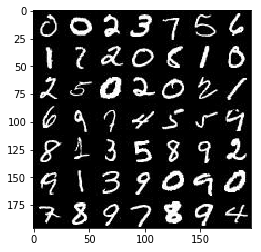

In [117]:
show_n_images = 49

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

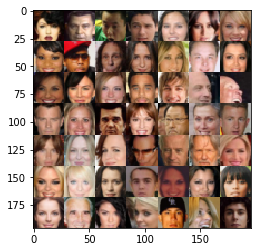

In [118]:
show_n_images = 49

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [119]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [120]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, (None), name='learning_rate')
    

    return (inputs_real, inputs_z, learning_rate)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [121]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    alpha = 0.2
    with tf.variable_scope('discriminator', reuse=reuse):
        # images = 28x28x3
        x1 = tf.layers.conv2d(images, 128, 5, strides=1, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 28x28x128
        
        x2 = tf.layers.conv2d(relu1, 256, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 14x14x256
        
        x3 = tf.layers.conv2d(relu2, 512, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 7x7x512
        
        # Flatten it 25,008
        flat = tf.reshape(relu3, (-1, 7*7*512))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return (out, logits)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [122]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.2
    with tf.variable_scope('generator', reuse=not is_train):
        # 25,008
        x1 = tf.layers.dense(z, 7*7*512)
        
        # Reshape it: 7x7x512
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 7x7x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 14x14x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 28x28x128
        
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=1, padding='same')
        # 28x28x<out_channel_dim>
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [123]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [124]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)

    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]

    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(d_loss, var_list = d_vars)

    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(g_loss, var_list = g_vars)
        
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [125]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [126]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    input_real, input_z, lr = model_inputs(*data_shape[1:], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[-1])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    samples, losses = [], []
    steps = 0
    sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                batch_images = batch_images * 2
                steps += 1
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images, lr: learning_rate})
                
                if steps % 10 == 0:
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    
                    print("Epoch {0}/{1}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:4f}...".format(train_loss_d),
                          "Generator Loss: {:4f}".format(train_loss_g))
                    losses.append((train_loss_d, train_loss_g))
                    
                if steps % 100 == 0:
                    show_generator_output(sess, 25, input_z, data_shape[-1], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.000061... Generator Loss: 28.934143
Epoch 1/2... Discriminator Loss: 0.000021... Generator Loss: 27.642599
Epoch 1/2... Discriminator Loss: 0.010960... Generator Loss: 43.966309
Epoch 1/2... Discriminator Loss: 0.000649... Generator Loss: 19.246193
Epoch 1/2... Discriminator Loss: 0.026794... Generator Loss: 4.225798
Epoch 1/2... Discriminator Loss: 0.000145... Generator Loss: 12.476180
Epoch 1/2... Discriminator Loss: 1.562206... Generator Loss: 3.653619
Epoch 1/2... Discriminator Loss: 1.899490... Generator Loss: 0.381597
Epoch 1/2... Discriminator Loss: 0.000171... Generator Loss: 26.810593
Epoch 1/2... Discriminator Loss: 0.000656... Generator Loss: 18.872856


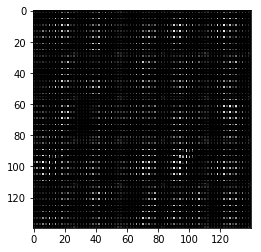

Epoch 1/2... Discriminator Loss: 0.330944... Generator Loss: 13.513503
Epoch 1/2... Discriminator Loss: 0.145003... Generator Loss: 4.630116
Epoch 1/2... Discriminator Loss: 0.209829... Generator Loss: 2.664790
Epoch 1/2... Discriminator Loss: 2.515746... Generator Loss: 0.218314
Epoch 1/2... Discriminator Loss: 1.148149... Generator Loss: 0.763774
Epoch 1/2... Discriminator Loss: 1.123564... Generator Loss: 1.149648
Epoch 1/2... Discriminator Loss: 3.200030... Generator Loss: 0.095254
Epoch 1/2... Discriminator Loss: 0.488049... Generator Loss: 1.555333
Epoch 1/2... Discriminator Loss: 1.177267... Generator Loss: 3.579447
Epoch 1/2... Discriminator Loss: 0.612334... Generator Loss: 2.504287


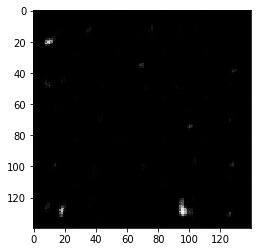

Epoch 1/2... Discriminator Loss: 1.289231... Generator Loss: 0.767128
Epoch 1/2... Discriminator Loss: 0.844882... Generator Loss: 1.622980
Epoch 1/2... Discriminator Loss: 1.029554... Generator Loss: 5.353817
Epoch 1/2... Discriminator Loss: 0.500920... Generator Loss: 2.226247
Epoch 1/2... Discriminator Loss: 1.587272... Generator Loss: 2.113319
Epoch 1/2... Discriminator Loss: 2.491234... Generator Loss: 0.234245
Epoch 1/2... Discriminator Loss: 0.618383... Generator Loss: 1.067074
Epoch 1/2... Discriminator Loss: 1.859493... Generator Loss: 3.263872
Epoch 1/2... Discriminator Loss: 1.844431... Generator Loss: 0.319788
Epoch 1/2... Discriminator Loss: 2.072435... Generator Loss: 2.847517


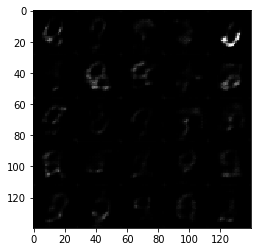

Epoch 1/2... Discriminator Loss: 1.959198... Generator Loss: 0.527076
Epoch 1/2... Discriminator Loss: 0.696382... Generator Loss: 1.744537
Epoch 1/2... Discriminator Loss: 1.094216... Generator Loss: 2.218685
Epoch 1/2... Discriminator Loss: 0.936725... Generator Loss: 2.121285
Epoch 1/2... Discriminator Loss: 1.171049... Generator Loss: 0.956687
Epoch 1/2... Discriminator Loss: 1.154859... Generator Loss: 0.698558
Epoch 1/2... Discriminator Loss: 1.516975... Generator Loss: 0.400964
Epoch 1/2... Discriminator Loss: 1.120958... Generator Loss: 0.757039
Epoch 1/2... Discriminator Loss: 1.399384... Generator Loss: 0.435594
Epoch 1/2... Discriminator Loss: 1.239990... Generator Loss: 2.399728


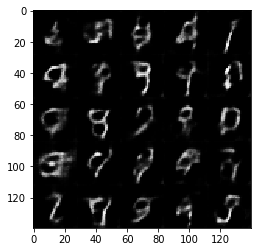

Epoch 1/2... Discriminator Loss: 1.136077... Generator Loss: 1.709656
Epoch 1/2... Discriminator Loss: 1.442653... Generator Loss: 1.982760
Epoch 1/2... Discriminator Loss: 1.192068... Generator Loss: 0.585033
Epoch 1/2... Discriminator Loss: 1.205437... Generator Loss: 0.544465
Epoch 1/2... Discriminator Loss: 1.080478... Generator Loss: 0.792274
Epoch 1/2... Discriminator Loss: 1.010549... Generator Loss: 0.699179
Epoch 1/2... Discriminator Loss: 1.449255... Generator Loss: 2.389877
Epoch 1/2... Discriminator Loss: 1.007452... Generator Loss: 0.759223
Epoch 1/2... Discriminator Loss: 1.168149... Generator Loss: 0.554722
Epoch 1/2... Discriminator Loss: 1.530747... Generator Loss: 2.346436


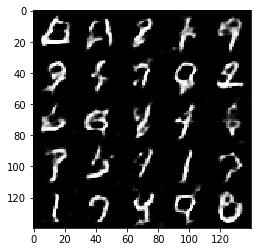

Epoch 1/2... Discriminator Loss: 0.820318... Generator Loss: 1.971665
Epoch 1/2... Discriminator Loss: 1.456802... Generator Loss: 0.347609
Epoch 1/2... Discriminator Loss: 1.288448... Generator Loss: 0.453849
Epoch 1/2... Discriminator Loss: 2.708148... Generator Loss: 3.609345
Epoch 1/2... Discriminator Loss: 1.192092... Generator Loss: 0.553120
Epoch 1/2... Discriminator Loss: 1.481587... Generator Loss: 0.385876
Epoch 1/2... Discriminator Loss: 1.631717... Generator Loss: 0.426208
Epoch 1/2... Discriminator Loss: 1.072385... Generator Loss: 1.256437
Epoch 1/2... Discriminator Loss: 1.423460... Generator Loss: 2.096963
Epoch 1/2... Discriminator Loss: 1.580127... Generator Loss: 2.151775


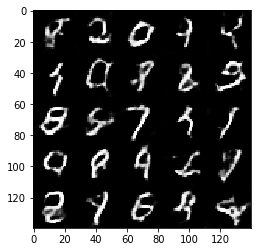

Epoch 1/2... Discriminator Loss: 1.328304... Generator Loss: 0.467984
Epoch 1/2... Discriminator Loss: 2.060570... Generator Loss: 0.213065
Epoch 1/2... Discriminator Loss: 1.286673... Generator Loss: 0.561041
Epoch 1/2... Discriminator Loss: 1.264662... Generator Loss: 1.997517
Epoch 1/2... Discriminator Loss: 1.025673... Generator Loss: 0.690524
Epoch 1/2... Discriminator Loss: 1.070693... Generator Loss: 0.991473
Epoch 1/2... Discriminator Loss: 1.211277... Generator Loss: 0.468890
Epoch 1/2... Discriminator Loss: 1.178902... Generator Loss: 1.622676
Epoch 1/2... Discriminator Loss: 0.919735... Generator Loss: 0.947386
Epoch 1/2... Discriminator Loss: 1.409069... Generator Loss: 1.980396


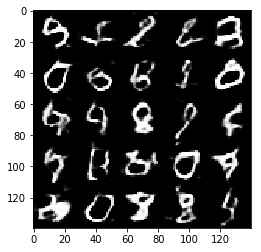

Epoch 1/2... Discriminator Loss: 1.764183... Generator Loss: 0.289077
Epoch 1/2... Discriminator Loss: 1.745019... Generator Loss: 0.292627
Epoch 1/2... Discriminator Loss: 3.047393... Generator Loss: 4.324504
Epoch 1/2... Discriminator Loss: 1.092608... Generator Loss: 1.355404
Epoch 1/2... Discriminator Loss: 1.538394... Generator Loss: 0.357498
Epoch 1/2... Discriminator Loss: 1.054472... Generator Loss: 0.712770
Epoch 1/2... Discriminator Loss: 1.882417... Generator Loss: 0.254200
Epoch 1/2... Discriminator Loss: 1.173761... Generator Loss: 0.652994
Epoch 1/2... Discriminator Loss: 1.570318... Generator Loss: 0.368578
Epoch 1/2... Discriminator Loss: 1.173203... Generator Loss: 1.435294


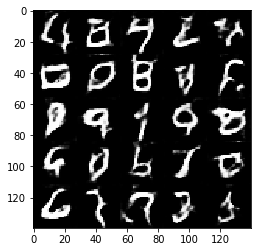

Epoch 1/2... Discriminator Loss: 0.981883... Generator Loss: 1.046257
Epoch 1/2... Discriminator Loss: 0.841305... Generator Loss: 1.435902
Epoch 1/2... Discriminator Loss: 2.073752... Generator Loss: 3.466253
Epoch 1/2... Discriminator Loss: 1.712069... Generator Loss: 0.371517
Epoch 1/2... Discriminator Loss: 1.178972... Generator Loss: 0.768791
Epoch 1/2... Discriminator Loss: 0.872356... Generator Loss: 1.845934
Epoch 1/2... Discriminator Loss: 1.392671... Generator Loss: 1.656019
Epoch 1/2... Discriminator Loss: 1.134521... Generator Loss: 0.599520
Epoch 1/2... Discriminator Loss: 1.018470... Generator Loss: 0.668882
Epoch 1/2... Discriminator Loss: 1.695413... Generator Loss: 1.908724


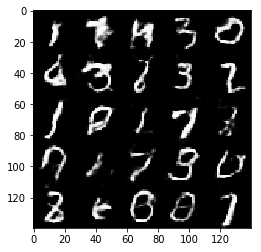

Epoch 1/2... Discriminator Loss: 1.860595... Generator Loss: 0.281783
Epoch 1/2... Discriminator Loss: 1.197059... Generator Loss: 0.600717
Epoch 1/2... Discriminator Loss: 1.029306... Generator Loss: 1.610611
Epoch 1/2... Discriminator Loss: 1.013761... Generator Loss: 1.448350
Epoch 1/2... Discriminator Loss: 1.513502... Generator Loss: 0.402169
Epoch 1/2... Discriminator Loss: 1.153992... Generator Loss: 0.603409
Epoch 1/2... Discriminator Loss: 1.000392... Generator Loss: 1.004187
Epoch 1/2... Discriminator Loss: 1.240092... Generator Loss: 0.823554
Epoch 1/2... Discriminator Loss: 0.735863... Generator Loss: 1.289168
Epoch 1/2... Discriminator Loss: 2.311208... Generator Loss: 0.162697


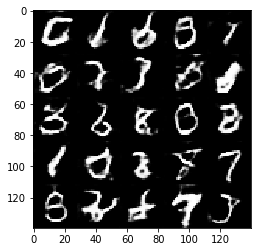

Epoch 1/2... Discriminator Loss: 1.471866... Generator Loss: 1.960778
Epoch 1/2... Discriminator Loss: 2.067491... Generator Loss: 0.217896
Epoch 1/2... Discriminator Loss: 1.481928... Generator Loss: 0.481847
Epoch 1/2... Discriminator Loss: 2.109889... Generator Loss: 0.220725
Epoch 1/2... Discriminator Loss: 0.846763... Generator Loss: 0.914970
Epoch 1/2... Discriminator Loss: 1.200028... Generator Loss: 2.406001
Epoch 1/2... Discriminator Loss: 1.183333... Generator Loss: 0.593091
Epoch 1/2... Discriminator Loss: 1.647146... Generator Loss: 0.285429
Epoch 1/2... Discriminator Loss: 1.783541... Generator Loss: 1.713203
Epoch 1/2... Discriminator Loss: 0.999525... Generator Loss: 1.572796


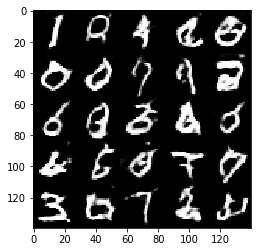

Epoch 1/2... Discriminator Loss: 1.440690... Generator Loss: 0.402042
Epoch 1/2... Discriminator Loss: 1.279073... Generator Loss: 0.777656
Epoch 1/2... Discriminator Loss: 1.297186... Generator Loss: 0.493786
Epoch 1/2... Discriminator Loss: 0.892689... Generator Loss: 0.876864
Epoch 1/2... Discriminator Loss: 2.403928... Generator Loss: 0.135572
Epoch 1/2... Discriminator Loss: 0.982501... Generator Loss: 0.906066
Epoch 1/2... Discriminator Loss: 1.341411... Generator Loss: 0.440896
Epoch 1/2... Discriminator Loss: 1.504248... Generator Loss: 0.382432
Epoch 1/2... Discriminator Loss: 1.924885... Generator Loss: 0.378419
Epoch 1/2... Discriminator Loss: 1.332151... Generator Loss: 0.449423


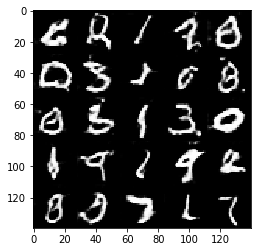

Epoch 2/2... Discriminator Loss: 1.814862... Generator Loss: 0.260069
Epoch 2/2... Discriminator Loss: 0.910352... Generator Loss: 1.154909
Epoch 2/2... Discriminator Loss: 0.874748... Generator Loss: 0.899166
Epoch 2/2... Discriminator Loss: 1.146291... Generator Loss: 2.035696
Epoch 2/2... Discriminator Loss: 1.099438... Generator Loss: 1.335324
Epoch 2/2... Discriminator Loss: 1.328574... Generator Loss: 0.448264
Epoch 2/2... Discriminator Loss: 0.961721... Generator Loss: 0.735475
Epoch 2/2... Discriminator Loss: 1.954012... Generator Loss: 4.958410
Epoch 2/2... Discriminator Loss: 1.183123... Generator Loss: 2.203913
Epoch 2/2... Discriminator Loss: 1.232031... Generator Loss: 0.549795


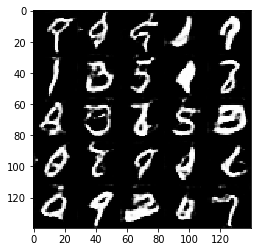

Epoch 2/2... Discriminator Loss: 0.736457... Generator Loss: 0.986818
Epoch 2/2... Discriminator Loss: 0.821164... Generator Loss: 1.176719
Epoch 2/2... Discriminator Loss: 1.054269... Generator Loss: 1.117130
Epoch 2/2... Discriminator Loss: 1.800824... Generator Loss: 2.908696
Epoch 2/2... Discriminator Loss: 0.997754... Generator Loss: 0.743054
Epoch 2/2... Discriminator Loss: 1.496271... Generator Loss: 0.375171
Epoch 2/2... Discriminator Loss: 0.743091... Generator Loss: 1.561765
Epoch 2/2... Discriminator Loss: 0.713888... Generator Loss: 1.150612
Epoch 2/2... Discriminator Loss: 0.415256... Generator Loss: 1.708159
Epoch 2/2... Discriminator Loss: 2.650351... Generator Loss: 4.718759


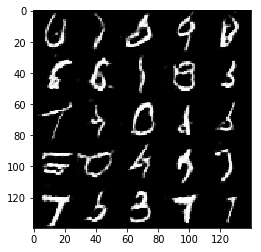

Epoch 2/2... Discriminator Loss: 0.551378... Generator Loss: 1.263627
Epoch 2/2... Discriminator Loss: 0.680982... Generator Loss: 1.026619
Epoch 2/2... Discriminator Loss: 0.636594... Generator Loss: 2.108693
Epoch 2/2... Discriminator Loss: 0.956281... Generator Loss: 2.154186
Epoch 2/2... Discriminator Loss: 1.024530... Generator Loss: 1.581415
Epoch 2/2... Discriminator Loss: 0.912781... Generator Loss: 1.402061
Epoch 2/2... Discriminator Loss: 1.214623... Generator Loss: 0.590571
Epoch 2/2... Discriminator Loss: 1.986806... Generator Loss: 2.290900
Epoch 2/2... Discriminator Loss: 0.899362... Generator Loss: 0.821909
Epoch 2/2... Discriminator Loss: 1.406703... Generator Loss: 3.176476


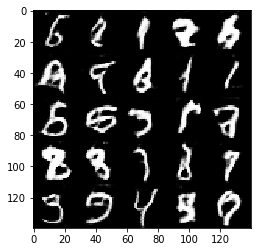

Epoch 2/2... Discriminator Loss: 0.716839... Generator Loss: 1.045139
Epoch 2/2... Discriminator Loss: 0.645553... Generator Loss: 2.335075
Epoch 2/2... Discriminator Loss: 0.845072... Generator Loss: 0.891732
Epoch 2/2... Discriminator Loss: 0.509323... Generator Loss: 2.541416
Epoch 2/2... Discriminator Loss: 0.528279... Generator Loss: 1.205632
Epoch 2/2... Discriminator Loss: 3.442787... Generator Loss: 0.066062
Epoch 2/2... Discriminator Loss: 0.657138... Generator Loss: 1.673666
Epoch 2/2... Discriminator Loss: 1.185601... Generator Loss: 3.601238
Epoch 2/2... Discriminator Loss: 0.590067... Generator Loss: 1.565450
Epoch 2/2... Discriminator Loss: 1.820044... Generator Loss: 3.652181


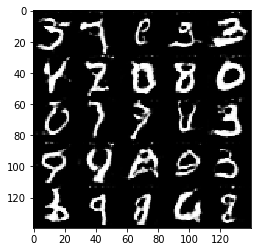

Epoch 2/2... Discriminator Loss: 0.694410... Generator Loss: 2.029579
Epoch 2/2... Discriminator Loss: 0.566645... Generator Loss: 1.424607
Epoch 2/2... Discriminator Loss: 0.809171... Generator Loss: 1.000482
Epoch 2/2... Discriminator Loss: 2.189967... Generator Loss: 0.227936
Epoch 2/2... Discriminator Loss: 0.709440... Generator Loss: 1.184239
Epoch 2/2... Discriminator Loss: 0.521328... Generator Loss: 1.861404
Epoch 2/2... Discriminator Loss: 0.624052... Generator Loss: 1.281217
Epoch 2/2... Discriminator Loss: 0.471443... Generator Loss: 1.455194
Epoch 2/2... Discriminator Loss: 1.463775... Generator Loss: 2.308495
Epoch 2/2... Discriminator Loss: 1.111771... Generator Loss: 0.725529


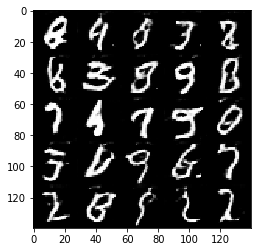

Epoch 2/2... Discriminator Loss: 0.731871... Generator Loss: 1.748208
Epoch 2/2... Discriminator Loss: 2.003666... Generator Loss: 3.841624
Epoch 2/2... Discriminator Loss: 0.706842... Generator Loss: 1.780801
Epoch 2/2... Discriminator Loss: 0.574739... Generator Loss: 1.907467
Epoch 2/2... Discriminator Loss: 0.554493... Generator Loss: 1.330618
Epoch 2/2... Discriminator Loss: 1.565597... Generator Loss: 0.507350
Epoch 2/2... Discriminator Loss: 0.507248... Generator Loss: 1.619646
Epoch 2/2... Discriminator Loss: 0.402265... Generator Loss: 2.371995
Epoch 2/2... Discriminator Loss: 1.023224... Generator Loss: 0.914797
Epoch 2/2... Discriminator Loss: 0.544406... Generator Loss: 1.558623


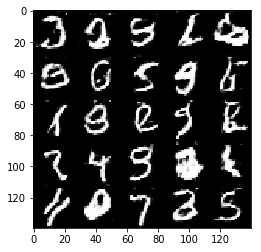

Epoch 2/2... Discriminator Loss: 2.709512... Generator Loss: 0.236699
Epoch 2/2... Discriminator Loss: 2.286856... Generator Loss: 4.416885
Epoch 2/2... Discriminator Loss: 0.566460... Generator Loss: 1.649630
Epoch 2/2... Discriminator Loss: 0.688776... Generator Loss: 1.231779
Epoch 2/2... Discriminator Loss: 0.825745... Generator Loss: 0.901589
Epoch 2/2... Discriminator Loss: 0.554448... Generator Loss: 1.426121
Epoch 2/2... Discriminator Loss: 1.529406... Generator Loss: 0.492340
Epoch 2/2... Discriminator Loss: 0.398816... Generator Loss: 2.177823
Epoch 2/2... Discriminator Loss: 0.600054... Generator Loss: 1.745648
Epoch 2/2... Discriminator Loss: 0.756492... Generator Loss: 1.104279


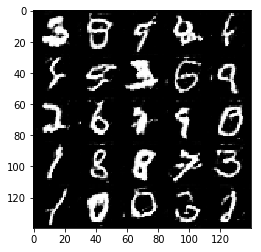

Epoch 2/2... Discriminator Loss: 0.840778... Generator Loss: 0.920353
Epoch 2/2... Discriminator Loss: 0.626615... Generator Loss: 1.358180
Epoch 2/2... Discriminator Loss: 0.470765... Generator Loss: 1.261608
Epoch 2/2... Discriminator Loss: 0.172658... Generator Loss: 2.765353
Epoch 2/2... Discriminator Loss: 0.413142... Generator Loss: 1.604838
Epoch 2/2... Discriminator Loss: 0.121598... Generator Loss: 2.902203
Epoch 2/2... Discriminator Loss: 1.210675... Generator Loss: 0.651802
Epoch 2/2... Discriminator Loss: 0.790073... Generator Loss: 3.310701
Epoch 2/2... Discriminator Loss: 1.347885... Generator Loss: 2.988319
Epoch 2/2... Discriminator Loss: 0.732368... Generator Loss: 2.036827


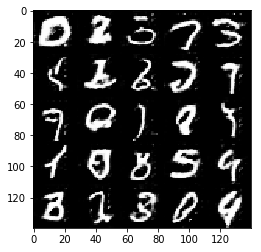

Epoch 2/2... Discriminator Loss: 0.854760... Generator Loss: 0.954710
Epoch 2/2... Discriminator Loss: 0.422327... Generator Loss: 1.615030
Epoch 2/2... Discriminator Loss: 0.316860... Generator Loss: 2.788359
Epoch 2/2... Discriminator Loss: 2.097555... Generator Loss: 0.314721
Epoch 2/2... Discriminator Loss: 0.750125... Generator Loss: 1.063597
Epoch 2/2... Discriminator Loss: 0.549592... Generator Loss: 1.549608
Epoch 2/2... Discriminator Loss: 0.798711... Generator Loss: 0.977347
Epoch 2/2... Discriminator Loss: 1.098460... Generator Loss: 0.792678
Epoch 2/2... Discriminator Loss: 3.370867... Generator Loss: 0.115253
Epoch 2/2... Discriminator Loss: 1.259717... Generator Loss: 2.199084


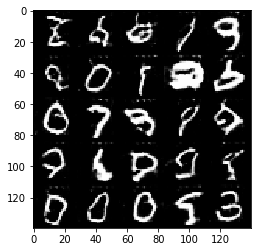

Epoch 2/2... Discriminator Loss: 0.917660... Generator Loss: 1.198766
Epoch 2/2... Discriminator Loss: 0.908488... Generator Loss: 0.962253
Epoch 2/2... Discriminator Loss: 0.572440... Generator Loss: 1.805198
Epoch 2/2... Discriminator Loss: 0.532149... Generator Loss: 1.677577
Epoch 2/2... Discriminator Loss: 0.350178... Generator Loss: 1.919436
Epoch 2/2... Discriminator Loss: 1.308692... Generator Loss: 3.161335
Epoch 2/2... Discriminator Loss: 1.683570... Generator Loss: 4.121213
Epoch 2/2... Discriminator Loss: 0.889296... Generator Loss: 1.010844
Epoch 2/2... Discriminator Loss: 0.782765... Generator Loss: 1.037988
Epoch 2/2... Discriminator Loss: 0.331748... Generator Loss: 1.951649


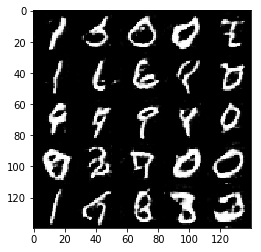

Epoch 2/2... Discriminator Loss: 1.220791... Generator Loss: 0.579277
Epoch 2/2... Discriminator Loss: 0.626022... Generator Loss: 1.323616
Epoch 2/2... Discriminator Loss: 0.462840... Generator Loss: 1.465830
Epoch 2/2... Discriminator Loss: 0.513611... Generator Loss: 3.997970
Epoch 2/2... Discriminator Loss: 0.184842... Generator Loss: 2.679044
Epoch 2/2... Discriminator Loss: 0.626967... Generator Loss: 1.341476
Epoch 2/2... Discriminator Loss: 2.648224... Generator Loss: 0.210786
Epoch 2/2... Discriminator Loss: 1.056173... Generator Loss: 2.739801
Epoch 2/2... Discriminator Loss: 0.815440... Generator Loss: 0.998285
Epoch 2/2... Discriminator Loss: 0.684812... Generator Loss: 1.353207


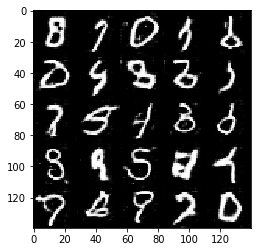

Epoch 2/2... Discriminator Loss: 1.254898... Generator Loss: 0.568775
Epoch 2/2... Discriminator Loss: 0.717154... Generator Loss: 1.700592
Epoch 2/2... Discriminator Loss: 1.171858... Generator Loss: 0.609003
Epoch 2/2... Discriminator Loss: 0.689887... Generator Loss: 1.192516
Epoch 2/2... Discriminator Loss: 1.402232... Generator Loss: 0.550430
Epoch 2/2... Discriminator Loss: 0.770023... Generator Loss: 1.049427
Epoch 2/2... Discriminator Loss: 0.445257... Generator Loss: 1.499300
Epoch 2/2... Discriminator Loss: 0.678309... Generator Loss: 1.136888
Epoch 2/2... Discriminator Loss: 2.101598... Generator Loss: 3.710011
Epoch 2/2... Discriminator Loss: 1.855910... Generator Loss: 0.255679


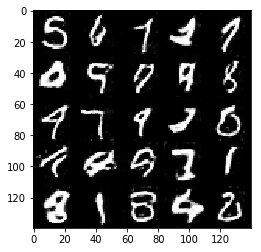

In [127]:
batch_size = 50
z_dim = 100
learning_rate = 0.0005
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/10... Discriminator Loss: 0.343487... Generator Loss: 37.018211
Epoch 1/10... Discriminator Loss: 0.035813... Generator Loss: 40.484802
Epoch 1/10... Discriminator Loss: 0.059457... Generator Loss: 42.867447
Epoch 1/10... Discriminator Loss: 0.538445... Generator Loss: 39.648499
Epoch 1/10... Discriminator Loss: 0.186596... Generator Loss: 8.103965
Epoch 1/10... Discriminator Loss: 0.100242... Generator Loss: 8.729134
Epoch 1/10... Discriminator Loss: 0.003299... Generator Loss: 8.169909
Epoch 1/10... Discriminator Loss: 1.052955... Generator Loss: 9.857722
Epoch 1/10... Discriminator Loss: 0.411124... Generator Loss: 5.235451
Epoch 1/10... Discriminator Loss: 0.127542... Generator Loss: 3.628533


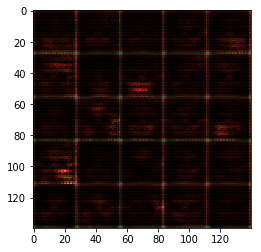

Epoch 1/10... Discriminator Loss: 0.069815... Generator Loss: 10.734613
Epoch 1/10... Discriminator Loss: 0.024600... Generator Loss: 10.508707
Epoch 1/10... Discriminator Loss: 0.078405... Generator Loss: 4.545009
Epoch 1/10... Discriminator Loss: 0.990824... Generator Loss: 5.322680
Epoch 1/10... Discriminator Loss: 1.720766... Generator Loss: 0.778319
Epoch 1/10... Discriminator Loss: 0.849172... Generator Loss: 3.993165
Epoch 1/10... Discriminator Loss: 0.488929... Generator Loss: 2.107226
Epoch 1/10... Discriminator Loss: 1.663201... Generator Loss: 0.936162
Epoch 1/10... Discriminator Loss: 1.291642... Generator Loss: 0.804719
Epoch 1/10... Discriminator Loss: 1.289210... Generator Loss: 0.778875


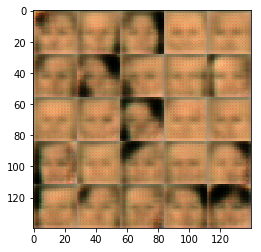

Epoch 1/10... Discriminator Loss: 0.553217... Generator Loss: 2.087335
Epoch 1/10... Discriminator Loss: 0.830911... Generator Loss: 1.190981
Epoch 1/10... Discriminator Loss: 1.174801... Generator Loss: 1.853872
Epoch 1/10... Discriminator Loss: 1.669476... Generator Loss: 2.838577
Epoch 1/10... Discriminator Loss: 0.840488... Generator Loss: 2.005797
Epoch 1/10... Discriminator Loss: 0.513018... Generator Loss: 1.575963
Epoch 1/10... Discriminator Loss: 1.121901... Generator Loss: 1.162167
Epoch 1/10... Discriminator Loss: 0.615805... Generator Loss: 1.676747
Epoch 1/10... Discriminator Loss: 1.025697... Generator Loss: 1.649719
Epoch 1/10... Discriminator Loss: 0.469471... Generator Loss: 2.558455


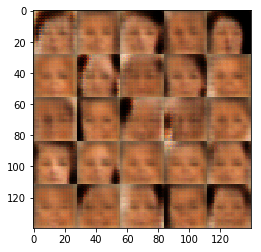

Epoch 1/10... Discriminator Loss: 1.069663... Generator Loss: 1.108622
Epoch 1/10... Discriminator Loss: 2.767544... Generator Loss: 3.870247
Epoch 1/10... Discriminator Loss: 0.754061... Generator Loss: 2.222166
Epoch 1/10... Discriminator Loss: 6.324288... Generator Loss: 0.003877
Epoch 1/10... Discriminator Loss: 1.170883... Generator Loss: 0.621990
Epoch 1/10... Discriminator Loss: 1.220695... Generator Loss: 1.900558
Epoch 1/10... Discriminator Loss: 0.804288... Generator Loss: 1.096959
Epoch 1/10... Discriminator Loss: 0.743127... Generator Loss: 1.635123
Epoch 1/10... Discriminator Loss: 0.902319... Generator Loss: 0.969872
Epoch 1/10... Discriminator Loss: 0.829269... Generator Loss: 1.501406


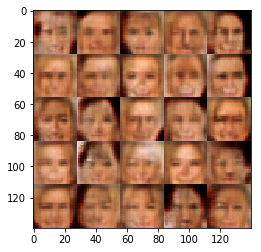

Epoch 1/10... Discriminator Loss: 0.941336... Generator Loss: 0.825548
Epoch 1/10... Discriminator Loss: 0.937187... Generator Loss: 1.830943
Epoch 1/10... Discriminator Loss: 0.572275... Generator Loss: 1.643144
Epoch 1/10... Discriminator Loss: 1.359362... Generator Loss: 0.501783
Epoch 1/10... Discriminator Loss: 1.171597... Generator Loss: 2.623317
Epoch 1/10... Discriminator Loss: 2.866306... Generator Loss: 5.225190
Epoch 1/10... Discriminator Loss: 0.892604... Generator Loss: 0.894773
Epoch 1/10... Discriminator Loss: 2.911624... Generator Loss: 5.284602
Epoch 1/10... Discriminator Loss: 1.035323... Generator Loss: 0.780236
Epoch 1/10... Discriminator Loss: 0.986665... Generator Loss: 0.758678


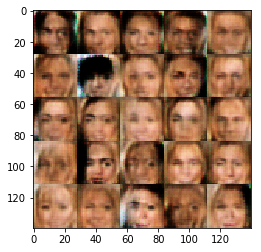

Epoch 1/10... Discriminator Loss: 3.273005... Generator Loss: 4.827794
Epoch 1/10... Discriminator Loss: 0.836435... Generator Loss: 1.955009
Epoch 1/10... Discriminator Loss: 0.345340... Generator Loss: 2.711915
Epoch 1/10... Discriminator Loss: 0.728565... Generator Loss: 1.301618
Epoch 1/10... Discriminator Loss: 0.545251... Generator Loss: 2.909873
Epoch 1/10... Discriminator Loss: 1.496120... Generator Loss: 0.400748
Epoch 1/10... Discriminator Loss: 0.487695... Generator Loss: 4.283422
Epoch 1/10... Discriminator Loss: 0.963884... Generator Loss: 0.977784
Epoch 1/10... Discriminator Loss: 0.760781... Generator Loss: 1.009603
Epoch 1/10... Discriminator Loss: 1.340895... Generator Loss: 0.489475


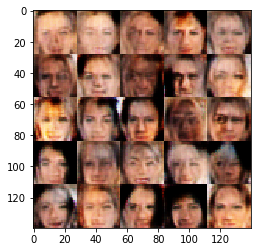

Epoch 1/10... Discriminator Loss: 2.034837... Generator Loss: 5.070492
Epoch 1/10... Discriminator Loss: 1.021780... Generator Loss: 2.935746
Epoch 1/10... Discriminator Loss: 0.782128... Generator Loss: 1.328769
Epoch 1/10... Discriminator Loss: 0.234874... Generator Loss: 2.012713
Epoch 1/10... Discriminator Loss: 0.986381... Generator Loss: 3.251770
Epoch 1/10... Discriminator Loss: 1.023374... Generator Loss: 0.903618
Epoch 1/10... Discriminator Loss: 0.572901... Generator Loss: 1.381531
Epoch 1/10... Discriminator Loss: 1.174136... Generator Loss: 0.632241
Epoch 1/10... Discriminator Loss: 0.790021... Generator Loss: 3.181134
Epoch 1/10... Discriminator Loss: 0.539800... Generator Loss: 1.216355


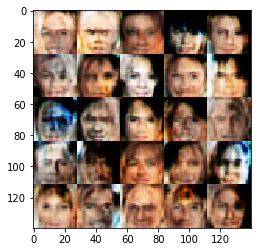

Epoch 1/10... Discriminator Loss: 1.196892... Generator Loss: 0.773098
Epoch 1/10... Discriminator Loss: 0.380329... Generator Loss: 2.188738
Epoch 1/10... Discriminator Loss: 0.682279... Generator Loss: 1.645911
Epoch 1/10... Discriminator Loss: 0.345614... Generator Loss: 2.520242
Epoch 1/10... Discriminator Loss: 0.363088... Generator Loss: 2.680595
Epoch 1/10... Discriminator Loss: 1.531351... Generator Loss: 2.807475
Epoch 1/10... Discriminator Loss: 1.725686... Generator Loss: 0.285554
Epoch 1/10... Discriminator Loss: 0.969427... Generator Loss: 3.591451
Epoch 1/10... Discriminator Loss: 0.516948... Generator Loss: 1.845371
Epoch 1/10... Discriminator Loss: 0.809373... Generator Loss: 1.083680


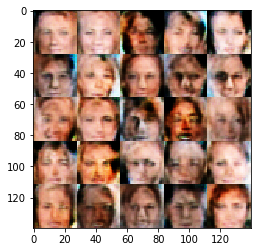

Epoch 1/10... Discriminator Loss: 0.180876... Generator Loss: 3.992467
Epoch 1/10... Discriminator Loss: 1.257669... Generator Loss: 4.134929
Epoch 1/10... Discriminator Loss: 0.332083... Generator Loss: 4.901827
Epoch 1/10... Discriminator Loss: 0.965123... Generator Loss: 2.172289
Epoch 1/10... Discriminator Loss: 1.039028... Generator Loss: 1.476802
Epoch 1/10... Discriminator Loss: 1.401515... Generator Loss: 1.713700
Epoch 1/10... Discriminator Loss: 1.403426... Generator Loss: 0.682158
Epoch 1/10... Discriminator Loss: 0.648942... Generator Loss: 2.391026
Epoch 1/10... Discriminator Loss: 0.527674... Generator Loss: 1.644492
Epoch 1/10... Discriminator Loss: 0.883722... Generator Loss: 2.925871


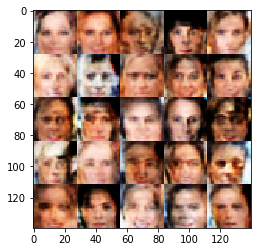

Epoch 1/10... Discriminator Loss: 0.746537... Generator Loss: 2.945594
Epoch 1/10... Discriminator Loss: 0.761076... Generator Loss: 1.016970
Epoch 1/10... Discriminator Loss: 1.535024... Generator Loss: 4.628663
Epoch 1/10... Discriminator Loss: 1.718285... Generator Loss: 0.346569
Epoch 1/10... Discriminator Loss: 2.109766... Generator Loss: 2.750007
Epoch 1/10... Discriminator Loss: 0.942421... Generator Loss: 2.958986
Epoch 1/10... Discriminator Loss: 0.791004... Generator Loss: 0.989313
Epoch 1/10... Discriminator Loss: 0.511055... Generator Loss: 2.089428
Epoch 1/10... Discriminator Loss: 2.297536... Generator Loss: 4.182734
Epoch 1/10... Discriminator Loss: 0.811787... Generator Loss: 3.632585


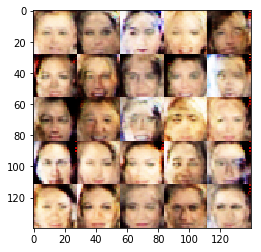

Epoch 1/10... Discriminator Loss: 0.306903... Generator Loss: 3.776937
Epoch 1/10... Discriminator Loss: 2.171514... Generator Loss: 4.429658
Epoch 1/10... Discriminator Loss: 0.640731... Generator Loss: 1.565666
Epoch 1/10... Discriminator Loss: 0.779215... Generator Loss: 2.142570
Epoch 1/10... Discriminator Loss: 0.939524... Generator Loss: 0.883295
Epoch 1/10... Discriminator Loss: 2.104109... Generator Loss: 4.167816
Epoch 1/10... Discriminator Loss: 0.107888... Generator Loss: 3.730006
Epoch 1/10... Discriminator Loss: 0.209181... Generator Loss: 3.209271
Epoch 1/10... Discriminator Loss: 1.113247... Generator Loss: 0.619545
Epoch 1/10... Discriminator Loss: 2.680355... Generator Loss: 4.739547


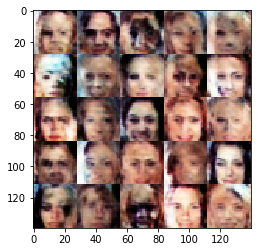

Epoch 1/10... Discriminator Loss: 1.278693... Generator Loss: 0.722386
Epoch 1/10... Discriminator Loss: 0.778812... Generator Loss: 1.167250
Epoch 1/10... Discriminator Loss: 1.718692... Generator Loss: 0.429342
Epoch 1/10... Discriminator Loss: 0.250379... Generator Loss: 2.680364
Epoch 1/10... Discriminator Loss: 0.919141... Generator Loss: 0.828230
Epoch 1/10... Discriminator Loss: 1.379997... Generator Loss: 2.026852
Epoch 1/10... Discriminator Loss: 1.497176... Generator Loss: 0.437742
Epoch 1/10... Discriminator Loss: 1.232827... Generator Loss: 2.637000
Epoch 1/10... Discriminator Loss: 1.291818... Generator Loss: 2.431133
Epoch 1/10... Discriminator Loss: 0.665152... Generator Loss: 1.307773


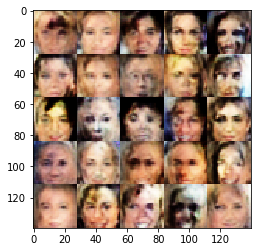

Epoch 1/10... Discriminator Loss: 1.585295... Generator Loss: 0.958998
Epoch 1/10... Discriminator Loss: 1.451170... Generator Loss: 0.818846
Epoch 1/10... Discriminator Loss: 0.432657... Generator Loss: 2.036063
Epoch 1/10... Discriminator Loss: 0.992579... Generator Loss: 2.111794
Epoch 1/10... Discriminator Loss: 0.985891... Generator Loss: 3.475680
Epoch 1/10... Discriminator Loss: 2.237347... Generator Loss: 0.462119
Epoch 1/10... Discriminator Loss: 0.918609... Generator Loss: 1.399361
Epoch 1/10... Discriminator Loss: 1.323981... Generator Loss: 2.651236
Epoch 1/10... Discriminator Loss: 0.929358... Generator Loss: 1.070380
Epoch 1/10... Discriminator Loss: 0.595577... Generator Loss: 1.392794


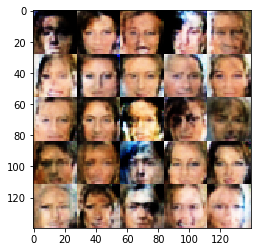

Epoch 1/10... Discriminator Loss: 0.426574... Generator Loss: 1.944766
Epoch 1/10... Discriminator Loss: 0.825408... Generator Loss: 2.057730
Epoch 1/10... Discriminator Loss: 1.599838... Generator Loss: 0.450447
Epoch 1/10... Discriminator Loss: 1.035576... Generator Loss: 0.641194
Epoch 1/10... Discriminator Loss: 0.550549... Generator Loss: 1.997232
Epoch 1/10... Discriminator Loss: 0.625107... Generator Loss: 1.652701
Epoch 1/10... Discriminator Loss: 0.870281... Generator Loss: 1.203600
Epoch 1/10... Discriminator Loss: 0.514588... Generator Loss: 1.809204
Epoch 1/10... Discriminator Loss: 0.368974... Generator Loss: 3.586735
Epoch 1/10... Discriminator Loss: 0.919267... Generator Loss: 1.591233


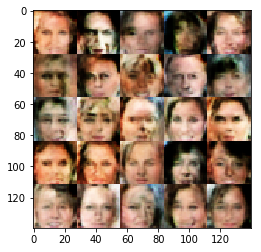

Epoch 1/10... Discriminator Loss: 0.676639... Generator Loss: 1.488006
Epoch 1/10... Discriminator Loss: 0.933753... Generator Loss: 2.849844
Epoch 1/10... Discriminator Loss: 0.351590... Generator Loss: 2.306750
Epoch 1/10... Discriminator Loss: 1.068667... Generator Loss: 3.967353
Epoch 1/10... Discriminator Loss: 0.739880... Generator Loss: 1.259330
Epoch 1/10... Discriminator Loss: 0.613552... Generator Loss: 2.616714
Epoch 1/10... Discriminator Loss: 0.942140... Generator Loss: 2.365947
Epoch 1/10... Discriminator Loss: 0.783038... Generator Loss: 3.876461
Epoch 1/10... Discriminator Loss: 0.370825... Generator Loss: 1.850538
Epoch 1/10... Discriminator Loss: 0.276321... Generator Loss: 3.038858


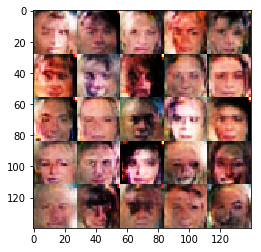

Epoch 1/10... Discriminator Loss: 0.186885... Generator Loss: 3.314148
Epoch 1/10... Discriminator Loss: 0.033480... Generator Loss: 5.177054
Epoch 1/10... Discriminator Loss: 0.051851... Generator Loss: 9.824182
Epoch 1/10... Discriminator Loss: 0.047827... Generator Loss: 5.429600
Epoch 1/10... Discriminator Loss: 0.011639... Generator Loss: 8.281919
Epoch 1/10... Discriminator Loss: 3.603189... Generator Loss: 0.047477
Epoch 1/10... Discriminator Loss: 1.190101... Generator Loss: 1.136498
Epoch 1/10... Discriminator Loss: 0.909482... Generator Loss: 1.272995
Epoch 1/10... Discriminator Loss: 1.019637... Generator Loss: 0.642543
Epoch 1/10... Discriminator Loss: 1.168835... Generator Loss: 0.623996


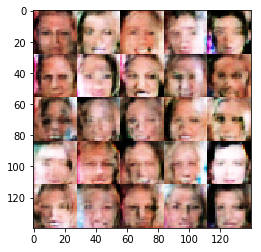

Epoch 1/10... Discriminator Loss: 0.856247... Generator Loss: 1.049891
Epoch 1/10... Discriminator Loss: 0.948946... Generator Loss: 0.952586
Epoch 1/10... Discriminator Loss: 0.638037... Generator Loss: 1.468063
Epoch 1/10... Discriminator Loss: 2.563710... Generator Loss: 0.151752
Epoch 1/10... Discriminator Loss: 0.883170... Generator Loss: 1.561772
Epoch 1/10... Discriminator Loss: 0.406345... Generator Loss: 2.636745
Epoch 1/10... Discriminator Loss: 1.484800... Generator Loss: 0.497521
Epoch 1/10... Discriminator Loss: 0.913533... Generator Loss: 0.958566
Epoch 1/10... Discriminator Loss: 0.966069... Generator Loss: 2.156683
Epoch 1/10... Discriminator Loss: 0.882418... Generator Loss: 0.874973


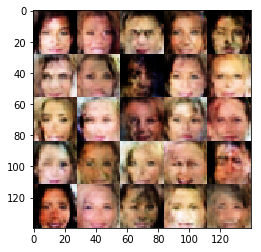

Epoch 1/10... Discriminator Loss: 0.807481... Generator Loss: 2.783682
Epoch 1/10... Discriminator Loss: 1.272889... Generator Loss: 2.898351
Epoch 1/10... Discriminator Loss: 0.810873... Generator Loss: 1.032990
Epoch 1/10... Discriminator Loss: 0.698471... Generator Loss: 1.051281
Epoch 1/10... Discriminator Loss: 0.449658... Generator Loss: 2.062301
Epoch 1/10... Discriminator Loss: 1.652848... Generator Loss: 0.302135
Epoch 1/10... Discriminator Loss: 1.222216... Generator Loss: 0.468135
Epoch 1/10... Discriminator Loss: 1.456508... Generator Loss: 0.415620
Epoch 1/10... Discriminator Loss: 0.645825... Generator Loss: 1.645969
Epoch 1/10... Discriminator Loss: 1.517763... Generator Loss: 3.652362


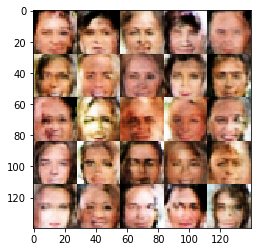

Epoch 1/10... Discriminator Loss: 1.006776... Generator Loss: 0.633953
Epoch 1/10... Discriminator Loss: 0.337461... Generator Loss: 2.855898
Epoch 1/10... Discriminator Loss: 1.245226... Generator Loss: 0.492800
Epoch 1/10... Discriminator Loss: 0.888947... Generator Loss: 1.116683
Epoch 1/10... Discriminator Loss: 1.740883... Generator Loss: 5.828144
Epoch 1/10... Discriminator Loss: 0.226566... Generator Loss: 3.001783
Epoch 1/10... Discriminator Loss: 1.820976... Generator Loss: 4.494407
Epoch 1/10... Discriminator Loss: 1.158086... Generator Loss: 3.184663
Epoch 1/10... Discriminator Loss: 1.727253... Generator Loss: 0.338107
Epoch 1/10... Discriminator Loss: 2.164805... Generator Loss: 0.689063


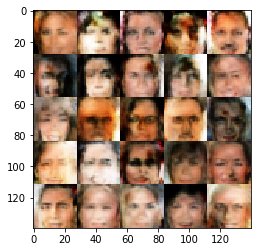

Epoch 1/10... Discriminator Loss: 1.611436... Generator Loss: 0.383349
Epoch 1/10... Discriminator Loss: 1.449948... Generator Loss: 3.726579
Epoch 1/10... Discriminator Loss: 1.067018... Generator Loss: 0.937592
Epoch 1/10... Discriminator Loss: 1.083157... Generator Loss: 0.793423
Epoch 1/10... Discriminator Loss: 0.749848... Generator Loss: 1.198881
Epoch 1/10... Discriminator Loss: 1.161765... Generator Loss: 3.586531
Epoch 1/10... Discriminator Loss: 1.904351... Generator Loss: 0.265213
Epoch 1/10... Discriminator Loss: 0.848751... Generator Loss: 1.311572
Epoch 1/10... Discriminator Loss: 0.651971... Generator Loss: 1.509885
Epoch 1/10... Discriminator Loss: 0.844098... Generator Loss: 0.935484


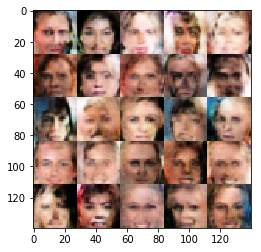

Epoch 1/10... Discriminator Loss: 0.547789... Generator Loss: 2.381845
Epoch 1/10... Discriminator Loss: 1.116649... Generator Loss: 0.641158
Epoch 1/10... Discriminator Loss: 0.879860... Generator Loss: 1.032111
Epoch 1/10... Discriminator Loss: 1.381034... Generator Loss: 0.447241
Epoch 1/10... Discriminator Loss: 0.837456... Generator Loss: 2.084199
Epoch 1/10... Discriminator Loss: 0.581301... Generator Loss: 1.754274
Epoch 1/10... Discriminator Loss: 0.722471... Generator Loss: 2.315328
Epoch 1/10... Discriminator Loss: 1.480745... Generator Loss: 1.309029
Epoch 1/10... Discriminator Loss: 1.975064... Generator Loss: 0.278300
Epoch 1/10... Discriminator Loss: 0.707833... Generator Loss: 1.256015


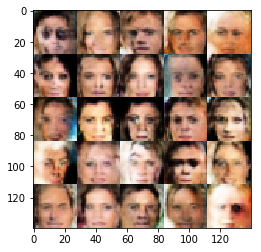

Epoch 1/10... Discriminator Loss: 1.046330... Generator Loss: 3.237481
Epoch 1/10... Discriminator Loss: 0.207732... Generator Loss: 3.153709
Epoch 1/10... Discriminator Loss: 0.359380... Generator Loss: 1.963443
Epoch 1/10... Discriminator Loss: 0.209417... Generator Loss: 2.070938
Epoch 1/10... Discriminator Loss: 0.362150... Generator Loss: 1.642081
Epoch 1/10... Discriminator Loss: 0.393429... Generator Loss: 3.308954
Epoch 1/10... Discriminator Loss: 0.628779... Generator Loss: 1.715080
Epoch 1/10... Discriminator Loss: 1.854897... Generator Loss: 0.264640
Epoch 1/10... Discriminator Loss: 1.281096... Generator Loss: 0.605298
Epoch 1/10... Discriminator Loss: 2.368433... Generator Loss: 0.141025


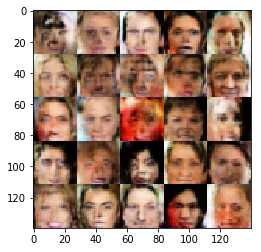

Epoch 1/10... Discriminator Loss: 0.144734... Generator Loss: 2.814158
Epoch 1/10... Discriminator Loss: 0.459602... Generator Loss: 1.599312
Epoch 1/10... Discriminator Loss: 0.753837... Generator Loss: 3.283126
Epoch 1/10... Discriminator Loss: 0.654348... Generator Loss: 2.119984
Epoch 1/10... Discriminator Loss: 0.524458... Generator Loss: 1.252282
Epoch 1/10... Discriminator Loss: 0.725695... Generator Loss: 2.009983
Epoch 1/10... Discriminator Loss: 0.741927... Generator Loss: 2.944676
Epoch 1/10... Discriminator Loss: 1.731350... Generator Loss: 0.277457
Epoch 1/10... Discriminator Loss: 0.969601... Generator Loss: 2.996126
Epoch 1/10... Discriminator Loss: 1.676352... Generator Loss: 0.277368


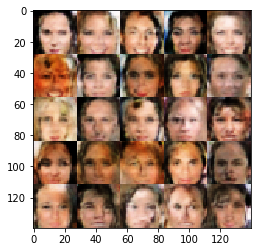

Epoch 1/10... Discriminator Loss: 1.247835... Generator Loss: 2.179863
Epoch 1/10... Discriminator Loss: 0.409753... Generator Loss: 1.547308
Epoch 1/10... Discriminator Loss: 0.681077... Generator Loss: 2.486277
Epoch 1/10... Discriminator Loss: 0.637342... Generator Loss: 1.331989
Epoch 1/10... Discriminator Loss: 0.403750... Generator Loss: 2.370045
Epoch 1/10... Discriminator Loss: 0.606979... Generator Loss: 1.211621
Epoch 1/10... Discriminator Loss: 0.945852... Generator Loss: 5.388124
Epoch 1/10... Discriminator Loss: 0.073546... Generator Loss: 4.831276
Epoch 1/10... Discriminator Loss: 0.802257... Generator Loss: 1.044386
Epoch 1/10... Discriminator Loss: 0.516381... Generator Loss: 2.205418


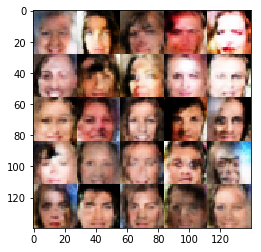

Epoch 1/10... Discriminator Loss: 4.335756... Generator Loss: 5.970160
Epoch 1/10... Discriminator Loss: 1.087429... Generator Loss: 1.555835
Epoch 1/10... Discriminator Loss: 1.257057... Generator Loss: 2.898874
Epoch 1/10... Discriminator Loss: 1.440589... Generator Loss: 0.456297
Epoch 1/10... Discriminator Loss: 0.776976... Generator Loss: 2.257406
Epoch 1/10... Discriminator Loss: 0.923587... Generator Loss: 1.198746
Epoch 1/10... Discriminator Loss: 0.832320... Generator Loss: 2.183636
Epoch 1/10... Discriminator Loss: 1.561119... Generator Loss: 0.410404
Epoch 1/10... Discriminator Loss: 0.407862... Generator Loss: 1.914240
Epoch 1/10... Discriminator Loss: 0.635551... Generator Loss: 1.263936


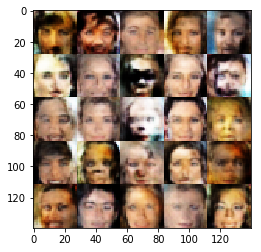

Epoch 1/10... Discriminator Loss: 1.268254... Generator Loss: 0.586313
Epoch 1/10... Discriminator Loss: 3.935569... Generator Loss: 4.707020
Epoch 1/10... Discriminator Loss: 0.901051... Generator Loss: 1.147729
Epoch 1/10... Discriminator Loss: 0.925935... Generator Loss: 1.044896
Epoch 1/10... Discriminator Loss: 1.388929... Generator Loss: 2.463031
Epoch 1/10... Discriminator Loss: 0.515993... Generator Loss: 2.811716
Epoch 1/10... Discriminator Loss: 0.848010... Generator Loss: 2.901999
Epoch 1/10... Discriminator Loss: 2.310950... Generator Loss: 2.741841
Epoch 1/10... Discriminator Loss: 0.724595... Generator Loss: 1.165495
Epoch 1/10... Discriminator Loss: 0.528499... Generator Loss: 2.748113


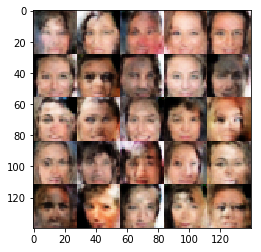

Epoch 1/10... Discriminator Loss: 1.169002... Generator Loss: 2.107294
Epoch 1/10... Discriminator Loss: 0.362923... Generator Loss: 1.755307
Epoch 1/10... Discriminator Loss: 0.988787... Generator Loss: 0.608381
Epoch 1/10... Discriminator Loss: 1.011981... Generator Loss: 0.658335
Epoch 1/10... Discriminator Loss: 1.187753... Generator Loss: 0.511442
Epoch 1/10... Discriminator Loss: 1.258042... Generator Loss: 0.536887
Epoch 1/10... Discriminator Loss: 0.864577... Generator Loss: 0.741287
Epoch 1/10... Discriminator Loss: 0.559361... Generator Loss: 1.114735
Epoch 1/10... Discriminator Loss: 0.100251... Generator Loss: 4.280195
Epoch 1/10... Discriminator Loss: 1.008251... Generator Loss: 0.652419


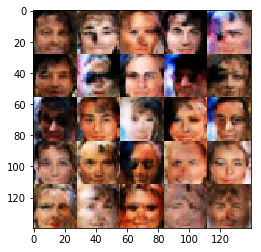

Epoch 1/10... Discriminator Loss: 0.331767... Generator Loss: 5.290521
Epoch 1/10... Discriminator Loss: 0.734158... Generator Loss: 0.973605
Epoch 1/10... Discriminator Loss: 0.226958... Generator Loss: 2.069794
Epoch 1/10... Discriminator Loss: 0.143309... Generator Loss: 3.246530
Epoch 1/10... Discriminator Loss: 0.356630... Generator Loss: 1.848482
Epoch 1/10... Discriminator Loss: 0.461178... Generator Loss: 1.508895
Epoch 1/10... Discriminator Loss: 1.210578... Generator Loss: 2.360850
Epoch 1/10... Discriminator Loss: 0.865568... Generator Loss: 0.728640
Epoch 1/10... Discriminator Loss: 1.139750... Generator Loss: 2.214898
Epoch 1/10... Discriminator Loss: 0.403762... Generator Loss: 1.635195


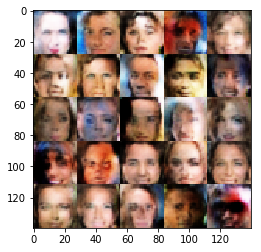

Epoch 1/10... Discriminator Loss: 0.270026... Generator Loss: 2.185950
Epoch 1/10... Discriminator Loss: 1.050823... Generator Loss: 0.703078
Epoch 1/10... Discriminator Loss: 0.258625... Generator Loss: 2.773596
Epoch 1/10... Discriminator Loss: 0.632162... Generator Loss: 1.423314
Epoch 1/10... Discriminator Loss: 0.754768... Generator Loss: 0.992469
Epoch 1/10... Discriminator Loss: 0.526239... Generator Loss: 1.490397
Epoch 1/10... Discriminator Loss: 1.466033... Generator Loss: 0.413602
Epoch 1/10... Discriminator Loss: 0.593986... Generator Loss: 1.153800
Epoch 1/10... Discriminator Loss: 0.203196... Generator Loss: 3.858343
Epoch 1/10... Discriminator Loss: 0.575546... Generator Loss: 1.594321


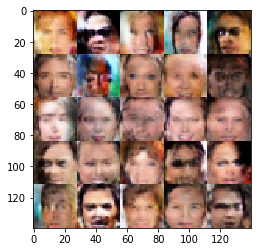

Epoch 1/10... Discriminator Loss: 0.355039... Generator Loss: 1.867778
Epoch 1/10... Discriminator Loss: 1.404852... Generator Loss: 0.693900
Epoch 1/10... Discriminator Loss: 0.456901... Generator Loss: 1.953544
Epoch 1/10... Discriminator Loss: 0.395619... Generator Loss: 2.636091
Epoch 1/10... Discriminator Loss: 0.243975... Generator Loss: 2.779215
Epoch 1/10... Discriminator Loss: 0.344582... Generator Loss: 2.430627
Epoch 1/10... Discriminator Loss: 0.054672... Generator Loss: 4.773290
Epoch 1/10... Discriminator Loss: 0.447315... Generator Loss: 4.064944
Epoch 1/10... Discriminator Loss: 0.117941... Generator Loss: 3.638939
Epoch 1/10... Discriminator Loss: 0.678681... Generator Loss: 1.617872


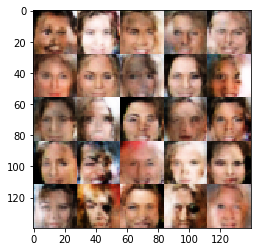

Epoch 1/10... Discriminator Loss: 0.854327... Generator Loss: 0.825871
Epoch 1/10... Discriminator Loss: 1.932981... Generator Loss: 2.821149
Epoch 1/10... Discriminator Loss: 0.739391... Generator Loss: 3.169740
Epoch 1/10... Discriminator Loss: 0.793921... Generator Loss: 2.992906
Epoch 1/10... Discriminator Loss: 0.715183... Generator Loss: 2.232447
Epoch 1/10... Discriminator Loss: 1.875113... Generator Loss: 0.216368
Epoch 1/10... Discriminator Loss: 1.055633... Generator Loss: 0.667770
Epoch 1/10... Discriminator Loss: 1.448441... Generator Loss: 3.574018
Epoch 1/10... Discriminator Loss: 0.887437... Generator Loss: 1.462983
Epoch 1/10... Discriminator Loss: 0.555074... Generator Loss: 1.548608


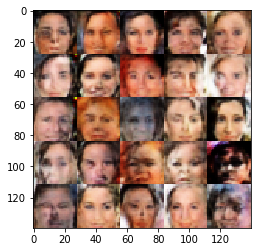

Epoch 1/10... Discriminator Loss: 2.138564... Generator Loss: 3.842630
Epoch 1/10... Discriminator Loss: 0.594923... Generator Loss: 2.092290
Epoch 1/10... Discriminator Loss: 0.895097... Generator Loss: 0.691660
Epoch 1/10... Discriminator Loss: 0.866758... Generator Loss: 0.848285
Epoch 1/10... Discriminator Loss: 0.335298... Generator Loss: 3.356865
Epoch 1/10... Discriminator Loss: 0.134556... Generator Loss: 2.833659
Epoch 1/10... Discriminator Loss: 0.706888... Generator Loss: 0.940160
Epoch 1/10... Discriminator Loss: 0.111052... Generator Loss: 3.004110
Epoch 1/10... Discriminator Loss: 0.057358... Generator Loss: 5.045481
Epoch 1/10... Discriminator Loss: 0.025951... Generator Loss: 6.720277


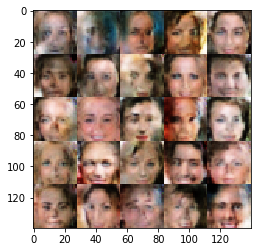

Epoch 1/10... Discriminator Loss: 0.699064... Generator Loss: 1.331240
Epoch 1/10... Discriminator Loss: 0.670369... Generator Loss: 0.956813
Epoch 1/10... Discriminator Loss: 0.444482... Generator Loss: 1.715396
Epoch 1/10... Discriminator Loss: 0.960158... Generator Loss: 3.234991
Epoch 1/10... Discriminator Loss: 2.163003... Generator Loss: 0.211933
Epoch 1/10... Discriminator Loss: 0.807974... Generator Loss: 2.444299
Epoch 1/10... Discriminator Loss: 0.456171... Generator Loss: 1.498088
Epoch 1/10... Discriminator Loss: 0.248467... Generator Loss: 1.986174
Epoch 1/10... Discriminator Loss: 0.496934... Generator Loss: 2.768215
Epoch 1/10... Discriminator Loss: 0.955258... Generator Loss: 7.345178


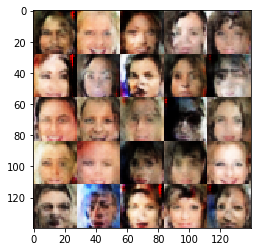

Epoch 1/10... Discriminator Loss: 0.075571... Generator Loss: 3.944066
Epoch 1/10... Discriminator Loss: 0.371027... Generator Loss: 1.836763
Epoch 1/10... Discriminator Loss: 0.025257... Generator Loss: 5.611849
Epoch 1/10... Discriminator Loss: 0.020051... Generator Loss: 5.333396
Epoch 1/10... Discriminator Loss: 0.044509... Generator Loss: 4.147970
Epoch 1/10... Discriminator Loss: 0.023332... Generator Loss: 5.178224
Epoch 1/10... Discriminator Loss: 0.190146... Generator Loss: 2.893557
Epoch 1/10... Discriminator Loss: 1.146244... Generator Loss: 2.403140
Epoch 1/10... Discriminator Loss: 3.841563... Generator Loss: 0.087445
Epoch 1/10... Discriminator Loss: 1.425408... Generator Loss: 3.273521


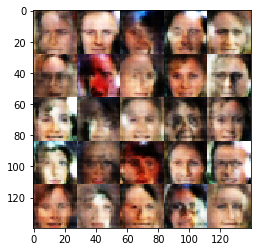

Epoch 1/10... Discriminator Loss: 1.362108... Generator Loss: 3.050638
Epoch 1/10... Discriminator Loss: 0.971435... Generator Loss: 0.921955
Epoch 1/10... Discriminator Loss: 0.214588... Generator Loss: 2.744676
Epoch 1/10... Discriminator Loss: 0.393077... Generator Loss: 1.839791
Epoch 1/10... Discriminator Loss: 0.501242... Generator Loss: 1.456466
Epoch 1/10... Discriminator Loss: 1.490159... Generator Loss: 0.584888
Epoch 1/10... Discriminator Loss: 0.782145... Generator Loss: 1.269940
Epoch 1/10... Discriminator Loss: 0.217912... Generator Loss: 4.246623
Epoch 1/10... Discriminator Loss: 0.164939... Generator Loss: 4.219314
Epoch 1/10... Discriminator Loss: 0.198316... Generator Loss: 3.314270


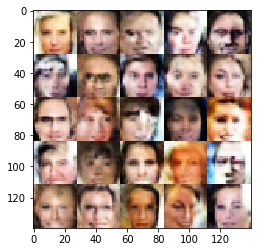

Epoch 1/10... Discriminator Loss: 0.094440... Generator Loss: 3.588348
Epoch 1/10... Discriminator Loss: 0.307689... Generator Loss: 2.444199
Epoch 1/10... Discriminator Loss: 0.596622... Generator Loss: 2.602558
Epoch 1/10... Discriminator Loss: 0.114352... Generator Loss: 3.007248
Epoch 1/10... Discriminator Loss: 0.073283... Generator Loss: 4.346988
Epoch 1/10... Discriminator Loss: 0.770216... Generator Loss: 1.023599
Epoch 1/10... Discriminator Loss: 0.054433... Generator Loss: 3.567634
Epoch 1/10... Discriminator Loss: 0.064083... Generator Loss: 4.533607
Epoch 1/10... Discriminator Loss: 0.019698... Generator Loss: 5.080999
Epoch 1/10... Discriminator Loss: 0.030412... Generator Loss: 4.416665


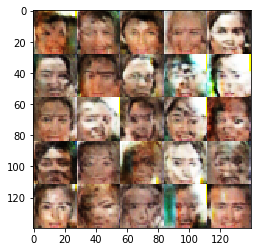

Epoch 1/10... Discriminator Loss: 0.019347... Generator Loss: 5.990314
Epoch 1/10... Discriminator Loss: 0.020168... Generator Loss: 4.616571
Epoch 1/10... Discriminator Loss: 0.011772... Generator Loss: 6.383145
Epoch 1/10... Discriminator Loss: 0.002063... Generator Loss: 7.286554
Epoch 1/10... Discriminator Loss: 0.019134... Generator Loss: 5.690857
Epoch 1/10... Discriminator Loss: 0.013326... Generator Loss: 5.217786
Epoch 1/10... Discriminator Loss: 0.001497... Generator Loss: 7.984220
Epoch 1/10... Discriminator Loss: 0.114937... Generator Loss: 2.925188
Epoch 1/10... Discriminator Loss: 0.009557... Generator Loss: 5.865831
Epoch 1/10... Discriminator Loss: 0.031762... Generator Loss: 6.481305


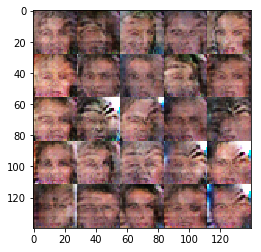

Epoch 1/10... Discriminator Loss: 0.003445... Generator Loss: 11.163144
Epoch 1/10... Discriminator Loss: 0.007990... Generator Loss: 6.533025
Epoch 1/10... Discriminator Loss: 0.023590... Generator Loss: 4.499152
Epoch 1/10... Discriminator Loss: 0.013346... Generator Loss: 8.263397
Epoch 1/10... Discriminator Loss: 0.005759... Generator Loss: 8.056253
Epoch 1/10... Discriminator Loss: 0.022640... Generator Loss: 4.860202
Epoch 1/10... Discriminator Loss: 0.030825... Generator Loss: 4.230753
Epoch 1/10... Discriminator Loss: 0.006514... Generator Loss: 7.543627
Epoch 1/10... Discriminator Loss: 0.034401... Generator Loss: 4.012037
Epoch 1/10... Discriminator Loss: 0.022558... Generator Loss: 4.629010


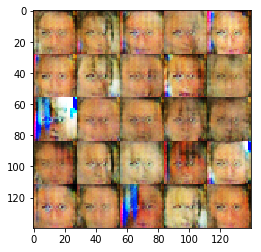

Epoch 1/10... Discriminator Loss: 0.007134... Generator Loss: 6.062737
Epoch 1/10... Discriminator Loss: 0.009402... Generator Loss: 5.815538
Epoch 1/10... Discriminator Loss: 0.014281... Generator Loss: 5.723919
Epoch 1/10... Discriminator Loss: 0.001603... Generator Loss: 7.219629
Epoch 1/10... Discriminator Loss: 0.003481... Generator Loss: 6.292479
Epoch 1/10... Discriminator Loss: 0.005478... Generator Loss: 6.833453
Epoch 1/10... Discriminator Loss: 0.179648... Generator Loss: 4.642357
Epoch 1/10... Discriminator Loss: 0.262244... Generator Loss: 4.774342
Epoch 1/10... Discriminator Loss: 0.254055... Generator Loss: 4.694898
Epoch 1/10... Discriminator Loss: 0.113134... Generator Loss: 3.591250


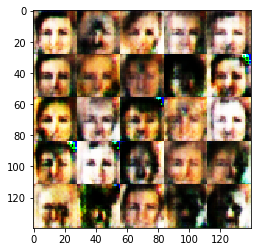

Epoch 1/10... Discriminator Loss: 0.094033... Generator Loss: 4.153494
Epoch 1/10... Discriminator Loss: 0.022375... Generator Loss: 8.668658
Epoch 1/10... Discriminator Loss: 0.213252... Generator Loss: 2.922844
Epoch 1/10... Discriminator Loss: 0.134830... Generator Loss: 2.915622
Epoch 1/10... Discriminator Loss: 0.205665... Generator Loss: 2.802821
Epoch 1/10... Discriminator Loss: 0.027787... Generator Loss: 7.369667
Epoch 1/10... Discriminator Loss: 1.102971... Generator Loss: 0.760692
Epoch 1/10... Discriminator Loss: 1.200371... Generator Loss: 0.778772
Epoch 1/10... Discriminator Loss: 0.190465... Generator Loss: 3.530265
Epoch 1/10... Discriminator Loss: 1.103202... Generator Loss: 0.732486


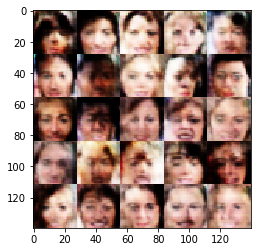

Epoch 1/10... Discriminator Loss: 0.030216... Generator Loss: 5.461992
Epoch 1/10... Discriminator Loss: 0.203894... Generator Loss: 2.608264
Epoch 1/10... Discriminator Loss: 0.188553... Generator Loss: 2.956866
Epoch 1/10... Discriminator Loss: 0.395530... Generator Loss: 6.172258
Epoch 1/10... Discriminator Loss: 0.104001... Generator Loss: 3.805943
Epoch 2/10... Discriminator Loss: 0.945300... Generator Loss: 4.563929
Epoch 2/10... Discriminator Loss: 0.406853... Generator Loss: 3.317155
Epoch 2/10... Discriminator Loss: 0.515865... Generator Loss: 1.481130
Epoch 2/10... Discriminator Loss: 0.067472... Generator Loss: 4.931736
Epoch 2/10... Discriminator Loss: 0.052431... Generator Loss: 4.713148


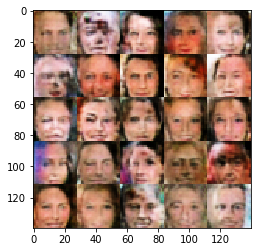

Epoch 2/10... Discriminator Loss: 0.938349... Generator Loss: 0.766710
Epoch 2/10... Discriminator Loss: 0.317200... Generator Loss: 2.119701
Epoch 2/10... Discriminator Loss: 0.211942... Generator Loss: 2.761212
Epoch 2/10... Discriminator Loss: 0.414411... Generator Loss: 1.880974
Epoch 2/10... Discriminator Loss: 0.131589... Generator Loss: 4.351249
Epoch 2/10... Discriminator Loss: 3.663110... Generator Loss: 0.097401
Epoch 2/10... Discriminator Loss: 0.693558... Generator Loss: 1.501622
Epoch 2/10... Discriminator Loss: 0.252249... Generator Loss: 2.471968
Epoch 2/10... Discriminator Loss: 0.396541... Generator Loss: 2.227873
Epoch 2/10... Discriminator Loss: 1.386030... Generator Loss: 0.501509


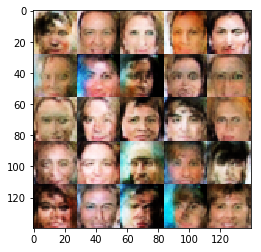

Epoch 2/10... Discriminator Loss: 0.767894... Generator Loss: 0.953922
Epoch 2/10... Discriminator Loss: 1.649438... Generator Loss: 5.052483
Epoch 2/10... Discriminator Loss: 0.601128... Generator Loss: 1.376327
Epoch 2/10... Discriminator Loss: 1.971569... Generator Loss: 2.948605
Epoch 2/10... Discriminator Loss: 0.619988... Generator Loss: 1.381067
Epoch 2/10... Discriminator Loss: 0.365967... Generator Loss: 1.875805
Epoch 2/10... Discriminator Loss: 0.357477... Generator Loss: 3.318135
Epoch 2/10... Discriminator Loss: 1.671816... Generator Loss: 0.492835
Epoch 2/10... Discriminator Loss: 0.420429... Generator Loss: 1.866884
Epoch 2/10... Discriminator Loss: 0.934956... Generator Loss: 3.169410


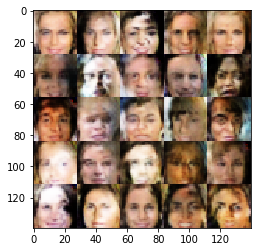

Epoch 2/10... Discriminator Loss: 0.610063... Generator Loss: 2.643828
Epoch 2/10... Discriminator Loss: 0.549960... Generator Loss: 1.420109
Epoch 2/10... Discriminator Loss: 0.487793... Generator Loss: 3.497917
Epoch 2/10... Discriminator Loss: 0.245222... Generator Loss: 2.778948
Epoch 2/10... Discriminator Loss: 0.255390... Generator Loss: 2.419515
Epoch 2/10... Discriminator Loss: 1.613674... Generator Loss: 6.831374
Epoch 2/10... Discriminator Loss: 0.331575... Generator Loss: 2.102040
Epoch 2/10... Discriminator Loss: 0.588788... Generator Loss: 4.665979
Epoch 2/10... Discriminator Loss: 0.596440... Generator Loss: 1.432821
Epoch 2/10... Discriminator Loss: 0.521154... Generator Loss: 1.395819


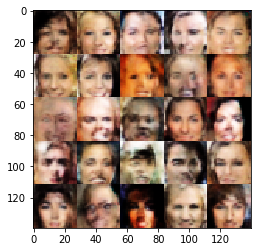

Epoch 2/10... Discriminator Loss: 1.239794... Generator Loss: 0.506298
Epoch 2/10... Discriminator Loss: 0.599051... Generator Loss: 3.279226
Epoch 2/10... Discriminator Loss: 1.784504... Generator Loss: 0.473078
Epoch 2/10... Discriminator Loss: 0.143179... Generator Loss: 3.434936
Epoch 2/10... Discriminator Loss: 0.252499... Generator Loss: 5.321230
Epoch 2/10... Discriminator Loss: 3.052965... Generator Loss: 0.069416
Epoch 2/10... Discriminator Loss: 0.436935... Generator Loss: 1.684108
Epoch 2/10... Discriminator Loss: 1.008285... Generator Loss: 8.597408
Epoch 2/10... Discriminator Loss: 0.431622... Generator Loss: 1.904646
Epoch 2/10... Discriminator Loss: 0.318855... Generator Loss: 3.110006


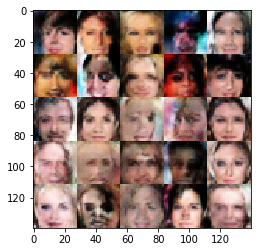

Epoch 2/10... Discriminator Loss: 0.188941... Generator Loss: 2.833353
Epoch 2/10... Discriminator Loss: 0.249229... Generator Loss: 2.391995
Epoch 2/10... Discriminator Loss: 0.027156... Generator Loss: 6.292287
Epoch 2/10... Discriminator Loss: 1.884334... Generator Loss: 0.308495
Epoch 2/10... Discriminator Loss: 0.064265... Generator Loss: 5.084547
Epoch 2/10... Discriminator Loss: 0.610564... Generator Loss: 1.416043
Epoch 2/10... Discriminator Loss: 0.759439... Generator Loss: 0.958635
Epoch 2/10... Discriminator Loss: 0.317614... Generator Loss: 4.522973
Epoch 2/10... Discriminator Loss: 0.151838... Generator Loss: 4.038021
Epoch 2/10... Discriminator Loss: 1.491656... Generator Loss: 0.431661


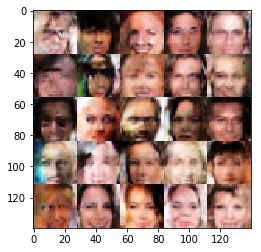

Epoch 2/10... Discriminator Loss: 0.586025... Generator Loss: 1.941819
Epoch 2/10... Discriminator Loss: 0.445774... Generator Loss: 3.527232
Epoch 2/10... Discriminator Loss: 1.207761... Generator Loss: 4.088741
Epoch 2/10... Discriminator Loss: 1.384845... Generator Loss: 6.718919
Epoch 2/10... Discriminator Loss: 0.345637... Generator Loss: 1.860789
Epoch 2/10... Discriminator Loss: 0.593044... Generator Loss: 2.340290
Epoch 2/10... Discriminator Loss: 0.349760... Generator Loss: 1.742457
Epoch 2/10... Discriminator Loss: 0.402084... Generator Loss: 1.971946
Epoch 2/10... Discriminator Loss: 1.720867... Generator Loss: 0.419884
Epoch 2/10... Discriminator Loss: 0.303883... Generator Loss: 2.464801


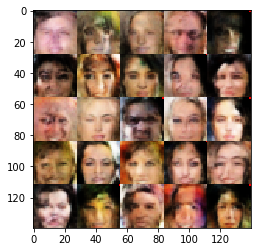

Epoch 2/10... Discriminator Loss: 0.205288... Generator Loss: 2.409790
Epoch 2/10... Discriminator Loss: 1.099387... Generator Loss: 0.635528
Epoch 2/10... Discriminator Loss: 0.507520... Generator Loss: 1.561157
Epoch 2/10... Discriminator Loss: 0.916514... Generator Loss: 0.720537
Epoch 2/10... Discriminator Loss: 0.424368... Generator Loss: 1.649637
Epoch 2/10... Discriminator Loss: 1.669735... Generator Loss: 0.358445
Epoch 2/10... Discriminator Loss: 0.493636... Generator Loss: 1.383700
Epoch 2/10... Discriminator Loss: 0.240828... Generator Loss: 2.256607
Epoch 2/10... Discriminator Loss: 0.085051... Generator Loss: 3.420415
Epoch 2/10... Discriminator Loss: 0.111522... Generator Loss: 3.643265


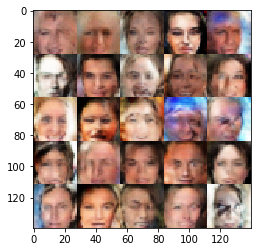

Epoch 2/10... Discriminator Loss: 2.385419... Generator Loss: 0.333297
Epoch 2/10... Discriminator Loss: 0.265050... Generator Loss: 2.525973
Epoch 2/10... Discriminator Loss: 0.324207... Generator Loss: 2.242816
Epoch 2/10... Discriminator Loss: 1.087881... Generator Loss: 0.806387
Epoch 2/10... Discriminator Loss: 6.662807... Generator Loss: 11.087228
Epoch 2/10... Discriminator Loss: 1.651592... Generator Loss: 0.453742
Epoch 2/10... Discriminator Loss: 1.497847... Generator Loss: 0.592518
Epoch 2/10... Discriminator Loss: 0.600832... Generator Loss: 2.951628
Epoch 2/10... Discriminator Loss: 1.581368... Generator Loss: 0.917828
Epoch 2/10... Discriminator Loss: 0.306247... Generator Loss: 2.264533


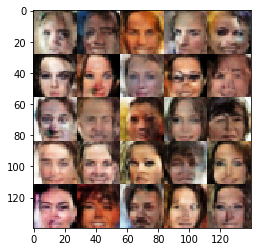

Epoch 2/10... Discriminator Loss: 0.677393... Generator Loss: 1.257447
Epoch 2/10... Discriminator Loss: 0.596883... Generator Loss: 1.372167
Epoch 2/10... Discriminator Loss: 0.471276... Generator Loss: 1.393456
Epoch 2/10... Discriminator Loss: 0.187152... Generator Loss: 3.452707
Epoch 2/10... Discriminator Loss: 0.362396... Generator Loss: 2.168718
Epoch 2/10... Discriminator Loss: 0.234576... Generator Loss: 3.290549
Epoch 2/10... Discriminator Loss: 1.131256... Generator Loss: 0.544734
Epoch 2/10... Discriminator Loss: 0.960429... Generator Loss: 0.838370
Epoch 2/10... Discriminator Loss: 0.295081... Generator Loss: 2.109117
Epoch 2/10... Discriminator Loss: 0.678914... Generator Loss: 3.892362


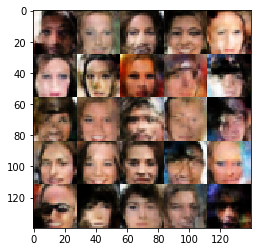

Epoch 2/10... Discriminator Loss: 0.288104... Generator Loss: 2.648478
Epoch 2/10... Discriminator Loss: 0.579929... Generator Loss: 1.302661
Epoch 2/10... Discriminator Loss: 0.290715... Generator Loss: 2.128461
Epoch 2/10... Discriminator Loss: 0.446146... Generator Loss: 3.030046
Epoch 2/10... Discriminator Loss: 0.207763... Generator Loss: 2.875716
Epoch 2/10... Discriminator Loss: 0.273225... Generator Loss: 2.871166
Epoch 2/10... Discriminator Loss: 0.717607... Generator Loss: 5.621012
Epoch 2/10... Discriminator Loss: 0.189542... Generator Loss: 3.165189
Epoch 2/10... Discriminator Loss: 0.134362... Generator Loss: 3.177137
Epoch 2/10... Discriminator Loss: 0.041660... Generator Loss: 4.987361


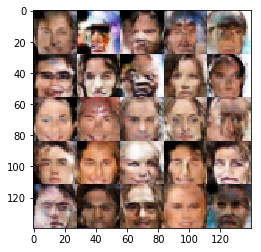

Epoch 2/10... Discriminator Loss: 0.330903... Generator Loss: 3.408800
Epoch 2/10... Discriminator Loss: 0.766043... Generator Loss: 1.506200
Epoch 2/10... Discriminator Loss: 0.512983... Generator Loss: 1.459302
Epoch 2/10... Discriminator Loss: 0.290475... Generator Loss: 2.091958
Epoch 2/10... Discriminator Loss: 0.244729... Generator Loss: 2.293473
Epoch 2/10... Discriminator Loss: 0.306789... Generator Loss: 2.667752
Epoch 2/10... Discriminator Loss: 0.417521... Generator Loss: 4.356912
Epoch 2/10... Discriminator Loss: 0.201445... Generator Loss: 2.628346
Epoch 2/10... Discriminator Loss: 0.047915... Generator Loss: 4.963957
Epoch 2/10... Discriminator Loss: 0.285420... Generator Loss: 3.350388


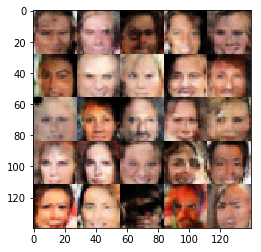

Epoch 2/10... Discriminator Loss: 0.294728... Generator Loss: 2.538448
Epoch 2/10... Discriminator Loss: 0.088684... Generator Loss: 3.958896
Epoch 2/10... Discriminator Loss: 0.412920... Generator Loss: 1.610719
Epoch 2/10... Discriminator Loss: 0.057171... Generator Loss: 5.462302
Epoch 2/10... Discriminator Loss: 0.418624... Generator Loss: 5.071660
Epoch 2/10... Discriminator Loss: 0.458890... Generator Loss: 1.353578
Epoch 2/10... Discriminator Loss: 0.058027... Generator Loss: 5.102779
Epoch 2/10... Discriminator Loss: 1.616212... Generator Loss: 9.973753
Epoch 2/10... Discriminator Loss: 1.636386... Generator Loss: 0.349031
Epoch 2/10... Discriminator Loss: 0.279948... Generator Loss: 3.487014


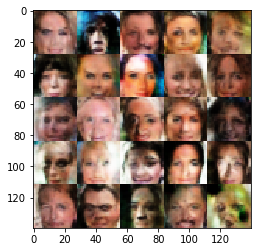

Epoch 2/10... Discriminator Loss: 0.255949... Generator Loss: 2.084598
Epoch 2/10... Discriminator Loss: 0.222595... Generator Loss: 3.700295
Epoch 2/10... Discriminator Loss: 0.817158... Generator Loss: 1.032826
Epoch 2/10... Discriminator Loss: 0.241399... Generator Loss: 4.387079
Epoch 2/10... Discriminator Loss: 0.294719... Generator Loss: 2.117449
Epoch 2/10... Discriminator Loss: 0.477987... Generator Loss: 4.238287
Epoch 2/10... Discriminator Loss: 0.173897... Generator Loss: 4.734787
Epoch 2/10... Discriminator Loss: 1.443783... Generator Loss: 0.537868
Epoch 2/10... Discriminator Loss: 1.551570... Generator Loss: 0.493046
Epoch 2/10... Discriminator Loss: 2.869497... Generator Loss: 0.232165


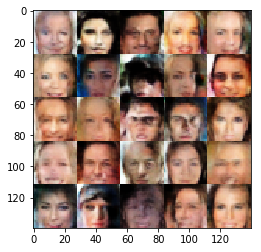

Epoch 2/10... Discriminator Loss: 0.237973... Generator Loss: 4.093004
Epoch 2/10... Discriminator Loss: 0.891636... Generator Loss: 0.943963
Epoch 2/10... Discriminator Loss: 0.304015... Generator Loss: 2.825304
Epoch 2/10... Discriminator Loss: 1.567386... Generator Loss: 0.471608
Epoch 2/10... Discriminator Loss: 0.593183... Generator Loss: 1.241755
Epoch 2/10... Discriminator Loss: 0.143977... Generator Loss: 3.999775
Epoch 2/10... Discriminator Loss: 0.515091... Generator Loss: 1.497221
Epoch 2/10... Discriminator Loss: 0.658481... Generator Loss: 1.159977
Epoch 2/10... Discriminator Loss: 0.631752... Generator Loss: 1.123435
Epoch 2/10... Discriminator Loss: 0.255896... Generator Loss: 2.250138


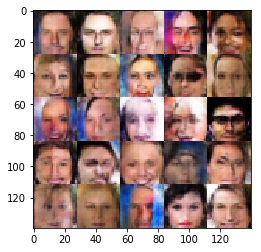

Epoch 2/10... Discriminator Loss: 0.357895... Generator Loss: 1.679638
Epoch 2/10... Discriminator Loss: 0.604292... Generator Loss: 1.152376
Epoch 2/10... Discriminator Loss: 0.402021... Generator Loss: 1.973979
Epoch 2/10... Discriminator Loss: 0.090201... Generator Loss: 5.811721
Epoch 2/10... Discriminator Loss: 0.426546... Generator Loss: 1.916426
Epoch 2/10... Discriminator Loss: 0.145091... Generator Loss: 2.715939
Epoch 2/10... Discriminator Loss: 0.027851... Generator Loss: 5.200368
Epoch 2/10... Discriminator Loss: 0.265785... Generator Loss: 5.225676
Epoch 2/10... Discriminator Loss: 0.188392... Generator Loss: 3.444143
Epoch 2/10... Discriminator Loss: 2.154445... Generator Loss: 5.112953


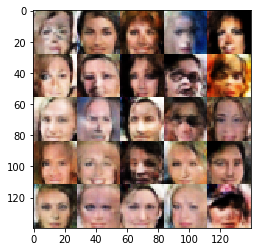

Epoch 2/10... Discriminator Loss: 1.327111... Generator Loss: 2.643828
Epoch 2/10... Discriminator Loss: 1.791253... Generator Loss: 1.057517
Epoch 2/10... Discriminator Loss: 0.673067... Generator Loss: 1.504243
Epoch 2/10... Discriminator Loss: 1.406147... Generator Loss: 3.723173
Epoch 2/10... Discriminator Loss: 0.777434... Generator Loss: 1.338452
Epoch 2/10... Discriminator Loss: 1.082336... Generator Loss: 0.905626
Epoch 2/10... Discriminator Loss: 0.539107... Generator Loss: 2.081138
Epoch 2/10... Discriminator Loss: 0.556163... Generator Loss: 1.725873
Epoch 2/10... Discriminator Loss: 0.465817... Generator Loss: 2.437974
Epoch 2/10... Discriminator Loss: 0.621700... Generator Loss: 2.089113


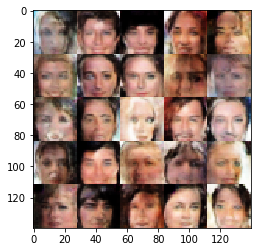

Epoch 2/10... Discriminator Loss: 0.293295... Generator Loss: 1.947188
Epoch 2/10... Discriminator Loss: 0.328380... Generator Loss: 2.054087
Epoch 2/10... Discriminator Loss: 0.603786... Generator Loss: 3.340922
Epoch 2/10... Discriminator Loss: 0.336512... Generator Loss: 2.281987
Epoch 2/10... Discriminator Loss: 0.462328... Generator Loss: 1.773757
Epoch 2/10... Discriminator Loss: 0.250849... Generator Loss: 2.582843
Epoch 2/10... Discriminator Loss: 0.765919... Generator Loss: 1.023891
Epoch 2/10... Discriminator Loss: 0.259513... Generator Loss: 2.182756
Epoch 2/10... Discriminator Loss: 0.679644... Generator Loss: 1.179567
Epoch 2/10... Discriminator Loss: 0.306989... Generator Loss: 2.419600


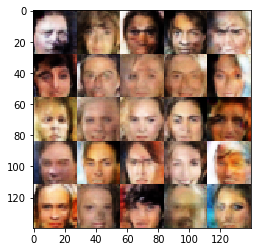

Epoch 2/10... Discriminator Loss: 0.164746... Generator Loss: 3.312678
Epoch 2/10... Discriminator Loss: 0.239563... Generator Loss: 2.382224
Epoch 2/10... Discriminator Loss: 0.243564... Generator Loss: 2.401976
Epoch 2/10... Discriminator Loss: 0.120369... Generator Loss: 3.417872
Epoch 2/10... Discriminator Loss: 0.035111... Generator Loss: 8.796988
Epoch 2/10... Discriminator Loss: 0.294006... Generator Loss: 2.045809
Epoch 2/10... Discriminator Loss: 0.393043... Generator Loss: 4.108808
Epoch 2/10... Discriminator Loss: 0.143101... Generator Loss: 3.011098
Epoch 2/10... Discriminator Loss: 0.389439... Generator Loss: 5.270763
Epoch 2/10... Discriminator Loss: 0.173370... Generator Loss: 2.774413


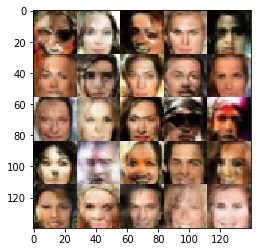

Epoch 2/10... Discriminator Loss: 0.504805... Generator Loss: 1.881437
Epoch 2/10... Discriminator Loss: 0.210865... Generator Loss: 4.408813
Epoch 2/10... Discriminator Loss: 0.806765... Generator Loss: 0.955592
Epoch 2/10... Discriminator Loss: 0.191289... Generator Loss: 2.326979
Epoch 2/10... Discriminator Loss: 0.333967... Generator Loss: 4.638813
Epoch 2/10... Discriminator Loss: 3.297582... Generator Loss: 0.345107
Epoch 2/10... Discriminator Loss: 0.574278... Generator Loss: 1.547996
Epoch 2/10... Discriminator Loss: 0.309933... Generator Loss: 3.171129
Epoch 2/10... Discriminator Loss: 0.136218... Generator Loss: 3.591690
Epoch 2/10... Discriminator Loss: 0.246807... Generator Loss: 2.507589


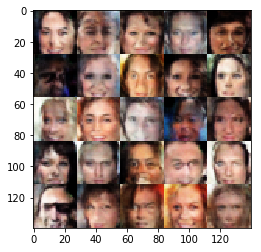

Epoch 2/10... Discriminator Loss: 0.383720... Generator Loss: 1.864981
Epoch 2/10... Discriminator Loss: 0.397691... Generator Loss: 2.008774
Epoch 2/10... Discriminator Loss: 0.388096... Generator Loss: 1.608135
Epoch 2/10... Discriminator Loss: 0.166367... Generator Loss: 2.455885
Epoch 2/10... Discriminator Loss: 0.169920... Generator Loss: 2.820846
Epoch 2/10... Discriminator Loss: 0.155219... Generator Loss: 2.859503
Epoch 2/10... Discriminator Loss: 0.138224... Generator Loss: 2.844240
Epoch 2/10... Discriminator Loss: 0.194428... Generator Loss: 2.357594
Epoch 2/10... Discriminator Loss: 0.041745... Generator Loss: 5.737587
Epoch 2/10... Discriminator Loss: 0.147869... Generator Loss: 2.782467


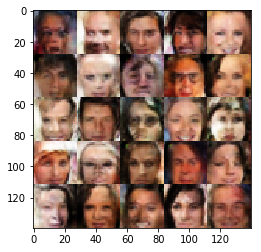

Epoch 2/10... Discriminator Loss: 0.314252... Generator Loss: 2.791276
Epoch 2/10... Discriminator Loss: 0.185146... Generator Loss: 2.581570
Epoch 2/10... Discriminator Loss: 0.113175... Generator Loss: 3.004694
Epoch 2/10... Discriminator Loss: 0.519419... Generator Loss: 1.427022
Epoch 2/10... Discriminator Loss: 0.038293... Generator Loss: 4.535827
Epoch 2/10... Discriminator Loss: 0.129911... Generator Loss: 6.097078
Epoch 2/10... Discriminator Loss: 0.082800... Generator Loss: 7.094288
Epoch 2/10... Discriminator Loss: 0.095651... Generator Loss: 4.597546
Epoch 2/10... Discriminator Loss: 0.043175... Generator Loss: 4.327415
Epoch 2/10... Discriminator Loss: 0.121673... Generator Loss: 3.084306


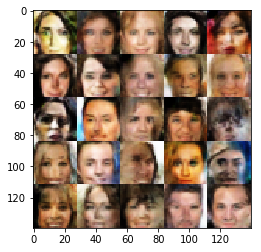

Epoch 2/10... Discriminator Loss: 0.025125... Generator Loss: 5.952124
Epoch 2/10... Discriminator Loss: 0.325251... Generator Loss: 1.854101
Epoch 2/10... Discriminator Loss: 10.945029... Generator Loss: 12.515757
Epoch 2/10... Discriminator Loss: 1.764221... Generator Loss: 0.838582
Epoch 2/10... Discriminator Loss: 1.154733... Generator Loss: 0.819676
Epoch 2/10... Discriminator Loss: 1.191005... Generator Loss: 0.924558
Epoch 2/10... Discriminator Loss: 1.498476... Generator Loss: 0.798923
Epoch 2/10... Discriminator Loss: 1.073067... Generator Loss: 1.742426
Epoch 2/10... Discriminator Loss: 0.771247... Generator Loss: 1.524896
Epoch 2/10... Discriminator Loss: 0.857102... Generator Loss: 0.904208


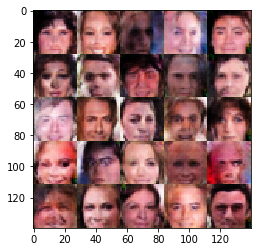

Epoch 2/10... Discriminator Loss: 0.894879... Generator Loss: 2.852446
Epoch 2/10... Discriminator Loss: 0.819549... Generator Loss: 2.064228
Epoch 2/10... Discriminator Loss: 0.828231... Generator Loss: 2.813151
Epoch 2/10... Discriminator Loss: 0.610419... Generator Loss: 1.653670
Epoch 2/10... Discriminator Loss: 0.482216... Generator Loss: 1.655455
Epoch 2/10... Discriminator Loss: 0.668642... Generator Loss: 1.281796
Epoch 2/10... Discriminator Loss: 0.300540... Generator Loss: 2.704344
Epoch 2/10... Discriminator Loss: 0.808887... Generator Loss: 1.189953
Epoch 2/10... Discriminator Loss: 0.104293... Generator Loss: 3.894041
Epoch 2/10... Discriminator Loss: 0.168881... Generator Loss: 2.753765


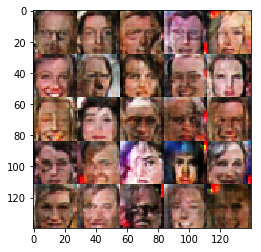

Epoch 2/10... Discriminator Loss: 0.111869... Generator Loss: 3.335370
Epoch 2/10... Discriminator Loss: 0.036275... Generator Loss: 4.927802
Epoch 2/10... Discriminator Loss: 0.082696... Generator Loss: 3.730019
Epoch 2/10... Discriminator Loss: 0.221005... Generator Loss: 2.331542
Epoch 2/10... Discriminator Loss: 0.133177... Generator Loss: 2.802148
Epoch 2/10... Discriminator Loss: 0.069720... Generator Loss: 4.412959
Epoch 2/10... Discriminator Loss: 0.121372... Generator Loss: 3.088992
Epoch 2/10... Discriminator Loss: 0.100330... Generator Loss: 3.188934
Epoch 2/10... Discriminator Loss: 0.043716... Generator Loss: 4.148886
Epoch 2/10... Discriminator Loss: 0.029446... Generator Loss: 4.330171


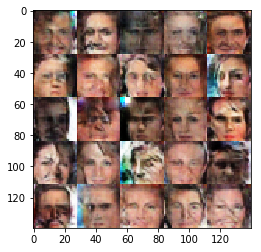

Epoch 2/10... Discriminator Loss: 0.129171... Generator Loss: 2.743796
Epoch 2/10... Discriminator Loss: 0.013202... Generator Loss: 5.959161
Epoch 2/10... Discriminator Loss: 0.052195... Generator Loss: 3.979645
Epoch 2/10... Discriminator Loss: 0.023702... Generator Loss: 4.908154
Epoch 2/10... Discriminator Loss: 0.195286... Generator Loss: 2.314076
Epoch 2/10... Discriminator Loss: 1.102211... Generator Loss: 0.880043
Epoch 2/10... Discriminator Loss: 0.051962... Generator Loss: 4.904380
Epoch 2/10... Discriminator Loss: 0.392719... Generator Loss: 1.902099
Epoch 2/10... Discriminator Loss: 1.378529... Generator Loss: 1.751413
Epoch 2/10... Discriminator Loss: 1.419217... Generator Loss: 2.413596


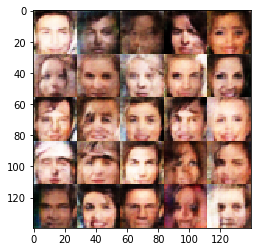

Epoch 2/10... Discriminator Loss: 1.091113... Generator Loss: 3.212432
Epoch 2/10... Discriminator Loss: 0.556644... Generator Loss: 1.525047
Epoch 2/10... Discriminator Loss: 0.694481... Generator Loss: 1.182997
Epoch 2/10... Discriminator Loss: 0.669891... Generator Loss: 1.698171
Epoch 2/10... Discriminator Loss: 1.287920... Generator Loss: 3.015826
Epoch 2/10... Discriminator Loss: 1.037438... Generator Loss: 3.745965
Epoch 2/10... Discriminator Loss: 0.761781... Generator Loss: 3.181477
Epoch 2/10... Discriminator Loss: 0.586016... Generator Loss: 1.801104
Epoch 2/10... Discriminator Loss: 1.497483... Generator Loss: 5.061728
Epoch 2/10... Discriminator Loss: 1.418938... Generator Loss: 0.509270


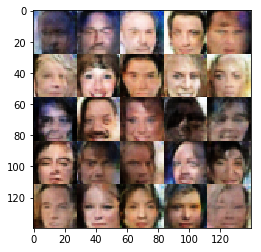

Epoch 2/10... Discriminator Loss: 1.758766... Generator Loss: 4.470387
Epoch 2/10... Discriminator Loss: 1.077725... Generator Loss: 0.908673
Epoch 2/10... Discriminator Loss: 0.707498... Generator Loss: 2.770372
Epoch 2/10... Discriminator Loss: 0.368327... Generator Loss: 2.697128
Epoch 2/10... Discriminator Loss: 1.908350... Generator Loss: 0.379641
Epoch 2/10... Discriminator Loss: 0.653983... Generator Loss: 1.292363
Epoch 2/10... Discriminator Loss: 0.290738... Generator Loss: 2.173318
Epoch 2/10... Discriminator Loss: 0.638512... Generator Loss: 2.225878
Epoch 2/10... Discriminator Loss: 0.987311... Generator Loss: 0.823042
Epoch 2/10... Discriminator Loss: 0.945457... Generator Loss: 0.781146


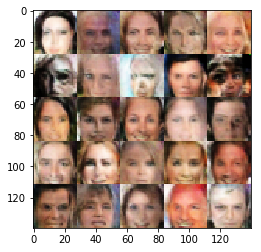

Epoch 2/10... Discriminator Loss: 0.159998... Generator Loss: 4.648149
Epoch 2/10... Discriminator Loss: 2.297463... Generator Loss: 0.260355
Epoch 2/10... Discriminator Loss: 0.202913... Generator Loss: 3.266024
Epoch 2/10... Discriminator Loss: 0.162797... Generator Loss: 3.237858
Epoch 2/10... Discriminator Loss: 0.244008... Generator Loss: 2.475881
Epoch 2/10... Discriminator Loss: 0.095246... Generator Loss: 3.552408
Epoch 2/10... Discriminator Loss: 0.283581... Generator Loss: 2.399384
Epoch 2/10... Discriminator Loss: 0.083910... Generator Loss: 3.679056
Epoch 2/10... Discriminator Loss: 0.145997... Generator Loss: 3.061262
Epoch 2/10... Discriminator Loss: 0.039351... Generator Loss: 5.075511


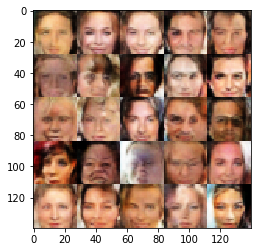

Epoch 2/10... Discriminator Loss: 0.099880... Generator Loss: 3.274860
Epoch 2/10... Discriminator Loss: 0.424204... Generator Loss: 8.396061
Epoch 2/10... Discriminator Loss: 0.059078... Generator Loss: 4.740482
Epoch 2/10... Discriminator Loss: 0.140942... Generator Loss: 5.471679
Epoch 2/10... Discriminator Loss: 0.447904... Generator Loss: 1.635594
Epoch 2/10... Discriminator Loss: 0.100568... Generator Loss: 3.458004
Epoch 2/10... Discriminator Loss: 0.383520... Generator Loss: 2.956398
Epoch 2/10... Discriminator Loss: 0.376900... Generator Loss: 1.900579
Epoch 2/10... Discriminator Loss: 0.212989... Generator Loss: 2.358646
Epoch 2/10... Discriminator Loss: 0.438791... Generator Loss: 1.510180


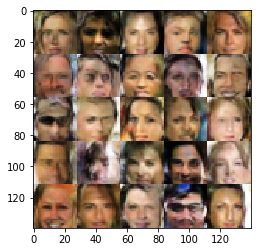

Epoch 2/10... Discriminator Loss: 0.095572... Generator Loss: 3.687368
Epoch 2/10... Discriminator Loss: 0.909997... Generator Loss: 0.965971
Epoch 2/10... Discriminator Loss: 0.490121... Generator Loss: 1.412388
Epoch 2/10... Discriminator Loss: 0.204391... Generator Loss: 4.247074
Epoch 2/10... Discriminator Loss: 0.092181... Generator Loss: 3.762308
Epoch 2/10... Discriminator Loss: 0.170074... Generator Loss: 2.420286
Epoch 2/10... Discriminator Loss: 0.070268... Generator Loss: 3.934296
Epoch 2/10... Discriminator Loss: 0.207469... Generator Loss: 2.278481
Epoch 2/10... Discriminator Loss: 0.109021... Generator Loss: 3.056831
Epoch 2/10... Discriminator Loss: 0.110878... Generator Loss: 9.481110


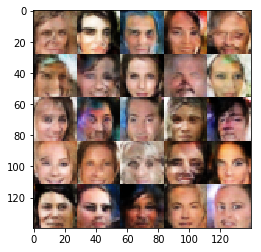

Epoch 2/10... Discriminator Loss: 0.312841... Generator Loss: 1.950668
Epoch 2/10... Discriminator Loss: 0.125332... Generator Loss: 2.902752
Epoch 2/10... Discriminator Loss: 0.103667... Generator Loss: 4.150136
Epoch 2/10... Discriminator Loss: 3.573147... Generator Loss: 5.491879
Epoch 2/10... Discriminator Loss: 1.682878... Generator Loss: 0.606324
Epoch 2/10... Discriminator Loss: 0.902772... Generator Loss: 0.888608
Epoch 2/10... Discriminator Loss: 0.644598... Generator Loss: 1.242414
Epoch 2/10... Discriminator Loss: 3.087680... Generator Loss: 0.233653
Epoch 2/10... Discriminator Loss: 2.221771... Generator Loss: 0.202806
Epoch 2/10... Discriminator Loss: 0.871362... Generator Loss: 1.043940


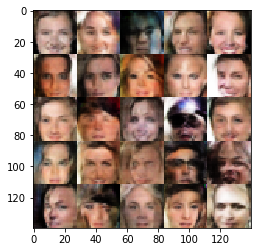

Epoch 2/10... Discriminator Loss: 0.503383... Generator Loss: 1.966964
Epoch 2/10... Discriminator Loss: 0.694999... Generator Loss: 2.349553
Epoch 2/10... Discriminator Loss: 0.495755... Generator Loss: 1.547965
Epoch 2/10... Discriminator Loss: 0.330180... Generator Loss: 3.049065
Epoch 2/10... Discriminator Loss: 0.482080... Generator Loss: 1.833499
Epoch 2/10... Discriminator Loss: 0.461542... Generator Loss: 1.829268
Epoch 2/10... Discriminator Loss: 0.418914... Generator Loss: 1.657076
Epoch 2/10... Discriminator Loss: 0.555903... Generator Loss: 1.347694
Epoch 2/10... Discriminator Loss: 0.724592... Generator Loss: 0.966013
Epoch 2/10... Discriminator Loss: 0.396858... Generator Loss: 2.274419


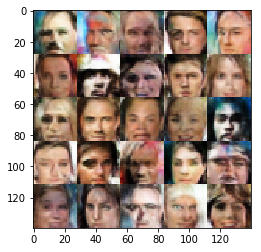

Epoch 2/10... Discriminator Loss: 0.249708... Generator Loss: 4.330800
Epoch 2/10... Discriminator Loss: 0.266117... Generator Loss: 2.234554
Epoch 2/10... Discriminator Loss: 0.138083... Generator Loss: 3.405804
Epoch 2/10... Discriminator Loss: 0.157346... Generator Loss: 2.781099
Epoch 2/10... Discriminator Loss: 0.362125... Generator Loss: 1.688033
Epoch 2/10... Discriminator Loss: 0.700588... Generator Loss: 1.106952
Epoch 2/10... Discriminator Loss: 0.147497... Generator Loss: 2.998406
Epoch 2/10... Discriminator Loss: 0.686409... Generator Loss: 1.123316
Epoch 2/10... Discriminator Loss: 0.173864... Generator Loss: 2.620893
Epoch 2/10... Discriminator Loss: 0.033441... Generator Loss: 4.544751


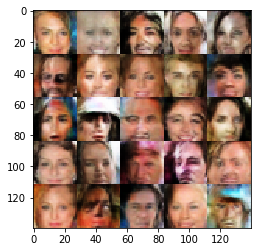

Epoch 2/10... Discriminator Loss: 0.087958... Generator Loss: 3.576611
Epoch 2/10... Discriminator Loss: 0.101509... Generator Loss: 4.162246
Epoch 2/10... Discriminator Loss: 0.091051... Generator Loss: 4.498587
Epoch 2/10... Discriminator Loss: 0.088904... Generator Loss: 4.787282
Epoch 2/10... Discriminator Loss: 0.089928... Generator Loss: 3.664209
Epoch 2/10... Discriminator Loss: 0.077523... Generator Loss: 4.927307
Epoch 2/10... Discriminator Loss: 0.402605... Generator Loss: 1.645763
Epoch 2/10... Discriminator Loss: 4.783273... Generator Loss: 0.085026
Epoch 2/10... Discriminator Loss: 1.237203... Generator Loss: 0.783371
Epoch 2/10... Discriminator Loss: 1.401676... Generator Loss: 0.583920


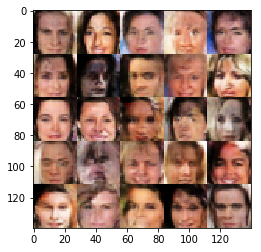

Epoch 2/10... Discriminator Loss: 0.632237... Generator Loss: 1.631225
Epoch 2/10... Discriminator Loss: 0.500861... Generator Loss: 1.529108
Epoch 2/10... Discriminator Loss: 1.355652... Generator Loss: 5.995250
Epoch 2/10... Discriminator Loss: 1.304258... Generator Loss: 3.459397
Epoch 2/10... Discriminator Loss: 1.028770... Generator Loss: 0.895170
Epoch 2/10... Discriminator Loss: 0.303756... Generator Loss: 3.359188
Epoch 2/10... Discriminator Loss: 0.237526... Generator Loss: 3.021135
Epoch 2/10... Discriminator Loss: 0.397928... Generator Loss: 4.022180
Epoch 2/10... Discriminator Loss: 0.381560... Generator Loss: 1.767718
Epoch 2/10... Discriminator Loss: 0.134747... Generator Loss: 2.844580


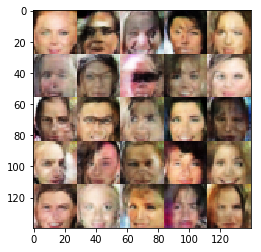

Epoch 2/10... Discriminator Loss: 0.249257... Generator Loss: 2.190433
Epoch 2/10... Discriminator Loss: 0.214262... Generator Loss: 2.548208
Epoch 2/10... Discriminator Loss: 0.266800... Generator Loss: 2.038747
Epoch 2/10... Discriminator Loss: 0.183502... Generator Loss: 4.052862
Epoch 2/10... Discriminator Loss: 0.079252... Generator Loss: 5.724790
Epoch 2/10... Discriminator Loss: 0.326044... Generator Loss: 2.015507
Epoch 2/10... Discriminator Loss: 1.320261... Generator Loss: 0.649707
Epoch 2/10... Discriminator Loss: 0.319341... Generator Loss: 2.327578
Epoch 2/10... Discriminator Loss: 0.444525... Generator Loss: 1.484650
Epoch 2/10... Discriminator Loss: 0.207613... Generator Loss: 2.727929


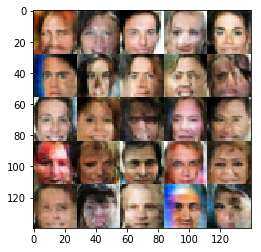

Epoch 2/10... Discriminator Loss: 0.202948... Generator Loss: 3.934448
Epoch 2/10... Discriminator Loss: 1.556301... Generator Loss: 0.489932
Epoch 2/10... Discriminator Loss: 0.101247... Generator Loss: 3.343776
Epoch 2/10... Discriminator Loss: 1.348714... Generator Loss: 0.504041
Epoch 2/10... Discriminator Loss: 0.204638... Generator Loss: 2.410740
Epoch 2/10... Discriminator Loss: 0.152208... Generator Loss: 2.813268
Epoch 2/10... Discriminator Loss: 0.088401... Generator Loss: 3.979378
Epoch 2/10... Discriminator Loss: 0.285349... Generator Loss: 2.327463
Epoch 2/10... Discriminator Loss: 0.198660... Generator Loss: 3.281918
Epoch 2/10... Discriminator Loss: 1.042234... Generator Loss: 4.076202


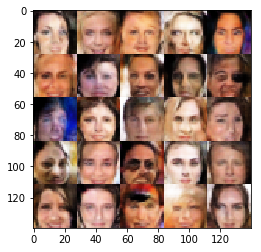

Epoch 2/10... Discriminator Loss: 0.620821... Generator Loss: 1.409407
Epoch 2/10... Discriminator Loss: 1.089072... Generator Loss: 0.807933
Epoch 2/10... Discriminator Loss: 1.410640... Generator Loss: 0.734198
Epoch 2/10... Discriminator Loss: 0.699942... Generator Loss: 3.671716
Epoch 2/10... Discriminator Loss: 0.925813... Generator Loss: 1.092952
Epoch 2/10... Discriminator Loss: 0.236566... Generator Loss: 2.427783
Epoch 2/10... Discriminator Loss: 0.098248... Generator Loss: 3.668288
Epoch 2/10... Discriminator Loss: 0.296137... Generator Loss: 2.197157
Epoch 2/10... Discriminator Loss: 0.739814... Generator Loss: 4.957131
Epoch 2/10... Discriminator Loss: 2.711138... Generator Loss: 0.161213


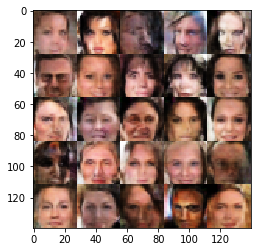

Epoch 2/10... Discriminator Loss: 1.409838... Generator Loss: 0.795530
Epoch 2/10... Discriminator Loss: 0.365158... Generator Loss: 1.768220
Epoch 2/10... Discriminator Loss: 0.715982... Generator Loss: 1.124471
Epoch 2/10... Discriminator Loss: 0.271434... Generator Loss: 2.510244
Epoch 2/10... Discriminator Loss: 0.115141... Generator Loss: 3.719313
Epoch 2/10... Discriminator Loss: 0.177928... Generator Loss: 2.429060
Epoch 2/10... Discriminator Loss: 1.218407... Generator Loss: 6.194680
Epoch 2/10... Discriminator Loss: 0.281622... Generator Loss: 2.725161
Epoch 2/10... Discriminator Loss: 0.057918... Generator Loss: 4.498809
Epoch 2/10... Discriminator Loss: 0.231683... Generator Loss: 2.246809


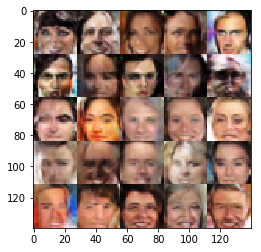

Epoch 2/10... Discriminator Loss: 0.219287... Generator Loss: 2.377800
Epoch 2/10... Discriminator Loss: 0.185685... Generator Loss: 2.338575
Epoch 2/10... Discriminator Loss: 0.262500... Generator Loss: 5.072545
Epoch 2/10... Discriminator Loss: 0.048360... Generator Loss: 4.805021
Epoch 2/10... Discriminator Loss: 0.165868... Generator Loss: 4.379754
Epoch 2/10... Discriminator Loss: 0.071279... Generator Loss: 4.181553
Epoch 2/10... Discriminator Loss: 0.206918... Generator Loss: 4.860686
Epoch 2/10... Discriminator Loss: 0.773686... Generator Loss: 1.366523
Epoch 2/10... Discriminator Loss: 0.035748... Generator Loss: 4.646500
Epoch 2/10... Discriminator Loss: 0.370008... Generator Loss: 1.948178


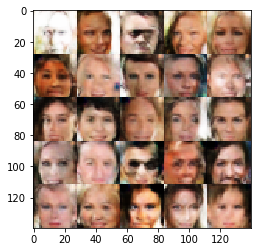

Epoch 3/10... Discriminator Loss: 0.370522... Generator Loss: 1.794218
Epoch 3/10... Discriminator Loss: 0.273748... Generator Loss: 2.073241
Epoch 3/10... Discriminator Loss: 0.132996... Generator Loss: 6.188398
Epoch 3/10... Discriminator Loss: 0.202890... Generator Loss: 2.160618
Epoch 3/10... Discriminator Loss: 0.092401... Generator Loss: 4.261451
Epoch 3/10... Discriminator Loss: 0.038597... Generator Loss: 5.783778
Epoch 3/10... Discriminator Loss: 0.041022... Generator Loss: 4.849837
Epoch 3/10... Discriminator Loss: 0.015995... Generator Loss: 8.249800
Epoch 3/10... Discriminator Loss: 0.124029... Generator Loss: 5.186138
Epoch 3/10... Discriminator Loss: 0.078658... Generator Loss: 3.541777


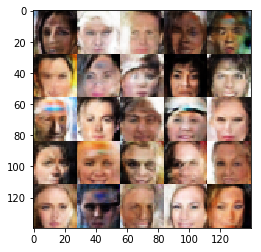

Epoch 3/10... Discriminator Loss: 0.112240... Generator Loss: 6.823612
Epoch 3/10... Discriminator Loss: 2.392228... Generator Loss: 7.110131
Epoch 3/10... Discriminator Loss: 1.976898... Generator Loss: 2.217024
Epoch 3/10... Discriminator Loss: 1.085881... Generator Loss: 1.061012
Epoch 3/10... Discriminator Loss: 0.732948... Generator Loss: 1.303136
Epoch 3/10... Discriminator Loss: 0.823284... Generator Loss: 1.448444
Epoch 3/10... Discriminator Loss: 0.810079... Generator Loss: 2.431767
Epoch 3/10... Discriminator Loss: 0.890784... Generator Loss: 3.199805
Epoch 3/10... Discriminator Loss: 0.515484... Generator Loss: 1.908802
Epoch 3/10... Discriminator Loss: 0.448241... Generator Loss: 2.275803


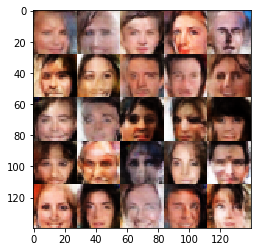

Epoch 3/10... Discriminator Loss: 0.764947... Generator Loss: 3.653173
Epoch 3/10... Discriminator Loss: 1.733846... Generator Loss: 3.537024
Epoch 3/10... Discriminator Loss: 0.941870... Generator Loss: 3.750207
Epoch 3/10... Discriminator Loss: 0.918568... Generator Loss: 3.954898
Epoch 3/10... Discriminator Loss: 1.607943... Generator Loss: 7.131468
Epoch 3/10... Discriminator Loss: 0.508951... Generator Loss: 2.220752
Epoch 3/10... Discriminator Loss: 0.905453... Generator Loss: 4.532286
Epoch 3/10... Discriminator Loss: 1.060717... Generator Loss: 3.893774
Epoch 3/10... Discriminator Loss: 0.820634... Generator Loss: 1.018161
Epoch 3/10... Discriminator Loss: 0.959995... Generator Loss: 0.752213


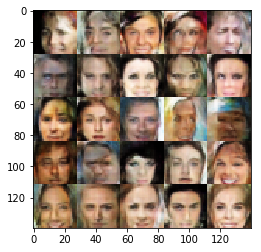

Epoch 3/10... Discriminator Loss: 0.303818... Generator Loss: 2.201173
Epoch 3/10... Discriminator Loss: 0.288387... Generator Loss: 2.224592
Epoch 3/10... Discriminator Loss: 0.328410... Generator Loss: 4.700614
Epoch 3/10... Discriminator Loss: 0.174523... Generator Loss: 3.614120
Epoch 3/10... Discriminator Loss: 0.356234... Generator Loss: 4.915865
Epoch 3/10... Discriminator Loss: 0.165857... Generator Loss: 5.066565
Epoch 3/10... Discriminator Loss: 0.494228... Generator Loss: 2.326124
Epoch 3/10... Discriminator Loss: 0.213213... Generator Loss: 2.642915
Epoch 3/10... Discriminator Loss: 0.705454... Generator Loss: 3.904756
Epoch 3/10... Discriminator Loss: 0.143334... Generator Loss: 3.261624


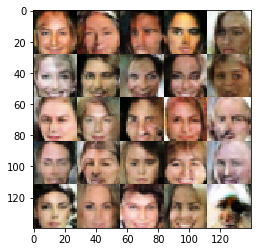

Epoch 3/10... Discriminator Loss: 0.347422... Generator Loss: 1.708531
Epoch 3/10... Discriminator Loss: 0.149963... Generator Loss: 3.434262
Epoch 3/10... Discriminator Loss: 0.110738... Generator Loss: 3.623573
Epoch 3/10... Discriminator Loss: 0.128679... Generator Loss: 3.655535
Epoch 3/10... Discriminator Loss: 0.123012... Generator Loss: 3.358494
Epoch 3/10... Discriminator Loss: 0.095479... Generator Loss: 3.738621
Epoch 3/10... Discriminator Loss: 2.528128... Generator Loss: 0.304546
Epoch 3/10... Discriminator Loss: 1.214646... Generator Loss: 0.641462
Epoch 3/10... Discriminator Loss: 0.551574... Generator Loss: 1.560085
Epoch 3/10... Discriminator Loss: 0.287181... Generator Loss: 2.482262


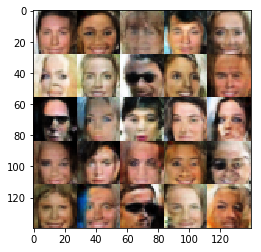

Epoch 3/10... Discriminator Loss: 0.156031... Generator Loss: 2.801624
Epoch 3/10... Discriminator Loss: 0.338141... Generator Loss: 2.098710
Epoch 3/10... Discriminator Loss: 0.330109... Generator Loss: 1.939561
Epoch 3/10... Discriminator Loss: 0.429044... Generator Loss: 1.601445
Epoch 3/10... Discriminator Loss: 0.084329... Generator Loss: 4.266086
Epoch 3/10... Discriminator Loss: 0.054204... Generator Loss: 5.545705
Epoch 3/10... Discriminator Loss: 0.224939... Generator Loss: 2.535822
Epoch 3/10... Discriminator Loss: 0.521728... Generator Loss: 1.399438
Epoch 3/10... Discriminator Loss: 0.476267... Generator Loss: 1.492667
Epoch 3/10... Discriminator Loss: 0.259546... Generator Loss: 2.304863


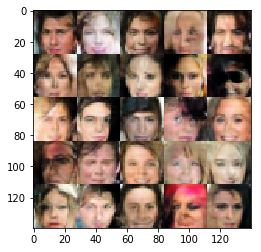

Epoch 3/10... Discriminator Loss: 0.121233... Generator Loss: 3.147328
Epoch 3/10... Discriminator Loss: 0.167866... Generator Loss: 5.706605
Epoch 3/10... Discriminator Loss: 0.114773... Generator Loss: 3.626231
Epoch 3/10... Discriminator Loss: 0.093312... Generator Loss: 3.585152
Epoch 3/10... Discriminator Loss: 0.255645... Generator Loss: 7.709847
Epoch 3/10... Discriminator Loss: 0.039196... Generator Loss: 4.888550
Epoch 3/10... Discriminator Loss: 0.129322... Generator Loss: 3.215480
Epoch 3/10... Discriminator Loss: 0.449625... Generator Loss: 1.457941
Epoch 3/10... Discriminator Loss: 0.279786... Generator Loss: 2.072987
Epoch 3/10... Discriminator Loss: 0.074020... Generator Loss: 3.781177


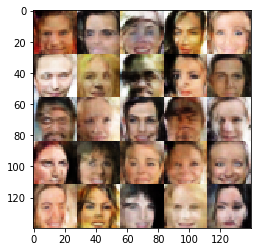

Epoch 3/10... Discriminator Loss: 0.234155... Generator Loss: 7.291034
Epoch 3/10... Discriminator Loss: 0.057192... Generator Loss: 4.381271
Epoch 3/10... Discriminator Loss: 0.182800... Generator Loss: 2.570036
Epoch 3/10... Discriminator Loss: 0.050636... Generator Loss: 4.495402
Epoch 3/10... Discriminator Loss: 0.046956... Generator Loss: 4.882545
Epoch 3/10... Discriminator Loss: 0.113978... Generator Loss: 3.215191
Epoch 3/10... Discriminator Loss: 0.228504... Generator Loss: 2.298923
Epoch 3/10... Discriminator Loss: 0.516835... Generator Loss: 1.304746
Epoch 3/10... Discriminator Loss: 0.023656... Generator Loss: 5.527753
Epoch 3/10... Discriminator Loss: 2.455293... Generator Loss: 0.324461


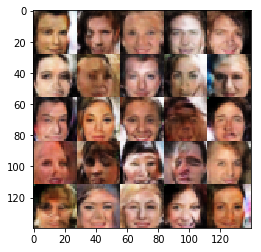

Epoch 3/10... Discriminator Loss: 1.421320... Generator Loss: 1.025613
Epoch 3/10... Discriminator Loss: 1.624758... Generator Loss: 2.748052
Epoch 3/10... Discriminator Loss: 1.061058... Generator Loss: 0.770585
Epoch 3/10... Discriminator Loss: 0.867164... Generator Loss: 1.002351
Epoch 3/10... Discriminator Loss: 1.075561... Generator Loss: 2.555196
Epoch 3/10... Discriminator Loss: 0.711089... Generator Loss: 1.715557
Epoch 3/10... Discriminator Loss: 2.245353... Generator Loss: 6.660182
Epoch 3/10... Discriminator Loss: 0.661582... Generator Loss: 1.348457
Epoch 3/10... Discriminator Loss: 0.744528... Generator Loss: 1.093653
Epoch 3/10... Discriminator Loss: 1.162913... Generator Loss: 4.058472


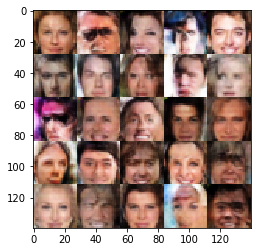

Epoch 3/10... Discriminator Loss: 1.202620... Generator Loss: 0.561744
Epoch 3/10... Discriminator Loss: 1.255452... Generator Loss: 0.536725
Epoch 3/10... Discriminator Loss: 0.922579... Generator Loss: 1.057062
Epoch 3/10... Discriminator Loss: 0.440543... Generator Loss: 1.565441
Epoch 3/10... Discriminator Loss: 0.355611... Generator Loss: 3.458162
Epoch 3/10... Discriminator Loss: 1.364594... Generator Loss: 4.497926
Epoch 3/10... Discriminator Loss: 0.776691... Generator Loss: 4.149397
Epoch 3/10... Discriminator Loss: 1.422153... Generator Loss: 0.537200
Epoch 3/10... Discriminator Loss: 0.697176... Generator Loss: 1.087886
Epoch 3/10... Discriminator Loss: 0.168443... Generator Loss: 2.870945


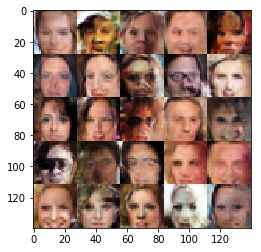

Epoch 3/10... Discriminator Loss: 0.452628... Generator Loss: 1.576419
Epoch 3/10... Discriminator Loss: 0.555482... Generator Loss: 1.209969
Epoch 3/10... Discriminator Loss: 0.725218... Generator Loss: 1.172664
Epoch 3/10... Discriminator Loss: 0.048655... Generator Loss: 5.982757
Epoch 3/10... Discriminator Loss: 0.192567... Generator Loss: 2.661058
Epoch 3/10... Discriminator Loss: 0.487596... Generator Loss: 1.453068
Epoch 3/10... Discriminator Loss: 0.166422... Generator Loss: 3.492388
Epoch 3/10... Discriminator Loss: 0.097371... Generator Loss: 5.630346
Epoch 3/10... Discriminator Loss: 0.218758... Generator Loss: 3.406332
Epoch 3/10... Discriminator Loss: 0.224593... Generator Loss: 2.252990


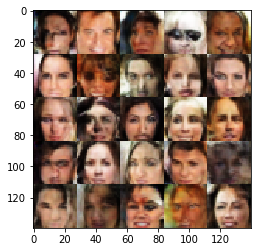

Epoch 3/10... Discriminator Loss: 0.340733... Generator Loss: 4.360954
Epoch 3/10... Discriminator Loss: 0.253469... Generator Loss: 2.034597
Epoch 3/10... Discriminator Loss: 0.154739... Generator Loss: 4.520856
Epoch 3/10... Discriminator Loss: 0.120847... Generator Loss: 4.333703
Epoch 3/10... Discriminator Loss: 0.157865... Generator Loss: 3.350468
Epoch 3/10... Discriminator Loss: 0.629873... Generator Loss: 1.576981
Epoch 3/10... Discriminator Loss: 0.048142... Generator Loss: 4.576398
Epoch 3/10... Discriminator Loss: 0.085078... Generator Loss: 3.654452
Epoch 3/10... Discriminator Loss: 0.202363... Generator Loss: 9.890308
Epoch 3/10... Discriminator Loss: 0.078213... Generator Loss: 6.914831


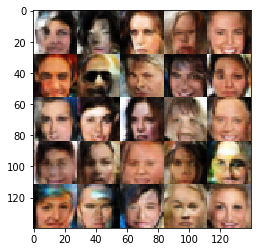

Epoch 3/10... Discriminator Loss: 0.644670... Generator Loss: 1.238386
Epoch 3/10... Discriminator Loss: 0.136063... Generator Loss: 3.777871
Epoch 3/10... Discriminator Loss: 0.190312... Generator Loss: 2.566671
Epoch 3/10... Discriminator Loss: 0.146035... Generator Loss: 2.957688
Epoch 3/10... Discriminator Loss: 0.143564... Generator Loss: 3.212707
Epoch 3/10... Discriminator Loss: 0.088842... Generator Loss: 3.602834
Epoch 3/10... Discriminator Loss: 0.133896... Generator Loss: 2.710562
Epoch 3/10... Discriminator Loss: 0.157279... Generator Loss: 2.716984
Epoch 3/10... Discriminator Loss: 0.471780... Generator Loss: 1.671596
Epoch 3/10... Discriminator Loss: 0.201459... Generator Loss: 2.243688


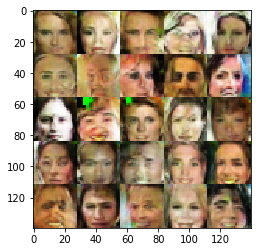

Epoch 3/10... Discriminator Loss: 0.305736... Generator Loss: 2.097085
Epoch 3/10... Discriminator Loss: 0.083419... Generator Loss: 3.591864
Epoch 3/10... Discriminator Loss: 0.044235... Generator Loss: 5.819617
Epoch 3/10... Discriminator Loss: 0.090814... Generator Loss: 5.451415
Epoch 3/10... Discriminator Loss: 1.842176... Generator Loss: 12.033173
Epoch 3/10... Discriminator Loss: 1.573157... Generator Loss: 1.115463
Epoch 3/10... Discriminator Loss: 1.127729... Generator Loss: 1.035173
Epoch 3/10... Discriminator Loss: 0.919114... Generator Loss: 2.193668
Epoch 3/10... Discriminator Loss: 0.660013... Generator Loss: 2.348354
Epoch 3/10... Discriminator Loss: 0.588418... Generator Loss: 1.600812


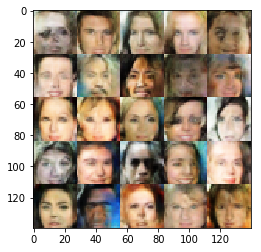

Epoch 3/10... Discriminator Loss: 0.526821... Generator Loss: 1.675837
Epoch 3/10... Discriminator Loss: 0.667419... Generator Loss: 1.793096
Epoch 3/10... Discriminator Loss: 1.690713... Generator Loss: 0.462699
Epoch 3/10... Discriminator Loss: 1.116781... Generator Loss: 0.738735
Epoch 3/10... Discriminator Loss: 1.711701... Generator Loss: 4.871793
Epoch 3/10... Discriminator Loss: 0.599849... Generator Loss: 1.366189
Epoch 3/10... Discriminator Loss: 0.156484... Generator Loss: 2.975769
Epoch 3/10... Discriminator Loss: 0.117532... Generator Loss: 3.779441
Epoch 3/10... Discriminator Loss: 0.377616... Generator Loss: 1.672821
Epoch 3/10... Discriminator Loss: 0.314915... Generator Loss: 1.665244


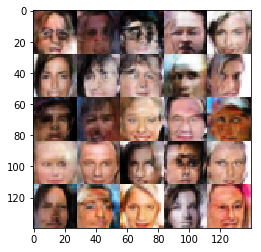

Epoch 3/10... Discriminator Loss: 0.373100... Generator Loss: 1.890344
Epoch 3/10... Discriminator Loss: 0.126511... Generator Loss: 2.922305
Epoch 3/10... Discriminator Loss: 0.248373... Generator Loss: 2.515890
Epoch 3/10... Discriminator Loss: 0.468787... Generator Loss: 1.450771
Epoch 3/10... Discriminator Loss: 1.248447... Generator Loss: 0.797275
Epoch 3/10... Discriminator Loss: 0.521501... Generator Loss: 1.407544
Epoch 3/10... Discriminator Loss: 0.431276... Generator Loss: 4.559972
Epoch 3/10... Discriminator Loss: 2.235572... Generator Loss: 0.184824
Epoch 3/10... Discriminator Loss: 0.602847... Generator Loss: 4.394235
Epoch 3/10... Discriminator Loss: 0.465748... Generator Loss: 1.469572


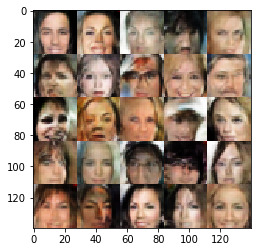

Epoch 3/10... Discriminator Loss: 0.238032... Generator Loss: 2.480358
Epoch 3/10... Discriminator Loss: 2.840960... Generator Loss: 0.127188
Epoch 3/10... Discriminator Loss: 0.334008... Generator Loss: 4.822000
Epoch 3/10... Discriminator Loss: 0.829409... Generator Loss: 1.077620
Epoch 3/10... Discriminator Loss: 0.494450... Generator Loss: 1.454787
Epoch 3/10... Discriminator Loss: 0.164239... Generator Loss: 2.682118
Epoch 3/10... Discriminator Loss: 0.222425... Generator Loss: 2.119669
Epoch 3/10... Discriminator Loss: 0.096593... Generator Loss: 4.255954
Epoch 3/10... Discriminator Loss: 0.070733... Generator Loss: 3.473792
Epoch 3/10... Discriminator Loss: 0.100833... Generator Loss: 3.221858


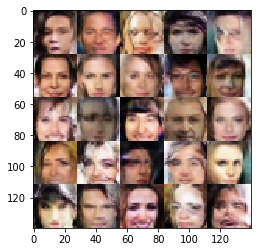

Epoch 3/10... Discriminator Loss: 0.709777... Generator Loss: 6.353349
Epoch 3/10... Discriminator Loss: 0.861482... Generator Loss: 0.879324
Epoch 3/10... Discriminator Loss: 0.110551... Generator Loss: 3.836406
Epoch 3/10... Discriminator Loss: 0.054297... Generator Loss: 4.588122
Epoch 3/10... Discriminator Loss: 0.037195... Generator Loss: 5.028770
Epoch 3/10... Discriminator Loss: 0.243356... Generator Loss: 2.213910
Epoch 3/10... Discriminator Loss: 0.145599... Generator Loss: 2.767294
Epoch 3/10... Discriminator Loss: 0.089197... Generator Loss: 3.586730
Epoch 3/10... Discriminator Loss: 0.440065... Generator Loss: 1.489412
Epoch 3/10... Discriminator Loss: 0.106323... Generator Loss: 3.276710


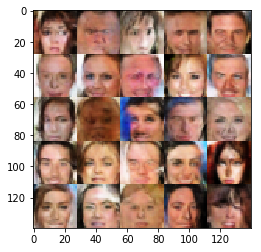

Epoch 3/10... Discriminator Loss: 0.022351... Generator Loss: 6.398879
Epoch 3/10... Discriminator Loss: 0.059742... Generator Loss: 3.900999
Epoch 3/10... Discriminator Loss: 1.984803... Generator Loss: 0.531701
Epoch 3/10... Discriminator Loss: 0.926857... Generator Loss: 2.875359
Epoch 3/10... Discriminator Loss: 0.982154... Generator Loss: 3.956639
Epoch 3/10... Discriminator Loss: 1.973162... Generator Loss: 6.220088
Epoch 3/10... Discriminator Loss: 0.744878... Generator Loss: 1.349451
Epoch 3/10... Discriminator Loss: 0.472088... Generator Loss: 1.761845
Epoch 3/10... Discriminator Loss: 0.806969... Generator Loss: 1.175140
Epoch 3/10... Discriminator Loss: 1.497902... Generator Loss: 0.756592


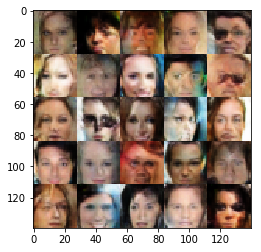

Epoch 3/10... Discriminator Loss: 0.433269... Generator Loss: 1.698881
Epoch 3/10... Discriminator Loss: 2.204634... Generator Loss: 0.300264
Epoch 3/10... Discriminator Loss: 0.786065... Generator Loss: 1.233075
Epoch 3/10... Discriminator Loss: 0.308741... Generator Loss: 2.934945
Epoch 3/10... Discriminator Loss: 0.231247... Generator Loss: 3.008907
Epoch 3/10... Discriminator Loss: 0.176254... Generator Loss: 3.357605
Epoch 3/10... Discriminator Loss: 2.039556... Generator Loss: 0.418960
Epoch 3/10... Discriminator Loss: 0.547802... Generator Loss: 5.052509
Epoch 3/10... Discriminator Loss: 1.902162... Generator Loss: 6.218961
Epoch 3/10... Discriminator Loss: 0.056775... Generator Loss: 4.716650


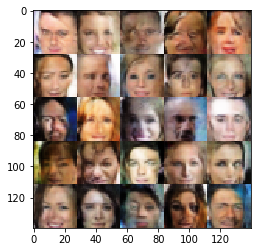

Epoch 3/10... Discriminator Loss: 0.188596... Generator Loss: 3.257329
Epoch 3/10... Discriminator Loss: 0.253066... Generator Loss: 2.360395
Epoch 3/10... Discriminator Loss: 0.212677... Generator Loss: 2.821716
Epoch 3/10... Discriminator Loss: 0.126341... Generator Loss: 4.337896
Epoch 3/10... Discriminator Loss: 0.125137... Generator Loss: 3.746603
Epoch 3/10... Discriminator Loss: 0.154145... Generator Loss: 2.706456
Epoch 3/10... Discriminator Loss: 0.220210... Generator Loss: 2.557134
Epoch 3/10... Discriminator Loss: 0.321851... Generator Loss: 5.166402
Epoch 3/10... Discriminator Loss: 0.107651... Generator Loss: 3.691517
Epoch 3/10... Discriminator Loss: 0.143980... Generator Loss: 3.245929


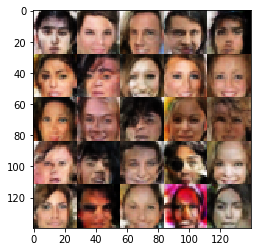

Epoch 3/10... Discriminator Loss: 0.330649... Generator Loss: 1.924980
Epoch 3/10... Discriminator Loss: 0.268168... Generator Loss: 2.140895
Epoch 3/10... Discriminator Loss: 0.052112... Generator Loss: 4.788002
Epoch 3/10... Discriminator Loss: 0.129967... Generator Loss: 5.613796
Epoch 3/10... Discriminator Loss: 0.395041... Generator Loss: 1.623946
Epoch 3/10... Discriminator Loss: 0.278321... Generator Loss: 2.346104
Epoch 3/10... Discriminator Loss: 0.066188... Generator Loss: 3.901034
Epoch 3/10... Discriminator Loss: 0.332561... Generator Loss: 2.175289
Epoch 3/10... Discriminator Loss: 0.146766... Generator Loss: 3.054576
Epoch 3/10... Discriminator Loss: 0.341180... Generator Loss: 1.625719


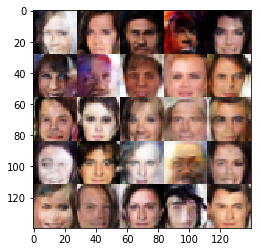

Epoch 3/10... Discriminator Loss: 0.209683... Generator Loss: 4.561027
Epoch 3/10... Discriminator Loss: 0.406801... Generator Loss: 1.838094
Epoch 3/10... Discriminator Loss: 0.097284... Generator Loss: 3.421433
Epoch 3/10... Discriminator Loss: 0.099204... Generator Loss: 3.749496
Epoch 3/10... Discriminator Loss: 0.093932... Generator Loss: 3.681487
Epoch 3/10... Discriminator Loss: 0.192343... Generator Loss: 2.687715
Epoch 3/10... Discriminator Loss: 0.085110... Generator Loss: 3.783077
Epoch 3/10... Discriminator Loss: 0.065361... Generator Loss: 4.529894
Epoch 3/10... Discriminator Loss: 0.700934... Generator Loss: 6.971870
Epoch 3/10... Discriminator Loss: 0.804697... Generator Loss: 1.042500


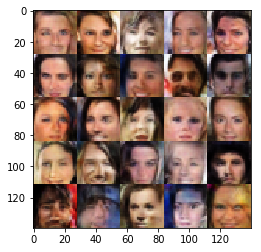

Epoch 3/10... Discriminator Loss: 0.155350... Generator Loss: 2.884142
Epoch 3/10... Discriminator Loss: 0.112273... Generator Loss: 4.493206
Epoch 3/10... Discriminator Loss: 0.125158... Generator Loss: 3.727580
Epoch 3/10... Discriminator Loss: 0.623102... Generator Loss: 1.201438
Epoch 3/10... Discriminator Loss: 0.097784... Generator Loss: 6.228030
Epoch 3/10... Discriminator Loss: 0.137474... Generator Loss: 3.120179
Epoch 3/10... Discriminator Loss: 0.098655... Generator Loss: 3.499426
Epoch 3/10... Discriminator Loss: 0.040313... Generator Loss: 5.254093
Epoch 3/10... Discriminator Loss: 1.708749... Generator Loss: 0.471530
Epoch 3/10... Discriminator Loss: 1.800020... Generator Loss: 0.665380


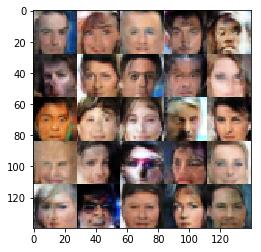

Epoch 3/10... Discriminator Loss: 1.131534... Generator Loss: 1.139369
Epoch 3/10... Discriminator Loss: 0.982855... Generator Loss: 4.549335
Epoch 3/10... Discriminator Loss: 0.332510... Generator Loss: 2.889407
Epoch 3/10... Discriminator Loss: 0.689087... Generator Loss: 1.137675
Epoch 3/10... Discriminator Loss: 0.326931... Generator Loss: 2.591817
Epoch 3/10... Discriminator Loss: 0.305831... Generator Loss: 2.459186
Epoch 3/10... Discriminator Loss: 1.507404... Generator Loss: 0.499048
Epoch 3/10... Discriminator Loss: 0.243449... Generator Loss: 2.662206
Epoch 3/10... Discriminator Loss: 1.311043... Generator Loss: 0.661708
Epoch 3/10... Discriminator Loss: 0.286764... Generator Loss: 5.125036


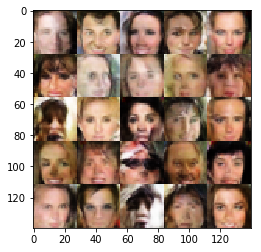

Epoch 3/10... Discriminator Loss: 0.193670... Generator Loss: 3.413569
Epoch 3/10... Discriminator Loss: 0.251387... Generator Loss: 2.286439
Epoch 3/10... Discriminator Loss: 0.104464... Generator Loss: 3.440112
Epoch 3/10... Discriminator Loss: 0.256456... Generator Loss: 2.090460
Epoch 3/10... Discriminator Loss: 0.229730... Generator Loss: 2.786330
Epoch 3/10... Discriminator Loss: 0.951734... Generator Loss: 1.171917
Epoch 3/10... Discriminator Loss: 0.253019... Generator Loss: 2.207543
Epoch 3/10... Discriminator Loss: 0.116532... Generator Loss: 4.640885
Epoch 3/10... Discriminator Loss: 0.127393... Generator Loss: 2.722857
Epoch 3/10... Discriminator Loss: 0.236093... Generator Loss: 2.601917


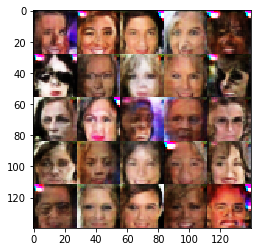

Epoch 3/10... Discriminator Loss: 0.175204... Generator Loss: 2.582819
Epoch 3/10... Discriminator Loss: 0.147881... Generator Loss: 2.597005
Epoch 3/10... Discriminator Loss: 0.046014... Generator Loss: 4.445518
Epoch 3/10... Discriminator Loss: 0.164532... Generator Loss: 2.469350
Epoch 3/10... Discriminator Loss: 0.221851... Generator Loss: 2.391193
Epoch 3/10... Discriminator Loss: 0.063268... Generator Loss: 3.841268
Epoch 3/10... Discriminator Loss: 0.317323... Generator Loss: 2.032343
Epoch 3/10... Discriminator Loss: 0.015650... Generator Loss: 6.482401
Epoch 3/10... Discriminator Loss: 0.139438... Generator Loss: 2.954841
Epoch 3/10... Discriminator Loss: 0.126782... Generator Loss: 3.347779


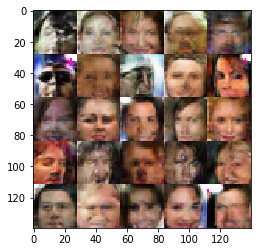

Epoch 3/10... Discriminator Loss: 0.010712... Generator Loss: 7.459750
Epoch 3/10... Discriminator Loss: 0.117720... Generator Loss: 8.781374
Epoch 3/10... Discriminator Loss: 0.032411... Generator Loss: 5.534233
Epoch 3/10... Discriminator Loss: 0.006397... Generator Loss: 8.518221
Epoch 3/10... Discriminator Loss: 0.112437... Generator Loss: 2.871322
Epoch 3/10... Discriminator Loss: 0.270565... Generator Loss: 2.405904
Epoch 3/10... Discriminator Loss: 0.091140... Generator Loss: 3.291874
Epoch 3/10... Discriminator Loss: 0.112609... Generator Loss: 9.720499
Epoch 3/10... Discriminator Loss: 0.019197... Generator Loss: 6.498599
Epoch 3/10... Discriminator Loss: 0.320335... Generator Loss: 1.854115


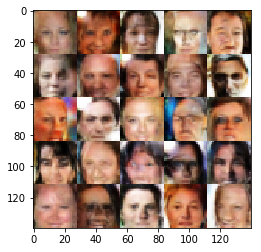

Epoch 3/10... Discriminator Loss: 0.059737... Generator Loss: 3.423296
Epoch 3/10... Discriminator Loss: 0.078556... Generator Loss: 4.780824
Epoch 3/10... Discriminator Loss: 0.378628... Generator Loss: 2.217835
Epoch 3/10... Discriminator Loss: 1.381801... Generator Loss: 3.031183
Epoch 3/10... Discriminator Loss: 0.905324... Generator Loss: 1.814338
Epoch 3/10... Discriminator Loss: 0.663360... Generator Loss: 1.485869
Epoch 3/10... Discriminator Loss: 0.671130... Generator Loss: 2.386276
Epoch 3/10... Discriminator Loss: 0.527290... Generator Loss: 3.982216
Epoch 3/10... Discriminator Loss: 1.609143... Generator Loss: 0.939262
Epoch 3/10... Discriminator Loss: 0.093518... Generator Loss: 3.515441


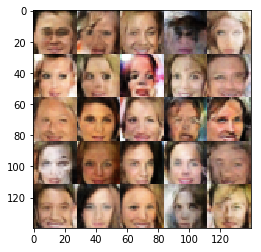

Epoch 3/10... Discriminator Loss: 1.823820... Generator Loss: 5.755327
Epoch 3/10... Discriminator Loss: 0.837119... Generator Loss: 5.198339
Epoch 3/10... Discriminator Loss: 1.681287... Generator Loss: 0.533767
Epoch 3/10... Discriminator Loss: 0.266656... Generator Loss: 2.618175
Epoch 3/10... Discriminator Loss: 0.359072... Generator Loss: 2.154296
Epoch 3/10... Discriminator Loss: 0.784964... Generator Loss: 5.139379
Epoch 3/10... Discriminator Loss: 0.650981... Generator Loss: 1.630089
Epoch 3/10... Discriminator Loss: 0.182167... Generator Loss: 3.149239
Epoch 3/10... Discriminator Loss: 0.469652... Generator Loss: 1.500406
Epoch 3/10... Discriminator Loss: 0.139083... Generator Loss: 5.000008


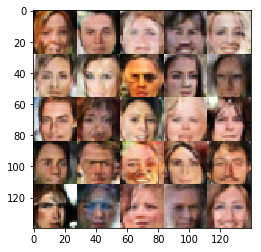

Epoch 3/10... Discriminator Loss: 0.222803... Generator Loss: 4.138155
Epoch 3/10... Discriminator Loss: 0.205522... Generator Loss: 3.092430
Epoch 3/10... Discriminator Loss: 0.049329... Generator Loss: 4.804673
Epoch 3/10... Discriminator Loss: 0.469251... Generator Loss: 1.663188
Epoch 3/10... Discriminator Loss: 0.349102... Generator Loss: 3.896668
Epoch 3/10... Discriminator Loss: 0.236534... Generator Loss: 2.330942
Epoch 3/10... Discriminator Loss: 0.084251... Generator Loss: 5.488680
Epoch 3/10... Discriminator Loss: 0.111289... Generator Loss: 4.444846
Epoch 3/10... Discriminator Loss: 0.078176... Generator Loss: 4.300224
Epoch 3/10... Discriminator Loss: 0.322049... Generator Loss: 2.167630


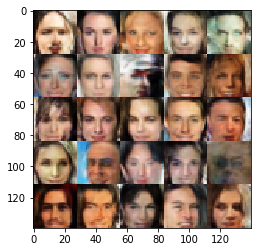

Epoch 3/10... Discriminator Loss: 0.072613... Generator Loss: 3.724341
Epoch 3/10... Discriminator Loss: 0.556184... Generator Loss: 1.495196
Epoch 3/10... Discriminator Loss: 0.548301... Generator Loss: 2.093152
Epoch 3/10... Discriminator Loss: 0.213661... Generator Loss: 2.666323
Epoch 3/10... Discriminator Loss: 0.248190... Generator Loss: 4.103954
Epoch 3/10... Discriminator Loss: 0.044723... Generator Loss: 4.771128
Epoch 3/10... Discriminator Loss: 0.200078... Generator Loss: 2.317554
Epoch 3/10... Discriminator Loss: 0.060307... Generator Loss: 4.042762
Epoch 3/10... Discriminator Loss: 0.792174... Generator Loss: 0.877965
Epoch 3/10... Discriminator Loss: 0.705629... Generator Loss: 7.963295


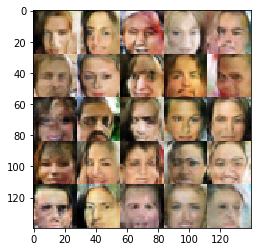

Epoch 3/10... Discriminator Loss: 0.116788... Generator Loss: 3.751034
Epoch 3/10... Discriminator Loss: 0.111328... Generator Loss: 4.187851
Epoch 3/10... Discriminator Loss: 0.100311... Generator Loss: 4.116438
Epoch 3/10... Discriminator Loss: 0.057656... Generator Loss: 4.259358
Epoch 3/10... Discriminator Loss: 0.091150... Generator Loss: 3.511128
Epoch 3/10... Discriminator Loss: 0.360386... Generator Loss: 1.860855
Epoch 3/10... Discriminator Loss: 0.136393... Generator Loss: 2.807660
Epoch 3/10... Discriminator Loss: 0.285584... Generator Loss: 5.021454
Epoch 3/10... Discriminator Loss: 0.695542... Generator Loss: 1.121650
Epoch 3/10... Discriminator Loss: 0.108974... Generator Loss: 3.729890


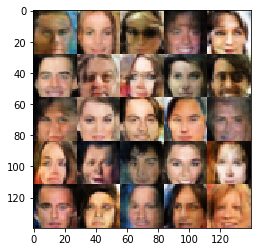

Epoch 3/10... Discriminator Loss: 0.404670... Generator Loss: 1.622704
Epoch 3/10... Discriminator Loss: 0.123695... Generator Loss: 4.188453
Epoch 3/10... Discriminator Loss: 0.059645... Generator Loss: 5.878958
Epoch 3/10... Discriminator Loss: 0.099974... Generator Loss: 3.702523
Epoch 3/10... Discriminator Loss: 0.371607... Generator Loss: 1.868013
Epoch 3/10... Discriminator Loss: 0.086308... Generator Loss: 5.236299
Epoch 3/10... Discriminator Loss: 1.804755... Generator Loss: 0.539112
Epoch 3/10... Discriminator Loss: 0.189694... Generator Loss: 2.515123
Epoch 3/10... Discriminator Loss: 0.156892... Generator Loss: 2.694297
Epoch 3/10... Discriminator Loss: 0.127186... Generator Loss: 5.919590


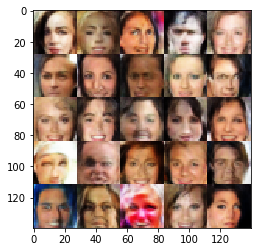

Epoch 3/10... Discriminator Loss: 0.521537... Generator Loss: 1.452572
Epoch 3/10... Discriminator Loss: 0.294096... Generator Loss: 7.928546
Epoch 3/10... Discriminator Loss: 5.892047... Generator Loss: 11.421091
Epoch 3/10... Discriminator Loss: 1.015290... Generator Loss: 1.203546
Epoch 3/10... Discriminator Loss: 1.346241... Generator Loss: 1.316176
Epoch 3/10... Discriminator Loss: 0.794738... Generator Loss: 2.124891
Epoch 3/10... Discriminator Loss: 0.522582... Generator Loss: 3.209163
Epoch 3/10... Discriminator Loss: 2.138192... Generator Loss: 0.435086
Epoch 3/10... Discriminator Loss: 0.889334... Generator Loss: 2.097435
Epoch 3/10... Discriminator Loss: 0.700230... Generator Loss: 4.380517


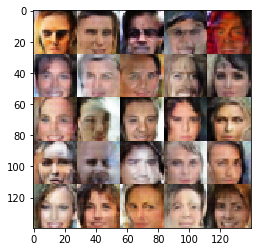

Epoch 3/10... Discriminator Loss: 0.941730... Generator Loss: 5.539577
Epoch 3/10... Discriminator Loss: 0.591313... Generator Loss: 1.905721
Epoch 3/10... Discriminator Loss: 0.716855... Generator Loss: 1.106041
Epoch 3/10... Discriminator Loss: 0.326682... Generator Loss: 2.802066
Epoch 3/10... Discriminator Loss: 0.363694... Generator Loss: 2.141947
Epoch 3/10... Discriminator Loss: 0.199415... Generator Loss: 2.959359
Epoch 3/10... Discriminator Loss: 0.176858... Generator Loss: 2.601024
Epoch 3/10... Discriminator Loss: 0.614089... Generator Loss: 1.297017
Epoch 3/10... Discriminator Loss: 0.419557... Generator Loss: 1.602647
Epoch 3/10... Discriminator Loss: 0.188299... Generator Loss: 3.390559


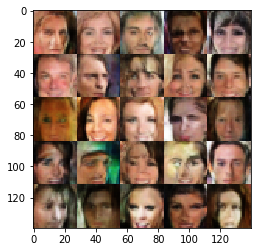

Epoch 3/10... Discriminator Loss: 0.243782... Generator Loss: 2.611873
Epoch 3/10... Discriminator Loss: 0.413687... Generator Loss: 1.800368
Epoch 3/10... Discriminator Loss: 0.312175... Generator Loss: 2.255530
Epoch 3/10... Discriminator Loss: 2.109232... Generator Loss: 0.327050
Epoch 3/10... Discriminator Loss: 0.114758... Generator Loss: 3.068702
Epoch 3/10... Discriminator Loss: 0.968951... Generator Loss: 0.848717
Epoch 3/10... Discriminator Loss: 0.250818... Generator Loss: 2.498395
Epoch 3/10... Discriminator Loss: 0.811502... Generator Loss: 1.210057
Epoch 3/10... Discriminator Loss: 0.103152... Generator Loss: 4.246674
Epoch 3/10... Discriminator Loss: 0.324892... Generator Loss: 2.196014


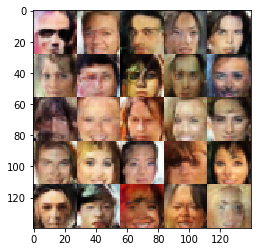

Epoch 3/10... Discriminator Loss: 0.425787... Generator Loss: 2.051317
Epoch 3/10... Discriminator Loss: 0.397665... Generator Loss: 2.131805
Epoch 3/10... Discriminator Loss: 0.306745... Generator Loss: 4.047372
Epoch 3/10... Discriminator Loss: 0.618961... Generator Loss: 3.935420
Epoch 3/10... Discriminator Loss: 0.342461... Generator Loss: 3.529627
Epoch 3/10... Discriminator Loss: 0.277543... Generator Loss: 3.474430
Epoch 3/10... Discriminator Loss: 0.145752... Generator Loss: 4.970250
Epoch 3/10... Discriminator Loss: 0.550504... Generator Loss: 1.426436
Epoch 3/10... Discriminator Loss: 0.570030... Generator Loss: 1.523479
Epoch 3/10... Discriminator Loss: 0.206473... Generator Loss: 2.771843


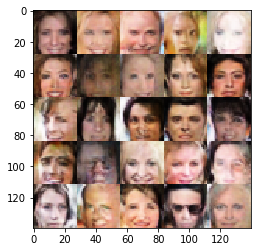

Epoch 3/10... Discriminator Loss: 0.140356... Generator Loss: 3.105093
Epoch 3/10... Discriminator Loss: 0.024038... Generator Loss: 7.467413
Epoch 3/10... Discriminator Loss: 0.115969... Generator Loss: 4.636150
Epoch 3/10... Discriminator Loss: 0.362373... Generator Loss: 1.809579
Epoch 3/10... Discriminator Loss: 0.315989... Generator Loss: 2.006206
Epoch 3/10... Discriminator Loss: 0.198776... Generator Loss: 3.112823
Epoch 3/10... Discriminator Loss: 0.079004... Generator Loss: 3.592135
Epoch 3/10... Discriminator Loss: 0.175845... Generator Loss: 2.502657
Epoch 3/10... Discriminator Loss: 0.188613... Generator Loss: 2.791646
Epoch 3/10... Discriminator Loss: 0.029706... Generator Loss: 5.813843


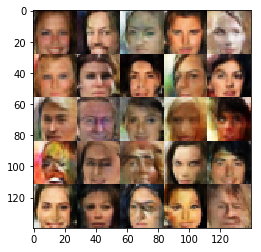

Epoch 3/10... Discriminator Loss: 0.029981... Generator Loss: 6.239179
Epoch 3/10... Discriminator Loss: 0.256303... Generator Loss: 2.203413
Epoch 3/10... Discriminator Loss: 0.228725... Generator Loss: 2.556258
Epoch 3/10... Discriminator Loss: 0.066932... Generator Loss: 4.336152
Epoch 3/10... Discriminator Loss: 0.123622... Generator Loss: 3.314986
Epoch 3/10... Discriminator Loss: 0.052940... Generator Loss: 4.313565
Epoch 3/10... Discriminator Loss: 0.248501... Generator Loss: 2.071253
Epoch 3/10... Discriminator Loss: 0.078800... Generator Loss: 4.122697
Epoch 3/10... Discriminator Loss: 0.654136... Generator Loss: 1.021453
Epoch 3/10... Discriminator Loss: 2.087248... Generator Loss: 0.381724


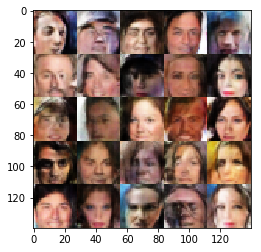

Epoch 3/10... Discriminator Loss: 0.113188... Generator Loss: 3.623275
Epoch 3/10... Discriminator Loss: 0.154576... Generator Loss: 3.279367
Epoch 3/10... Discriminator Loss: 0.190882... Generator Loss: 2.656661
Epoch 3/10... Discriminator Loss: 0.554059... Generator Loss: 1.281609
Epoch 3/10... Discriminator Loss: 0.088268... Generator Loss: 3.959411
Epoch 4/10... Discriminator Loss: 0.246536... Generator Loss: 5.851323
Epoch 4/10... Discriminator Loss: 0.025074... Generator Loss: 4.472800
Epoch 4/10... Discriminator Loss: 0.096626... Generator Loss: 3.837080
Epoch 4/10... Discriminator Loss: 0.213465... Generator Loss: 2.783423
Epoch 4/10... Discriminator Loss: 0.137943... Generator Loss: 2.694146


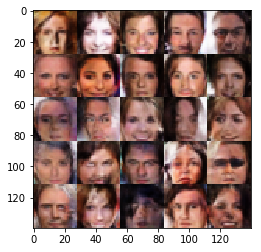

Epoch 4/10... Discriminator Loss: 0.089282... Generator Loss: 4.079512
Epoch 4/10... Discriminator Loss: 0.069378... Generator Loss: 4.422580
Epoch 4/10... Discriminator Loss: 0.028190... Generator Loss: 5.273425
Epoch 4/10... Discriminator Loss: 1.729290... Generator Loss: 0.401388
Epoch 4/10... Discriminator Loss: 0.157266... Generator Loss: 2.638614
Epoch 4/10... Discriminator Loss: 0.981992... Generator Loss: 7.297313
Epoch 4/10... Discriminator Loss: 1.166455... Generator Loss: 0.816387
Epoch 4/10... Discriminator Loss: 0.756959... Generator Loss: 1.252477
Epoch 4/10... Discriminator Loss: 1.105187... Generator Loss: 0.811870
Epoch 4/10... Discriminator Loss: 1.072026... Generator Loss: 4.683139


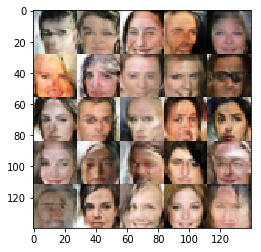

Epoch 4/10... Discriminator Loss: 0.439942... Generator Loss: 1.901804
Epoch 4/10... Discriminator Loss: 1.683655... Generator Loss: 6.301236
Epoch 4/10... Discriminator Loss: 0.385830... Generator Loss: 2.315669
Epoch 4/10... Discriminator Loss: 0.168285... Generator Loss: 3.487307
Epoch 4/10... Discriminator Loss: 0.321554... Generator Loss: 2.218085
Epoch 4/10... Discriminator Loss: 0.168313... Generator Loss: 3.508896
Epoch 4/10... Discriminator Loss: 0.348786... Generator Loss: 2.266762
Epoch 4/10... Discriminator Loss: 0.194450... Generator Loss: 2.619899
Epoch 4/10... Discriminator Loss: 0.092306... Generator Loss: 3.385156
Epoch 4/10... Discriminator Loss: 0.109358... Generator Loss: 3.401569


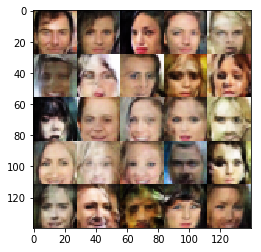

Epoch 4/10... Discriminator Loss: 0.321294... Generator Loss: 1.882919
Epoch 4/10... Discriminator Loss: 0.795902... Generator Loss: 1.346235
Epoch 4/10... Discriminator Loss: 0.444044... Generator Loss: 1.796131
Epoch 4/10... Discriminator Loss: 0.432459... Generator Loss: 1.807379
Epoch 4/10... Discriminator Loss: 0.595363... Generator Loss: 1.499661
Epoch 4/10... Discriminator Loss: 0.857901... Generator Loss: 0.879803
Epoch 4/10... Discriminator Loss: 0.374896... Generator Loss: 5.994151
Epoch 4/10... Discriminator Loss: 0.157416... Generator Loss: 3.455526
Epoch 4/10... Discriminator Loss: 0.409649... Generator Loss: 1.767131
Epoch 4/10... Discriminator Loss: 0.157110... Generator Loss: 2.628525


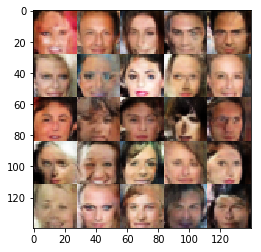

Epoch 4/10... Discriminator Loss: 0.672960... Generator Loss: 1.124088
Epoch 4/10... Discriminator Loss: 0.114796... Generator Loss: 3.393595
Epoch 4/10... Discriminator Loss: 0.029427... Generator Loss: 6.097662
Epoch 4/10... Discriminator Loss: 0.142077... Generator Loss: 2.583264
Epoch 4/10... Discriminator Loss: 0.658104... Generator Loss: 1.122243
Epoch 4/10... Discriminator Loss: 0.160668... Generator Loss: 3.316550
Epoch 4/10... Discriminator Loss: 0.108520... Generator Loss: 3.709974
Epoch 4/10... Discriminator Loss: 0.130034... Generator Loss: 3.482028
Epoch 4/10... Discriminator Loss: 0.546269... Generator Loss: 1.538739
Epoch 4/10... Discriminator Loss: 0.207362... Generator Loss: 2.298933


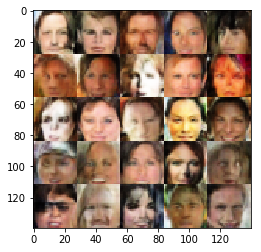

Epoch 4/10... Discriminator Loss: 0.085432... Generator Loss: 6.180896
Epoch 4/10... Discriminator Loss: 0.658097... Generator Loss: 1.338701
Epoch 4/10... Discriminator Loss: 2.251064... Generator Loss: 0.293718
Epoch 4/10... Discriminator Loss: 0.085716... Generator Loss: 5.367007
Epoch 4/10... Discriminator Loss: 0.099356... Generator Loss: 4.162860
Epoch 4/10... Discriminator Loss: 0.073644... Generator Loss: 4.106942
Epoch 4/10... Discriminator Loss: 0.679961... Generator Loss: 1.285560
Epoch 4/10... Discriminator Loss: 0.097506... Generator Loss: 3.422649
Epoch 4/10... Discriminator Loss: 0.080663... Generator Loss: 3.744689
Epoch 4/10... Discriminator Loss: 0.284937... Generator Loss: 6.380123


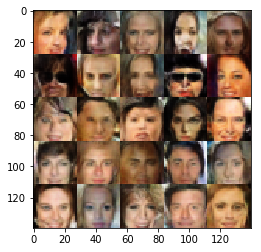

Epoch 4/10... Discriminator Loss: 0.261185... Generator Loss: 3.740204
Epoch 4/10... Discriminator Loss: 0.238727... Generator Loss: 5.454149
Epoch 4/10... Discriminator Loss: 0.428033... Generator Loss: 1.688503
Epoch 4/10... Discriminator Loss: 1.181158... Generator Loss: 6.037559
Epoch 4/10... Discriminator Loss: 0.048056... Generator Loss: 6.054158
Epoch 4/10... Discriminator Loss: 0.132839... Generator Loss: 6.274878
Epoch 4/10... Discriminator Loss: 0.234789... Generator Loss: 2.446150
Epoch 4/10... Discriminator Loss: 0.050854... Generator Loss: 4.729187
Epoch 4/10... Discriminator Loss: 0.931539... Generator Loss: 0.880198
Epoch 4/10... Discriminator Loss: 0.122387... Generator Loss: 3.170453


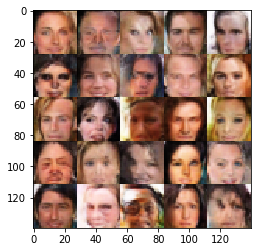

Epoch 4/10... Discriminator Loss: 0.392451... Generator Loss: 1.768427
Epoch 4/10... Discriminator Loss: 0.759820... Generator Loss: 1.085652
Epoch 4/10... Discriminator Loss: 2.158690... Generator Loss: 0.303164
Epoch 4/10... Discriminator Loss: 1.873829... Generator Loss: 1.412547
Epoch 4/10... Discriminator Loss: 1.066960... Generator Loss: 1.966019
Epoch 4/10... Discriminator Loss: 0.882244... Generator Loss: 2.158541
Epoch 4/10... Discriminator Loss: 0.825967... Generator Loss: 1.269689
Epoch 4/10... Discriminator Loss: 0.764241... Generator Loss: 2.254338
Epoch 4/10... Discriminator Loss: 0.729810... Generator Loss: 1.440961
Epoch 4/10... Discriminator Loss: 0.525409... Generator Loss: 1.977224


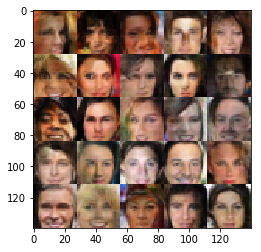

Epoch 4/10... Discriminator Loss: 0.607214... Generator Loss: 3.080078
Epoch 4/10... Discriminator Loss: 0.836433... Generator Loss: 1.274465
Epoch 4/10... Discriminator Loss: 1.762799... Generator Loss: 0.431572
Epoch 4/10... Discriminator Loss: 0.516979... Generator Loss: 1.662794
Epoch 4/10... Discriminator Loss: 0.523138... Generator Loss: 1.849792
Epoch 4/10... Discriminator Loss: 0.464845... Generator Loss: 2.396678
Epoch 4/10... Discriminator Loss: 0.652807... Generator Loss: 4.684072
Epoch 4/10... Discriminator Loss: 0.230507... Generator Loss: 2.143208
Epoch 4/10... Discriminator Loss: 0.285445... Generator Loss: 4.199837
Epoch 4/10... Discriminator Loss: 1.675078... Generator Loss: 0.405377


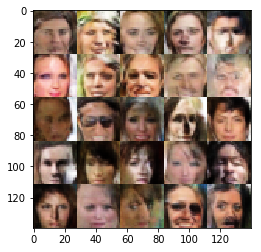

Epoch 4/10... Discriminator Loss: 0.652202... Generator Loss: 1.522824
Epoch 4/10... Discriminator Loss: 0.281712... Generator Loss: 2.084404
Epoch 4/10... Discriminator Loss: 0.215320... Generator Loss: 2.601326
Epoch 4/10... Discriminator Loss: 0.441972... Generator Loss: 1.451904
Epoch 4/10... Discriminator Loss: 0.325315... Generator Loss: 2.002564
Epoch 4/10... Discriminator Loss: 0.210774... Generator Loss: 5.329151
Epoch 4/10... Discriminator Loss: 0.269734... Generator Loss: 2.108009
Epoch 4/10... Discriminator Loss: 0.196625... Generator Loss: 3.818812
Epoch 4/10... Discriminator Loss: 0.771102... Generator Loss: 1.404468
Epoch 4/10... Discriminator Loss: 0.171276... Generator Loss: 2.745436


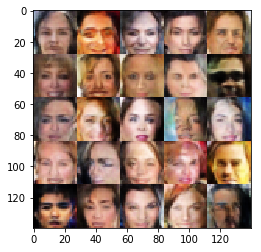

Epoch 4/10... Discriminator Loss: 0.544410... Generator Loss: 1.363439
Epoch 4/10... Discriminator Loss: 0.680925... Generator Loss: 1.122361
Epoch 4/10... Discriminator Loss: 0.139960... Generator Loss: 3.359279
Epoch 4/10... Discriminator Loss: 0.215046... Generator Loss: 2.577789
Epoch 4/10... Discriminator Loss: 0.292867... Generator Loss: 3.622788
Epoch 4/10... Discriminator Loss: 0.198927... Generator Loss: 2.225460
Epoch 4/10... Discriminator Loss: 0.188647... Generator Loss: 2.322239
Epoch 4/10... Discriminator Loss: 0.600013... Generator Loss: 1.377745
Epoch 4/10... Discriminator Loss: 0.114088... Generator Loss: 3.207291
Epoch 4/10... Discriminator Loss: 0.412377... Generator Loss: 1.532893


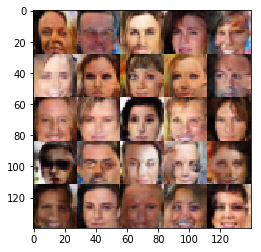

Epoch 4/10... Discriminator Loss: 0.347269... Generator Loss: 2.162353
Epoch 4/10... Discriminator Loss: 0.255505... Generator Loss: 2.104548
Epoch 4/10... Discriminator Loss: 0.047295... Generator Loss: 4.254245
Epoch 4/10... Discriminator Loss: 0.323822... Generator Loss: 1.699378
Epoch 4/10... Discriminator Loss: 0.091193... Generator Loss: 4.027173
Epoch 4/10... Discriminator Loss: 0.075760... Generator Loss: 3.708886
Epoch 4/10... Discriminator Loss: 0.036606... Generator Loss: 5.004548
Epoch 4/10... Discriminator Loss: 0.205063... Generator Loss: 4.617478
Epoch 4/10... Discriminator Loss: 0.397038... Generator Loss: 1.655302
Epoch 4/10... Discriminator Loss: 0.106072... Generator Loss: 3.400140


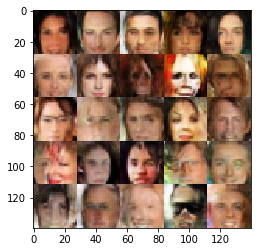

Epoch 4/10... Discriminator Loss: 0.086882... Generator Loss: 3.248295
Epoch 4/10... Discriminator Loss: 0.282983... Generator Loss: 2.216408
Epoch 4/10... Discriminator Loss: 0.083330... Generator Loss: 4.024486
Epoch 4/10... Discriminator Loss: 0.089395... Generator Loss: 3.634006
Epoch 4/10... Discriminator Loss: 0.037283... Generator Loss: 4.520842
Epoch 4/10... Discriminator Loss: 0.464721... Generator Loss: 1.776806
Epoch 4/10... Discriminator Loss: 0.452719... Generator Loss: 1.578805
Epoch 4/10... Discriminator Loss: 0.072276... Generator Loss: 5.892364
Epoch 4/10... Discriminator Loss: 0.444937... Generator Loss: 1.744614
Epoch 4/10... Discriminator Loss: 0.520604... Generator Loss: 1.298126


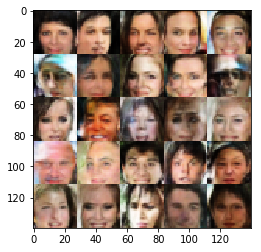

Epoch 4/10... Discriminator Loss: 0.044404... Generator Loss: 4.835008
Epoch 4/10... Discriminator Loss: 0.090748... Generator Loss: 5.372368
Epoch 4/10... Discriminator Loss: 0.094489... Generator Loss: 3.721669
Epoch 4/10... Discriminator Loss: 0.060009... Generator Loss: 4.024123
Epoch 4/10... Discriminator Loss: 0.107456... Generator Loss: 3.215305
Epoch 4/10... Discriminator Loss: 0.439797... Generator Loss: 1.548407
Epoch 4/10... Discriminator Loss: 0.053405... Generator Loss: 4.227020
Epoch 4/10... Discriminator Loss: 0.181504... Generator Loss: 2.590844
Epoch 4/10... Discriminator Loss: 2.845570... Generator Loss: 4.069955
Epoch 4/10... Discriminator Loss: 1.139235... Generator Loss: 2.251965


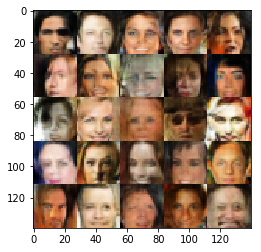

Epoch 4/10... Discriminator Loss: 0.929595... Generator Loss: 1.723380
Epoch 4/10... Discriminator Loss: 1.511666... Generator Loss: 0.531270
Epoch 4/10... Discriminator Loss: 1.667290... Generator Loss: 0.541774
Epoch 4/10... Discriminator Loss: 1.814746... Generator Loss: 0.460575
Epoch 4/10... Discriminator Loss: 0.502674... Generator Loss: 3.443010
Epoch 4/10... Discriminator Loss: 0.630495... Generator Loss: 1.245177
Epoch 4/10... Discriminator Loss: 0.729908... Generator Loss: 4.287630
Epoch 4/10... Discriminator Loss: 0.991218... Generator Loss: 1.069099
Epoch 4/10... Discriminator Loss: 0.507409... Generator Loss: 4.813372
Epoch 4/10... Discriminator Loss: 0.315085... Generator Loss: 2.269386


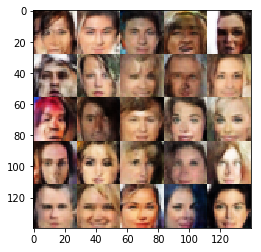

Epoch 4/10... Discriminator Loss: 0.473199... Generator Loss: 1.740214
Epoch 4/10... Discriminator Loss: 0.234554... Generator Loss: 2.773985
Epoch 4/10... Discriminator Loss: 0.864518... Generator Loss: 1.060202
Epoch 4/10... Discriminator Loss: 0.077684... Generator Loss: 4.324310
Epoch 4/10... Discriminator Loss: 0.264265... Generator Loss: 2.043427
Epoch 4/10... Discriminator Loss: 0.270939... Generator Loss: 2.332361
Epoch 4/10... Discriminator Loss: 0.173229... Generator Loss: 2.751791
Epoch 4/10... Discriminator Loss: 0.358952... Generator Loss: 1.539244
Epoch 4/10... Discriminator Loss: 0.844931... Generator Loss: 6.765906
Epoch 4/10... Discriminator Loss: 0.123455... Generator Loss: 3.605836


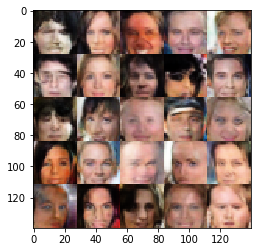

Epoch 4/10... Discriminator Loss: 0.138007... Generator Loss: 3.588414
Epoch 4/10... Discriminator Loss: 0.397485... Generator Loss: 1.783667
Epoch 4/10... Discriminator Loss: 0.110533... Generator Loss: 3.670081
Epoch 4/10... Discriminator Loss: 0.657359... Generator Loss: 1.273854
Epoch 4/10... Discriminator Loss: 0.145645... Generator Loss: 3.212629
Epoch 4/10... Discriminator Loss: 0.083458... Generator Loss: 3.774673
Epoch 4/10... Discriminator Loss: 0.212398... Generator Loss: 2.577170
Epoch 4/10... Discriminator Loss: 1.017137... Generator Loss: 5.230514
Epoch 4/10... Discriminator Loss: 0.261251... Generator Loss: 2.631457
Epoch 4/10... Discriminator Loss: 1.875757... Generator Loss: 0.330349


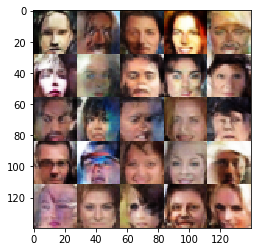

Epoch 4/10... Discriminator Loss: 0.189413... Generator Loss: 3.609167
Epoch 4/10... Discriminator Loss: 0.497936... Generator Loss: 1.570464
Epoch 4/10... Discriminator Loss: 0.141198... Generator Loss: 4.505639
Epoch 4/10... Discriminator Loss: 0.276822... Generator Loss: 2.096431
Epoch 4/10... Discriminator Loss: 0.118030... Generator Loss: 3.087481
Epoch 4/10... Discriminator Loss: 0.106352... Generator Loss: 3.430772
Epoch 4/10... Discriminator Loss: 0.082756... Generator Loss: 4.312562
Epoch 4/10... Discriminator Loss: 0.081394... Generator Loss: 4.271192
Epoch 4/10... Discriminator Loss: 0.086801... Generator Loss: 3.925938
Epoch 4/10... Discriminator Loss: 0.082449... Generator Loss: 3.486896


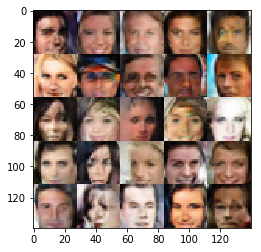

Epoch 4/10... Discriminator Loss: 0.107066... Generator Loss: 5.189716
Epoch 4/10... Discriminator Loss: 2.086078... Generator Loss: 0.275388
Epoch 4/10... Discriminator Loss: 0.172587... Generator Loss: 5.143068
Epoch 4/10... Discriminator Loss: 0.711208... Generator Loss: 1.782519
Epoch 4/10... Discriminator Loss: 0.476897... Generator Loss: 2.124442
Epoch 4/10... Discriminator Loss: 0.272138... Generator Loss: 2.512382
Epoch 4/10... Discriminator Loss: 0.134087... Generator Loss: 3.779277
Epoch 4/10... Discriminator Loss: 2.938300... Generator Loss: 0.220084
Epoch 4/10... Discriminator Loss: 0.163037... Generator Loss: 3.155823
Epoch 4/10... Discriminator Loss: 2.350656... Generator Loss: 0.321330


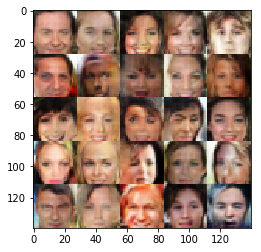

Epoch 4/10... Discriminator Loss: 0.165024... Generator Loss: 3.111170
Epoch 4/10... Discriminator Loss: 1.401879... Generator Loss: 8.967380
Epoch 4/10... Discriminator Loss: 0.199793... Generator Loss: 2.449333
Epoch 4/10... Discriminator Loss: 0.194320... Generator Loss: 3.081115
Epoch 4/10... Discriminator Loss: 0.222424... Generator Loss: 2.689349
Epoch 4/10... Discriminator Loss: 0.126282... Generator Loss: 3.486269
Epoch 4/10... Discriminator Loss: 0.081828... Generator Loss: 5.106549
Epoch 4/10... Discriminator Loss: 0.078247... Generator Loss: 5.043556
Epoch 4/10... Discriminator Loss: 0.145655... Generator Loss: 3.282014
Epoch 4/10... Discriminator Loss: 0.016930... Generator Loss: 5.290695


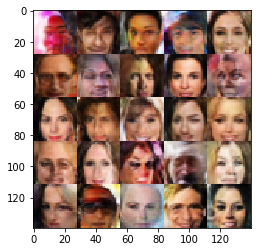

Epoch 4/10... Discriminator Loss: 0.097444... Generator Loss: 3.618143
Epoch 4/10... Discriminator Loss: 0.068752... Generator Loss: 6.826705
Epoch 4/10... Discriminator Loss: 0.155441... Generator Loss: 4.757275
Epoch 4/10... Discriminator Loss: 0.099776... Generator Loss: 5.415251
Epoch 4/10... Discriminator Loss: 0.169079... Generator Loss: 2.511139
Epoch 4/10... Discriminator Loss: 0.087292... Generator Loss: 3.714994
Epoch 4/10... Discriminator Loss: 0.117873... Generator Loss: 3.052409
Epoch 4/10... Discriminator Loss: 0.085484... Generator Loss: 3.482760
Epoch 4/10... Discriminator Loss: 0.184141... Generator Loss: 2.344103
Epoch 4/10... Discriminator Loss: 0.103724... Generator Loss: 3.333468


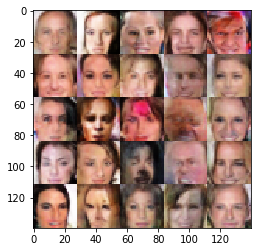

Epoch 4/10... Discriminator Loss: 0.053247... Generator Loss: 4.917791
Epoch 4/10... Discriminator Loss: 0.194852... Generator Loss: 2.498172
Epoch 4/10... Discriminator Loss: 0.095816... Generator Loss: 3.934982
Epoch 4/10... Discriminator Loss: 0.172107... Generator Loss: 2.529935
Epoch 4/10... Discriminator Loss: 0.044569... Generator Loss: 4.130591
Epoch 4/10... Discriminator Loss: 0.110520... Generator Loss: 3.078388
Epoch 4/10... Discriminator Loss: 0.090636... Generator Loss: 7.966252
Epoch 4/10... Discriminator Loss: 0.187825... Generator Loss: 2.602293
Epoch 4/10... Discriminator Loss: 0.049307... Generator Loss: 5.180290
Epoch 4/10... Discriminator Loss: 0.175075... Generator Loss: 2.562162


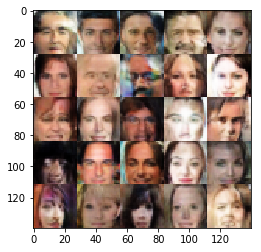

Epoch 4/10... Discriminator Loss: 2.085948... Generator Loss: 0.289418
Epoch 4/10... Discriminator Loss: 2.543345... Generator Loss: 7.390707
Epoch 4/10... Discriminator Loss: 0.267710... Generator Loss: 3.254454
Epoch 4/10... Discriminator Loss: 1.098844... Generator Loss: 1.198235
Epoch 4/10... Discriminator Loss: 1.376424... Generator Loss: 0.729956
Epoch 4/10... Discriminator Loss: 0.841172... Generator Loss: 1.356260
Epoch 4/10... Discriminator Loss: 0.137109... Generator Loss: 3.607566
Epoch 4/10... Discriminator Loss: 0.197058... Generator Loss: 3.264030
Epoch 4/10... Discriminator Loss: 0.150197... Generator Loss: 3.697167
Epoch 4/10... Discriminator Loss: 0.141214... Generator Loss: 5.236366


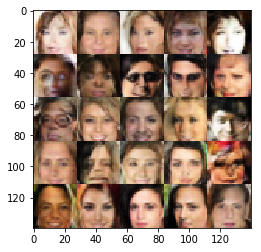

Epoch 4/10... Discriminator Loss: 0.251270... Generator Loss: 3.620054
Epoch 4/10... Discriminator Loss: 0.073972... Generator Loss: 4.840182
Epoch 4/10... Discriminator Loss: 0.157115... Generator Loss: 3.361650
Epoch 4/10... Discriminator Loss: 1.132539... Generator Loss: 0.907842
Epoch 4/10... Discriminator Loss: 0.142171... Generator Loss: 3.511433
Epoch 4/10... Discriminator Loss: 1.660679... Generator Loss: 0.380860
Epoch 4/10... Discriminator Loss: 0.689654... Generator Loss: 1.545429
Epoch 4/10... Discriminator Loss: 0.282710... Generator Loss: 2.100343
Epoch 4/10... Discriminator Loss: 0.107237... Generator Loss: 3.441282
Epoch 4/10... Discriminator Loss: 1.591413... Generator Loss: 0.444501


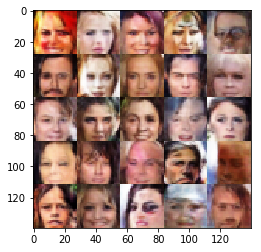

Epoch 4/10... Discriminator Loss: 0.188952... Generator Loss: 4.069035
Epoch 4/10... Discriminator Loss: 0.116986... Generator Loss: 3.612131
Epoch 4/10... Discriminator Loss: 0.105172... Generator Loss: 3.909379
Epoch 4/10... Discriminator Loss: 0.142465... Generator Loss: 5.935204
Epoch 4/10... Discriminator Loss: 1.535735... Generator Loss: 0.516439
Epoch 4/10... Discriminator Loss: 0.136909... Generator Loss: 2.922812
Epoch 4/10... Discriminator Loss: 0.407534... Generator Loss: 1.642575
Epoch 4/10... Discriminator Loss: 0.433519... Generator Loss: 1.649707
Epoch 4/10... Discriminator Loss: 0.120048... Generator Loss: 5.536880
Epoch 4/10... Discriminator Loss: 0.187877... Generator Loss: 2.360119


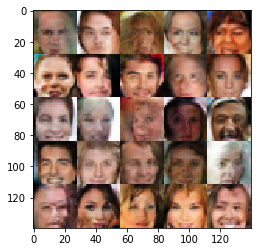

Epoch 4/10... Discriminator Loss: 0.185025... Generator Loss: 2.400103
Epoch 4/10... Discriminator Loss: 0.114606... Generator Loss: 3.048829
Epoch 4/10... Discriminator Loss: 0.136460... Generator Loss: 2.657290
Epoch 4/10... Discriminator Loss: 0.066244... Generator Loss: 4.584045
Epoch 4/10... Discriminator Loss: 0.434423... Generator Loss: 1.580956
Epoch 4/10... Discriminator Loss: 0.063178... Generator Loss: 3.813771
Epoch 4/10... Discriminator Loss: 0.123732... Generator Loss: 3.681498
Epoch 4/10... Discriminator Loss: 0.401029... Generator Loss: 1.798891
Epoch 4/10... Discriminator Loss: 1.669540... Generator Loss: 8.644936
Epoch 4/10... Discriminator Loss: 1.269390... Generator Loss: 0.796490


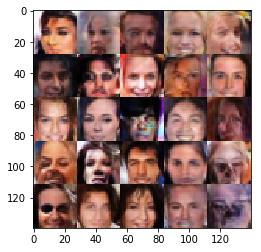

Epoch 4/10... Discriminator Loss: 0.147975... Generator Loss: 2.770527
Epoch 4/10... Discriminator Loss: 3.168100... Generator Loss: 0.161478
Epoch 4/10... Discriminator Loss: 0.054078... Generator Loss: 7.824864
Epoch 4/10... Discriminator Loss: 0.107985... Generator Loss: 3.331497
Epoch 4/10... Discriminator Loss: 0.159358... Generator Loss: 2.778503
Epoch 4/10... Discriminator Loss: 0.254303... Generator Loss: 2.412157
Epoch 4/10... Discriminator Loss: 0.189976... Generator Loss: 2.577016
Epoch 4/10... Discriminator Loss: 0.129842... Generator Loss: 3.217202
Epoch 4/10... Discriminator Loss: 0.095676... Generator Loss: 3.809526
Epoch 4/10... Discriminator Loss: 0.090704... Generator Loss: 3.650564


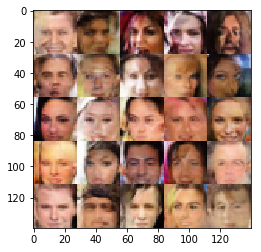

Epoch 4/10... Discriminator Loss: 0.014914... Generator Loss: 4.997881
Epoch 4/10... Discriminator Loss: 0.045774... Generator Loss: 5.645797
Epoch 4/10... Discriminator Loss: 0.615648... Generator Loss: 1.377714
Epoch 4/10... Discriminator Loss: 0.059917... Generator Loss: 4.229332
Epoch 4/10... Discriminator Loss: 0.194786... Generator Loss: 2.375117
Epoch 4/10... Discriminator Loss: 1.543584... Generator Loss: 0.504090
Epoch 4/10... Discriminator Loss: 0.106304... Generator Loss: 3.371927
Epoch 4/10... Discriminator Loss: 0.054239... Generator Loss: 3.682193
Epoch 4/10... Discriminator Loss: 0.121827... Generator Loss: 3.511733
Epoch 4/10... Discriminator Loss: 0.317590... Generator Loss: 1.955887


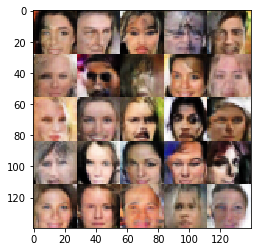

Epoch 4/10... Discriminator Loss: 0.102538... Generator Loss: 3.007350
Epoch 4/10... Discriminator Loss: 0.238261... Generator Loss: 6.121260
Epoch 4/10... Discriminator Loss: 0.858515... Generator Loss: 0.912557
Epoch 4/10... Discriminator Loss: 2.570818... Generator Loss: 0.199461
Epoch 4/10... Discriminator Loss: 0.918915... Generator Loss: 1.035319
Epoch 4/10... Discriminator Loss: 0.058736... Generator Loss: 3.963534
Epoch 4/10... Discriminator Loss: 0.195532... Generator Loss: 3.204791
Epoch 4/10... Discriminator Loss: 0.027461... Generator Loss: 5.943279
Epoch 4/10... Discriminator Loss: 2.536088... Generator Loss: 0.436063
Epoch 4/10... Discriminator Loss: 1.040574... Generator Loss: 3.151186


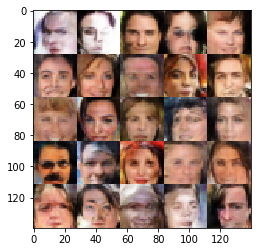

Epoch 4/10... Discriminator Loss: 0.430654... Generator Loss: 2.296587
Epoch 4/10... Discriminator Loss: 1.587013... Generator Loss: 0.806286
Epoch 4/10... Discriminator Loss: 0.708560... Generator Loss: 1.470156
Epoch 4/10... Discriminator Loss: 1.908158... Generator Loss: 0.667723
Epoch 4/10... Discriminator Loss: 0.186729... Generator Loss: 3.403803
Epoch 4/10... Discriminator Loss: 0.139500... Generator Loss: 3.194573
Epoch 4/10... Discriminator Loss: 1.367696... Generator Loss: 0.723988
Epoch 4/10... Discriminator Loss: 0.132525... Generator Loss: 5.919271
Epoch 4/10... Discriminator Loss: 0.159381... Generator Loss: 2.599918
Epoch 4/10... Discriminator Loss: 0.130374... Generator Loss: 3.662496


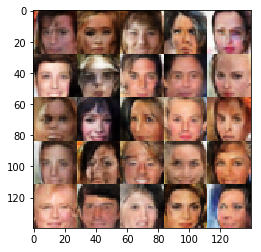

Epoch 4/10... Discriminator Loss: 0.755176... Generator Loss: 1.170156
Epoch 4/10... Discriminator Loss: 0.449015... Generator Loss: 5.315488
Epoch 4/10... Discriminator Loss: 1.150979... Generator Loss: 0.918097
Epoch 4/10... Discriminator Loss: 0.494683... Generator Loss: 1.732815
Epoch 4/10... Discriminator Loss: 1.809560... Generator Loss: 0.332429
Epoch 4/10... Discriminator Loss: 1.892578... Generator Loss: 0.493257
Epoch 4/10... Discriminator Loss: 0.132724... Generator Loss: 3.491816
Epoch 4/10... Discriminator Loss: 0.079336... Generator Loss: 3.973383
Epoch 4/10... Discriminator Loss: 0.084499... Generator Loss: 5.698310
Epoch 4/10... Discriminator Loss: 1.319791... Generator Loss: 0.644942


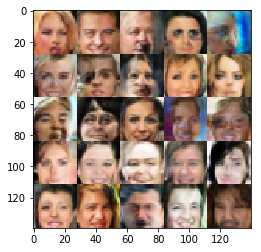

Epoch 4/10... Discriminator Loss: 0.195618... Generator Loss: 2.440615
Epoch 4/10... Discriminator Loss: 0.159528... Generator Loss: 2.910743
Epoch 4/10... Discriminator Loss: 0.119591... Generator Loss: 4.810004
Epoch 4/10... Discriminator Loss: 0.026739... Generator Loss: 5.487150
Epoch 4/10... Discriminator Loss: 0.035450... Generator Loss: 4.083370
Epoch 4/10... Discriminator Loss: 0.169111... Generator Loss: 3.644663
Epoch 4/10... Discriminator Loss: 0.036179... Generator Loss: 6.167485
Epoch 4/10... Discriminator Loss: 0.063936... Generator Loss: 5.097160
Epoch 4/10... Discriminator Loss: 0.064644... Generator Loss: 4.408829
Epoch 4/10... Discriminator Loss: 1.037429... Generator Loss: 0.799353


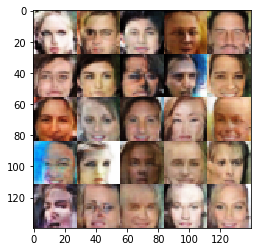

Epoch 4/10... Discriminator Loss: 0.204882... Generator Loss: 3.413177
Epoch 4/10... Discriminator Loss: 0.092673... Generator Loss: 5.692130
Epoch 4/10... Discriminator Loss: 0.116342... Generator Loss: 3.311581
Epoch 4/10... Discriminator Loss: 0.057126... Generator Loss: 7.536236
Epoch 4/10... Discriminator Loss: 3.546798... Generator Loss: 8.080751
Epoch 4/10... Discriminator Loss: 0.392691... Generator Loss: 2.296625
Epoch 4/10... Discriminator Loss: 1.217307... Generator Loss: 1.130667
Epoch 4/10... Discriminator Loss: 0.318696... Generator Loss: 2.329037
Epoch 4/10... Discriminator Loss: 0.456503... Generator Loss: 1.961909
Epoch 4/10... Discriminator Loss: 0.072583... Generator Loss: 4.464368


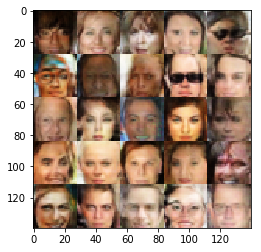

Epoch 4/10... Discriminator Loss: 0.176643... Generator Loss: 2.807744
Epoch 4/10... Discriminator Loss: 0.095091... Generator Loss: 4.355368
Epoch 4/10... Discriminator Loss: 0.108847... Generator Loss: 4.904038
Epoch 4/10... Discriminator Loss: 0.066593... Generator Loss: 4.288631
Epoch 4/10... Discriminator Loss: 0.271226... Generator Loss: 2.127849
Epoch 4/10... Discriminator Loss: 1.087358... Generator Loss: 7.589063
Epoch 4/10... Discriminator Loss: 2.465826... Generator Loss: 0.262447
Epoch 4/10... Discriminator Loss: 0.128146... Generator Loss: 3.508521
Epoch 4/10... Discriminator Loss: 0.466002... Generator Loss: 1.723366
Epoch 4/10... Discriminator Loss: 0.238615... Generator Loss: 2.850272


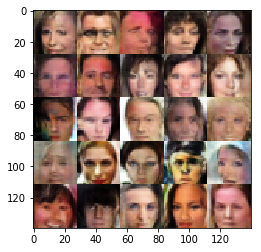

Epoch 4/10... Discriminator Loss: 0.047243... Generator Loss: 4.084723
Epoch 4/10... Discriminator Loss: 0.758182... Generator Loss: 1.205253
Epoch 4/10... Discriminator Loss: 0.158433... Generator Loss: 2.821591
Epoch 4/10... Discriminator Loss: 0.464256... Generator Loss: 1.681240
Epoch 4/10... Discriminator Loss: 0.413984... Generator Loss: 4.146777
Epoch 4/10... Discriminator Loss: 0.834114... Generator Loss: 0.994888
Epoch 4/10... Discriminator Loss: 0.537594... Generator Loss: 1.549789
Epoch 4/10... Discriminator Loss: 1.417945... Generator Loss: 0.563209
Epoch 4/10... Discriminator Loss: 0.119325... Generator Loss: 3.413914
Epoch 4/10... Discriminator Loss: 0.299607... Generator Loss: 2.298662


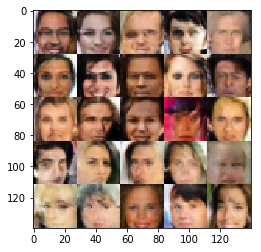

Epoch 4/10... Discriminator Loss: 6.476197... Generator Loss: 11.362574
Epoch 4/10... Discriminator Loss: 0.389593... Generator Loss: 2.670050
Epoch 4/10... Discriminator Loss: 0.975187... Generator Loss: 1.043452
Epoch 4/10... Discriminator Loss: 0.239402... Generator Loss: 2.544022
Epoch 4/10... Discriminator Loss: 0.608003... Generator Loss: 1.834925
Epoch 4/10... Discriminator Loss: 0.229417... Generator Loss: 2.728679
Epoch 4/10... Discriminator Loss: 0.249906... Generator Loss: 2.367799
Epoch 4/10... Discriminator Loss: 1.434884... Generator Loss: 9.364334
Epoch 4/10... Discriminator Loss: 0.223544... Generator Loss: 3.326849
Epoch 4/10... Discriminator Loss: 0.120615... Generator Loss: 3.201158


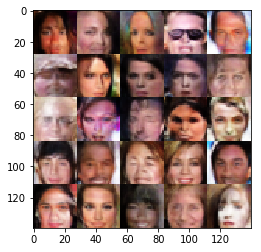

Epoch 4/10... Discriminator Loss: 0.320185... Generator Loss: 2.098554
Epoch 4/10... Discriminator Loss: 0.242822... Generator Loss: 2.625355
Epoch 4/10... Discriminator Loss: 0.136244... Generator Loss: 4.294347
Epoch 4/10... Discriminator Loss: 0.092954... Generator Loss: 3.624501
Epoch 4/10... Discriminator Loss: 0.461014... Generator Loss: 1.706826
Epoch 4/10... Discriminator Loss: 0.202461... Generator Loss: 2.354006
Epoch 4/10... Discriminator Loss: 0.812739... Generator Loss: 0.947646
Epoch 4/10... Discriminator Loss: 0.278403... Generator Loss: 2.311753
Epoch 4/10... Discriminator Loss: 0.308088... Generator Loss: 1.934021
Epoch 4/10... Discriminator Loss: 0.065623... Generator Loss: 4.053553


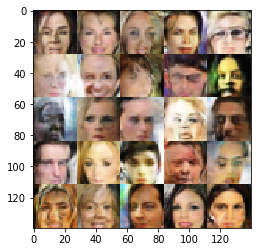

Epoch 4/10... Discriminator Loss: 0.116512... Generator Loss: 3.299598
Epoch 4/10... Discriminator Loss: 0.100226... Generator Loss: 3.377425
Epoch 4/10... Discriminator Loss: 1.794265... Generator Loss: 0.386518
Epoch 4/10... Discriminator Loss: 0.043218... Generator Loss: 6.639423
Epoch 4/10... Discriminator Loss: 0.058249... Generator Loss: 5.879227
Epoch 4/10... Discriminator Loss: 0.097167... Generator Loss: 4.653166
Epoch 4/10... Discriminator Loss: 0.086791... Generator Loss: 4.007323
Epoch 4/10... Discriminator Loss: 0.153483... Generator Loss: 3.472310
Epoch 4/10... Discriminator Loss: 0.059399... Generator Loss: 4.171322
Epoch 4/10... Discriminator Loss: 0.424000... Generator Loss: 1.685849


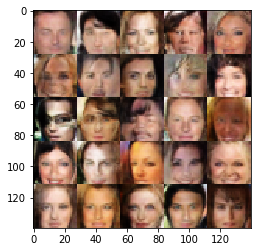

Epoch 4/10... Discriminator Loss: 0.242025... Generator Loss: 2.414552
Epoch 4/10... Discriminator Loss: 0.206125... Generator Loss: 2.590428
Epoch 4/10... Discriminator Loss: 0.117580... Generator Loss: 3.910718
Epoch 4/10... Discriminator Loss: 0.148425... Generator Loss: 4.163303
Epoch 4/10... Discriminator Loss: 0.133170... Generator Loss: 3.366683
Epoch 4/10... Discriminator Loss: 0.176543... Generator Loss: 5.530533
Epoch 4/10... Discriminator Loss: 1.817940... Generator Loss: 0.404100
Epoch 4/10... Discriminator Loss: 0.223203... Generator Loss: 3.652522
Epoch 4/10... Discriminator Loss: 0.343299... Generator Loss: 2.300868
Epoch 4/10... Discriminator Loss: 0.037205... Generator Loss: 4.497187


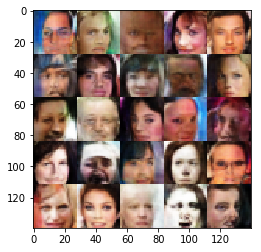

Epoch 4/10... Discriminator Loss: 0.094912... Generator Loss: 3.931972
Epoch 4/10... Discriminator Loss: 3.074821... Generator Loss: 0.208370
Epoch 4/10... Discriminator Loss: 0.079129... Generator Loss: 4.156072
Epoch 4/10... Discriminator Loss: 0.311210... Generator Loss: 2.166240
Epoch 4/10... Discriminator Loss: 0.258945... Generator Loss: 2.765241
Epoch 4/10... Discriminator Loss: 0.052011... Generator Loss: 5.669603
Epoch 4/10... Discriminator Loss: 0.074612... Generator Loss: 5.498180
Epoch 4/10... Discriminator Loss: 0.926897... Generator Loss: 0.941700
Epoch 4/10... Discriminator Loss: 0.700491... Generator Loss: 1.120950
Epoch 4/10... Discriminator Loss: 0.034664... Generator Loss: 5.615571


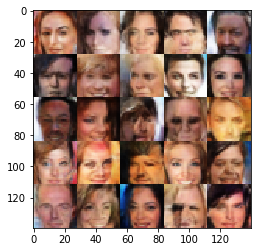

Epoch 4/10... Discriminator Loss: 0.090326... Generator Loss: 3.525929
Epoch 4/10... Discriminator Loss: 0.434991... Generator Loss: 1.661299
Epoch 4/10... Discriminator Loss: 0.162996... Generator Loss: 6.211290
Epoch 4/10... Discriminator Loss: 0.066200... Generator Loss: 3.845608
Epoch 4/10... Discriminator Loss: 0.027981... Generator Loss: 5.627399
Epoch 4/10... Discriminator Loss: 0.164622... Generator Loss: 9.069477
Epoch 4/10... Discriminator Loss: 0.112119... Generator Loss: 3.305049
Epoch 4/10... Discriminator Loss: 0.161550... Generator Loss: 3.240531
Epoch 4/10... Discriminator Loss: 0.069127... Generator Loss: 6.426994
Epoch 4/10... Discriminator Loss: 0.895185... Generator Loss: 0.845422


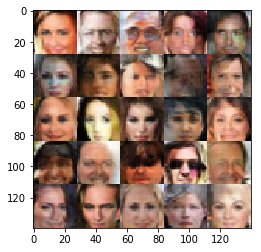

Epoch 5/10... Discriminator Loss: 1.050938... Generator Loss: 0.961379
Epoch 5/10... Discriminator Loss: 0.005543... Generator Loss: 7.538493
Epoch 5/10... Discriminator Loss: 0.378300... Generator Loss: 1.949868
Epoch 5/10... Discriminator Loss: 0.118310... Generator Loss: 3.242964
Epoch 5/10... Discriminator Loss: 0.069692... Generator Loss: 4.168128
Epoch 5/10... Discriminator Loss: 0.051868... Generator Loss: 4.217047
Epoch 5/10... Discriminator Loss: 0.017738... Generator Loss: 7.961016
Epoch 5/10... Discriminator Loss: 0.060121... Generator Loss: 3.740391
Epoch 5/10... Discriminator Loss: 0.077585... Generator Loss: 3.980870
Epoch 5/10... Discriminator Loss: 0.416721... Generator Loss: 1.573059


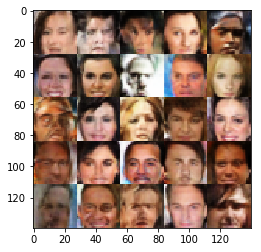

Epoch 5/10... Discriminator Loss: 3.498698... Generator Loss: 0.114366
Epoch 5/10... Discriminator Loss: 1.508210... Generator Loss: 4.893612
Epoch 5/10... Discriminator Loss: 0.447808... Generator Loss: 2.648709
Epoch 5/10... Discriminator Loss: 0.337163... Generator Loss: 2.881276
Epoch 5/10... Discriminator Loss: 0.318203... Generator Loss: 2.257060
Epoch 5/10... Discriminator Loss: 0.256281... Generator Loss: 2.478688
Epoch 5/10... Discriminator Loss: 1.522790... Generator Loss: 0.534582
Epoch 5/10... Discriminator Loss: 0.263920... Generator Loss: 2.411602
Epoch 5/10... Discriminator Loss: 0.176775... Generator Loss: 2.896388
Epoch 5/10... Discriminator Loss: 0.484919... Generator Loss: 1.767970


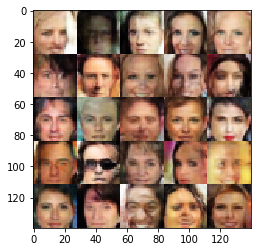

Epoch 5/10... Discriminator Loss: 0.466300... Generator Loss: 8.141157
Epoch 5/10... Discriminator Loss: 0.074517... Generator Loss: 4.310328
Epoch 5/10... Discriminator Loss: 0.077109... Generator Loss: 3.782152
Epoch 5/10... Discriminator Loss: 0.354548... Generator Loss: 2.036200
Epoch 5/10... Discriminator Loss: 0.019582... Generator Loss: 8.745898
Epoch 5/10... Discriminator Loss: 0.289625... Generator Loss: 2.069572
Epoch 5/10... Discriminator Loss: 0.722468... Generator Loss: 8.896971
Epoch 5/10... Discriminator Loss: 0.180100... Generator Loss: 4.144632
Epoch 5/10... Discriminator Loss: 0.522270... Generator Loss: 1.508451
Epoch 5/10... Discriminator Loss: 0.234049... Generator Loss: 2.425920


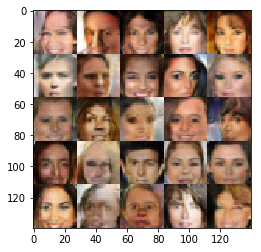

Epoch 5/10... Discriminator Loss: 0.131881... Generator Loss: 3.500071
Epoch 5/10... Discriminator Loss: 0.291621... Generator Loss: 2.500477
Epoch 5/10... Discriminator Loss: 0.575829... Generator Loss: 1.532740
Epoch 5/10... Discriminator Loss: 0.077739... Generator Loss: 4.222128
Epoch 5/10... Discriminator Loss: 0.164453... Generator Loss: 2.773297
Epoch 5/10... Discriminator Loss: 0.898919... Generator Loss: 1.386604
Epoch 5/10... Discriminator Loss: 1.915500... Generator Loss: 0.589427
Epoch 5/10... Discriminator Loss: 0.195659... Generator Loss: 7.557679
Epoch 5/10... Discriminator Loss: 0.833396... Generator Loss: 1.302475
Epoch 5/10... Discriminator Loss: 0.192995... Generator Loss: 2.822755


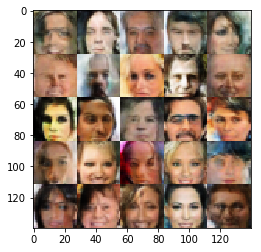

Epoch 5/10... Discriminator Loss: 0.112367... Generator Loss: 5.630056
Epoch 5/10... Discriminator Loss: 0.378003... Generator Loss: 2.332433
Epoch 5/10... Discriminator Loss: 1.704672... Generator Loss: 0.535992
Epoch 5/10... Discriminator Loss: 0.090418... Generator Loss: 4.792630
Epoch 5/10... Discriminator Loss: 0.036067... Generator Loss: 5.417737
Epoch 5/10... Discriminator Loss: 0.020287... Generator Loss: 5.718228
Epoch 5/10... Discriminator Loss: 2.928477... Generator Loss: 0.246376
Epoch 5/10... Discriminator Loss: 0.600137... Generator Loss: 2.115038
Epoch 5/10... Discriminator Loss: 0.780918... Generator Loss: 1.170456
Epoch 5/10... Discriminator Loss: 0.707607... Generator Loss: 4.104502


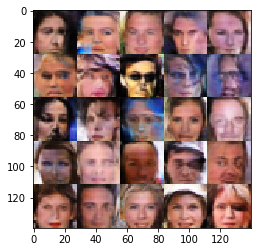

Epoch 5/10... Discriminator Loss: 0.289447... Generator Loss: 3.459609
Epoch 5/10... Discriminator Loss: 0.207554... Generator Loss: 4.255130
Epoch 5/10... Discriminator Loss: 0.182094... Generator Loss: 3.053498
Epoch 5/10... Discriminator Loss: 2.121129... Generator Loss: 0.325933
Epoch 5/10... Discriminator Loss: 2.187630... Generator Loss: 0.270984
Epoch 5/10... Discriminator Loss: 0.813994... Generator Loss: 0.978433
Epoch 5/10... Discriminator Loss: 1.405459... Generator Loss: 0.564556
Epoch 5/10... Discriminator Loss: 0.180348... Generator Loss: 2.974821
Epoch 5/10... Discriminator Loss: 0.352767... Generator Loss: 2.029571
Epoch 5/10... Discriminator Loss: 0.074830... Generator Loss: 4.055177


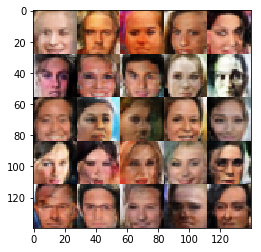

Epoch 5/10... Discriminator Loss: 0.059588... Generator Loss: 4.419704
Epoch 5/10... Discriminator Loss: 0.146855... Generator Loss: 2.922664
Epoch 5/10... Discriminator Loss: 0.106544... Generator Loss: 3.074192
Epoch 5/10... Discriminator Loss: 0.143789... Generator Loss: 3.128889
Epoch 5/10... Discriminator Loss: 0.058103... Generator Loss: 4.620566
Epoch 5/10... Discriminator Loss: 0.040433... Generator Loss: 4.669282
Epoch 5/10... Discriminator Loss: 0.197521... Generator Loss: 2.540112
Epoch 5/10... Discriminator Loss: 0.073214... Generator Loss: 4.001728
Epoch 5/10... Discriminator Loss: 0.656439... Generator Loss: 1.618290
Epoch 5/10... Discriminator Loss: 0.369309... Generator Loss: 1.930708


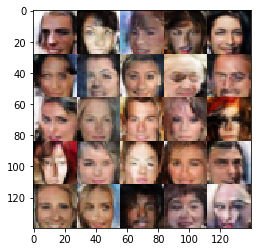

Epoch 5/10... Discriminator Loss: 0.161388... Generator Loss: 5.776505
Epoch 5/10... Discriminator Loss: 0.068638... Generator Loss: 4.683819
Epoch 5/10... Discriminator Loss: 0.036644... Generator Loss: 4.639538
Epoch 5/10... Discriminator Loss: 0.097031... Generator Loss: 4.682365
Epoch 5/10... Discriminator Loss: 0.239396... Generator Loss: 2.688487
Epoch 5/10... Discriminator Loss: 0.071739... Generator Loss: 4.243453
Epoch 5/10... Discriminator Loss: 0.312103... Generator Loss: 2.117042
Epoch 5/10... Discriminator Loss: 0.025596... Generator Loss: 5.743888
Epoch 5/10... Discriminator Loss: 0.190046... Generator Loss: 2.611127
Epoch 5/10... Discriminator Loss: 0.052549... Generator Loss: 5.226239


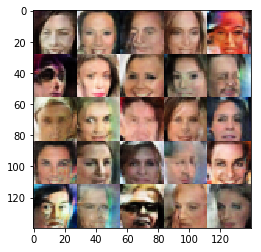

Epoch 5/10... Discriminator Loss: 0.056375... Generator Loss: 5.974992
Epoch 5/10... Discriminator Loss: 0.023090... Generator Loss: 6.103463
Epoch 5/10... Discriminator Loss: 0.090105... Generator Loss: 3.964854
Epoch 5/10... Discriminator Loss: 0.099191... Generator Loss: 3.366466
Epoch 5/10... Discriminator Loss: 0.044561... Generator Loss: 5.607109
Epoch 5/10... Discriminator Loss: 0.413146... Generator Loss: 8.834558
Epoch 5/10... Discriminator Loss: 0.491229... Generator Loss: 1.764979
Epoch 5/10... Discriminator Loss: 0.323345... Generator Loss: 2.844088
Epoch 5/10... Discriminator Loss: 0.399670... Generator Loss: 2.124133
Epoch 5/10... Discriminator Loss: 0.079607... Generator Loss: 3.671118


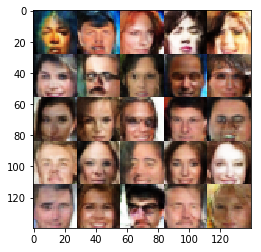

Epoch 5/10... Discriminator Loss: 0.440343... Generator Loss: 1.581212
Epoch 5/10... Discriminator Loss: 0.048416... Generator Loss: 7.732471
Epoch 5/10... Discriminator Loss: 0.206335... Generator Loss: 2.880312
Epoch 5/10... Discriminator Loss: 0.744812... Generator Loss: 1.870211
Epoch 5/10... Discriminator Loss: 2.139114... Generator Loss: 0.389581
Epoch 5/10... Discriminator Loss: 0.067089... Generator Loss: 5.190721
Epoch 5/10... Discriminator Loss: 0.501789... Generator Loss: 1.555596
Epoch 5/10... Discriminator Loss: 0.071124... Generator Loss: 5.684299
Epoch 5/10... Discriminator Loss: 0.093274... Generator Loss: 3.641490
Epoch 5/10... Discriminator Loss: 0.899682... Generator Loss: 1.369718


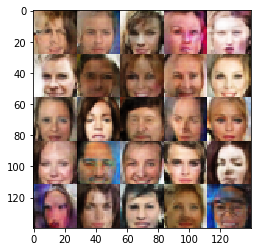

Epoch 5/10... Discriminator Loss: 1.157299... Generator Loss: 0.665134
Epoch 5/10... Discriminator Loss: 0.260045... Generator Loss: 2.572779
Epoch 5/10... Discriminator Loss: 0.321458... Generator Loss: 2.139295
Epoch 5/10... Discriminator Loss: 0.275664... Generator Loss: 2.344812
Epoch 5/10... Discriminator Loss: 0.483752... Generator Loss: 1.833249
Epoch 5/10... Discriminator Loss: 0.055273... Generator Loss: 4.132984
Epoch 5/10... Discriminator Loss: 0.329403... Generator Loss: 1.861759
Epoch 5/10... Discriminator Loss: 0.130158... Generator Loss: 3.086616
Epoch 5/10... Discriminator Loss: 0.164012... Generator Loss: 3.086896
Epoch 5/10... Discriminator Loss: 0.078923... Generator Loss: 5.427587


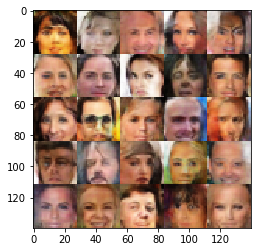

Epoch 5/10... Discriminator Loss: 0.031986... Generator Loss: 6.352849
Epoch 5/10... Discriminator Loss: 0.023463... Generator Loss: 5.182313
Epoch 5/10... Discriminator Loss: 0.884424... Generator Loss: 1.149512
Epoch 5/10... Discriminator Loss: 0.095179... Generator Loss: 4.523687
Epoch 5/10... Discriminator Loss: 0.119504... Generator Loss: 4.885509
Epoch 5/10... Discriminator Loss: 0.043510... Generator Loss: 6.734289
Epoch 5/10... Discriminator Loss: 0.081023... Generator Loss: 3.846636
Epoch 5/10... Discriminator Loss: 0.084205... Generator Loss: 3.457878
Epoch 5/10... Discriminator Loss: 0.168909... Generator Loss: 2.607553
Epoch 5/10... Discriminator Loss: 0.177816... Generator Loss: 2.459573


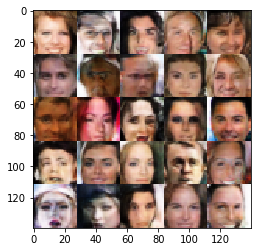

Epoch 5/10... Discriminator Loss: 0.782148... Generator Loss: 1.059974
Epoch 5/10... Discriminator Loss: 0.079277... Generator Loss: 3.715659
Epoch 5/10... Discriminator Loss: 0.065067... Generator Loss: 5.216435
Epoch 5/10... Discriminator Loss: 0.079779... Generator Loss: 3.844565
Epoch 5/10... Discriminator Loss: 0.024700... Generator Loss: 6.542486
Epoch 5/10... Discriminator Loss: 0.675316... Generator Loss: 1.205199
Epoch 5/10... Discriminator Loss: 0.111139... Generator Loss: 2.983518
Epoch 5/10... Discriminator Loss: 0.151245... Generator Loss: 2.691910
Epoch 5/10... Discriminator Loss: 0.060566... Generator Loss: 4.670502
Epoch 5/10... Discriminator Loss: 0.962058... Generator Loss: 6.872977


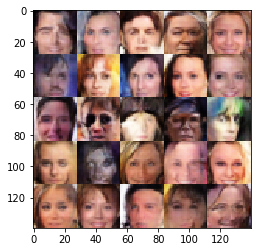

Epoch 5/10... Discriminator Loss: 1.384157... Generator Loss: 0.728721
Epoch 5/10... Discriminator Loss: 0.166783... Generator Loss: 4.407935
Epoch 5/10... Discriminator Loss: 0.145854... Generator Loss: 3.896776
Epoch 5/10... Discriminator Loss: 1.558586... Generator Loss: 0.657835
Epoch 5/10... Discriminator Loss: 0.058918... Generator Loss: 4.157131
Epoch 5/10... Discriminator Loss: 0.091159... Generator Loss: 5.095481
Epoch 5/10... Discriminator Loss: 0.304306... Generator Loss: 2.432687
Epoch 5/10... Discriminator Loss: 0.096461... Generator Loss: 3.831173
Epoch 5/10... Discriminator Loss: 0.151938... Generator Loss: 2.871263
Epoch 5/10... Discriminator Loss: 5.058768... Generator Loss: 0.062185


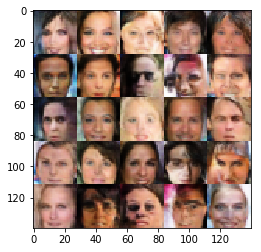

Epoch 5/10... Discriminator Loss: 0.337182... Generator Loss: 2.679447
Epoch 5/10... Discriminator Loss: 1.548965... Generator Loss: 7.456790
Epoch 5/10... Discriminator Loss: 3.520997... Generator Loss: 0.127178
Epoch 5/10... Discriminator Loss: 0.467383... Generator Loss: 2.260988
Epoch 5/10... Discriminator Loss: 1.944254... Generator Loss: 0.322526
Epoch 5/10... Discriminator Loss: 0.423302... Generator Loss: 1.948639
Epoch 5/10... Discriminator Loss: 0.219136... Generator Loss: 2.518967
Epoch 5/10... Discriminator Loss: 0.505545... Generator Loss: 1.614292
Epoch 5/10... Discriminator Loss: 0.339647... Generator Loss: 2.377254
Epoch 5/10... Discriminator Loss: 0.203320... Generator Loss: 4.122159


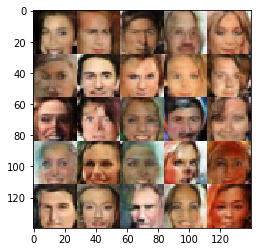

Epoch 5/10... Discriminator Loss: 0.214286... Generator Loss: 2.926592
Epoch 5/10... Discriminator Loss: 0.120581... Generator Loss: 3.352124
Epoch 5/10... Discriminator Loss: 0.146642... Generator Loss: 3.509136
Epoch 5/10... Discriminator Loss: 0.094383... Generator Loss: 4.080994
Epoch 5/10... Discriminator Loss: 0.445870... Generator Loss: 1.836749
Epoch 5/10... Discriminator Loss: 2.632074... Generator Loss: 0.347329
Epoch 5/10... Discriminator Loss: 0.037599... Generator Loss: 4.780372
Epoch 5/10... Discriminator Loss: 0.114812... Generator Loss: 3.333535
Epoch 5/10... Discriminator Loss: 0.069613... Generator Loss: 4.188395
Epoch 5/10... Discriminator Loss: 0.070080... Generator Loss: 4.930568


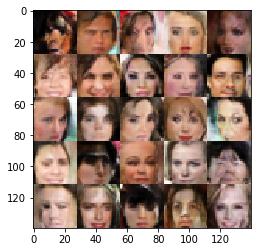

Epoch 5/10... Discriminator Loss: 0.672658... Generator Loss: 1.069622
Epoch 5/10... Discriminator Loss: 0.732261... Generator Loss: 1.175587
Epoch 5/10... Discriminator Loss: 0.189943... Generator Loss: 3.342910
Epoch 5/10... Discriminator Loss: 0.096378... Generator Loss: 3.895727
Epoch 5/10... Discriminator Loss: 0.207933... Generator Loss: 4.149841
Epoch 5/10... Discriminator Loss: 0.214380... Generator Loss: 2.617042
Epoch 5/10... Discriminator Loss: 0.157389... Generator Loss: 3.042259
Epoch 5/10... Discriminator Loss: 0.188591... Generator Loss: 2.721674
Epoch 5/10... Discriminator Loss: 0.125160... Generator Loss: 3.715738
Epoch 5/10... Discriminator Loss: 0.047647... Generator Loss: 4.367877


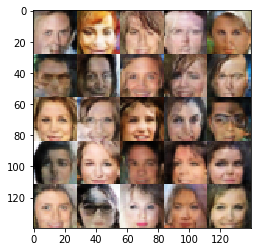

Epoch 5/10... Discriminator Loss: 0.119408... Generator Loss: 3.340460
Epoch 5/10... Discriminator Loss: 0.078717... Generator Loss: 3.815450
Epoch 5/10... Discriminator Loss: 0.032922... Generator Loss: 5.059479
Epoch 5/10... Discriminator Loss: 0.159576... Generator Loss: 3.320939
Epoch 5/10... Discriminator Loss: 0.406583... Generator Loss: 1.989036
Epoch 5/10... Discriminator Loss: 0.013277... Generator Loss: 8.043550
Epoch 5/10... Discriminator Loss: 0.054577... Generator Loss: 4.005305
Epoch 5/10... Discriminator Loss: 0.168546... Generator Loss: 2.597080
Epoch 5/10... Discriminator Loss: 0.049791... Generator Loss: 4.530589
Epoch 5/10... Discriminator Loss: 0.068908... Generator Loss: 4.315462


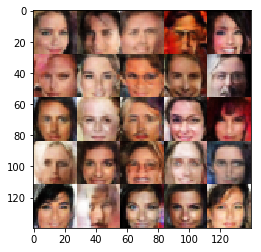

Epoch 5/10... Discriminator Loss: 0.171377... Generator Loss: 5.743293
Epoch 5/10... Discriminator Loss: 0.095101... Generator Loss: 4.714234
Epoch 5/10... Discriminator Loss: 0.120070... Generator Loss: 5.619936
Epoch 5/10... Discriminator Loss: 0.296845... Generator Loss: 2.469496
Epoch 5/10... Discriminator Loss: 1.615050... Generator Loss: 11.749062
Epoch 5/10... Discriminator Loss: 0.213414... Generator Loss: 2.625920
Epoch 5/10... Discriminator Loss: 1.242877... Generator Loss: 1.018497
Epoch 5/10... Discriminator Loss: 0.186710... Generator Loss: 5.813998
Epoch 5/10... Discriminator Loss: 0.139796... Generator Loss: 3.442654
Epoch 5/10... Discriminator Loss: 0.026392... Generator Loss: 5.716400


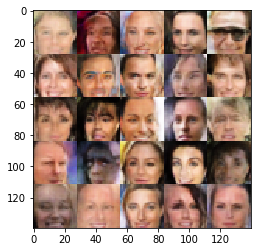

Epoch 5/10... Discriminator Loss: 0.205259... Generator Loss: 6.585861
Epoch 5/10... Discriminator Loss: 0.048726... Generator Loss: 3.948564
Epoch 5/10... Discriminator Loss: 0.179614... Generator Loss: 2.731693
Epoch 5/10... Discriminator Loss: 2.346269... Generator Loss: 0.280095
Epoch 5/10... Discriminator Loss: 0.079843... Generator Loss: 3.630094
Epoch 5/10... Discriminator Loss: 0.056362... Generator Loss: 7.566027
Epoch 5/10... Discriminator Loss: 0.311435... Generator Loss: 1.783382
Epoch 5/10... Discriminator Loss: 1.107513... Generator Loss: 0.986244
Epoch 5/10... Discriminator Loss: 0.036271... Generator Loss: 4.207627
Epoch 5/10... Discriminator Loss: 0.034061... Generator Loss: 4.964022


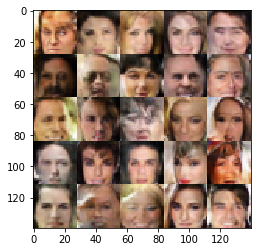

Epoch 5/10... Discriminator Loss: 0.850032... Generator Loss: 1.221028
Epoch 5/10... Discriminator Loss: 0.369475... Generator Loss: 1.875832
Epoch 5/10... Discriminator Loss: 0.028894... Generator Loss: 5.661666
Epoch 5/10... Discriminator Loss: 1.458937... Generator Loss: 0.720852
Epoch 5/10... Discriminator Loss: 0.114090... Generator Loss: 2.942424
Epoch 5/10... Discriminator Loss: 0.170863... Generator Loss: 2.858042
Epoch 5/10... Discriminator Loss: 0.271508... Generator Loss: 2.578269
Epoch 5/10... Discriminator Loss: 0.030433... Generator Loss: 5.435390
Epoch 5/10... Discriminator Loss: 0.064282... Generator Loss: 3.719690
Epoch 5/10... Discriminator Loss: 0.110575... Generator Loss: 4.094447


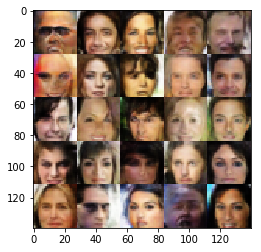

Epoch 5/10... Discriminator Loss: 0.032997... Generator Loss: 5.668584
Epoch 5/10... Discriminator Loss: 0.056331... Generator Loss: 3.915928
Epoch 5/10... Discriminator Loss: 0.087188... Generator Loss: 4.891179
Epoch 5/10... Discriminator Loss: 0.056134... Generator Loss: 4.466946
Epoch 5/10... Discriminator Loss: 0.042600... Generator Loss: 6.699850
Epoch 5/10... Discriminator Loss: 0.270925... Generator Loss: 2.126297
Epoch 5/10... Discriminator Loss: 0.300095... Generator Loss: 2.215564
Epoch 5/10... Discriminator Loss: 0.018768... Generator Loss: 6.103642
Epoch 5/10... Discriminator Loss: 0.019801... Generator Loss: 5.746342
Epoch 5/10... Discriminator Loss: 0.188387... Generator Loss: 2.934583


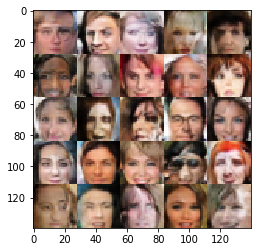

Epoch 5/10... Discriminator Loss: 0.644874... Generator Loss: 1.238974
Epoch 5/10... Discriminator Loss: 0.303807... Generator Loss: 1.926497
Epoch 5/10... Discriminator Loss: 0.051546... Generator Loss: 5.365773
Epoch 5/10... Discriminator Loss: 0.040703... Generator Loss: 4.921785
Epoch 5/10... Discriminator Loss: 1.704313... Generator Loss: 13.857569
Epoch 5/10... Discriminator Loss: 1.613425... Generator Loss: 1.904566
Epoch 5/10... Discriminator Loss: 0.964448... Generator Loss: 3.652379
Epoch 5/10... Discriminator Loss: 1.525357... Generator Loss: 4.515834
Epoch 5/10... Discriminator Loss: 1.202502... Generator Loss: 6.008578
Epoch 5/10... Discriminator Loss: 0.551957... Generator Loss: 1.714980


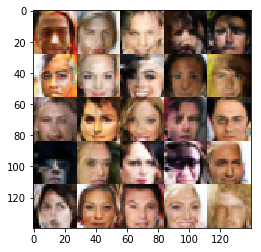

Epoch 5/10... Discriminator Loss: 0.664587... Generator Loss: 4.923065
Epoch 5/10... Discriminator Loss: 0.586850... Generator Loss: 1.716004
Epoch 5/10... Discriminator Loss: 0.422171... Generator Loss: 1.807657
Epoch 5/10... Discriminator Loss: 1.288884... Generator Loss: 0.734579
Epoch 5/10... Discriminator Loss: 0.087845... Generator Loss: 7.225063
Epoch 5/10... Discriminator Loss: 0.243263... Generator Loss: 2.177734
Epoch 5/10... Discriminator Loss: 0.160952... Generator Loss: 2.751491
Epoch 5/10... Discriminator Loss: 0.039783... Generator Loss: 4.998775
Epoch 5/10... Discriminator Loss: 4.385201... Generator Loss: 0.057023
Epoch 5/10... Discriminator Loss: 0.484470... Generator Loss: 2.479713


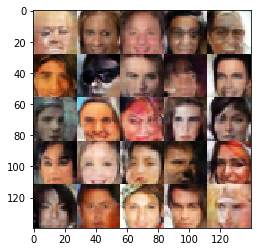

Epoch 5/10... Discriminator Loss: 0.410613... Generator Loss: 2.188273
Epoch 5/10... Discriminator Loss: 0.635073... Generator Loss: 1.611591
Epoch 5/10... Discriminator Loss: 0.803255... Generator Loss: 1.366208
Epoch 5/10... Discriminator Loss: 0.567899... Generator Loss: 1.661936
Epoch 5/10... Discriminator Loss: 0.524685... Generator Loss: 1.773110
Epoch 5/10... Discriminator Loss: 0.088469... Generator Loss: 3.838333
Epoch 5/10... Discriminator Loss: 0.080655... Generator Loss: 4.594535
Epoch 5/10... Discriminator Loss: 0.891036... Generator Loss: 1.231598
Epoch 5/10... Discriminator Loss: 0.053360... Generator Loss: 4.269448
Epoch 5/10... Discriminator Loss: 0.100305... Generator Loss: 3.595918


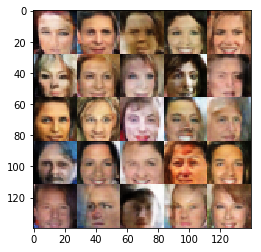

Epoch 5/10... Discriminator Loss: 0.087057... Generator Loss: 3.621390
Epoch 5/10... Discriminator Loss: 0.614562... Generator Loss: 1.575353
Epoch 5/10... Discriminator Loss: 0.125446... Generator Loss: 3.217038
Epoch 5/10... Discriminator Loss: 0.497332... Generator Loss: 1.593029
Epoch 5/10... Discriminator Loss: 0.043594... Generator Loss: 4.908161
Epoch 5/10... Discriminator Loss: 0.196555... Generator Loss: 2.705499
Epoch 5/10... Discriminator Loss: 0.310665... Generator Loss: 2.162419
Epoch 5/10... Discriminator Loss: 0.099268... Generator Loss: 3.809379
Epoch 5/10... Discriminator Loss: 0.039448... Generator Loss: 5.111537
Epoch 5/10... Discriminator Loss: 0.067401... Generator Loss: 4.212667


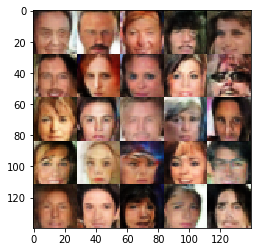

Epoch 5/10... Discriminator Loss: 0.076652... Generator Loss: 4.290441
Epoch 5/10... Discriminator Loss: 0.200072... Generator Loss: 2.666991
Epoch 5/10... Discriminator Loss: 0.021651... Generator Loss: 6.998930
Epoch 5/10... Discriminator Loss: 0.217377... Generator Loss: 3.699422
Epoch 5/10... Discriminator Loss: 0.085597... Generator Loss: 4.336616
Epoch 5/10... Discriminator Loss: 1.668986... Generator Loss: 0.516797
Epoch 5/10... Discriminator Loss: 0.313879... Generator Loss: 2.016854
Epoch 5/10... Discriminator Loss: 0.123569... Generator Loss: 3.207017
Epoch 5/10... Discriminator Loss: 0.174095... Generator Loss: 2.562304
Epoch 5/10... Discriminator Loss: 0.063221... Generator Loss: 4.227779


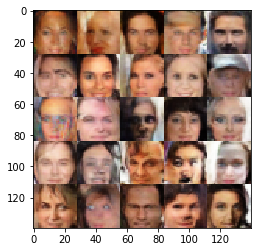

Epoch 5/10... Discriminator Loss: 0.134968... Generator Loss: 3.721805
Epoch 5/10... Discriminator Loss: 0.024011... Generator Loss: 4.780005
Epoch 5/10... Discriminator Loss: 0.046695... Generator Loss: 5.942822
Epoch 5/10... Discriminator Loss: 0.090743... Generator Loss: 3.786812
Epoch 5/10... Discriminator Loss: 0.036675... Generator Loss: 4.634321
Epoch 5/10... Discriminator Loss: 0.237135... Generator Loss: 2.393245
Epoch 5/10... Discriminator Loss: 0.557920... Generator Loss: 1.580683
Epoch 5/10... Discriminator Loss: 0.740209... Generator Loss: 9.699342
Epoch 5/10... Discriminator Loss: 2.991490... Generator Loss: 11.324997
Epoch 5/10... Discriminator Loss: 0.277174... Generator Loss: 2.996995


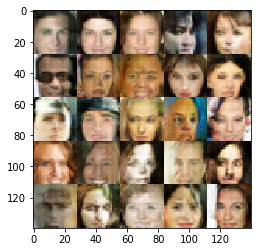

Epoch 5/10... Discriminator Loss: 1.228700... Generator Loss: 1.061528
Epoch 5/10... Discriminator Loss: 0.433617... Generator Loss: 2.526754
Epoch 5/10... Discriminator Loss: 0.136018... Generator Loss: 3.764482
Epoch 5/10... Discriminator Loss: 0.594318... Generator Loss: 1.656802
Epoch 5/10... Discriminator Loss: 0.098950... Generator Loss: 4.847803
Epoch 5/10... Discriminator Loss: 0.107091... Generator Loss: 3.743139
Epoch 5/10... Discriminator Loss: 0.846601... Generator Loss: 1.135132
Epoch 5/10... Discriminator Loss: 0.224758... Generator Loss: 2.443454
Epoch 5/10... Discriminator Loss: 0.073454... Generator Loss: 4.838703
Epoch 5/10... Discriminator Loss: 0.019834... Generator Loss: 5.164629


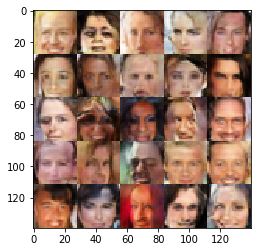

Epoch 5/10... Discriminator Loss: 0.047996... Generator Loss: 4.493001
Epoch 5/10... Discriminator Loss: 0.131414... Generator Loss: 4.978999
Epoch 5/10... Discriminator Loss: 0.158120... Generator Loss: 2.927306
Epoch 5/10... Discriminator Loss: 0.245619... Generator Loss: 2.255440
Epoch 5/10... Discriminator Loss: 0.359982... Generator Loss: 2.222919
Epoch 5/10... Discriminator Loss: 0.165920... Generator Loss: 2.609751
Epoch 5/10... Discriminator Loss: 2.453331... Generator Loss: 0.314287
Epoch 5/10... Discriminator Loss: 0.060380... Generator Loss: 4.045549
Epoch 5/10... Discriminator Loss: 0.158419... Generator Loss: 2.587981
Epoch 5/10... Discriminator Loss: 0.133536... Generator Loss: 3.271918


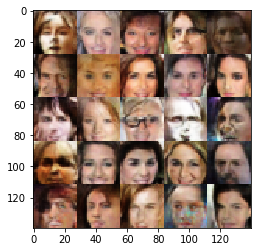

Epoch 5/10... Discriminator Loss: 0.329487... Generator Loss: 2.159507
Epoch 5/10... Discriminator Loss: 0.020647... Generator Loss: 6.809106
Epoch 5/10... Discriminator Loss: 0.148642... Generator Loss: 2.872583
Epoch 5/10... Discriminator Loss: 0.522718... Generator Loss: 1.708366
Epoch 5/10... Discriminator Loss: 0.069231... Generator Loss: 8.756217
Epoch 5/10... Discriminator Loss: 0.203073... Generator Loss: 2.488087
Epoch 5/10... Discriminator Loss: 0.077494... Generator Loss: 4.032681
Epoch 5/10... Discriminator Loss: 0.083545... Generator Loss: 3.598675
Epoch 5/10... Discriminator Loss: 0.120554... Generator Loss: 3.479674
Epoch 5/10... Discriminator Loss: 0.533710... Generator Loss: 1.402098


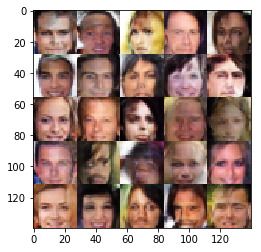

Epoch 5/10... Discriminator Loss: 0.221656... Generator Loss: 2.550517
Epoch 5/10... Discriminator Loss: 0.412616... Generator Loss: 2.011111
Epoch 5/10... Discriminator Loss: 1.365854... Generator Loss: 7.624668
Epoch 5/10... Discriminator Loss: 0.154837... Generator Loss: 4.076797
Epoch 5/10... Discriminator Loss: 2.564017... Generator Loss: 0.291269
Epoch 5/10... Discriminator Loss: 0.562412... Generator Loss: 1.699998
Epoch 5/10... Discriminator Loss: 0.196594... Generator Loss: 2.922767
Epoch 5/10... Discriminator Loss: 0.052698... Generator Loss: 6.872674
Epoch 5/10... Discriminator Loss: 0.235060... Generator Loss: 2.942260
Epoch 5/10... Discriminator Loss: 0.895271... Generator Loss: 1.142743


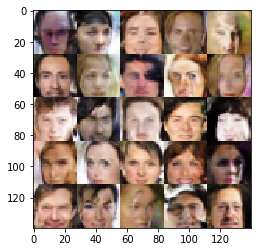

Epoch 5/10... Discriminator Loss: 1.681708... Generator Loss: 0.663242
Epoch 5/10... Discriminator Loss: 0.206247... Generator Loss: 2.515859
Epoch 5/10... Discriminator Loss: 0.074193... Generator Loss: 4.324867
Epoch 5/10... Discriminator Loss: 0.388228... Generator Loss: 1.989524
Epoch 5/10... Discriminator Loss: 0.146428... Generator Loss: 3.319395
Epoch 5/10... Discriminator Loss: 0.187462... Generator Loss: 2.803263
Epoch 5/10... Discriminator Loss: 0.096161... Generator Loss: 3.293359
Epoch 5/10... Discriminator Loss: 0.362812... Generator Loss: 1.828468
Epoch 5/10... Discriminator Loss: 0.167601... Generator Loss: 5.006819
Epoch 5/10... Discriminator Loss: 0.023757... Generator Loss: 5.270309


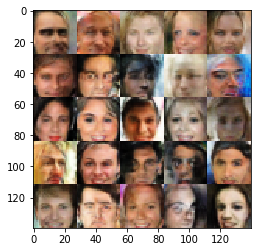

Epoch 5/10... Discriminator Loss: 1.577419... Generator Loss: 0.476797
Epoch 5/10... Discriminator Loss: 0.156135... Generator Loss: 2.802331
Epoch 5/10... Discriminator Loss: 0.330624... Generator Loss: 2.046705
Epoch 5/10... Discriminator Loss: 0.058746... Generator Loss: 5.112907
Epoch 5/10... Discriminator Loss: 0.115311... Generator Loss: 3.612111
Epoch 5/10... Discriminator Loss: 0.394668... Generator Loss: 2.012135
Epoch 5/10... Discriminator Loss: 0.015101... Generator Loss: 7.099932
Epoch 5/10... Discriminator Loss: 3.617871... Generator Loss: 0.253775
Epoch 5/10... Discriminator Loss: 1.735559... Generator Loss: 0.613877
Epoch 5/10... Discriminator Loss: 1.166059... Generator Loss: 1.209163


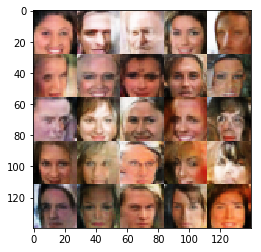

Epoch 5/10... Discriminator Loss: 2.349149... Generator Loss: 8.100389
Epoch 5/10... Discriminator Loss: 0.154050... Generator Loss: 3.178095
Epoch 5/10... Discriminator Loss: 0.319953... Generator Loss: 5.682350
Epoch 5/10... Discriminator Loss: 0.393109... Generator Loss: 1.768031
Epoch 5/10... Discriminator Loss: 0.031809... Generator Loss: 6.864456
Epoch 5/10... Discriminator Loss: 0.145678... Generator Loss: 5.771879
Epoch 5/10... Discriminator Loss: 0.131915... Generator Loss: 3.076796
Epoch 5/10... Discriminator Loss: 0.133933... Generator Loss: 2.955624
Epoch 5/10... Discriminator Loss: 0.346616... Generator Loss: 2.201856
Epoch 5/10... Discriminator Loss: 0.043274... Generator Loss: 4.153647


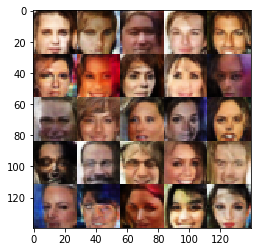

Epoch 5/10... Discriminator Loss: 0.673276... Generator Loss: 1.310544
Epoch 5/10... Discriminator Loss: 0.850074... Generator Loss: 8.520613
Epoch 5/10... Discriminator Loss: 0.207368... Generator Loss: 3.372969
Epoch 5/10... Discriminator Loss: 0.028339... Generator Loss: 6.164203
Epoch 5/10... Discriminator Loss: 0.103595... Generator Loss: 5.263205
Epoch 5/10... Discriminator Loss: 0.442481... Generator Loss: 2.020982
Epoch 5/10... Discriminator Loss: 0.137962... Generator Loss: 3.124497
Epoch 5/10... Discriminator Loss: 0.113458... Generator Loss: 3.721163
Epoch 5/10... Discriminator Loss: 0.124882... Generator Loss: 3.113852
Epoch 5/10... Discriminator Loss: 0.050124... Generator Loss: 4.786368


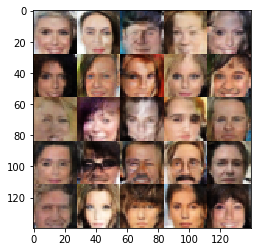

Epoch 5/10... Discriminator Loss: 0.113643... Generator Loss: 3.295170
Epoch 5/10... Discriminator Loss: 0.143810... Generator Loss: 2.862439
Epoch 5/10... Discriminator Loss: 0.056649... Generator Loss: 4.854855
Epoch 5/10... Discriminator Loss: 0.307289... Generator Loss: 1.975428
Epoch 5/10... Discriminator Loss: 0.128781... Generator Loss: 2.928177
Epoch 5/10... Discriminator Loss: 0.055755... Generator Loss: 4.623786
Epoch 5/10... Discriminator Loss: 0.047416... Generator Loss: 4.215714
Epoch 5/10... Discriminator Loss: 0.511244... Generator Loss: 1.408926
Epoch 5/10... Discriminator Loss: 0.221601... Generator Loss: 2.365149
Epoch 5/10... Discriminator Loss: 0.222014... Generator Loss: 2.690718


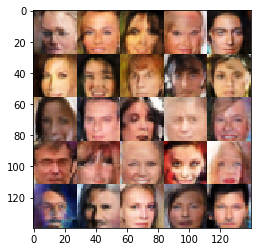

Epoch 5/10... Discriminator Loss: 2.082621... Generator Loss: 0.765038
Epoch 5/10... Discriminator Loss: 0.668207... Generator Loss: 1.653701
Epoch 5/10... Discriminator Loss: 0.195123... Generator Loss: 3.049641
Epoch 5/10... Discriminator Loss: 0.672200... Generator Loss: 1.475868
Epoch 5/10... Discriminator Loss: 0.029836... Generator Loss: 5.747997
Epoch 5/10... Discriminator Loss: 0.474803... Generator Loss: 2.279607
Epoch 5/10... Discriminator Loss: 0.120844... Generator Loss: 4.673000
Epoch 5/10... Discriminator Loss: 0.018763... Generator Loss: 6.405441
Epoch 5/10... Discriminator Loss: 0.189384... Generator Loss: 3.009086
Epoch 5/10... Discriminator Loss: 0.113719... Generator Loss: 3.769480


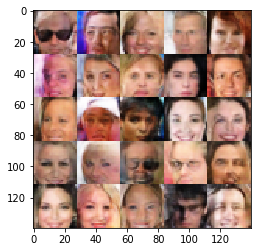

Epoch 5/10... Discriminator Loss: 2.386726... Generator Loss: 0.537976
Epoch 5/10... Discriminator Loss: 0.149288... Generator Loss: 5.014864
Epoch 5/10... Discriminator Loss: 0.387376... Generator Loss: 1.906528
Epoch 5/10... Discriminator Loss: 0.068083... Generator Loss: 3.920881
Epoch 5/10... Discriminator Loss: 0.172382... Generator Loss: 5.340771
Epoch 5/10... Discriminator Loss: 0.274547... Generator Loss: 2.330103
Epoch 5/10... Discriminator Loss: 0.006916... Generator Loss: 6.523344
Epoch 5/10... Discriminator Loss: 0.156390... Generator Loss: 3.012223
Epoch 5/10... Discriminator Loss: 0.083159... Generator Loss: 4.158801
Epoch 5/10... Discriminator Loss: 0.059995... Generator Loss: 4.878633


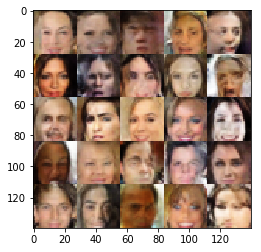

Epoch 5/10... Discriminator Loss: 0.047755... Generator Loss: 4.761239
Epoch 5/10... Discriminator Loss: 0.311254... Generator Loss: 2.341539
Epoch 5/10... Discriminator Loss: 0.214041... Generator Loss: 3.656995
Epoch 5/10... Discriminator Loss: 0.018151... Generator Loss: 7.040986
Epoch 5/10... Discriminator Loss: 0.570676... Generator Loss: 1.792823
Epoch 5/10... Discriminator Loss: 0.526207... Generator Loss: 1.600663
Epoch 5/10... Discriminator Loss: 0.057679... Generator Loss: 4.528650
Epoch 5/10... Discriminator Loss: 0.124053... Generator Loss: 3.507656
Epoch 5/10... Discriminator Loss: 0.810491... Generator Loss: 1.302565
Epoch 5/10... Discriminator Loss: 0.905612... Generator Loss: 1.363219


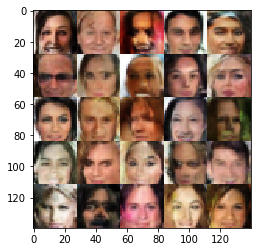

Epoch 5/10... Discriminator Loss: 0.291440... Generator Loss: 2.128972
Epoch 5/10... Discriminator Loss: 0.026505... Generator Loss: 7.385669
Epoch 5/10... Discriminator Loss: 0.089834... Generator Loss: 3.851232
Epoch 5/10... Discriminator Loss: 0.036827... Generator Loss: 4.862304
Epoch 5/10... Discriminator Loss: 0.969767... Generator Loss: 0.816273
Epoch 6/10... Discriminator Loss: 0.044085... Generator Loss: 4.905873
Epoch 6/10... Discriminator Loss: 0.111523... Generator Loss: 3.883508
Epoch 6/10... Discriminator Loss: 0.021721... Generator Loss: 8.139908
Epoch 6/10... Discriminator Loss: 0.454047... Generator Loss: 1.657425
Epoch 6/10... Discriminator Loss: 0.051571... Generator Loss: 4.544139


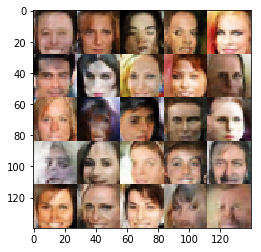

Epoch 6/10... Discriminator Loss: 0.372522... Generator Loss: 2.486213
Epoch 6/10... Discriminator Loss: 0.073521... Generator Loss: 8.067267
Epoch 6/10... Discriminator Loss: 0.079889... Generator Loss: 3.944706
Epoch 6/10... Discriminator Loss: 0.076804... Generator Loss: 7.548650
Epoch 6/10... Discriminator Loss: 1.019107... Generator Loss: 1.131317
Epoch 6/10... Discriminator Loss: 0.663521... Generator Loss: 1.680132
Epoch 6/10... Discriminator Loss: 1.854801... Generator Loss: 5.613239
Epoch 6/10... Discriminator Loss: 0.616683... Generator Loss: 2.379288
Epoch 6/10... Discriminator Loss: 0.214375... Generator Loss: 3.966073
Epoch 6/10... Discriminator Loss: 0.420693... Generator Loss: 2.400376


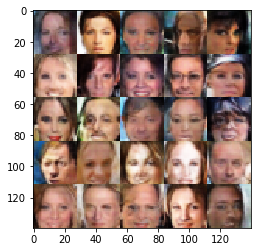

Epoch 6/10... Discriminator Loss: 0.031382... Generator Loss: 6.014412
Epoch 6/10... Discriminator Loss: 0.450604... Generator Loss: 5.943091
Epoch 6/10... Discriminator Loss: 1.062773... Generator Loss: 4.976965
Epoch 6/10... Discriminator Loss: 0.656771... Generator Loss: 1.740484
Epoch 6/10... Discriminator Loss: 0.356450... Generator Loss: 1.979295
Epoch 6/10... Discriminator Loss: 0.458811... Generator Loss: 2.009727
Epoch 6/10... Discriminator Loss: 0.744602... Generator Loss: 1.232598
Epoch 6/10... Discriminator Loss: 0.543234... Generator Loss: 1.718937
Epoch 6/10... Discriminator Loss: 0.047235... Generator Loss: 6.524354
Epoch 6/10... Discriminator Loss: 0.043512... Generator Loss: 5.119956


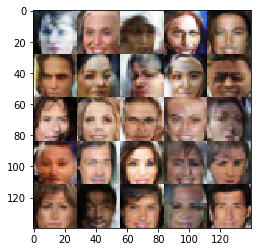

Epoch 6/10... Discriminator Loss: 0.140589... Generator Loss: 3.908125
Epoch 6/10... Discriminator Loss: 0.257441... Generator Loss: 2.504727
Epoch 6/10... Discriminator Loss: 1.818398... Generator Loss: 0.546843
Epoch 6/10... Discriminator Loss: 0.074541... Generator Loss: 4.115788
Epoch 6/10... Discriminator Loss: 0.164501... Generator Loss: 3.356571
Epoch 6/10... Discriminator Loss: 0.180101... Generator Loss: 4.903152
Epoch 6/10... Discriminator Loss: 0.507862... Generator Loss: 2.100537
Epoch 6/10... Discriminator Loss: 0.319498... Generator Loss: 2.103856
Epoch 6/10... Discriminator Loss: 0.633978... Generator Loss: 1.802238
Epoch 6/10... Discriminator Loss: 0.146398... Generator Loss: 3.187132


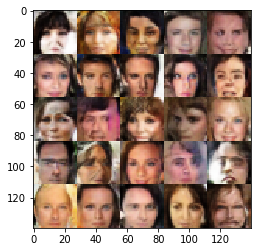

Epoch 6/10... Discriminator Loss: 0.059797... Generator Loss: 4.345496
Epoch 6/10... Discriminator Loss: 0.033983... Generator Loss: 5.944226
Epoch 6/10... Discriminator Loss: 0.500221... Generator Loss: 10.448399
Epoch 6/10... Discriminator Loss: 0.253438... Generator Loss: 2.337075
Epoch 6/10... Discriminator Loss: 0.181966... Generator Loss: 2.883374
Epoch 6/10... Discriminator Loss: 1.190392... Generator Loss: 0.620115
Epoch 6/10... Discriminator Loss: 0.011555... Generator Loss: 7.691712
Epoch 6/10... Discriminator Loss: 0.072007... Generator Loss: 4.046762
Epoch 6/10... Discriminator Loss: 0.100070... Generator Loss: 4.054708
Epoch 6/10... Discriminator Loss: 0.046065... Generator Loss: 5.969725


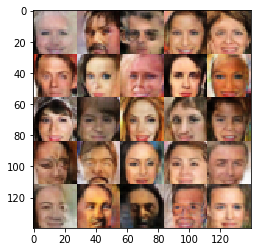

Epoch 6/10... Discriminator Loss: 0.157524... Generator Loss: 3.058483
Epoch 6/10... Discriminator Loss: 0.971540... Generator Loss: 6.774839
Epoch 6/10... Discriminator Loss: 0.318157... Generator Loss: 4.913133
Epoch 6/10... Discriminator Loss: 0.728023... Generator Loss: 1.404108
Epoch 6/10... Discriminator Loss: 0.556385... Generator Loss: 1.661996
Epoch 6/10... Discriminator Loss: 0.594668... Generator Loss: 5.631824
Epoch 6/10... Discriminator Loss: 0.156208... Generator Loss: 7.351640
Epoch 6/10... Discriminator Loss: 0.395952... Generator Loss: 1.767594
Epoch 6/10... Discriminator Loss: 0.110892... Generator Loss: 3.462396
Epoch 6/10... Discriminator Loss: 0.141922... Generator Loss: 3.088224


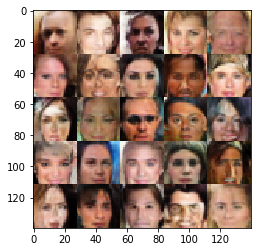

Epoch 6/10... Discriminator Loss: 0.418655... Generator Loss: 1.763764
Epoch 6/10... Discriminator Loss: 0.106551... Generator Loss: 5.857218
Epoch 6/10... Discriminator Loss: 0.151930... Generator Loss: 2.731046
Epoch 6/10... Discriminator Loss: 0.212436... Generator Loss: 2.749044
Epoch 6/10... Discriminator Loss: 0.141705... Generator Loss: 3.027496
Epoch 6/10... Discriminator Loss: 0.106056... Generator Loss: 3.604879
Epoch 6/10... Discriminator Loss: 0.075330... Generator Loss: 4.343433
Epoch 6/10... Discriminator Loss: 0.164770... Generator Loss: 2.917552
Epoch 6/10... Discriminator Loss: 0.098141... Generator Loss: 3.653167
Epoch 6/10... Discriminator Loss: 0.131146... Generator Loss: 3.441365


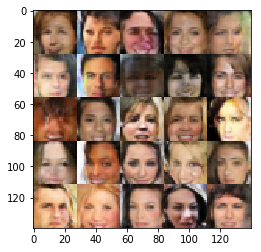

Epoch 6/10... Discriminator Loss: 0.132411... Generator Loss: 2.693913
Epoch 6/10... Discriminator Loss: 0.297104... Generator Loss: 2.196651
Epoch 6/10... Discriminator Loss: 0.096190... Generator Loss: 3.545076
Epoch 6/10... Discriminator Loss: 0.519583... Generator Loss: 1.989170
Epoch 6/10... Discriminator Loss: 0.293436... Generator Loss: 1.886436
Epoch 6/10... Discriminator Loss: 1.579826... Generator Loss: 0.559034
Epoch 6/10... Discriminator Loss: 0.062356... Generator Loss: 5.034754
Epoch 6/10... Discriminator Loss: 0.194941... Generator Loss: 2.648055
Epoch 6/10... Discriminator Loss: 0.051499... Generator Loss: 5.576991
Epoch 6/10... Discriminator Loss: 0.011221... Generator Loss: 8.048114


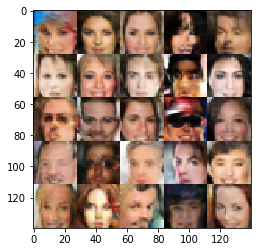

Epoch 6/10... Discriminator Loss: 0.257007... Generator Loss: 2.494614
Epoch 6/10... Discriminator Loss: 0.074099... Generator Loss: 4.699905
Epoch 6/10... Discriminator Loss: 0.050337... Generator Loss: 4.570242
Epoch 6/10... Discriminator Loss: 0.807211... Generator Loss: 1.016822
Epoch 6/10... Discriminator Loss: 0.036029... Generator Loss: 6.676074
Epoch 6/10... Discriminator Loss: 0.072845... Generator Loss: 4.016669
Epoch 6/10... Discriminator Loss: 0.014904... Generator Loss: 6.442214
Epoch 6/10... Discriminator Loss: 0.119300... Generator Loss: 2.866310
Epoch 6/10... Discriminator Loss: 0.119469... Generator Loss: 3.351537
Epoch 6/10... Discriminator Loss: 2.448105... Generator Loss: 6.114454


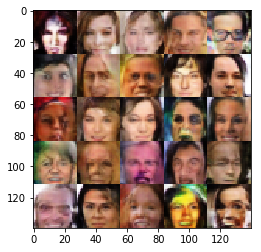

Epoch 6/10... Discriminator Loss: 1.931464... Generator Loss: 0.530961
Epoch 6/10... Discriminator Loss: 1.146009... Generator Loss: 3.341189
Epoch 6/10... Discriminator Loss: 0.593934... Generator Loss: 3.547416
Epoch 6/10... Discriminator Loss: 0.688206... Generator Loss: 1.297414
Epoch 6/10... Discriminator Loss: 1.250641... Generator Loss: 6.222981
Epoch 6/10... Discriminator Loss: 0.505055... Generator Loss: 4.264599
Epoch 6/10... Discriminator Loss: 0.285348... Generator Loss: 2.556436
Epoch 6/10... Discriminator Loss: 0.235329... Generator Loss: 3.648620
Epoch 6/10... Discriminator Loss: 1.291206... Generator Loss: 6.758944
Epoch 6/10... Discriminator Loss: 0.186257... Generator Loss: 2.776280


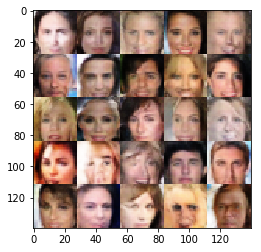

Epoch 6/10... Discriminator Loss: 0.226082... Generator Loss: 2.908430
Epoch 6/10... Discriminator Loss: 0.412997... Generator Loss: 3.826188
Epoch 6/10... Discriminator Loss: 0.258722... Generator Loss: 3.130764
Epoch 6/10... Discriminator Loss: 0.507483... Generator Loss: 2.290072
Epoch 6/10... Discriminator Loss: 0.776571... Generator Loss: 1.491313
Epoch 6/10... Discriminator Loss: 0.161821... Generator Loss: 5.307336
Epoch 6/10... Discriminator Loss: 0.338668... Generator Loss: 2.299316
Epoch 6/10... Discriminator Loss: 0.170434... Generator Loss: 2.794810
Epoch 6/10... Discriminator Loss: 0.401842... Generator Loss: 1.970303
Epoch 6/10... Discriminator Loss: 0.236561... Generator Loss: 2.333900


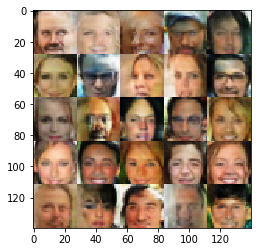

Epoch 6/10... Discriminator Loss: 0.043880... Generator Loss: 4.682131
Epoch 6/10... Discriminator Loss: 0.237157... Generator Loss: 2.433803
Epoch 6/10... Discriminator Loss: 0.750501... Generator Loss: 1.360969
Epoch 6/10... Discriminator Loss: 0.302749... Generator Loss: 2.378468
Epoch 6/10... Discriminator Loss: 1.993064... Generator Loss: 0.448731
Epoch 6/10... Discriminator Loss: 0.219532... Generator Loss: 2.344621
Epoch 6/10... Discriminator Loss: 0.079403... Generator Loss: 3.973061
Epoch 6/10... Discriminator Loss: 0.109065... Generator Loss: 3.194230
Epoch 6/10... Discriminator Loss: 0.184439... Generator Loss: 5.487751
Epoch 6/10... Discriminator Loss: 0.148420... Generator Loss: 3.437354


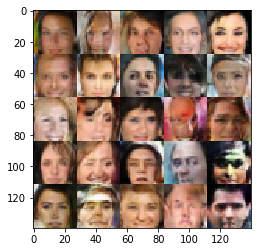

Epoch 6/10... Discriminator Loss: 0.012199... Generator Loss: 7.073449
Epoch 6/10... Discriminator Loss: 0.163639... Generator Loss: 2.946043
Epoch 6/10... Discriminator Loss: 0.272864... Generator Loss: 2.275203
Epoch 6/10... Discriminator Loss: 0.666085... Generator Loss: 1.171889
Epoch 6/10... Discriminator Loss: 0.051593... Generator Loss: 4.507313
Epoch 6/10... Discriminator Loss: 0.199859... Generator Loss: 3.027781
Epoch 6/10... Discriminator Loss: 0.053674... Generator Loss: 3.861106
Epoch 6/10... Discriminator Loss: 0.629059... Generator Loss: 1.313722
Epoch 6/10... Discriminator Loss: 0.048147... Generator Loss: 4.323915
Epoch 6/10... Discriminator Loss: 0.224441... Generator Loss: 2.669165


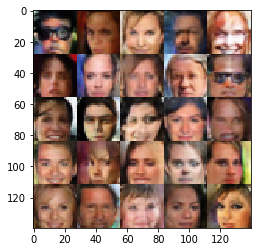

Epoch 6/10... Discriminator Loss: 0.029145... Generator Loss: 4.987004
Epoch 6/10... Discriminator Loss: 0.049472... Generator Loss: 5.414024
Epoch 6/10... Discriminator Loss: 0.110935... Generator Loss: 3.312981
Epoch 6/10... Discriminator Loss: 0.620483... Generator Loss: 1.346228
Epoch 6/10... Discriminator Loss: 0.348798... Generator Loss: 3.479176
Epoch 6/10... Discriminator Loss: 0.127549... Generator Loss: 3.316492
Epoch 6/10... Discriminator Loss: 0.190026... Generator Loss: 2.873233
Epoch 6/10... Discriminator Loss: 0.368594... Generator Loss: 2.092524
Epoch 6/10... Discriminator Loss: 0.067123... Generator Loss: 5.300852
Epoch 6/10... Discriminator Loss: 0.118773... Generator Loss: 3.150884


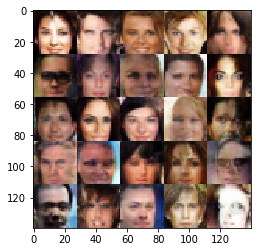

Epoch 6/10... Discriminator Loss: 0.132627... Generator Loss: 3.426586
Epoch 6/10... Discriminator Loss: 0.110367... Generator Loss: 3.596821
Epoch 6/10... Discriminator Loss: 0.188930... Generator Loss: 2.915070
Epoch 6/10... Discriminator Loss: 0.325412... Generator Loss: 1.866120
Epoch 6/10... Discriminator Loss: 0.227800... Generator Loss: 2.491124
Epoch 6/10... Discriminator Loss: 3.531311... Generator Loss: 0.247948
Epoch 6/10... Discriminator Loss: 1.071988... Generator Loss: 5.127735
Epoch 6/10... Discriminator Loss: 0.080943... Generator Loss: 4.767082
Epoch 6/10... Discriminator Loss: 1.853356... Generator Loss: 0.595011
Epoch 6/10... Discriminator Loss: 0.081031... Generator Loss: 3.590684


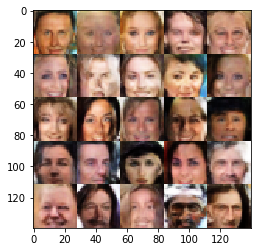

Epoch 6/10... Discriminator Loss: 0.124881... Generator Loss: 4.600212
Epoch 6/10... Discriminator Loss: 0.247432... Generator Loss: 2.364311
Epoch 6/10... Discriminator Loss: 0.181995... Generator Loss: 2.874520
Epoch 6/10... Discriminator Loss: 0.147235... Generator Loss: 3.148263
Epoch 6/10... Discriminator Loss: 0.052586... Generator Loss: 5.618702
Epoch 6/10... Discriminator Loss: 0.581401... Generator Loss: 1.749345
Epoch 6/10... Discriminator Loss: 0.161197... Generator Loss: 2.920793
Epoch 6/10... Discriminator Loss: 0.141899... Generator Loss: 3.343652
Epoch 6/10... Discriminator Loss: 0.079463... Generator Loss: 4.158687
Epoch 6/10... Discriminator Loss: 0.080648... Generator Loss: 3.229816


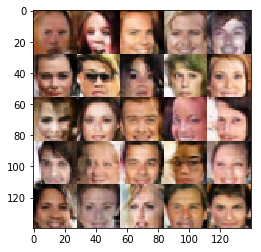

Epoch 6/10... Discriminator Loss: 0.091724... Generator Loss: 3.552591
Epoch 6/10... Discriminator Loss: 0.364310... Generator Loss: 7.697049
Epoch 6/10... Discriminator Loss: 0.048034... Generator Loss: 4.974089
Epoch 6/10... Discriminator Loss: 0.440204... Generator Loss: 2.000088
Epoch 6/10... Discriminator Loss: 0.627060... Generator Loss: 8.108532
Epoch 6/10... Discriminator Loss: 0.095845... Generator Loss: 3.781992
Epoch 6/10... Discriminator Loss: 0.124808... Generator Loss: 4.984728
Epoch 6/10... Discriminator Loss: 0.336479... Generator Loss: 2.587437
Epoch 6/10... Discriminator Loss: 0.301514... Generator Loss: 2.868871
Epoch 6/10... Discriminator Loss: 0.171627... Generator Loss: 2.498322


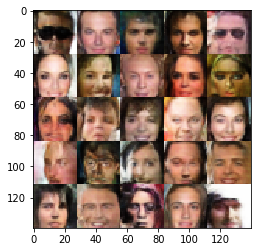

Epoch 6/10... Discriminator Loss: 0.131583... Generator Loss: 3.843685
Epoch 6/10... Discriminator Loss: 0.286825... Generator Loss: 2.516417
Epoch 6/10... Discriminator Loss: 0.033061... Generator Loss: 6.564030
Epoch 6/10... Discriminator Loss: 0.041857... Generator Loss: 6.555037
Epoch 6/10... Discriminator Loss: 0.120730... Generator Loss: 3.222115
Epoch 6/10... Discriminator Loss: 0.131267... Generator Loss: 3.036954
Epoch 6/10... Discriminator Loss: 0.059412... Generator Loss: 6.415360
Epoch 6/10... Discriminator Loss: 0.023440... Generator Loss: 6.530058
Epoch 6/10... Discriminator Loss: 0.103414... Generator Loss: 3.906937
Epoch 6/10... Discriminator Loss: 0.196932... Generator Loss: 2.595324


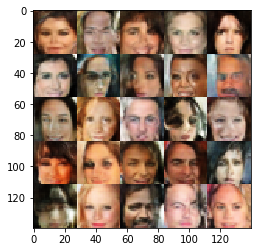

Epoch 6/10... Discriminator Loss: 0.058545... Generator Loss: 4.237876
Epoch 6/10... Discriminator Loss: 0.032371... Generator Loss: 4.547100
Epoch 6/10... Discriminator Loss: 0.140215... Generator Loss: 3.094138
Epoch 6/10... Discriminator Loss: 0.092573... Generator Loss: 3.972207
Epoch 6/10... Discriminator Loss: 0.028397... Generator Loss: 5.759339
Epoch 6/10... Discriminator Loss: 0.069155... Generator Loss: 3.693944
Epoch 6/10... Discriminator Loss: 0.911740... Generator Loss: 1.139759
Epoch 6/10... Discriminator Loss: 0.107795... Generator Loss: 3.867977
Epoch 6/10... Discriminator Loss: 0.127322... Generator Loss: 3.063721
Epoch 6/10... Discriminator Loss: 2.293533... Generator Loss: 0.370924


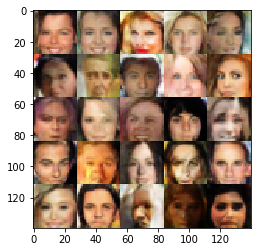

Epoch 6/10... Discriminator Loss: 2.836804... Generator Loss: 0.281935
Epoch 6/10... Discriminator Loss: 1.606014... Generator Loss: 0.615544
Epoch 6/10... Discriminator Loss: 0.012456... Generator Loss: 9.407867
Epoch 6/10... Discriminator Loss: 0.165109... Generator Loss: 2.972060
Epoch 6/10... Discriminator Loss: 0.324646... Generator Loss: 2.031956
Epoch 6/10... Discriminator Loss: 0.269632... Generator Loss: 2.188570
Epoch 6/10... Discriminator Loss: 0.225031... Generator Loss: 5.649102
Epoch 6/10... Discriminator Loss: 0.682579... Generator Loss: 1.676310
Epoch 6/10... Discriminator Loss: 0.144688... Generator Loss: 3.362665
Epoch 6/10... Discriminator Loss: 0.037817... Generator Loss: 5.748783


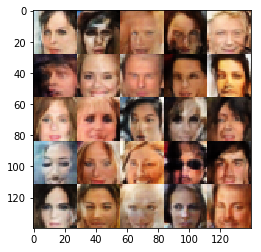

Epoch 6/10... Discriminator Loss: 0.047980... Generator Loss: 4.840949
Epoch 6/10... Discriminator Loss: 0.255916... Generator Loss: 3.517109
Epoch 6/10... Discriminator Loss: 0.128932... Generator Loss: 3.270197
Epoch 6/10... Discriminator Loss: 0.478943... Generator Loss: 2.146358
Epoch 6/10... Discriminator Loss: 0.396693... Generator Loss: 5.228805
Epoch 6/10... Discriminator Loss: 0.091914... Generator Loss: 6.559925
Epoch 6/10... Discriminator Loss: 0.044416... Generator Loss: 4.661205
Epoch 6/10... Discriminator Loss: 0.131012... Generator Loss: 3.354203
Epoch 6/10... Discriminator Loss: 0.037912... Generator Loss: 5.051375
Epoch 6/10... Discriminator Loss: 1.061132... Generator Loss: 1.170234


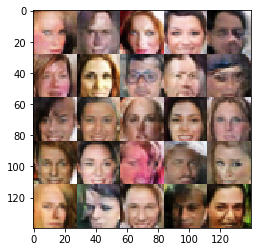

Epoch 6/10... Discriminator Loss: 0.027300... Generator Loss: 6.735241
Epoch 6/10... Discriminator Loss: 0.272976... Generator Loss: 2.328007
Epoch 6/10... Discriminator Loss: 0.025470... Generator Loss: 5.452028
Epoch 6/10... Discriminator Loss: 0.408245... Generator Loss: 2.007878
Epoch 6/10... Discriminator Loss: 0.023104... Generator Loss: 4.996268
Epoch 6/10... Discriminator Loss: 0.036149... Generator Loss: 9.439038
Epoch 6/10... Discriminator Loss: 0.149100... Generator Loss: 3.448907
Epoch 6/10... Discriminator Loss: 0.127066... Generator Loss: 3.171968
Epoch 6/10... Discriminator Loss: 0.048571... Generator Loss: 4.510689
Epoch 6/10... Discriminator Loss: 0.515127... Generator Loss: 1.471406


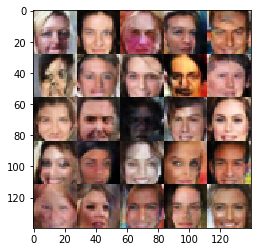

Epoch 6/10... Discriminator Loss: 0.708716... Generator Loss: 1.638787
Epoch 6/10... Discriminator Loss: 0.048148... Generator Loss: 5.866661
Epoch 6/10... Discriminator Loss: 0.014588... Generator Loss: 6.472322
Epoch 6/10... Discriminator Loss: 0.094064... Generator Loss: 4.304994
Epoch 6/10... Discriminator Loss: 0.554901... Generator Loss: 1.757471
Epoch 6/10... Discriminator Loss: 0.600587... Generator Loss: 1.146326
Epoch 6/10... Discriminator Loss: 0.060041... Generator Loss: 5.296435
Epoch 6/10... Discriminator Loss: 0.161895... Generator Loss: 2.806575
Epoch 6/10... Discriminator Loss: 0.029777... Generator Loss: 5.986637
Epoch 6/10... Discriminator Loss: 0.281619... Generator Loss: 2.429540


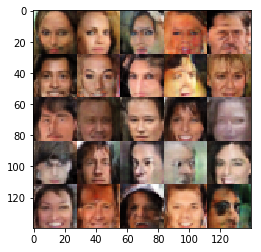

Epoch 6/10... Discriminator Loss: 2.576730... Generator Loss: 0.295981
Epoch 6/10... Discriminator Loss: 1.831425... Generator Loss: 0.536260
Epoch 6/10... Discriminator Loss: 2.090270... Generator Loss: 0.712782
Epoch 6/10... Discriminator Loss: 0.671595... Generator Loss: 1.459554
Epoch 6/10... Discriminator Loss: 0.237829... Generator Loss: 3.270786
Epoch 6/10... Discriminator Loss: 0.204999... Generator Loss: 3.958778
Epoch 6/10... Discriminator Loss: 0.146843... Generator Loss: 3.497290
Epoch 6/10... Discriminator Loss: 0.215030... Generator Loss: 3.292005
Epoch 6/10... Discriminator Loss: 0.470137... Generator Loss: 2.075993
Epoch 6/10... Discriminator Loss: 0.183339... Generator Loss: 3.284488


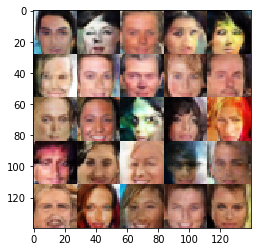

Epoch 6/10... Discriminator Loss: 0.808174... Generator Loss: 1.377812
Epoch 6/10... Discriminator Loss: 0.417655... Generator Loss: 1.698655
Epoch 6/10... Discriminator Loss: 0.059198... Generator Loss: 4.245117
Epoch 6/10... Discriminator Loss: 0.052730... Generator Loss: 5.372486
Epoch 6/10... Discriminator Loss: 0.083510... Generator Loss: 4.002644
Epoch 6/10... Discriminator Loss: 0.031542... Generator Loss: 5.978823
Epoch 6/10... Discriminator Loss: 0.026884... Generator Loss: 6.361537
Epoch 6/10... Discriminator Loss: 0.069611... Generator Loss: 4.446607
Epoch 6/10... Discriminator Loss: 0.036750... Generator Loss: 5.996382
Epoch 6/10... Discriminator Loss: 0.068117... Generator Loss: 10.160947


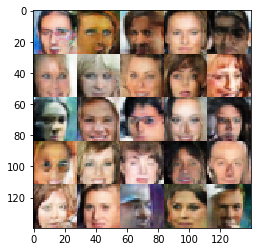

Epoch 6/10... Discriminator Loss: 0.193625... Generator Loss: 2.838008
Epoch 6/10... Discriminator Loss: 0.159835... Generator Loss: 3.262683
Epoch 6/10... Discriminator Loss: 0.091095... Generator Loss: 4.273130
Epoch 6/10... Discriminator Loss: 0.188396... Generator Loss: 3.205380
Epoch 6/10... Discriminator Loss: 0.067775... Generator Loss: 4.334156
Epoch 6/10... Discriminator Loss: 0.971169... Generator Loss: 1.440081
Epoch 6/10... Discriminator Loss: 0.183940... Generator Loss: 9.856789
Epoch 6/10... Discriminator Loss: 0.081922... Generator Loss: 4.384378
Epoch 6/10... Discriminator Loss: 0.082502... Generator Loss: 4.281704
Epoch 6/10... Discriminator Loss: 0.280681... Generator Loss: 2.409264


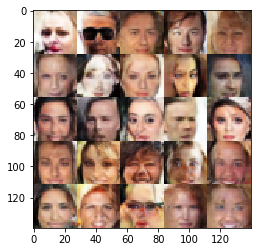

Epoch 6/10... Discriminator Loss: 0.065773... Generator Loss: 4.232820
Epoch 6/10... Discriminator Loss: 0.037101... Generator Loss: 5.531737
Epoch 6/10... Discriminator Loss: 0.056609... Generator Loss: 5.330638
Epoch 6/10... Discriminator Loss: 0.093718... Generator Loss: 3.887641
Epoch 6/10... Discriminator Loss: 0.003073... Generator Loss: 9.561378
Epoch 6/10... Discriminator Loss: 0.029280... Generator Loss: 5.910473
Epoch 6/10... Discriminator Loss: 0.144200... Generator Loss: 3.500567
Epoch 6/10... Discriminator Loss: 0.308141... Generator Loss: 2.204841
Epoch 6/10... Discriminator Loss: 0.386459... Generator Loss: 2.195466
Epoch 6/10... Discriminator Loss: 0.089731... Generator Loss: 4.236778


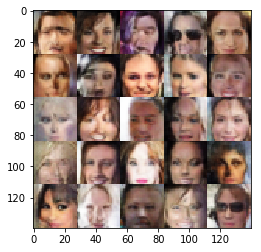

Epoch 6/10... Discriminator Loss: 0.176572... Generator Loss: 2.622350
Epoch 6/10... Discriminator Loss: 0.105179... Generator Loss: 4.343001
Epoch 6/10... Discriminator Loss: 0.052392... Generator Loss: 4.704505
Epoch 6/10... Discriminator Loss: 0.102118... Generator Loss: 3.663397
Epoch 6/10... Discriminator Loss: 0.169694... Generator Loss: 3.754416
Epoch 6/10... Discriminator Loss: 0.076735... Generator Loss: 3.224943
Epoch 6/10... Discriminator Loss: 3.942041... Generator Loss: 11.369275
Epoch 6/10... Discriminator Loss: 0.564188... Generator Loss: 4.892519
Epoch 6/10... Discriminator Loss: 0.302543... Generator Loss: 2.908858
Epoch 6/10... Discriminator Loss: 0.592161... Generator Loss: 1.890523


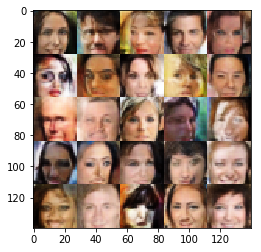

Epoch 6/10... Discriminator Loss: 0.256985... Generator Loss: 2.442031
Epoch 6/10... Discriminator Loss: 0.051731... Generator Loss: 5.546116
Epoch 6/10... Discriminator Loss: 0.194839... Generator Loss: 4.404430
Epoch 6/10... Discriminator Loss: 1.535627... Generator Loss: 0.693483
Epoch 6/10... Discriminator Loss: 0.318895... Generator Loss: 2.010035
Epoch 6/10... Discriminator Loss: 0.048776... Generator Loss: 4.681045
Epoch 6/10... Discriminator Loss: 1.342063... Generator Loss: 0.928431
Epoch 6/10... Discriminator Loss: 0.029176... Generator Loss: 5.574123
Epoch 6/10... Discriminator Loss: 0.447972... Generator Loss: 2.319381
Epoch 6/10... Discriminator Loss: 0.028648... Generator Loss: 7.693783


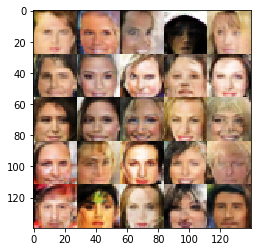

Epoch 6/10... Discriminator Loss: 0.190573... Generator Loss: 2.897616
Epoch 6/10... Discriminator Loss: 0.184490... Generator Loss: 3.058895
Epoch 6/10... Discriminator Loss: 0.121279... Generator Loss: 3.872752
Epoch 6/10... Discriminator Loss: 0.036519... Generator Loss: 5.407682
Epoch 6/10... Discriminator Loss: 0.081158... Generator Loss: 4.482330
Epoch 6/10... Discriminator Loss: 0.529153... Generator Loss: 2.164983
Epoch 6/10... Discriminator Loss: 0.011651... Generator Loss: 7.510349
Epoch 6/10... Discriminator Loss: 0.059488... Generator Loss: 5.370321
Epoch 6/10... Discriminator Loss: 0.043787... Generator Loss: 4.657007
Epoch 6/10... Discriminator Loss: 0.128884... Generator Loss: 3.404307


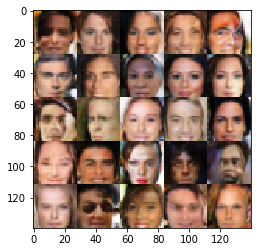

Epoch 6/10... Discriminator Loss: 0.225019... Generator Loss: 2.321867
Epoch 6/10... Discriminator Loss: 0.054377... Generator Loss: 6.745070
Epoch 6/10... Discriminator Loss: 0.153206... Generator Loss: 2.942453
Epoch 6/10... Discriminator Loss: 0.364643... Generator Loss: 1.731015
Epoch 6/10... Discriminator Loss: 0.056818... Generator Loss: 4.702697
Epoch 6/10... Discriminator Loss: 0.038588... Generator Loss: 4.951336
Epoch 6/10... Discriminator Loss: 0.182723... Generator Loss: 2.689126
Epoch 6/10... Discriminator Loss: 0.140413... Generator Loss: 3.684916
Epoch 6/10... Discriminator Loss: 0.762815... Generator Loss: 1.238902
Epoch 6/10... Discriminator Loss: 0.259636... Generator Loss: 2.801061


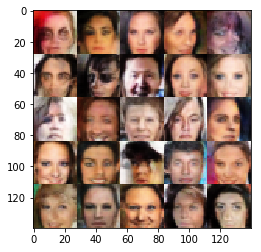

Epoch 6/10... Discriminator Loss: 0.433956... Generator Loss: 2.156661
Epoch 6/10... Discriminator Loss: 0.041009... Generator Loss: 4.795929
Epoch 6/10... Discriminator Loss: 0.117810... Generator Loss: 3.837809
Epoch 6/10... Discriminator Loss: 0.013461... Generator Loss: 6.694160
Epoch 6/10... Discriminator Loss: 0.150763... Generator Loss: 3.108836
Epoch 6/10... Discriminator Loss: 0.012034... Generator Loss: 6.847209
Epoch 6/10... Discriminator Loss: 1.778522... Generator Loss: 0.513505
Epoch 6/10... Discriminator Loss: 0.180949... Generator Loss: 5.279359
Epoch 6/10... Discriminator Loss: 0.416206... Generator Loss: 1.978264
Epoch 6/10... Discriminator Loss: 0.059941... Generator Loss: 4.998083


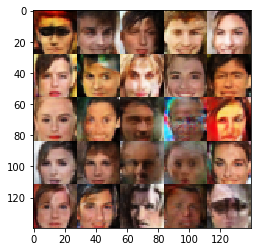

Epoch 6/10... Discriminator Loss: 0.120700... Generator Loss: 3.436815
Epoch 6/10... Discriminator Loss: 0.071319... Generator Loss: 3.845286
Epoch 6/10... Discriminator Loss: 0.204278... Generator Loss: 2.562752
Epoch 6/10... Discriminator Loss: 0.269332... Generator Loss: 2.696812
Epoch 6/10... Discriminator Loss: 0.028683... Generator Loss: 6.351344
Epoch 6/10... Discriminator Loss: 0.091596... Generator Loss: 7.193042
Epoch 6/10... Discriminator Loss: 0.176225... Generator Loss: 2.687102
Epoch 6/10... Discriminator Loss: 0.380575... Generator Loss: 1.878634
Epoch 6/10... Discriminator Loss: 0.674895... Generator Loss: 1.290034
Epoch 6/10... Discriminator Loss: 0.150549... Generator Loss: 10.887528


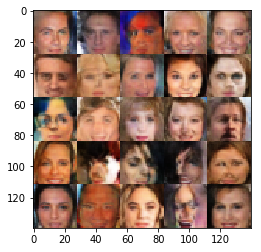

Epoch 6/10... Discriminator Loss: 0.070962... Generator Loss: 3.827135
Epoch 6/10... Discriminator Loss: 0.078927... Generator Loss: 5.608971
Epoch 6/10... Discriminator Loss: 0.057087... Generator Loss: 4.290694
Epoch 6/10... Discriminator Loss: 0.091014... Generator Loss: 3.063547
Epoch 6/10... Discriminator Loss: 0.173388... Generator Loss: 2.774857
Epoch 6/10... Discriminator Loss: 0.055138... Generator Loss: 6.158824
Epoch 6/10... Discriminator Loss: 0.610997... Generator Loss: 9.165939
Epoch 6/10... Discriminator Loss: 0.018026... Generator Loss: 6.285738
Epoch 6/10... Discriminator Loss: 0.042481... Generator Loss: 6.065364
Epoch 6/10... Discriminator Loss: 0.028450... Generator Loss: 5.458368


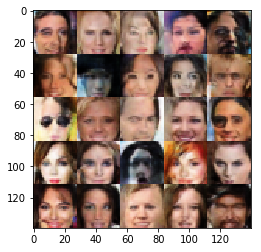

Epoch 6/10... Discriminator Loss: 0.149183... Generator Loss: 2.898557
Epoch 6/10... Discriminator Loss: 0.591397... Generator Loss: 1.628962
Epoch 6/10... Discriminator Loss: 0.527973... Generator Loss: 9.576734
Epoch 6/10... Discriminator Loss: 0.270507... Generator Loss: 2.576026
Epoch 6/10... Discriminator Loss: 0.135214... Generator Loss: 3.816016
Epoch 6/10... Discriminator Loss: 3.456059... Generator Loss: 8.585976
Epoch 6/10... Discriminator Loss: 0.247846... Generator Loss: 3.621908
Epoch 6/10... Discriminator Loss: 2.967651... Generator Loss: 0.211594
Epoch 6/10... Discriminator Loss: 1.085451... Generator Loss: 7.071813
Epoch 6/10... Discriminator Loss: 0.132835... Generator Loss: 5.233706


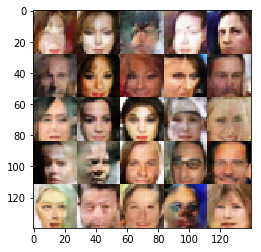

Epoch 6/10... Discriminator Loss: 1.492976... Generator Loss: 8.643148
Epoch 6/10... Discriminator Loss: 0.147152... Generator Loss: 3.154572
Epoch 6/10... Discriminator Loss: 0.290277... Generator Loss: 2.064180
Epoch 6/10... Discriminator Loss: 0.015572... Generator Loss: 7.107717
Epoch 6/10... Discriminator Loss: 0.059653... Generator Loss: 4.276378
Epoch 6/10... Discriminator Loss: 0.534122... Generator Loss: 1.426681
Epoch 6/10... Discriminator Loss: 1.204299... Generator Loss: 0.749820
Epoch 6/10... Discriminator Loss: 0.152103... Generator Loss: 3.061525
Epoch 6/10... Discriminator Loss: 0.029315... Generator Loss: 6.531067
Epoch 6/10... Discriminator Loss: 0.258851... Generator Loss: 2.228726


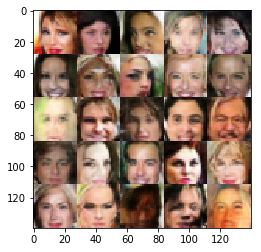

Epoch 6/10... Discriminator Loss: 0.147550... Generator Loss: 3.262518
Epoch 6/10... Discriminator Loss: 0.114252... Generator Loss: 3.596240
Epoch 6/10... Discriminator Loss: 0.626017... Generator Loss: 1.252062
Epoch 6/10... Discriminator Loss: 0.065230... Generator Loss: 3.639245
Epoch 6/10... Discriminator Loss: 0.512921... Generator Loss: 1.760272
Epoch 6/10... Discriminator Loss: 0.117279... Generator Loss: 3.326102
Epoch 6/10... Discriminator Loss: 0.214868... Generator Loss: 2.174711
Epoch 6/10... Discriminator Loss: 0.083102... Generator Loss: 4.143344
Epoch 6/10... Discriminator Loss: 0.334157... Generator Loss: 2.200951
Epoch 6/10... Discriminator Loss: 0.210377... Generator Loss: 2.840551


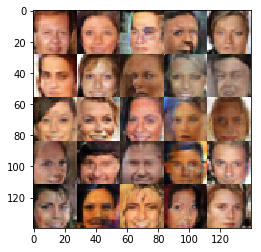

Epoch 6/10... Discriminator Loss: 0.121155... Generator Loss: 3.214814
Epoch 6/10... Discriminator Loss: 0.407092... Generator Loss: 1.711237
Epoch 6/10... Discriminator Loss: 0.171147... Generator Loss: 2.812128
Epoch 6/10... Discriminator Loss: 0.141958... Generator Loss: 2.811020
Epoch 6/10... Discriminator Loss: 0.107602... Generator Loss: 3.771889
Epoch 6/10... Discriminator Loss: 0.049632... Generator Loss: 5.645437
Epoch 6/10... Discriminator Loss: 0.218995... Generator Loss: 2.942469
Epoch 6/10... Discriminator Loss: 0.218910... Generator Loss: 2.691794
Epoch 6/10... Discriminator Loss: 0.093592... Generator Loss: 3.220370
Epoch 6/10... Discriminator Loss: 0.325956... Generator Loss: 2.109356


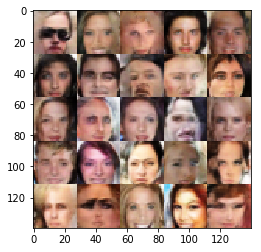

Epoch 6/10... Discriminator Loss: 0.080676... Generator Loss: 4.776294
Epoch 6/10... Discriminator Loss: 0.225692... Generator Loss: 2.162267
Epoch 6/10... Discriminator Loss: 0.117165... Generator Loss: 3.540719
Epoch 6/10... Discriminator Loss: 0.061812... Generator Loss: 4.680922
Epoch 6/10... Discriminator Loss: 0.306727... Generator Loss: 2.537532
Epoch 6/10... Discriminator Loss: 0.016326... Generator Loss: 6.890742
Epoch 6/10... Discriminator Loss: 0.039084... Generator Loss: 4.647017
Epoch 6/10... Discriminator Loss: 0.033465... Generator Loss: 4.906078
Epoch 6/10... Discriminator Loss: 0.094136... Generator Loss: 4.041893
Epoch 6/10... Discriminator Loss: 2.544186... Generator Loss: 7.712086


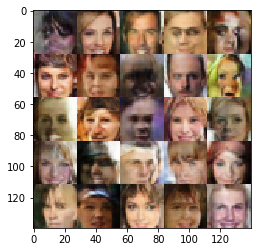

Epoch 6/10... Discriminator Loss: 1.564554... Generator Loss: 0.884203
Epoch 6/10... Discriminator Loss: 0.218917... Generator Loss: 2.639172
Epoch 6/10... Discriminator Loss: 0.189035... Generator Loss: 2.776978
Epoch 6/10... Discriminator Loss: 0.105808... Generator Loss: 3.861525
Epoch 6/10... Discriminator Loss: 0.399410... Generator Loss: 2.016146
Epoch 6/10... Discriminator Loss: 0.289148... Generator Loss: 2.474711
Epoch 6/10... Discriminator Loss: 0.849995... Generator Loss: 1.347314
Epoch 6/10... Discriminator Loss: 0.415310... Generator Loss: 2.785622
Epoch 6/10... Discriminator Loss: 0.037410... Generator Loss: 7.149152
Epoch 6/10... Discriminator Loss: 0.975227... Generator Loss: 0.938612


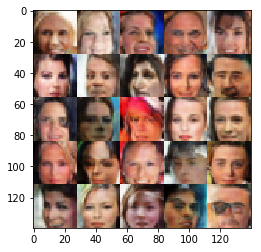

Epoch 6/10... Discriminator Loss: 0.135150... Generator Loss: 3.994603
Epoch 6/10... Discriminator Loss: 0.508523... Generator Loss: 1.592913
Epoch 6/10... Discriminator Loss: 0.186521... Generator Loss: 3.110728
Epoch 6/10... Discriminator Loss: 0.072309... Generator Loss: 3.937851
Epoch 6/10... Discriminator Loss: 0.103638... Generator Loss: 4.476245
Epoch 6/10... Discriminator Loss: 0.703121... Generator Loss: 1.192027
Epoch 6/10... Discriminator Loss: 0.114098... Generator Loss: 3.018436
Epoch 6/10... Discriminator Loss: 0.056642... Generator Loss: 3.829874
Epoch 6/10... Discriminator Loss: 0.147336... Generator Loss: 3.168511
Epoch 6/10... Discriminator Loss: 0.041222... Generator Loss: 5.079000


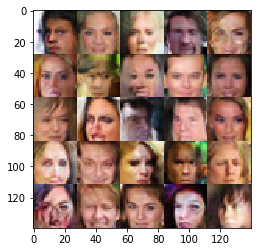

Epoch 7/10... Discriminator Loss: 0.044690... Generator Loss: 4.728796
Epoch 7/10... Discriminator Loss: 0.243956... Generator Loss: 2.299553
Epoch 7/10... Discriminator Loss: 0.027868... Generator Loss: 6.532005
Epoch 7/10... Discriminator Loss: 0.081796... Generator Loss: 3.592916
Epoch 7/10... Discriminator Loss: 0.017106... Generator Loss: 7.115183
Epoch 7/10... Discriminator Loss: 0.060409... Generator Loss: 3.912395
Epoch 7/10... Discriminator Loss: 0.159820... Generator Loss: 2.983905
Epoch 7/10... Discriminator Loss: 0.328696... Generator Loss: 2.388037
Epoch 7/10... Discriminator Loss: 0.198613... Generator Loss: 2.479434
Epoch 7/10... Discriminator Loss: 0.040343... Generator Loss: 4.463632


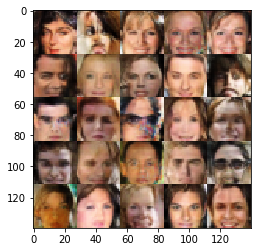

Epoch 7/10... Discriminator Loss: 0.048012... Generator Loss: 4.228005
Epoch 7/10... Discriminator Loss: 0.060253... Generator Loss: 4.211556
Epoch 7/10... Discriminator Loss: 0.057048... Generator Loss: 4.969639
Epoch 7/10... Discriminator Loss: 0.033998... Generator Loss: 6.252430
Epoch 7/10... Discriminator Loss: 0.008263... Generator Loss: 10.352619
Epoch 7/10... Discriminator Loss: 0.051205... Generator Loss: 3.745583
Epoch 7/10... Discriminator Loss: 0.081943... Generator Loss: 3.743711
Epoch 7/10... Discriminator Loss: 0.034477... Generator Loss: 4.885424
Epoch 7/10... Discriminator Loss: 1.345849... Generator Loss: 0.770138
Epoch 7/10... Discriminator Loss: 0.154805... Generator Loss: 3.213867


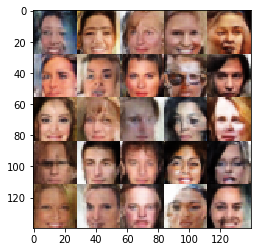

Epoch 7/10... Discriminator Loss: 0.020704... Generator Loss: 6.953005
Epoch 7/10... Discriminator Loss: 0.018311... Generator Loss: 7.455261
Epoch 7/10... Discriminator Loss: 0.017952... Generator Loss: 6.716370
Epoch 7/10... Discriminator Loss: 0.507782... Generator Loss: 1.561410
Epoch 7/10... Discriminator Loss: 0.010862... Generator Loss: 6.132074
Epoch 7/10... Discriminator Loss: 5.405849... Generator Loss: 0.033128
Epoch 7/10... Discriminator Loss: 1.230186... Generator Loss: 1.688304
Epoch 7/10... Discriminator Loss: 5.571876... Generator Loss: 0.087610
Epoch 7/10... Discriminator Loss: 0.719323... Generator Loss: 3.242081
Epoch 7/10... Discriminator Loss: 0.563037... Generator Loss: 1.773890


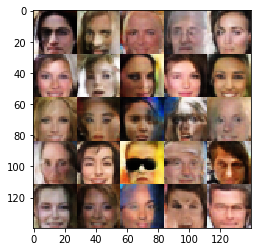

Epoch 7/10... Discriminator Loss: 0.462512... Generator Loss: 3.075436
Epoch 7/10... Discriminator Loss: 0.234700... Generator Loss: 3.331540
Epoch 7/10... Discriminator Loss: 0.780862... Generator Loss: 7.355171
Epoch 7/10... Discriminator Loss: 1.711776... Generator Loss: 1.053280
Epoch 7/10... Discriminator Loss: 1.906748... Generator Loss: 0.684212
Epoch 7/10... Discriminator Loss: 0.249351... Generator Loss: 3.632286
Epoch 7/10... Discriminator Loss: 0.249053... Generator Loss: 2.937777
Epoch 7/10... Discriminator Loss: 0.294104... Generator Loss: 2.112181
Epoch 7/10... Discriminator Loss: 0.418717... Generator Loss: 1.763870
Epoch 7/10... Discriminator Loss: 0.365705... Generator Loss: 1.787972


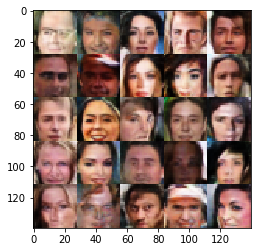

Epoch 7/10... Discriminator Loss: 0.289511... Generator Loss: 2.550422
Epoch 7/10... Discriminator Loss: 0.255492... Generator Loss: 2.667049
Epoch 7/10... Discriminator Loss: 0.201416... Generator Loss: 3.095881
Epoch 7/10... Discriminator Loss: 0.740258... Generator Loss: 1.427673
Epoch 7/10... Discriminator Loss: 0.279169... Generator Loss: 2.221268
Epoch 7/10... Discriminator Loss: 0.168257... Generator Loss: 2.944564
Epoch 7/10... Discriminator Loss: 1.290004... Generator Loss: 0.984403
Epoch 7/10... Discriminator Loss: 0.165221... Generator Loss: 2.808346
Epoch 7/10... Discriminator Loss: 0.142354... Generator Loss: 3.572825
Epoch 7/10... Discriminator Loss: 0.091435... Generator Loss: 3.764502


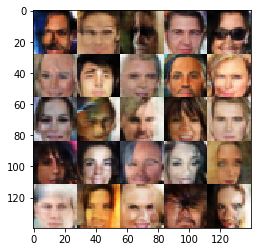

Epoch 7/10... Discriminator Loss: 0.031036... Generator Loss: 4.915833
Epoch 7/10... Discriminator Loss: 0.196706... Generator Loss: 3.510548
Epoch 7/10... Discriminator Loss: 0.126310... Generator Loss: 3.639549
Epoch 7/10... Discriminator Loss: 0.848417... Generator Loss: 1.437305
Epoch 7/10... Discriminator Loss: 0.024774... Generator Loss: 5.433672
Epoch 7/10... Discriminator Loss: 1.366833... Generator Loss: 0.864542
Epoch 7/10... Discriminator Loss: 0.546011... Generator Loss: 1.882719
Epoch 7/10... Discriminator Loss: 0.029876... Generator Loss: 6.532913
Epoch 7/10... Discriminator Loss: 0.105159... Generator Loss: 3.541819
Epoch 7/10... Discriminator Loss: 0.185733... Generator Loss: 2.965999


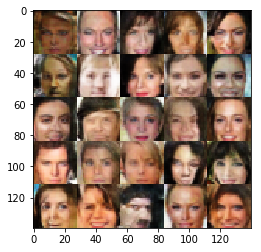

Epoch 7/10... Discriminator Loss: 0.460868... Generator Loss: 1.566742
Epoch 7/10... Discriminator Loss: 0.310132... Generator Loss: 2.008119
Epoch 7/10... Discriminator Loss: 0.258001... Generator Loss: 7.682326
Epoch 7/10... Discriminator Loss: 0.171904... Generator Loss: 3.874373
Epoch 7/10... Discriminator Loss: 0.271856... Generator Loss: 2.904274
Epoch 7/10... Discriminator Loss: 0.189883... Generator Loss: 3.171361
Epoch 7/10... Discriminator Loss: 0.147829... Generator Loss: 7.746223
Epoch 7/10... Discriminator Loss: 1.126661... Generator Loss: 1.277585
Epoch 7/10... Discriminator Loss: 0.097964... Generator Loss: 3.568283
Epoch 7/10... Discriminator Loss: 0.047744... Generator Loss: 5.208384


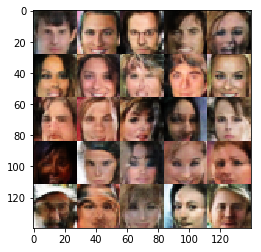

Epoch 7/10... Discriminator Loss: 0.084344... Generator Loss: 4.894550
Epoch 7/10... Discriminator Loss: 0.104691... Generator Loss: 3.814201
Epoch 7/10... Discriminator Loss: 0.969859... Generator Loss: 1.042473
Epoch 7/10... Discriminator Loss: 0.207851... Generator Loss: 2.451426
Epoch 7/10... Discriminator Loss: 0.202109... Generator Loss: 4.798081
Epoch 7/10... Discriminator Loss: 0.197365... Generator Loss: 2.674123
Epoch 7/10... Discriminator Loss: 0.097950... Generator Loss: 3.825481
Epoch 7/10... Discriminator Loss: 0.345695... Generator Loss: 7.405493
Epoch 7/10... Discriminator Loss: 0.103672... Generator Loss: 3.676023
Epoch 7/10... Discriminator Loss: 0.095481... Generator Loss: 3.734786


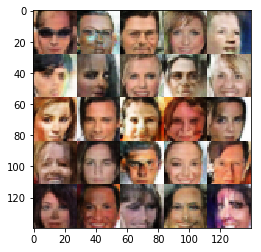

Epoch 7/10... Discriminator Loss: 1.052315... Generator Loss: 1.663547
Epoch 7/10... Discriminator Loss: 0.005665... Generator Loss: 8.155165
Epoch 7/10... Discriminator Loss: 0.391665... Generator Loss: 2.069452
Epoch 7/10... Discriminator Loss: 0.045934... Generator Loss: 5.192426
Epoch 7/10... Discriminator Loss: 0.338103... Generator Loss: 2.239015
Epoch 7/10... Discriminator Loss: 0.369209... Generator Loss: 2.416566
Epoch 7/10... Discriminator Loss: 0.165164... Generator Loss: 2.596370
Epoch 7/10... Discriminator Loss: 0.045135... Generator Loss: 8.977389
Epoch 7/10... Discriminator Loss: 0.031342... Generator Loss: 4.850121
Epoch 7/10... Discriminator Loss: 0.361221... Generator Loss: 1.958676


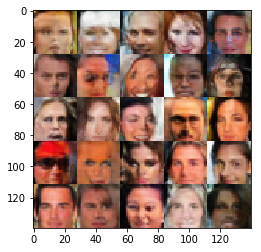

Epoch 7/10... Discriminator Loss: 0.252208... Generator Loss: 2.215349
Epoch 7/10... Discriminator Loss: 0.396821... Generator Loss: 1.771756
Epoch 7/10... Discriminator Loss: 0.056820... Generator Loss: 4.474759
Epoch 7/10... Discriminator Loss: 4.117858... Generator Loss: 0.154278
Epoch 7/10... Discriminator Loss: 0.134468... Generator Loss: 2.951298
Epoch 7/10... Discriminator Loss: 0.317449... Generator Loss: 2.136387
Epoch 7/10... Discriminator Loss: 0.238137... Generator Loss: 2.999330
Epoch 7/10... Discriminator Loss: 0.201826... Generator Loss: 2.850531
Epoch 7/10... Discriminator Loss: 0.029306... Generator Loss: 4.850917
Epoch 7/10... Discriminator Loss: 0.310020... Generator Loss: 1.982821


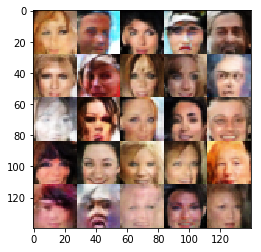

Epoch 7/10... Discriminator Loss: 0.468806... Generator Loss: 1.691582
Epoch 7/10... Discriminator Loss: 0.122279... Generator Loss: 3.323122
Epoch 7/10... Discriminator Loss: 0.222315... Generator Loss: 2.516497
Epoch 7/10... Discriminator Loss: 0.154355... Generator Loss: 3.476201
Epoch 7/10... Discriminator Loss: 0.029492... Generator Loss: 5.333413
Epoch 7/10... Discriminator Loss: 0.060330... Generator Loss: 5.020050
Epoch 7/10... Discriminator Loss: 0.568347... Generator Loss: 1.537627
Epoch 7/10... Discriminator Loss: 0.111698... Generator Loss: 3.529931
Epoch 7/10... Discriminator Loss: 0.076624... Generator Loss: 3.970914
Epoch 7/10... Discriminator Loss: 0.197982... Generator Loss: 2.960652


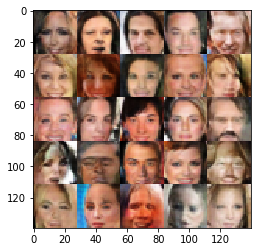

Epoch 7/10... Discriminator Loss: 0.252143... Generator Loss: 2.364516
Epoch 7/10... Discriminator Loss: 0.108620... Generator Loss: 3.413841
Epoch 7/10... Discriminator Loss: 0.055610... Generator Loss: 4.354469
Epoch 7/10... Discriminator Loss: 1.827069... Generator Loss: 0.465034
Epoch 7/10... Discriminator Loss: 0.038349... Generator Loss: 5.875845
Epoch 7/10... Discriminator Loss: 0.374752... Generator Loss: 1.839377
Epoch 7/10... Discriminator Loss: 0.020654... Generator Loss: 5.368170
Epoch 7/10... Discriminator Loss: 0.127184... Generator Loss: 3.115527
Epoch 7/10... Discriminator Loss: 0.147853... Generator Loss: 3.276392
Epoch 7/10... Discriminator Loss: 0.082324... Generator Loss: 3.763974


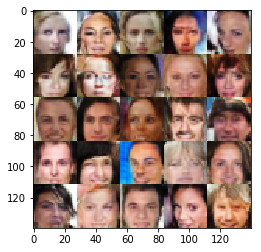

Epoch 7/10... Discriminator Loss: 0.267852... Generator Loss: 2.515924
Epoch 7/10... Discriminator Loss: 0.276743... Generator Loss: 2.044109
Epoch 7/10... Discriminator Loss: 0.044899... Generator Loss: 4.509758
Epoch 7/10... Discriminator Loss: 0.159142... Generator Loss: 2.793731
Epoch 7/10... Discriminator Loss: 0.022239... Generator Loss: 5.856353
Epoch 7/10... Discriminator Loss: 0.081450... Generator Loss: 3.723444
Epoch 7/10... Discriminator Loss: 0.055322... Generator Loss: 5.025972
Epoch 7/10... Discriminator Loss: 0.078840... Generator Loss: 3.823020
Epoch 7/10... Discriminator Loss: 0.605040... Generator Loss: 1.775980
Epoch 7/10... Discriminator Loss: 0.171112... Generator Loss: 5.249434


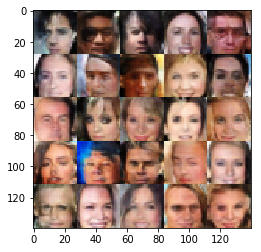

Epoch 7/10... Discriminator Loss: 0.358345... Generator Loss: 3.428327
Epoch 7/10... Discriminator Loss: 1.379266... Generator Loss: 8.398643
Epoch 7/10... Discriminator Loss: 0.833473... Generator Loss: 1.492625
Epoch 7/10... Discriminator Loss: 0.509260... Generator Loss: 2.036103
Epoch 7/10... Discriminator Loss: 0.316117... Generator Loss: 2.367507
Epoch 7/10... Discriminator Loss: 0.240876... Generator Loss: 3.423176
Epoch 7/10... Discriminator Loss: 0.327207... Generator Loss: 2.327648
Epoch 7/10... Discriminator Loss: 0.736319... Generator Loss: 1.364121
Epoch 7/10... Discriminator Loss: 0.040074... Generator Loss: 4.766980
Epoch 7/10... Discriminator Loss: 0.120545... Generator Loss: 3.112441


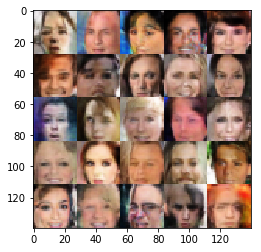

Epoch 7/10... Discriminator Loss: 0.251445... Generator Loss: 3.213827
Epoch 7/10... Discriminator Loss: 0.416754... Generator Loss: 2.119888
Epoch 7/10... Discriminator Loss: 0.158474... Generator Loss: 7.921774
Epoch 7/10... Discriminator Loss: 0.150741... Generator Loss: 3.103556
Epoch 7/10... Discriminator Loss: 0.076519... Generator Loss: 3.765898
Epoch 7/10... Discriminator Loss: 0.091511... Generator Loss: 3.875162
Epoch 7/10... Discriminator Loss: 0.201056... Generator Loss: 2.666289
Epoch 7/10... Discriminator Loss: 0.351896... Generator Loss: 2.065185
Epoch 7/10... Discriminator Loss: 0.143014... Generator Loss: 3.676242
Epoch 7/10... Discriminator Loss: 0.134404... Generator Loss: 3.172445


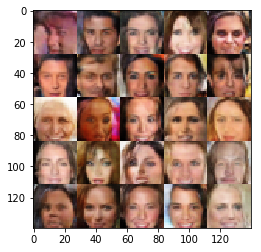

Epoch 7/10... Discriminator Loss: 0.354837... Generator Loss: 1.729390
Epoch 7/10... Discriminator Loss: 0.129642... Generator Loss: 3.237853
Epoch 7/10... Discriminator Loss: 0.094592... Generator Loss: 3.088721
Epoch 7/10... Discriminator Loss: 0.425582... Generator Loss: 1.752547
Epoch 7/10... Discriminator Loss: 0.820592... Generator Loss: 1.295800
Epoch 7/10... Discriminator Loss: 0.033679... Generator Loss: 4.882915
Epoch 7/10... Discriminator Loss: 0.439717... Generator Loss: 1.819806
Epoch 7/10... Discriminator Loss: 0.106269... Generator Loss: 4.043566
Epoch 7/10... Discriminator Loss: 0.177023... Generator Loss: 3.422822
Epoch 7/10... Discriminator Loss: 0.112561... Generator Loss: 4.698594


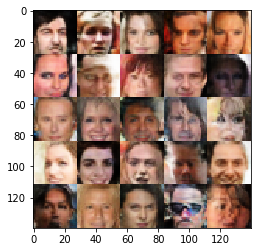

Epoch 7/10... Discriminator Loss: 0.097342... Generator Loss: 3.363221
Epoch 7/10... Discriminator Loss: 0.352662... Generator Loss: 2.169709
Epoch 7/10... Discriminator Loss: 1.404584... Generator Loss: 1.177007
Epoch 7/10... Discriminator Loss: 0.272958... Generator Loss: 4.199190
Epoch 7/10... Discriminator Loss: 2.560112... Generator Loss: 0.259695
Epoch 7/10... Discriminator Loss: 0.171474... Generator Loss: 3.269845
Epoch 7/10... Discriminator Loss: 0.685454... Generator Loss: 8.551725
Epoch 7/10... Discriminator Loss: 0.056174... Generator Loss: 4.178230
Epoch 7/10... Discriminator Loss: 0.777110... Generator Loss: 1.515810
Epoch 7/10... Discriminator Loss: 0.966955... Generator Loss: 1.126726


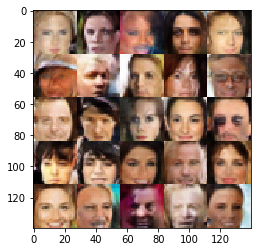

Epoch 7/10... Discriminator Loss: 0.127470... Generator Loss: 3.517817
Epoch 7/10... Discriminator Loss: 0.569409... Generator Loss: 1.731891
Epoch 7/10... Discriminator Loss: 0.060118... Generator Loss: 4.489419
Epoch 7/10... Discriminator Loss: 0.124817... Generator Loss: 4.908503
Epoch 7/10... Discriminator Loss: 0.083564... Generator Loss: 4.065663
Epoch 7/10... Discriminator Loss: 0.272007... Generator Loss: 3.633215
Epoch 7/10... Discriminator Loss: 0.174098... Generator Loss: 2.724133
Epoch 7/10... Discriminator Loss: 0.048279... Generator Loss: 4.833176
Epoch 7/10... Discriminator Loss: 0.029367... Generator Loss: 7.411085
Epoch 7/10... Discriminator Loss: 0.105342... Generator Loss: 3.371631


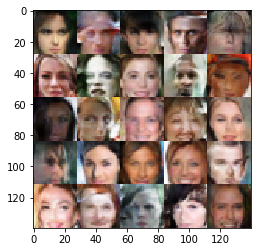

Epoch 7/10... Discriminator Loss: 0.012361... Generator Loss: 8.448496
Epoch 7/10... Discriminator Loss: 0.347914... Generator Loss: 3.053979
Epoch 7/10... Discriminator Loss: 4.483392... Generator Loss: 10.170244
Epoch 7/10... Discriminator Loss: 1.371198... Generator Loss: 1.176866
Epoch 7/10... Discriminator Loss: 1.298751... Generator Loss: 1.271507
Epoch 7/10... Discriminator Loss: 0.326925... Generator Loss: 2.367598
Epoch 7/10... Discriminator Loss: 0.351080... Generator Loss: 2.512804
Epoch 7/10... Discriminator Loss: 0.045929... Generator Loss: 5.337563
Epoch 7/10... Discriminator Loss: 0.217519... Generator Loss: 2.716204
Epoch 7/10... Discriminator Loss: 0.174186... Generator Loss: 3.485011


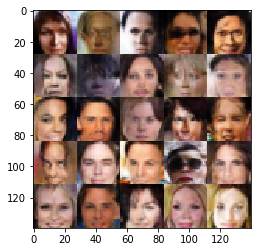

Epoch 7/10... Discriminator Loss: 0.748381... Generator Loss: 1.300629
Epoch 7/10... Discriminator Loss: 0.139208... Generator Loss: 3.103992
Epoch 7/10... Discriminator Loss: 0.124951... Generator Loss: 3.790179
Epoch 7/10... Discriminator Loss: 0.174229... Generator Loss: 3.026590
Epoch 7/10... Discriminator Loss: 0.085477... Generator Loss: 4.674289
Epoch 7/10... Discriminator Loss: 0.345049... Generator Loss: 2.152251
Epoch 7/10... Discriminator Loss: 0.028637... Generator Loss: 6.618019
Epoch 7/10... Discriminator Loss: 0.093715... Generator Loss: 3.499685
Epoch 7/10... Discriminator Loss: 0.212775... Generator Loss: 2.436189
Epoch 7/10... Discriminator Loss: 0.212111... Generator Loss: 2.528126


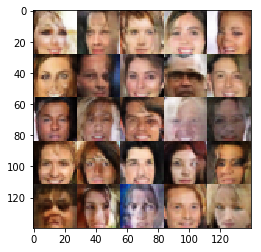

Epoch 7/10... Discriminator Loss: 0.147092... Generator Loss: 2.978747
Epoch 7/10... Discriminator Loss: 0.061199... Generator Loss: 4.155937
Epoch 7/10... Discriminator Loss: 0.127706... Generator Loss: 3.216907
Epoch 7/10... Discriminator Loss: 0.118195... Generator Loss: 3.263176
Epoch 7/10... Discriminator Loss: 0.063662... Generator Loss: 4.157319
Epoch 7/10... Discriminator Loss: 1.103754... Generator Loss: 0.982467
Epoch 7/10... Discriminator Loss: 0.021135... Generator Loss: 8.603037
Epoch 7/10... Discriminator Loss: 0.109074... Generator Loss: 3.163965
Epoch 7/10... Discriminator Loss: 0.671367... Generator Loss: 1.271281
Epoch 7/10... Discriminator Loss: 0.141607... Generator Loss: 3.324628


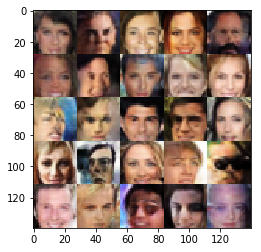

Epoch 7/10... Discriminator Loss: 0.025428... Generator Loss: 5.023691
Epoch 7/10... Discriminator Loss: 0.383836... Generator Loss: 1.967561
Epoch 7/10... Discriminator Loss: 0.165403... Generator Loss: 3.086405
Epoch 7/10... Discriminator Loss: 0.515865... Generator Loss: 1.882925
Epoch 7/10... Discriminator Loss: 0.751995... Generator Loss: 1.243559
Epoch 7/10... Discriminator Loss: 0.022234... Generator Loss: 5.272572
Epoch 7/10... Discriminator Loss: 0.110106... Generator Loss: 3.284526
Epoch 7/10... Discriminator Loss: 0.274957... Generator Loss: 2.031819
Epoch 7/10... Discriminator Loss: 0.272999... Generator Loss: 5.882498
Epoch 7/10... Discriminator Loss: 0.790779... Generator Loss: 1.487750


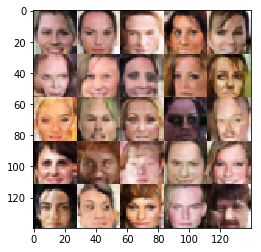

Epoch 7/10... Discriminator Loss: 0.755624... Generator Loss: 1.346229
Epoch 7/10... Discriminator Loss: 0.207787... Generator Loss: 2.868714
Epoch 7/10... Discriminator Loss: 0.188001... Generator Loss: 2.720808
Epoch 7/10... Discriminator Loss: 0.210145... Generator Loss: 2.556695
Epoch 7/10... Discriminator Loss: 0.169462... Generator Loss: 6.665380
Epoch 7/10... Discriminator Loss: 0.009972... Generator Loss: 7.648018
Epoch 7/10... Discriminator Loss: 0.087863... Generator Loss: 3.920796
Epoch 7/10... Discriminator Loss: 0.170949... Generator Loss: 2.622864
Epoch 7/10... Discriminator Loss: 4.671422... Generator Loss: 0.490473
Epoch 7/10... Discriminator Loss: 0.778372... Generator Loss: 4.575900


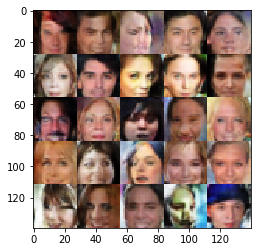

Epoch 7/10... Discriminator Loss: 0.659075... Generator Loss: 1.546505
Epoch 7/10... Discriminator Loss: 0.262491... Generator Loss: 3.332329
Epoch 7/10... Discriminator Loss: 0.688206... Generator Loss: 1.472559
Epoch 7/10... Discriminator Loss: 0.121050... Generator Loss: 4.894584
Epoch 7/10... Discriminator Loss: 0.427315... Generator Loss: 4.543230
Epoch 7/10... Discriminator Loss: 1.071591... Generator Loss: 1.336039
Epoch 7/10... Discriminator Loss: 0.087465... Generator Loss: 4.056423
Epoch 7/10... Discriminator Loss: 1.432725... Generator Loss: 5.916453
Epoch 7/10... Discriminator Loss: 0.607645... Generator Loss: 1.548212
Epoch 7/10... Discriminator Loss: 1.007743... Generator Loss: 1.091398


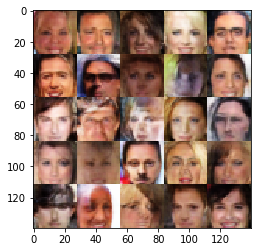

Epoch 7/10... Discriminator Loss: 0.349059... Generator Loss: 3.861531
Epoch 7/10... Discriminator Loss: 0.375095... Generator Loss: 1.991316
Epoch 7/10... Discriminator Loss: 0.183883... Generator Loss: 3.130165
Epoch 7/10... Discriminator Loss: 0.426943... Generator Loss: 1.916113
Epoch 7/10... Discriminator Loss: 0.321040... Generator Loss: 2.149290
Epoch 7/10... Discriminator Loss: 0.375252... Generator Loss: 2.275896
Epoch 7/10... Discriminator Loss: 0.089740... Generator Loss: 3.903355
Epoch 7/10... Discriminator Loss: 0.157432... Generator Loss: 3.915223
Epoch 7/10... Discriminator Loss: 0.191143... Generator Loss: 2.980246
Epoch 7/10... Discriminator Loss: 0.175417... Generator Loss: 2.653675


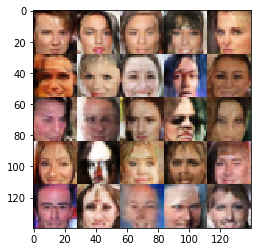

Epoch 7/10... Discriminator Loss: 0.811638... Generator Loss: 1.182728
Epoch 7/10... Discriminator Loss: 0.400973... Generator Loss: 11.565313
Epoch 7/10... Discriminator Loss: 0.145405... Generator Loss: 3.539800
Epoch 7/10... Discriminator Loss: 0.039386... Generator Loss: 4.814103
Epoch 7/10... Discriminator Loss: 0.125454... Generator Loss: 3.466304
Epoch 7/10... Discriminator Loss: 0.424897... Generator Loss: 6.455646
Epoch 7/10... Discriminator Loss: 0.069434... Generator Loss: 4.859197
Epoch 7/10... Discriminator Loss: 0.351448... Generator Loss: 2.188571
Epoch 7/10... Discriminator Loss: 0.024096... Generator Loss: 5.672258
Epoch 7/10... Discriminator Loss: 0.083840... Generator Loss: 3.825095


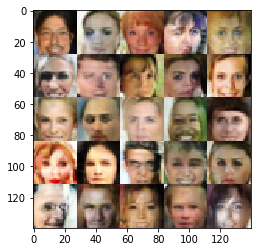

Epoch 7/10... Discriminator Loss: 0.257694... Generator Loss: 2.460745
Epoch 7/10... Discriminator Loss: 0.098473... Generator Loss: 3.999048
Epoch 7/10... Discriminator Loss: 0.234802... Generator Loss: 3.171574
Epoch 7/10... Discriminator Loss: 0.953593... Generator Loss: 1.043339
Epoch 7/10... Discriminator Loss: 0.073230... Generator Loss: 4.264645
Epoch 7/10... Discriminator Loss: 0.618853... Generator Loss: 1.488135
Epoch 7/10... Discriminator Loss: 0.059739... Generator Loss: 4.224418
Epoch 7/10... Discriminator Loss: 0.092870... Generator Loss: 3.604038
Epoch 7/10... Discriminator Loss: 0.273580... Generator Loss: 2.208420
Epoch 7/10... Discriminator Loss: 0.269397... Generator Loss: 2.635238


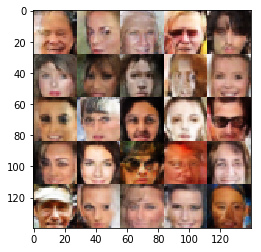

Epoch 7/10... Discriminator Loss: 1.838786... Generator Loss: 0.647446
Epoch 7/10... Discriminator Loss: 0.423727... Generator Loss: 2.199630
Epoch 7/10... Discriminator Loss: 0.112185... Generator Loss: 3.948959
Epoch 7/10... Discriminator Loss: 0.072625... Generator Loss: 4.308711
Epoch 7/10... Discriminator Loss: 0.037711... Generator Loss: 4.849208
Epoch 7/10... Discriminator Loss: 0.037825... Generator Loss: 9.795037
Epoch 7/10... Discriminator Loss: 0.041709... Generator Loss: 4.231255
Epoch 7/10... Discriminator Loss: 0.009028... Generator Loss: 7.768508
Epoch 7/10... Discriminator Loss: 0.102872... Generator Loss: 5.674279
Epoch 7/10... Discriminator Loss: 0.071927... Generator Loss: 4.391105


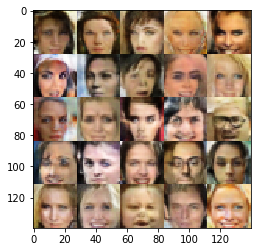

Epoch 7/10... Discriminator Loss: 2.037625... Generator Loss: 0.439687
Epoch 7/10... Discriminator Loss: 0.240059... Generator Loss: 2.760416
Epoch 7/10... Discriminator Loss: 0.337449... Generator Loss: 2.053077
Epoch 7/10... Discriminator Loss: 0.365817... Generator Loss: 2.225979
Epoch 7/10... Discriminator Loss: 0.089598... Generator Loss: 3.430099
Epoch 7/10... Discriminator Loss: 0.035551... Generator Loss: 4.561147
Epoch 7/10... Discriminator Loss: 0.023783... Generator Loss: 6.552185
Epoch 7/10... Discriminator Loss: 0.229838... Generator Loss: 2.722847
Epoch 7/10... Discriminator Loss: 0.032855... Generator Loss: 4.911502
Epoch 7/10... Discriminator Loss: 0.216739... Generator Loss: 2.505744


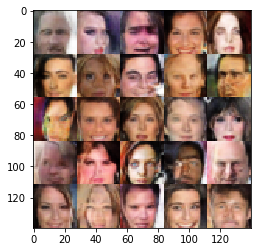

Epoch 7/10... Discriminator Loss: 0.147035... Generator Loss: 3.076983
Epoch 7/10... Discriminator Loss: 0.777538... Generator Loss: 0.963917
Epoch 7/10... Discriminator Loss: 0.089815... Generator Loss: 6.493274
Epoch 7/10... Discriminator Loss: 0.012177... Generator Loss: 6.525491
Epoch 7/10... Discriminator Loss: 3.137086... Generator Loss: 0.238126
Epoch 7/10... Discriminator Loss: 2.448508... Generator Loss: 0.591037
Epoch 7/10... Discriminator Loss: 0.635049... Generator Loss: 1.778342
Epoch 7/10... Discriminator Loss: 0.428920... Generator Loss: 2.247350
Epoch 7/10... Discriminator Loss: 0.831719... Generator Loss: 1.192929
Epoch 7/10... Discriminator Loss: 0.179486... Generator Loss: 3.210700


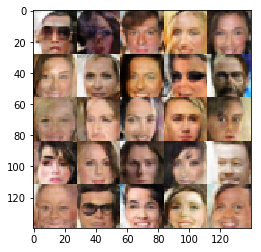

Epoch 7/10... Discriminator Loss: 0.376856... Generator Loss: 1.804687
Epoch 7/10... Discriminator Loss: 0.031233... Generator Loss: 6.807626
Epoch 7/10... Discriminator Loss: 0.189461... Generator Loss: 3.542467
Epoch 7/10... Discriminator Loss: 0.034280... Generator Loss: 5.262043
Epoch 7/10... Discriminator Loss: 0.028915... Generator Loss: 6.078443
Epoch 7/10... Discriminator Loss: 0.381551... Generator Loss: 1.831850
Epoch 7/10... Discriminator Loss: 0.128049... Generator Loss: 3.185193
Epoch 7/10... Discriminator Loss: 0.055855... Generator Loss: 4.579364
Epoch 7/10... Discriminator Loss: 0.093224... Generator Loss: 3.843297
Epoch 7/10... Discriminator Loss: 0.069125... Generator Loss: 4.034298


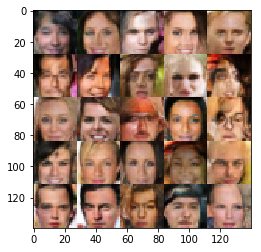

Epoch 7/10... Discriminator Loss: 0.313343... Generator Loss: 2.338200
Epoch 7/10... Discriminator Loss: 0.336519... Generator Loss: 2.167974
Epoch 7/10... Discriminator Loss: 0.155679... Generator Loss: 3.411071
Epoch 7/10... Discriminator Loss: 0.052159... Generator Loss: 6.534327
Epoch 7/10... Discriminator Loss: 0.270291... Generator Loss: 2.499198
Epoch 7/10... Discriminator Loss: 0.972241... Generator Loss: 0.912435
Epoch 7/10... Discriminator Loss: 0.135973... Generator Loss: 3.724617
Epoch 7/10... Discriminator Loss: 0.127378... Generator Loss: 2.947051
Epoch 7/10... Discriminator Loss: 0.098982... Generator Loss: 3.961626
Epoch 7/10... Discriminator Loss: 0.149989... Generator Loss: 8.717596


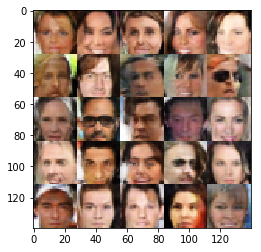

Epoch 7/10... Discriminator Loss: 0.563455... Generator Loss: 1.861266
Epoch 7/10... Discriminator Loss: 0.028880... Generator Loss: 7.566908
Epoch 7/10... Discriminator Loss: 0.090171... Generator Loss: 4.424864
Epoch 7/10... Discriminator Loss: 0.023060... Generator Loss: 5.601777
Epoch 7/10... Discriminator Loss: 0.083319... Generator Loss: 4.079766
Epoch 7/10... Discriminator Loss: 0.289591... Generator Loss: 2.286459
Epoch 7/10... Discriminator Loss: 0.797213... Generator Loss: 1.291170
Epoch 7/10... Discriminator Loss: 0.145995... Generator Loss: 2.876422
Epoch 7/10... Discriminator Loss: 0.013585... Generator Loss: 5.779171
Epoch 7/10... Discriminator Loss: 0.073756... Generator Loss: 5.946850


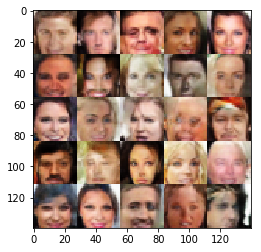

Epoch 7/10... Discriminator Loss: 0.419351... Generator Loss: 8.673735
Epoch 7/10... Discriminator Loss: 0.290759... Generator Loss: 2.481142
Epoch 7/10... Discriminator Loss: 0.038443... Generator Loss: 7.751486
Epoch 7/10... Discriminator Loss: 0.129347... Generator Loss: 2.648719
Epoch 7/10... Discriminator Loss: 0.084267... Generator Loss: 3.529006
Epoch 7/10... Discriminator Loss: 0.019748... Generator Loss: 7.933499
Epoch 7/10... Discriminator Loss: 0.070774... Generator Loss: 4.237424
Epoch 7/10... Discriminator Loss: 0.180375... Generator Loss: 3.094596
Epoch 7/10... Discriminator Loss: 0.639715... Generator Loss: 1.615213
Epoch 7/10... Discriminator Loss: 0.870377... Generator Loss: 1.434857


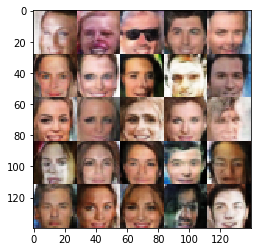

Epoch 7/10... Discriminator Loss: 0.076558... Generator Loss: 4.634260
Epoch 7/10... Discriminator Loss: 3.708291... Generator Loss: 0.223874
Epoch 7/10... Discriminator Loss: 0.134124... Generator Loss: 3.083468
Epoch 7/10... Discriminator Loss: 0.067499... Generator Loss: 3.919173
Epoch 7/10... Discriminator Loss: 0.315647... Generator Loss: 2.321185
Epoch 7/10... Discriminator Loss: 0.217934... Generator Loss: 3.058882
Epoch 7/10... Discriminator Loss: 0.147806... Generator Loss: 5.376811
Epoch 7/10... Discriminator Loss: 0.118607... Generator Loss: 3.654960
Epoch 7/10... Discriminator Loss: 0.070913... Generator Loss: 4.125472
Epoch 7/10... Discriminator Loss: 0.075004... Generator Loss: 3.673303


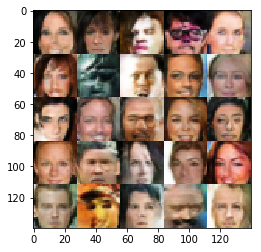

Epoch 7/10... Discriminator Loss: 0.380907... Generator Loss: 2.083475
Epoch 7/10... Discriminator Loss: 0.144308... Generator Loss: 3.235751
Epoch 7/10... Discriminator Loss: 0.030891... Generator Loss: 6.239742
Epoch 7/10... Discriminator Loss: 0.032028... Generator Loss: 5.748092
Epoch 7/10... Discriminator Loss: 2.200588... Generator Loss: 0.510627
Epoch 7/10... Discriminator Loss: 0.260754... Generator Loss: 5.506010
Epoch 7/10... Discriminator Loss: 0.103586... Generator Loss: 5.471389
Epoch 7/10... Discriminator Loss: 0.314023... Generator Loss: 2.596763
Epoch 7/10... Discriminator Loss: 0.692935... Generator Loss: 1.475431
Epoch 7/10... Discriminator Loss: 0.058594... Generator Loss: 4.294616


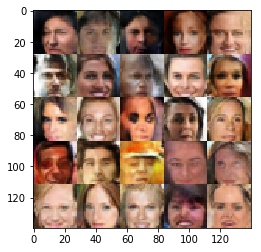

Epoch 7/10... Discriminator Loss: 0.193119... Generator Loss: 2.800239
Epoch 7/10... Discriminator Loss: 0.348482... Generator Loss: 2.127930
Epoch 7/10... Discriminator Loss: 0.151077... Generator Loss: 3.418861
Epoch 7/10... Discriminator Loss: 0.269128... Generator Loss: 2.526530
Epoch 7/10... Discriminator Loss: 0.117681... Generator Loss: 4.055523
Epoch 7/10... Discriminator Loss: 0.154992... Generator Loss: 2.709656
Epoch 7/10... Discriminator Loss: 0.020759... Generator Loss: 5.618513
Epoch 7/10... Discriminator Loss: 2.737368... Generator Loss: 0.532349
Epoch 7/10... Discriminator Loss: 1.105840... Generator Loss: 1.403142
Epoch 7/10... Discriminator Loss: 0.271643... Generator Loss: 6.339877


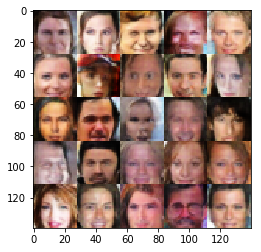

Epoch 7/10... Discriminator Loss: 0.606146... Generator Loss: 1.942252
Epoch 7/10... Discriminator Loss: 0.094688... Generator Loss: 4.536108
Epoch 7/10... Discriminator Loss: 1.597023... Generator Loss: 0.933758
Epoch 7/10... Discriminator Loss: 0.159805... Generator Loss: 4.317826
Epoch 7/10... Discriminator Loss: 2.234497... Generator Loss: 7.837308
Epoch 7/10... Discriminator Loss: 1.395617... Generator Loss: 1.280609
Epoch 7/10... Discriminator Loss: 0.111313... Generator Loss: 4.267147
Epoch 7/10... Discriminator Loss: 0.059018... Generator Loss: 6.750215
Epoch 7/10... Discriminator Loss: 0.334675... Generator Loss: 2.198220
Epoch 7/10... Discriminator Loss: 0.483615... Generator Loss: 2.111214


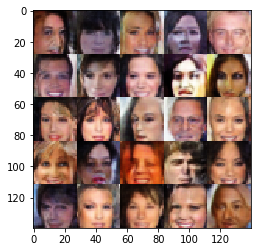

Epoch 7/10... Discriminator Loss: 1.587724... Generator Loss: 0.648814
Epoch 7/10... Discriminator Loss: 0.122944... Generator Loss: 4.855464
Epoch 7/10... Discriminator Loss: 0.197952... Generator Loss: 2.629065
Epoch 7/10... Discriminator Loss: 0.021400... Generator Loss: 7.735787
Epoch 7/10... Discriminator Loss: 0.090700... Generator Loss: 3.702470
Epoch 7/10... Discriminator Loss: 0.316786... Generator Loss: 2.573345
Epoch 7/10... Discriminator Loss: 0.250972... Generator Loss: 2.541534
Epoch 7/10... Discriminator Loss: 0.549743... Generator Loss: 1.679513
Epoch 7/10... Discriminator Loss: 0.525946... Generator Loss: 1.429981
Epoch 7/10... Discriminator Loss: 0.760658... Generator Loss: 1.369445


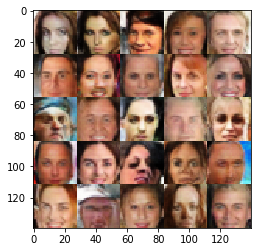

Epoch 7/10... Discriminator Loss: 0.087064... Generator Loss: 3.866876
Epoch 7/10... Discriminator Loss: 0.116190... Generator Loss: 3.345893
Epoch 7/10... Discriminator Loss: 2.695259... Generator Loss: 0.377747
Epoch 7/10... Discriminator Loss: 0.202367... Generator Loss: 3.214451
Epoch 7/10... Discriminator Loss: 0.221387... Generator Loss: 6.079422
Epoch 7/10... Discriminator Loss: 0.136721... Generator Loss: 3.658428
Epoch 7/10... Discriminator Loss: 0.646180... Generator Loss: 1.333008
Epoch 7/10... Discriminator Loss: 1.724934... Generator Loss: 0.888633
Epoch 7/10... Discriminator Loss: 0.078309... Generator Loss: 4.840961
Epoch 7/10... Discriminator Loss: 0.012802... Generator Loss: 6.728459


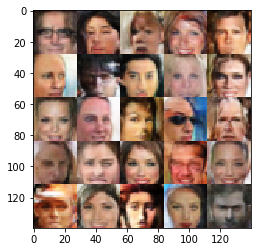

Epoch 7/10... Discriminator Loss: 0.151471... Generator Loss: 2.705815
Epoch 7/10... Discriminator Loss: 0.300458... Generator Loss: 2.359408
Epoch 7/10... Discriminator Loss: 0.431112... Generator Loss: 1.786263
Epoch 7/10... Discriminator Loss: 0.077714... Generator Loss: 7.780197
Epoch 7/10... Discriminator Loss: 0.204816... Generator Loss: 3.011673
Epoch 8/10... Discriminator Loss: 0.023389... Generator Loss: 6.937785
Epoch 8/10... Discriminator Loss: 0.285970... Generator Loss: 2.282100
Epoch 8/10... Discriminator Loss: 0.068200... Generator Loss: 4.165270
Epoch 8/10... Discriminator Loss: 0.281958... Generator Loss: 2.446923
Epoch 8/10... Discriminator Loss: 0.385656... Generator Loss: 2.109845


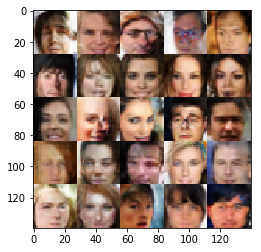

Epoch 8/10... Discriminator Loss: 0.060407... Generator Loss: 3.769375
Epoch 8/10... Discriminator Loss: 0.331770... Generator Loss: 1.940620
Epoch 8/10... Discriminator Loss: 0.037836... Generator Loss: 5.356005
Epoch 8/10... Discriminator Loss: 0.093784... Generator Loss: 3.847913
Epoch 8/10... Discriminator Loss: 0.477868... Generator Loss: 1.830197
Epoch 8/10... Discriminator Loss: 0.167234... Generator Loss: 3.025294
Epoch 8/10... Discriminator Loss: 0.128393... Generator Loss: 3.555542
Epoch 8/10... Discriminator Loss: 0.132522... Generator Loss: 3.285233
Epoch 8/10... Discriminator Loss: 0.008336... Generator Loss: 6.489546
Epoch 8/10... Discriminator Loss: 0.273622... Generator Loss: 2.434626


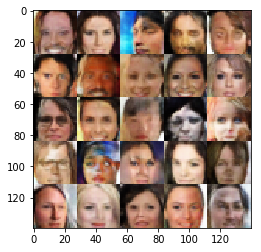

Epoch 8/10... Discriminator Loss: 0.080191... Generator Loss: 3.619934
Epoch 8/10... Discriminator Loss: 0.127714... Generator Loss: 5.762727
Epoch 8/10... Discriminator Loss: 2.680285... Generator Loss: 0.717128
Epoch 8/10... Discriminator Loss: 1.069432... Generator Loss: 4.141323
Epoch 8/10... Discriminator Loss: 0.615734... Generator Loss: 4.797665
Epoch 8/10... Discriminator Loss: 3.718445... Generator Loss: 8.931449
Epoch 8/10... Discriminator Loss: 0.850114... Generator Loss: 1.494085
Epoch 8/10... Discriminator Loss: 3.226311... Generator Loss: 0.518019
Epoch 8/10... Discriminator Loss: 0.146587... Generator Loss: 4.040124
Epoch 8/10... Discriminator Loss: 0.493932... Generator Loss: 1.880988


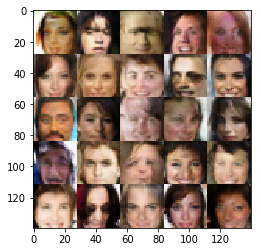

Epoch 8/10... Discriminator Loss: 0.047606... Generator Loss: 4.279560
Epoch 8/10... Discriminator Loss: 0.241472... Generator Loss: 3.538042
Epoch 8/10... Discriminator Loss: 0.167554... Generator Loss: 4.400106
Epoch 8/10... Discriminator Loss: 0.172974... Generator Loss: 3.334739
Epoch 8/10... Discriminator Loss: 0.395929... Generator Loss: 1.985737
Epoch 8/10... Discriminator Loss: 0.147884... Generator Loss: 3.625838
Epoch 8/10... Discriminator Loss: 0.200431... Generator Loss: 3.007329
Epoch 8/10... Discriminator Loss: 0.057373... Generator Loss: 5.197864
Epoch 8/10... Discriminator Loss: 0.061834... Generator Loss: 3.949365
Epoch 8/10... Discriminator Loss: 0.086482... Generator Loss: 3.871206


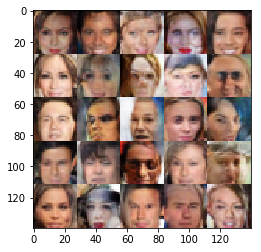

Epoch 8/10... Discriminator Loss: 0.794111... Generator Loss: 1.417608
Epoch 8/10... Discriminator Loss: 0.119155... Generator Loss: 3.648694
Epoch 8/10... Discriminator Loss: 0.072265... Generator Loss: 4.349352
Epoch 8/10... Discriminator Loss: 0.097630... Generator Loss: 3.145813
Epoch 8/10... Discriminator Loss: 0.062767... Generator Loss: 4.114376
Epoch 8/10... Discriminator Loss: 0.126277... Generator Loss: 3.868116
Epoch 8/10... Discriminator Loss: 0.079514... Generator Loss: 3.774812
Epoch 8/10... Discriminator Loss: 0.743201... Generator Loss: 1.255414
Epoch 8/10... Discriminator Loss: 0.123323... Generator Loss: 3.478306
Epoch 8/10... Discriminator Loss: 0.413199... Generator Loss: 1.944837


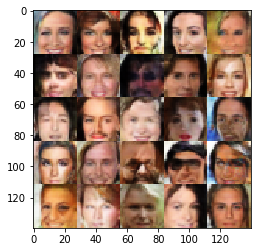

Epoch 8/10... Discriminator Loss: 0.367814... Generator Loss: 1.968572
Epoch 8/10... Discriminator Loss: 0.365991... Generator Loss: 3.940890
Epoch 8/10... Discriminator Loss: 2.740942... Generator Loss: 0.503544
Epoch 8/10... Discriminator Loss: 0.133189... Generator Loss: 3.548318
Epoch 8/10... Discriminator Loss: 0.056501... Generator Loss: 4.661454
Epoch 8/10... Discriminator Loss: 0.854699... Generator Loss: 13.471930
Epoch 8/10... Discriminator Loss: 0.053519... Generator Loss: 4.885236
Epoch 8/10... Discriminator Loss: 0.220851... Generator Loss: 3.217078
Epoch 8/10... Discriminator Loss: 0.022399... Generator Loss: 5.167190
Epoch 8/10... Discriminator Loss: 0.299761... Generator Loss: 2.455733


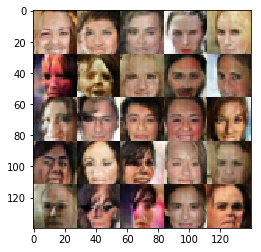

Epoch 8/10... Discriminator Loss: 0.116226... Generator Loss: 3.637930
Epoch 8/10... Discriminator Loss: 0.125232... Generator Loss: 4.327874
Epoch 8/10... Discriminator Loss: 0.568784... Generator Loss: 1.693991
Epoch 8/10... Discriminator Loss: 0.314763... Generator Loss: 2.457626
Epoch 8/10... Discriminator Loss: 0.266241... Generator Loss: 2.330023
Epoch 8/10... Discriminator Loss: 0.022688... Generator Loss: 5.781788
Epoch 8/10... Discriminator Loss: 0.108798... Generator Loss: 3.438044
Epoch 8/10... Discriminator Loss: 0.016038... Generator Loss: 6.722446
Epoch 8/10... Discriminator Loss: 0.214385... Generator Loss: 2.771559
Epoch 8/10... Discriminator Loss: 0.373417... Generator Loss: 2.031914


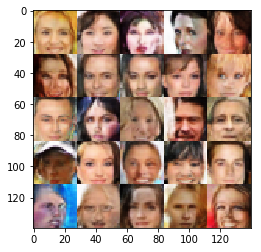

Epoch 8/10... Discriminator Loss: 0.077316... Generator Loss: 5.768484
Epoch 8/10... Discriminator Loss: 0.484947... Generator Loss: 1.965271
Epoch 8/10... Discriminator Loss: 0.019656... Generator Loss: 6.019073
Epoch 8/10... Discriminator Loss: 0.079692... Generator Loss: 5.713015
Epoch 8/10... Discriminator Loss: 0.025429... Generator Loss: 5.544532
Epoch 8/10... Discriminator Loss: 0.053918... Generator Loss: 4.211820
Epoch 8/10... Discriminator Loss: 2.493864... Generator Loss: 10.209208
Epoch 8/10... Discriminator Loss: 0.292150... Generator Loss: 2.788975
Epoch 8/10... Discriminator Loss: 1.411732... Generator Loss: 0.907819
Epoch 8/10... Discriminator Loss: 0.017953... Generator Loss: 5.966414


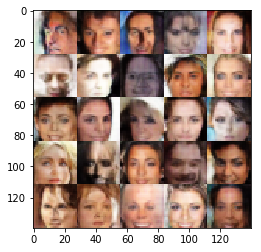

Epoch 8/10... Discriminator Loss: 0.406655... Generator Loss: 2.020329
Epoch 8/10... Discriminator Loss: 0.267924... Generator Loss: 2.705901
Epoch 8/10... Discriminator Loss: 2.589535... Generator Loss: 0.247851
Epoch 8/10... Discriminator Loss: 0.164929... Generator Loss: 3.263020
Epoch 8/10... Discriminator Loss: 1.943283... Generator Loss: 0.842646
Epoch 8/10... Discriminator Loss: 0.442154... Generator Loss: 2.349169
Epoch 8/10... Discriminator Loss: 0.316668... Generator Loss: 2.197304
Epoch 8/10... Discriminator Loss: 0.215477... Generator Loss: 2.669505
Epoch 8/10... Discriminator Loss: 0.165853... Generator Loss: 2.960336
Epoch 8/10... Discriminator Loss: 0.241239... Generator Loss: 2.955947


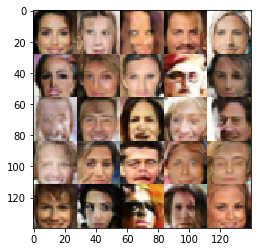

Epoch 8/10... Discriminator Loss: 0.357909... Generator Loss: 5.899710
Epoch 8/10... Discriminator Loss: 0.317475... Generator Loss: 2.617954
Epoch 8/10... Discriminator Loss: 0.016879... Generator Loss: 5.858200
Epoch 8/10... Discriminator Loss: 0.469684... Generator Loss: 2.244106
Epoch 8/10... Discriminator Loss: 0.119624... Generator Loss: 3.651789
Epoch 8/10... Discriminator Loss: 0.377460... Generator Loss: 2.181449
Epoch 8/10... Discriminator Loss: 0.071643... Generator Loss: 4.498611
Epoch 8/10... Discriminator Loss: 0.282174... Generator Loss: 7.165563
Epoch 8/10... Discriminator Loss: 0.211936... Generator Loss: 3.132489
Epoch 8/10... Discriminator Loss: 0.631386... Generator Loss: 1.742133


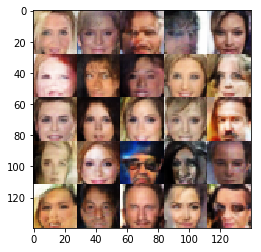

Epoch 8/10... Discriminator Loss: 0.102412... Generator Loss: 4.599560
Epoch 8/10... Discriminator Loss: 0.464295... Generator Loss: 2.313153
Epoch 8/10... Discriminator Loss: 0.234588... Generator Loss: 3.333199
Epoch 8/10... Discriminator Loss: 0.232939... Generator Loss: 2.352821
Epoch 8/10... Discriminator Loss: 0.263975... Generator Loss: 2.800445
Epoch 8/10... Discriminator Loss: 0.254911... Generator Loss: 2.593961
Epoch 8/10... Discriminator Loss: 0.021910... Generator Loss: 6.232825
Epoch 8/10... Discriminator Loss: 0.037474... Generator Loss: 4.829088
Epoch 8/10... Discriminator Loss: 0.289826... Generator Loss: 2.572476
Epoch 8/10... Discriminator Loss: 0.082281... Generator Loss: 3.393951


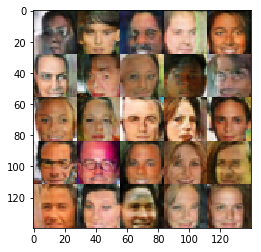

Epoch 8/10... Discriminator Loss: 0.380294... Generator Loss: 2.263235
Epoch 8/10... Discriminator Loss: 0.074848... Generator Loss: 4.061949
Epoch 8/10... Discriminator Loss: 0.163264... Generator Loss: 4.570299
Epoch 8/10... Discriminator Loss: 0.078289... Generator Loss: 4.493174
Epoch 8/10... Discriminator Loss: 0.039509... Generator Loss: 5.653301
Epoch 8/10... Discriminator Loss: 0.151664... Generator Loss: 3.030797
Epoch 8/10... Discriminator Loss: 0.238986... Generator Loss: 2.266746
Epoch 8/10... Discriminator Loss: 0.016081... Generator Loss: 5.867116
Epoch 8/10... Discriminator Loss: 1.187582... Generator Loss: 0.932033
Epoch 8/10... Discriminator Loss: 0.095141... Generator Loss: 3.291340


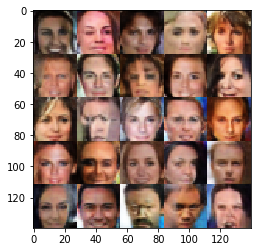

Epoch 8/10... Discriminator Loss: 0.019833... Generator Loss: 5.669943
Epoch 8/10... Discriminator Loss: 0.102454... Generator Loss: 3.464015
Epoch 8/10... Discriminator Loss: 0.087099... Generator Loss: 3.816359
Epoch 8/10... Discriminator Loss: 0.119945... Generator Loss: 3.547842
Epoch 8/10... Discriminator Loss: 0.027714... Generator Loss: 9.288570
Epoch 8/10... Discriminator Loss: 0.152926... Generator Loss: 2.906456
Epoch 8/10... Discriminator Loss: 0.050040... Generator Loss: 4.400613
Epoch 8/10... Discriminator Loss: 0.033291... Generator Loss: 6.249744
Epoch 8/10... Discriminator Loss: 0.096823... Generator Loss: 3.972831
Epoch 8/10... Discriminator Loss: 0.028239... Generator Loss: 5.553450


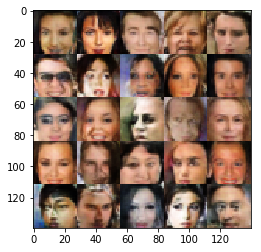

Epoch 8/10... Discriminator Loss: 0.102712... Generator Loss: 3.471551
Epoch 8/10... Discriminator Loss: 0.168401... Generator Loss: 3.069954
Epoch 8/10... Discriminator Loss: 0.017502... Generator Loss: 6.195295
Epoch 8/10... Discriminator Loss: 0.009787... Generator Loss: 6.069769
Epoch 8/10... Discriminator Loss: 0.017168... Generator Loss: 7.092096
Epoch 8/10... Discriminator Loss: 0.077095... Generator Loss: 3.684742
Epoch 8/10... Discriminator Loss: 0.104343... Generator Loss: 3.986486
Epoch 8/10... Discriminator Loss: 0.152158... Generator Loss: 3.803484
Epoch 8/10... Discriminator Loss: 0.044455... Generator Loss: 4.585405
Epoch 8/10... Discriminator Loss: 0.108953... Generator Loss: 3.477628


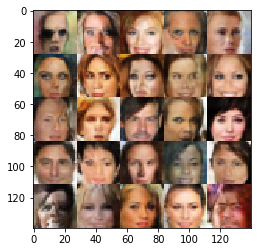

Epoch 8/10... Discriminator Loss: 0.209808... Generator Loss: 2.653051
Epoch 8/10... Discriminator Loss: 0.181455... Generator Loss: 2.232095
Epoch 8/10... Discriminator Loss: 0.085582... Generator Loss: 4.475455
Epoch 8/10... Discriminator Loss: 0.186750... Generator Loss: 2.867119
Epoch 8/10... Discriminator Loss: 0.101180... Generator Loss: 3.733576
Epoch 8/10... Discriminator Loss: 0.266203... Generator Loss: 3.055182
Epoch 8/10... Discriminator Loss: 1.462709... Generator Loss: 1.129855
Epoch 8/10... Discriminator Loss: 3.081377... Generator Loss: 0.362432
Epoch 8/10... Discriminator Loss: 0.269971... Generator Loss: 3.514641
Epoch 8/10... Discriminator Loss: 0.391034... Generator Loss: 2.449083


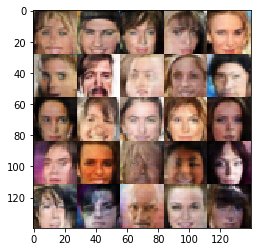

Epoch 8/10... Discriminator Loss: 0.104140... Generator Loss: 5.446823
Epoch 8/10... Discriminator Loss: 0.434899... Generator Loss: 2.159936
Epoch 8/10... Discriminator Loss: 0.961520... Generator Loss: 1.626851
Epoch 8/10... Discriminator Loss: 2.715838... Generator Loss: 12.723108
Epoch 8/10... Discriminator Loss: 2.215097... Generator Loss: 0.471110
Epoch 8/10... Discriminator Loss: 0.915990... Generator Loss: 1.428457
Epoch 8/10... Discriminator Loss: 0.423559... Generator Loss: 2.031911
Epoch 8/10... Discriminator Loss: 0.165685... Generator Loss: 3.735860
Epoch 8/10... Discriminator Loss: 0.501375... Generator Loss: 6.423843
Epoch 8/10... Discriminator Loss: 0.122118... Generator Loss: 3.559342


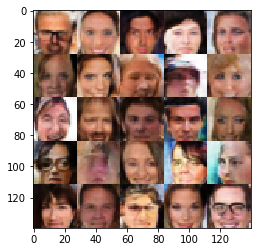

Epoch 8/10... Discriminator Loss: 0.220716... Generator Loss: 7.757867
Epoch 8/10... Discriminator Loss: 0.416574... Generator Loss: 1.998033
Epoch 8/10... Discriminator Loss: 0.014157... Generator Loss: 7.918987
Epoch 8/10... Discriminator Loss: 0.078299... Generator Loss: 4.652983
Epoch 8/10... Discriminator Loss: 0.352089... Generator Loss: 2.201533
Epoch 8/10... Discriminator Loss: 0.260993... Generator Loss: 2.483244
Epoch 8/10... Discriminator Loss: 0.175692... Generator Loss: 3.069470
Epoch 8/10... Discriminator Loss: 0.039417... Generator Loss: 9.376267
Epoch 8/10... Discriminator Loss: 0.579232... Generator Loss: 1.666746
Epoch 8/10... Discriminator Loss: 0.050922... Generator Loss: 7.015676


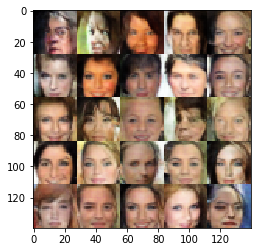

Epoch 8/10... Discriminator Loss: 0.147019... Generator Loss: 3.376146
Epoch 8/10... Discriminator Loss: 3.061893... Generator Loss: 0.227910
Epoch 8/10... Discriminator Loss: 0.628876... Generator Loss: 1.638290
Epoch 8/10... Discriminator Loss: 0.054453... Generator Loss: 4.227592
Epoch 8/10... Discriminator Loss: 0.184240... Generator Loss: 2.921042
Epoch 8/10... Discriminator Loss: 0.013965... Generator Loss: 8.841624
Epoch 8/10... Discriminator Loss: 0.549898... Generator Loss: 1.530494
Epoch 8/10... Discriminator Loss: 0.560303... Generator Loss: 1.698340
Epoch 8/10... Discriminator Loss: 0.143161... Generator Loss: 3.495823
Epoch 8/10... Discriminator Loss: 0.088101... Generator Loss: 4.308853


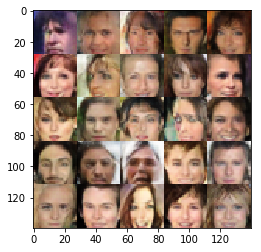

Epoch 8/10... Discriminator Loss: 0.031298... Generator Loss: 5.428948
Epoch 8/10... Discriminator Loss: 0.102439... Generator Loss: 3.750814
Epoch 8/10... Discriminator Loss: 0.076569... Generator Loss: 4.227345
Epoch 8/10... Discriminator Loss: 0.285825... Generator Loss: 2.052404
Epoch 8/10... Discriminator Loss: 0.186803... Generator Loss: 2.976987
Epoch 8/10... Discriminator Loss: 0.022170... Generator Loss: 5.894329
Epoch 8/10... Discriminator Loss: 0.177874... Generator Loss: 3.872264
Epoch 8/10... Discriminator Loss: 0.883817... Generator Loss: 1.512090
Epoch 8/10... Discriminator Loss: 0.132172... Generator Loss: 3.321594
Epoch 8/10... Discriminator Loss: 0.094890... Generator Loss: 2.961404


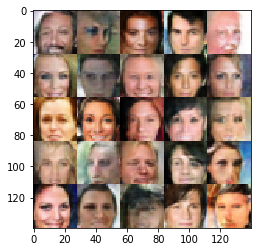

Epoch 8/10... Discriminator Loss: 0.063621... Generator Loss: 4.185909
Epoch 8/10... Discriminator Loss: 0.035805... Generator Loss: 5.182569
Epoch 8/10... Discriminator Loss: 0.106570... Generator Loss: 3.449425
Epoch 8/10... Discriminator Loss: 0.220773... Generator Loss: 2.243926
Epoch 8/10... Discriminator Loss: 0.198050... Generator Loss: 2.799515
Epoch 8/10... Discriminator Loss: 0.072704... Generator Loss: 3.984172
Epoch 8/10... Discriminator Loss: 0.420331... Generator Loss: 1.942468
Epoch 8/10... Discriminator Loss: 0.134013... Generator Loss: 3.043472
Epoch 8/10... Discriminator Loss: 0.059018... Generator Loss: 4.075067
Epoch 8/10... Discriminator Loss: 1.122000... Generator Loss: 9.390737


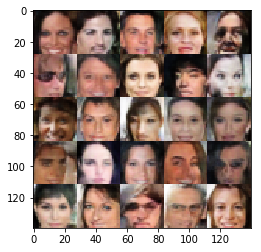

Epoch 8/10... Discriminator Loss: 0.110419... Generator Loss: 3.436378
Epoch 8/10... Discriminator Loss: 0.039603... Generator Loss: 5.227343
Epoch 8/10... Discriminator Loss: 0.053235... Generator Loss: 3.665753
Epoch 8/10... Discriminator Loss: 0.035307... Generator Loss: 5.226222
Epoch 8/10... Discriminator Loss: 0.084546... Generator Loss: 4.456407
Epoch 8/10... Discriminator Loss: 0.648643... Generator Loss: 1.374787
Epoch 8/10... Discriminator Loss: 0.004260... Generator Loss: 10.552776
Epoch 8/10... Discriminator Loss: 0.348051... Generator Loss: 2.279618
Epoch 8/10... Discriminator Loss: 0.382184... Generator Loss: 1.910906
Epoch 8/10... Discriminator Loss: 0.065406... Generator Loss: 3.977872


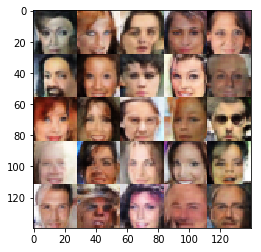

Epoch 8/10... Discriminator Loss: 0.131824... Generator Loss: 2.979934
Epoch 8/10... Discriminator Loss: 0.085415... Generator Loss: 3.599963
Epoch 8/10... Discriminator Loss: 0.024536... Generator Loss: 5.669725
Epoch 8/10... Discriminator Loss: 0.061789... Generator Loss: 4.420365
Epoch 8/10... Discriminator Loss: 0.188006... Generator Loss: 3.063883
Epoch 8/10... Discriminator Loss: 3.020596... Generator Loss: 0.265811
Epoch 8/10... Discriminator Loss: 0.040282... Generator Loss: 5.412701
Epoch 8/10... Discriminator Loss: 0.222987... Generator Loss: 2.600894
Epoch 8/10... Discriminator Loss: 0.074231... Generator Loss: 4.878939
Epoch 8/10... Discriminator Loss: 0.032883... Generator Loss: 5.536808


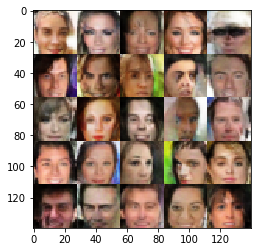

Epoch 8/10... Discriminator Loss: 0.022498... Generator Loss: 6.875474
Epoch 8/10... Discriminator Loss: 0.066824... Generator Loss: 4.830482
Epoch 8/10... Discriminator Loss: 0.056209... Generator Loss: 4.526892
Epoch 8/10... Discriminator Loss: 4.741135... Generator Loss: 0.157407
Epoch 8/10... Discriminator Loss: 0.493350... Generator Loss: 2.477770
Epoch 8/10... Discriminator Loss: 0.502731... Generator Loss: 1.930300
Epoch 8/10... Discriminator Loss: 0.278751... Generator Loss: 2.507916
Epoch 8/10... Discriminator Loss: 0.261091... Generator Loss: 6.400254
Epoch 8/10... Discriminator Loss: 0.059081... Generator Loss: 6.055282
Epoch 8/10... Discriminator Loss: 0.258508... Generator Loss: 2.852154


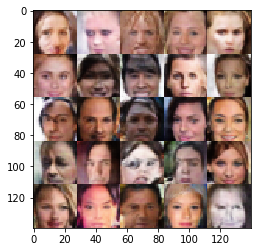

Epoch 8/10... Discriminator Loss: 0.612163... Generator Loss: 6.213760
Epoch 8/10... Discriminator Loss: 0.103516... Generator Loss: 4.687665
Epoch 8/10... Discriminator Loss: 0.474884... Generator Loss: 1.925803
Epoch 8/10... Discriminator Loss: 0.191946... Generator Loss: 9.300680
Epoch 8/10... Discriminator Loss: 0.135072... Generator Loss: 3.535986
Epoch 8/10... Discriminator Loss: 0.052238... Generator Loss: 5.187185
Epoch 8/10... Discriminator Loss: 0.193589... Generator Loss: 3.001270
Epoch 8/10... Discriminator Loss: 0.241580... Generator Loss: 2.679951
Epoch 8/10... Discriminator Loss: 0.328236... Generator Loss: 2.133401
Epoch 8/10... Discriminator Loss: 0.200815... Generator Loss: 3.089526


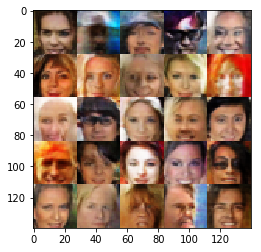

Epoch 8/10... Discriminator Loss: 0.781747... Generator Loss: 1.240359
Epoch 8/10... Discriminator Loss: 0.547947... Generator Loss: 2.033421
Epoch 8/10... Discriminator Loss: 0.039229... Generator Loss: 4.758599
Epoch 8/10... Discriminator Loss: 0.145018... Generator Loss: 2.650125
Epoch 8/10... Discriminator Loss: 0.706566... Generator Loss: 1.725644
Epoch 8/10... Discriminator Loss: 1.188449... Generator Loss: 9.069225
Epoch 8/10... Discriminator Loss: 0.518694... Generator Loss: 2.596447
Epoch 8/10... Discriminator Loss: 0.181471... Generator Loss: 3.411180
Epoch 8/10... Discriminator Loss: 0.201626... Generator Loss: 2.948378
Epoch 8/10... Discriminator Loss: 0.970654... Generator Loss: 1.123667


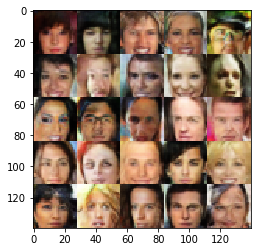

Epoch 8/10... Discriminator Loss: 0.081580... Generator Loss: 3.947701
Epoch 8/10... Discriminator Loss: 0.432588... Generator Loss: 2.063938
Epoch 8/10... Discriminator Loss: 0.270143... Generator Loss: 2.251468
Epoch 8/10... Discriminator Loss: 0.110640... Generator Loss: 3.806643
Epoch 8/10... Discriminator Loss: 0.446966... Generator Loss: 1.632463
Epoch 8/10... Discriminator Loss: 0.621232... Generator Loss: 1.673049
Epoch 8/10... Discriminator Loss: 0.020826... Generator Loss: 6.341675
Epoch 8/10... Discriminator Loss: 0.251347... Generator Loss: 2.715512
Epoch 8/10... Discriminator Loss: 0.517273... Generator Loss: 1.625559
Epoch 8/10... Discriminator Loss: 0.153656... Generator Loss: 2.952555


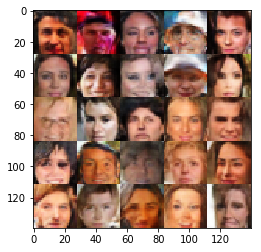

Epoch 8/10... Discriminator Loss: 0.123390... Generator Loss: 3.187590
Epoch 8/10... Discriminator Loss: 0.041191... Generator Loss: 5.358596
Epoch 8/10... Discriminator Loss: 0.187889... Generator Loss: 2.805838
Epoch 8/10... Discriminator Loss: 0.172966... Generator Loss: 3.368268
Epoch 8/10... Discriminator Loss: 3.439785... Generator Loss: 0.156444
Epoch 8/10... Discriminator Loss: 0.138711... Generator Loss: 3.645791
Epoch 8/10... Discriminator Loss: 2.017857... Generator Loss: 0.418682
Epoch 8/10... Discriminator Loss: 0.424875... Generator Loss: 2.196713
Epoch 8/10... Discriminator Loss: 0.026864... Generator Loss: 5.576574
Epoch 8/10... Discriminator Loss: 0.312361... Generator Loss: 2.403125


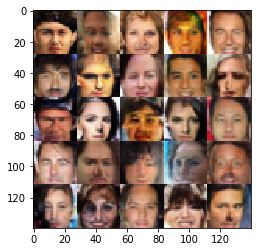

Epoch 8/10... Discriminator Loss: 0.188854... Generator Loss: 2.413363
Epoch 8/10... Discriminator Loss: 0.106065... Generator Loss: 4.191870
Epoch 8/10... Discriminator Loss: 0.125356... Generator Loss: 3.634857
Epoch 8/10... Discriminator Loss: 0.026723... Generator Loss: 6.987068
Epoch 8/10... Discriminator Loss: 0.233792... Generator Loss: 2.631134
Epoch 8/10... Discriminator Loss: 0.029614... Generator Loss: 5.188783
Epoch 8/10... Discriminator Loss: 0.121799... Generator Loss: 3.583682
Epoch 8/10... Discriminator Loss: 0.549214... Generator Loss: 1.834076
Epoch 8/10... Discriminator Loss: 0.062286... Generator Loss: 3.781929
Epoch 8/10... Discriminator Loss: 0.124956... Generator Loss: 6.538227


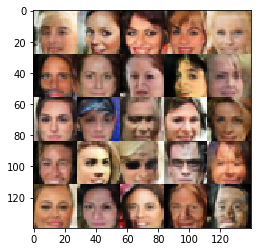

Epoch 8/10... Discriminator Loss: 0.045669... Generator Loss: 4.842585
Epoch 8/10... Discriminator Loss: 0.323237... Generator Loss: 2.028116
Epoch 8/10... Discriminator Loss: 0.149673... Generator Loss: 3.338900
Epoch 8/10... Discriminator Loss: 0.846193... Generator Loss: 1.442510
Epoch 8/10... Discriminator Loss: 0.321543... Generator Loss: 2.181597
Epoch 8/10... Discriminator Loss: 0.024962... Generator Loss: 5.773118
Epoch 8/10... Discriminator Loss: 0.393164... Generator Loss: 2.167351
Epoch 8/10... Discriminator Loss: 0.352136... Generator Loss: 2.391050
Epoch 8/10... Discriminator Loss: 0.201628... Generator Loss: 2.817914
Epoch 8/10... Discriminator Loss: 0.097366... Generator Loss: 3.935549


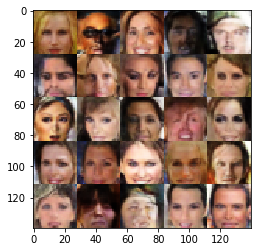

Epoch 8/10... Discriminator Loss: 0.077875... Generator Loss: 4.315378
Epoch 8/10... Discriminator Loss: 0.140496... Generator Loss: 3.079129
Epoch 8/10... Discriminator Loss: 0.083030... Generator Loss: 6.308811
Epoch 8/10... Discriminator Loss: 0.305469... Generator Loss: 2.338318
Epoch 8/10... Discriminator Loss: 1.363089... Generator Loss: 0.649504
Epoch 8/10... Discriminator Loss: 0.082653... Generator Loss: 5.818588
Epoch 8/10... Discriminator Loss: 0.166658... Generator Loss: 3.737126
Epoch 8/10... Discriminator Loss: 0.129748... Generator Loss: 3.281835
Epoch 8/10... Discriminator Loss: 2.659179... Generator Loss: 10.466361
Epoch 8/10... Discriminator Loss: 0.507929... Generator Loss: 11.327598


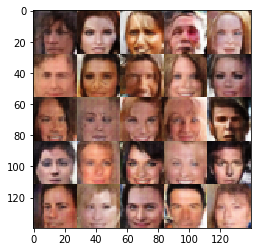

Epoch 8/10... Discriminator Loss: 1.433723... Generator Loss: 9.468884
Epoch 8/10... Discriminator Loss: 2.496091... Generator Loss: 0.363205
Epoch 8/10... Discriminator Loss: 0.305638... Generator Loss: 3.291749
Epoch 8/10... Discriminator Loss: 0.189046... Generator Loss: 5.324977
Epoch 8/10... Discriminator Loss: 0.347620... Generator Loss: 2.380678
Epoch 8/10... Discriminator Loss: 0.266672... Generator Loss: 3.412456
Epoch 8/10... Discriminator Loss: 0.139529... Generator Loss: 3.250474
Epoch 8/10... Discriminator Loss: 0.030755... Generator Loss: 4.999325
Epoch 8/10... Discriminator Loss: 0.693718... Generator Loss: 1.175698
Epoch 8/10... Discriminator Loss: 0.685989... Generator Loss: 1.560727


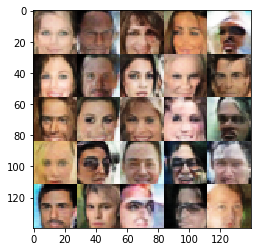

Epoch 8/10... Discriminator Loss: 0.211837... Generator Loss: 3.332859
Epoch 8/10... Discriminator Loss: 0.121018... Generator Loss: 3.414259
Epoch 8/10... Discriminator Loss: 0.484389... Generator Loss: 1.670125
Epoch 8/10... Discriminator Loss: 0.119753... Generator Loss: 3.198502
Epoch 8/10... Discriminator Loss: 0.271433... Generator Loss: 2.728480
Epoch 8/10... Discriminator Loss: 0.052281... Generator Loss: 6.246409
Epoch 8/10... Discriminator Loss: 0.193143... Generator Loss: 3.430387
Epoch 8/10... Discriminator Loss: 0.272811... Generator Loss: 2.584251
Epoch 8/10... Discriminator Loss: 0.063053... Generator Loss: 4.794726
Epoch 8/10... Discriminator Loss: 0.325240... Generator Loss: 2.286490


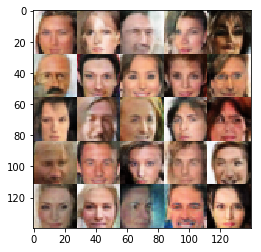

Epoch 8/10... Discriminator Loss: 0.723130... Generator Loss: 1.306661
Epoch 8/10... Discriminator Loss: 0.266169... Generator Loss: 9.524376
Epoch 8/10... Discriminator Loss: 0.013456... Generator Loss: 6.477724
Epoch 8/10... Discriminator Loss: 0.047728... Generator Loss: 7.278371
Epoch 8/10... Discriminator Loss: 0.014750... Generator Loss: 6.645841
Epoch 8/10... Discriminator Loss: 0.440522... Generator Loss: 2.052521
Epoch 8/10... Discriminator Loss: 0.449580... Generator Loss: 1.852797
Epoch 8/10... Discriminator Loss: 0.117888... Generator Loss: 3.728096
Epoch 8/10... Discriminator Loss: 0.030893... Generator Loss: 4.996406
Epoch 8/10... Discriminator Loss: 0.327431... Generator Loss: 1.990298


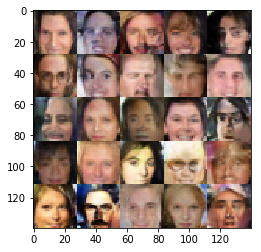

Epoch 8/10... Discriminator Loss: 0.082014... Generator Loss: 4.617654
Epoch 8/10... Discriminator Loss: 0.174214... Generator Loss: 2.573366
Epoch 8/10... Discriminator Loss: 0.019353... Generator Loss: 5.332977
Epoch 8/10... Discriminator Loss: 0.129589... Generator Loss: 3.214009
Epoch 8/10... Discriminator Loss: 0.032011... Generator Loss: 7.079391
Epoch 8/10... Discriminator Loss: 0.265749... Generator Loss: 2.437316
Epoch 8/10... Discriminator Loss: 0.521169... Generator Loss: 1.794088
Epoch 8/10... Discriminator Loss: 0.026164... Generator Loss: 4.827429
Epoch 8/10... Discriminator Loss: 0.025073... Generator Loss: 6.821319
Epoch 8/10... Discriminator Loss: 0.048226... Generator Loss: 4.665745


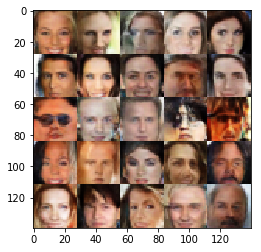

Epoch 8/10... Discriminator Loss: 0.104883... Generator Loss: 3.944535
Epoch 8/10... Discriminator Loss: 0.043831... Generator Loss: 4.084935
Epoch 8/10... Discriminator Loss: 0.011805... Generator Loss: 8.322855
Epoch 8/10... Discriminator Loss: 0.083504... Generator Loss: 3.370797
Epoch 8/10... Discriminator Loss: 0.064793... Generator Loss: 3.993010
Epoch 8/10... Discriminator Loss: 0.100658... Generator Loss: 3.505866
Epoch 8/10... Discriminator Loss: 0.008623... Generator Loss: 6.585751
Epoch 8/10... Discriminator Loss: 0.141806... Generator Loss: 3.033090
Epoch 8/10... Discriminator Loss: 0.025507... Generator Loss: 5.813554
Epoch 8/10... Discriminator Loss: 0.074945... Generator Loss: 3.697352


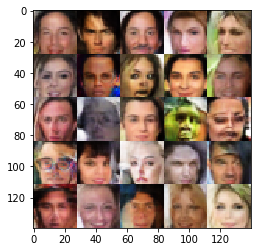

Epoch 8/10... Discriminator Loss: 0.028814... Generator Loss: 4.868573
Epoch 8/10... Discriminator Loss: 0.190420... Generator Loss: 8.847605
Epoch 8/10... Discriminator Loss: 0.556079... Generator Loss: 3.263111
Epoch 8/10... Discriminator Loss: 1.947843... Generator Loss: 0.646526
Epoch 8/10... Discriminator Loss: 0.117856... Generator Loss: 4.656071
Epoch 8/10... Discriminator Loss: 3.546565... Generator Loss: 10.097093
Epoch 8/10... Discriminator Loss: 0.682016... Generator Loss: 3.206087
Epoch 8/10... Discriminator Loss: 0.638753... Generator Loss: 2.029958
Epoch 8/10... Discriminator Loss: 1.222747... Generator Loss: 0.965706
Epoch 8/10... Discriminator Loss: 0.491151... Generator Loss: 2.153774


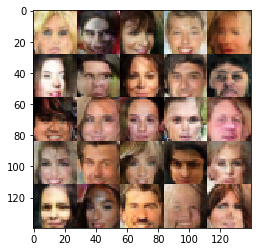

Epoch 8/10... Discriminator Loss: 1.177445... Generator Loss: 1.360248
Epoch 8/10... Discriminator Loss: 1.986046... Generator Loss: 0.833484
Epoch 8/10... Discriminator Loss: 0.233960... Generator Loss: 3.402062
Epoch 8/10... Discriminator Loss: 0.056596... Generator Loss: 5.547198
Epoch 8/10... Discriminator Loss: 0.183371... Generator Loss: 4.081455
Epoch 8/10... Discriminator Loss: 0.468776... Generator Loss: 1.590157
Epoch 8/10... Discriminator Loss: 0.179992... Generator Loss: 2.797548
Epoch 8/10... Discriminator Loss: 0.317710... Generator Loss: 2.057220
Epoch 8/10... Discriminator Loss: 0.237093... Generator Loss: 2.805248
Epoch 8/10... Discriminator Loss: 0.248758... Generator Loss: 2.225388


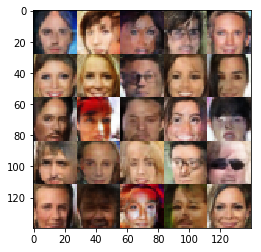

Epoch 8/10... Discriminator Loss: 0.156855... Generator Loss: 3.596655
Epoch 8/10... Discriminator Loss: 0.198181... Generator Loss: 2.938024
Epoch 8/10... Discriminator Loss: 0.170775... Generator Loss: 7.564855
Epoch 8/10... Discriminator Loss: 0.359079... Generator Loss: 2.258125
Epoch 8/10... Discriminator Loss: 1.484479... Generator Loss: 0.728800
Epoch 8/10... Discriminator Loss: 0.190385... Generator Loss: 4.129561
Epoch 8/10... Discriminator Loss: 0.333006... Generator Loss: 3.321320
Epoch 8/10... Discriminator Loss: 0.046523... Generator Loss: 4.669641
Epoch 8/10... Discriminator Loss: 0.148947... Generator Loss: 3.502700
Epoch 8/10... Discriminator Loss: 0.211334... Generator Loss: 2.999948


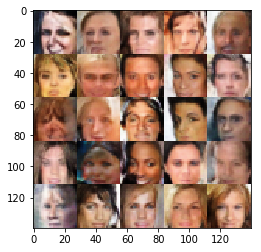

Epoch 8/10... Discriminator Loss: 0.146858... Generator Loss: 3.303713
Epoch 8/10... Discriminator Loss: 0.206043... Generator Loss: 2.682610
Epoch 8/10... Discriminator Loss: 0.134553... Generator Loss: 3.083741
Epoch 8/10... Discriminator Loss: 0.103797... Generator Loss: 4.734636
Epoch 8/10... Discriminator Loss: 0.230425... Generator Loss: 2.794578
Epoch 8/10... Discriminator Loss: 0.103015... Generator Loss: 3.139364
Epoch 8/10... Discriminator Loss: 0.093905... Generator Loss: 4.087213
Epoch 8/10... Discriminator Loss: 0.048252... Generator Loss: 4.473606
Epoch 8/10... Discriminator Loss: 0.082909... Generator Loss: 4.312949
Epoch 8/10... Discriminator Loss: 0.014315... Generator Loss: 6.255874


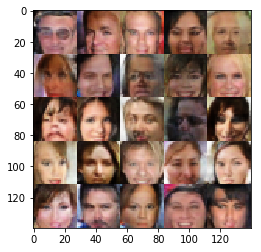

Epoch 8/10... Discriminator Loss: 0.603353... Generator Loss: 1.586027
Epoch 8/10... Discriminator Loss: 0.046077... Generator Loss: 4.753901
Epoch 8/10... Discriminator Loss: 0.062338... Generator Loss: 6.029421
Epoch 8/10... Discriminator Loss: 0.200471... Generator Loss: 4.028750
Epoch 8/10... Discriminator Loss: 0.081434... Generator Loss: 4.369627
Epoch 8/10... Discriminator Loss: 0.129653... Generator Loss: 3.545949
Epoch 8/10... Discriminator Loss: 0.013081... Generator Loss: 6.824157
Epoch 8/10... Discriminator Loss: 0.162181... Generator Loss: 5.632922
Epoch 8/10... Discriminator Loss: 0.232899... Generator Loss: 2.911593
Epoch 8/10... Discriminator Loss: 0.118961... Generator Loss: 3.493576


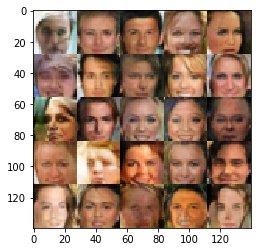

Epoch 8/10... Discriminator Loss: 0.014725... Generator Loss: 6.399801
Epoch 8/10... Discriminator Loss: 1.445091... Generator Loss: 0.610445
Epoch 8/10... Discriminator Loss: 0.022120... Generator Loss: 6.746093
Epoch 8/10... Discriminator Loss: 0.317932... Generator Loss: 2.197311
Epoch 8/10... Discriminator Loss: 0.708033... Generator Loss: 1.445802
Epoch 8/10... Discriminator Loss: 0.100076... Generator Loss: 3.874068
Epoch 8/10... Discriminator Loss: 0.083706... Generator Loss: 4.058373
Epoch 8/10... Discriminator Loss: 0.019867... Generator Loss: 5.955616
Epoch 8/10... Discriminator Loss: 0.061193... Generator Loss: 3.971623
Epoch 8/10... Discriminator Loss: 0.208508... Generator Loss: 2.420426


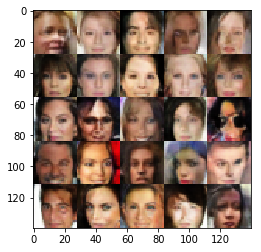

Epoch 9/10... Discriminator Loss: 0.039344... Generator Loss: 6.138231
Epoch 9/10... Discriminator Loss: 0.063122... Generator Loss: 4.050886
Epoch 9/10... Discriminator Loss: 0.128591... Generator Loss: 3.425727
Epoch 9/10... Discriminator Loss: 0.035234... Generator Loss: 4.947215
Epoch 9/10... Discriminator Loss: 0.412565... Generator Loss: 2.337906
Epoch 9/10... Discriminator Loss: 1.558723... Generator Loss: 0.782516
Epoch 9/10... Discriminator Loss: 0.434512... Generator Loss: 1.934532
Epoch 9/10... Discriminator Loss: 0.154902... Generator Loss: 3.349242
Epoch 9/10... Discriminator Loss: 0.055084... Generator Loss: 4.131377
Epoch 9/10... Discriminator Loss: 0.276865... Generator Loss: 2.597436


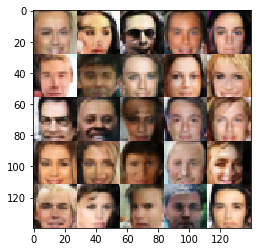

Epoch 9/10... Discriminator Loss: 0.081729... Generator Loss: 4.340023
Epoch 9/10... Discriminator Loss: 0.116102... Generator Loss: 4.045115
Epoch 9/10... Discriminator Loss: 0.014081... Generator Loss: 5.398003
Epoch 9/10... Discriminator Loss: 0.013641... Generator Loss: 6.116961
Epoch 9/10... Discriminator Loss: 0.177745... Generator Loss: 3.251974
Epoch 9/10... Discriminator Loss: 0.044310... Generator Loss: 6.120584
Epoch 9/10... Discriminator Loss: 0.211183... Generator Loss: 2.465328
Epoch 9/10... Discriminator Loss: 0.172101... Generator Loss: 3.295038
Epoch 9/10... Discriminator Loss: 1.265866... Generator Loss: 0.638609
Epoch 9/10... Discriminator Loss: 0.064488... Generator Loss: 5.269874


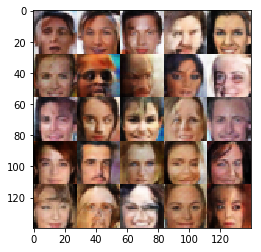

Epoch 9/10... Discriminator Loss: 0.513622... Generator Loss: 1.960657
Epoch 9/10... Discriminator Loss: 0.287736... Generator Loss: 3.140433
Epoch 9/10... Discriminator Loss: 0.214273... Generator Loss: 4.026654
Epoch 9/10... Discriminator Loss: 0.431052... Generator Loss: 6.717557
Epoch 9/10... Discriminator Loss: 0.429837... Generator Loss: 5.983358
Epoch 9/10... Discriminator Loss: 0.149631... Generator Loss: 4.198612
Epoch 9/10... Discriminator Loss: 0.520896... Generator Loss: 1.853546
Epoch 9/10... Discriminator Loss: 0.158722... Generator Loss: 3.866652
Epoch 9/10... Discriminator Loss: 0.072635... Generator Loss: 3.908846
Epoch 9/10... Discriminator Loss: 0.434416... Generator Loss: 5.714249


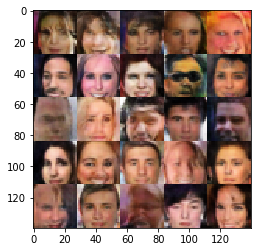

Epoch 9/10... Discriminator Loss: 0.472520... Generator Loss: 2.350466
Epoch 9/10... Discriminator Loss: 0.614445... Generator Loss: 1.732738
Epoch 9/10... Discriminator Loss: 0.135625... Generator Loss: 3.448749
Epoch 9/10... Discriminator Loss: 0.279268... Generator Loss: 2.276886
Epoch 9/10... Discriminator Loss: 0.207113... Generator Loss: 2.814346
Epoch 9/10... Discriminator Loss: 0.305742... Generator Loss: 2.316392
Epoch 9/10... Discriminator Loss: 0.235427... Generator Loss: 2.914008
Epoch 9/10... Discriminator Loss: 0.099505... Generator Loss: 3.724912
Epoch 9/10... Discriminator Loss: 0.964790... Generator Loss: 1.205538
Epoch 9/10... Discriminator Loss: 0.032862... Generator Loss: 5.499056


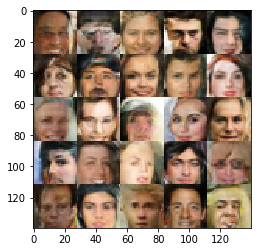

Epoch 9/10... Discriminator Loss: 1.115617... Generator Loss: 0.915261
Epoch 9/10... Discriminator Loss: 0.295269... Generator Loss: 2.187236
Epoch 9/10... Discriminator Loss: 0.170965... Generator Loss: 2.787946
Epoch 9/10... Discriminator Loss: 0.031448... Generator Loss: 8.353756
Epoch 9/10... Discriminator Loss: 0.262943... Generator Loss: 2.523391
Epoch 9/10... Discriminator Loss: 0.055664... Generator Loss: 5.285544
Epoch 9/10... Discriminator Loss: 0.027941... Generator Loss: 10.651243
Epoch 9/10... Discriminator Loss: 0.268482... Generator Loss: 3.386725
Epoch 9/10... Discriminator Loss: 0.330778... Generator Loss: 2.616102
Epoch 9/10... Discriminator Loss: 0.352437... Generator Loss: 8.016590


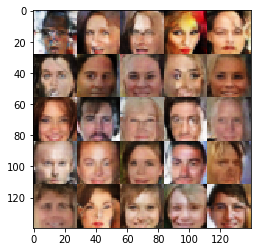

Epoch 9/10... Discriminator Loss: 2.510371... Generator Loss: 0.517773
Epoch 9/10... Discriminator Loss: 0.423314... Generator Loss: 2.231022
Epoch 9/10... Discriminator Loss: 0.478190... Generator Loss: 1.629654
Epoch 9/10... Discriminator Loss: 2.145279... Generator Loss: 0.469832
Epoch 9/10... Discriminator Loss: 0.340218... Generator Loss: 2.026290
Epoch 9/10... Discriminator Loss: 0.219281... Generator Loss: 2.545375
Epoch 9/10... Discriminator Loss: 0.179663... Generator Loss: 2.999262
Epoch 9/10... Discriminator Loss: 0.165770... Generator Loss: 3.571013
Epoch 9/10... Discriminator Loss: 0.113979... Generator Loss: 3.531238
Epoch 9/10... Discriminator Loss: 0.146389... Generator Loss: 3.027915


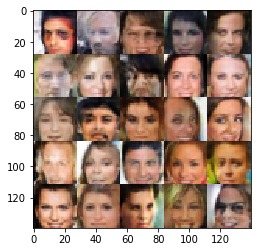

Epoch 9/10... Discriminator Loss: 0.256913... Generator Loss: 2.472983
Epoch 9/10... Discriminator Loss: 0.223016... Generator Loss: 2.533617
Epoch 9/10... Discriminator Loss: 0.408272... Generator Loss: 1.971515
Epoch 9/10... Discriminator Loss: 0.251256... Generator Loss: 2.309390
Epoch 9/10... Discriminator Loss: 0.212211... Generator Loss: 2.906397
Epoch 9/10... Discriminator Loss: 0.177415... Generator Loss: 2.755984
Epoch 9/10... Discriminator Loss: 0.132199... Generator Loss: 2.909535
Epoch 9/10... Discriminator Loss: 0.109849... Generator Loss: 2.999597
Epoch 9/10... Discriminator Loss: 0.047577... Generator Loss: 4.280006
Epoch 9/10... Discriminator Loss: 0.194452... Generator Loss: 2.439651


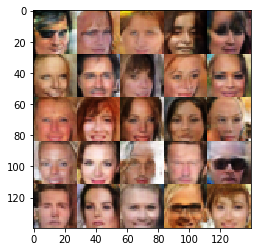

Epoch 9/10... Discriminator Loss: 0.708887... Generator Loss: 1.640875
Epoch 9/10... Discriminator Loss: 0.463415... Generator Loss: 1.753109
Epoch 9/10... Discriminator Loss: 0.008997... Generator Loss: 6.117881
Epoch 9/10... Discriminator Loss: 0.214456... Generator Loss: 2.635379
Epoch 9/10... Discriminator Loss: 0.041197... Generator Loss: 7.860929
Epoch 9/10... Discriminator Loss: 0.131574... Generator Loss: 3.079378
Epoch 9/10... Discriminator Loss: 0.068392... Generator Loss: 3.732213
Epoch 9/10... Discriminator Loss: 0.041632... Generator Loss: 4.690681
Epoch 9/10... Discriminator Loss: 0.029239... Generator Loss: 4.750803
Epoch 9/10... Discriminator Loss: 0.249760... Generator Loss: 9.514034


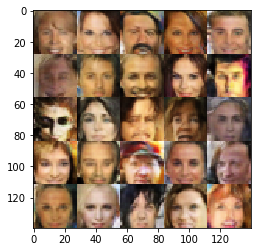

Epoch 9/10... Discriminator Loss: 0.023177... Generator Loss: 6.111752
Epoch 9/10... Discriminator Loss: 0.246176... Generator Loss: 2.564425
Epoch 9/10... Discriminator Loss: 0.237161... Generator Loss: 8.125485
Epoch 9/10... Discriminator Loss: 3.547820... Generator Loss: 9.855767
Epoch 9/10... Discriminator Loss: 0.271003... Generator Loss: 4.403866
Epoch 9/10... Discriminator Loss: 0.502187... Generator Loss: 6.324037
Epoch 9/10... Discriminator Loss: 0.281361... Generator Loss: 3.122377
Epoch 9/10... Discriminator Loss: 1.603129... Generator Loss: 0.967604
Epoch 9/10... Discriminator Loss: 0.837532... Generator Loss: 1.030154
Epoch 9/10... Discriminator Loss: 0.279477... Generator Loss: 2.635447


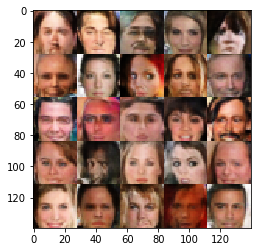

Epoch 9/10... Discriminator Loss: 0.050387... Generator Loss: 5.607691
Epoch 9/10... Discriminator Loss: 0.193295... Generator Loss: 3.122807
Epoch 9/10... Discriminator Loss: 0.258806... Generator Loss: 11.847563
Epoch 9/10... Discriminator Loss: 0.164928... Generator Loss: 2.939425
Epoch 9/10... Discriminator Loss: 0.061089... Generator Loss: 5.890100
Epoch 9/10... Discriminator Loss: 0.063147... Generator Loss: 4.277006
Epoch 9/10... Discriminator Loss: 0.165752... Generator Loss: 2.887012
Epoch 9/10... Discriminator Loss: 0.129533... Generator Loss: 3.362381
Epoch 9/10... Discriminator Loss: 0.117070... Generator Loss: 3.828486
Epoch 9/10... Discriminator Loss: 0.068940... Generator Loss: 5.900918


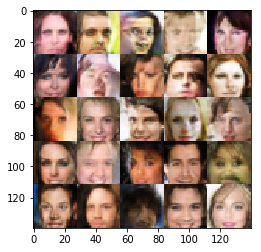

Epoch 9/10... Discriminator Loss: 0.031024... Generator Loss: 5.448600
Epoch 9/10... Discriminator Loss: 1.444565... Generator Loss: 0.740280
Epoch 9/10... Discriminator Loss: 0.013345... Generator Loss: 6.161549
Epoch 9/10... Discriminator Loss: 0.078272... Generator Loss: 3.779768
Epoch 9/10... Discriminator Loss: 0.089830... Generator Loss: 4.193827
Epoch 9/10... Discriminator Loss: 0.321302... Generator Loss: 2.203588
Epoch 9/10... Discriminator Loss: 0.263753... Generator Loss: 2.141355
Epoch 9/10... Discriminator Loss: 0.039753... Generator Loss: 7.148967
Epoch 9/10... Discriminator Loss: 0.035207... Generator Loss: 5.046414
Epoch 9/10... Discriminator Loss: 0.112941... Generator Loss: 5.624065


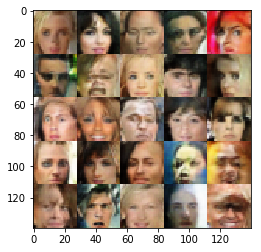

Epoch 9/10... Discriminator Loss: 0.030432... Generator Loss: 8.037310
Epoch 9/10... Discriminator Loss: 0.056937... Generator Loss: 4.382345
Epoch 9/10... Discriminator Loss: 1.728288... Generator Loss: 0.425982
Epoch 9/10... Discriminator Loss: 2.935745... Generator Loss: 0.293299
Epoch 9/10... Discriminator Loss: 0.547653... Generator Loss: 2.363314
Epoch 9/10... Discriminator Loss: 0.165735... Generator Loss: 3.709419
Epoch 9/10... Discriminator Loss: 0.153048... Generator Loss: 3.369256
Epoch 9/10... Discriminator Loss: 0.175979... Generator Loss: 3.395597
Epoch 9/10... Discriminator Loss: 0.014665... Generator Loss: 6.592526
Epoch 9/10... Discriminator Loss: 0.122852... Generator Loss: 3.356843


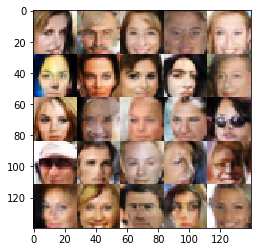

Epoch 9/10... Discriminator Loss: 0.541924... Generator Loss: 1.534306
Epoch 9/10... Discriminator Loss: 0.244529... Generator Loss: 2.714281
Epoch 9/10... Discriminator Loss: 0.173934... Generator Loss: 3.847277
Epoch 9/10... Discriminator Loss: 0.244774... Generator Loss: 2.734168
Epoch 9/10... Discriminator Loss: 0.096648... Generator Loss: 3.614303
Epoch 9/10... Discriminator Loss: 0.078984... Generator Loss: 4.380518
Epoch 9/10... Discriminator Loss: 0.074372... Generator Loss: 4.127141
Epoch 9/10... Discriminator Loss: 0.103881... Generator Loss: 3.398968
Epoch 9/10... Discriminator Loss: 0.190565... Generator Loss: 12.831892
Epoch 9/10... Discriminator Loss: 0.839909... Generator Loss: 1.245781


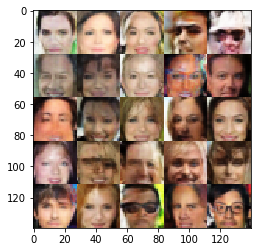

Epoch 9/10... Discriminator Loss: 0.066707... Generator Loss: 4.470627
Epoch 9/10... Discriminator Loss: 0.078425... Generator Loss: 4.264334
Epoch 9/10... Discriminator Loss: 0.124763... Generator Loss: 4.168903
Epoch 9/10... Discriminator Loss: 0.047650... Generator Loss: 4.599024
Epoch 9/10... Discriminator Loss: 0.364460... Generator Loss: 2.135970
Epoch 9/10... Discriminator Loss: 0.060687... Generator Loss: 4.227262
Epoch 9/10... Discriminator Loss: 0.378156... Generator Loss: 2.027158
Epoch 9/10... Discriminator Loss: 0.152864... Generator Loss: 4.426881
Epoch 9/10... Discriminator Loss: 0.016346... Generator Loss: 7.096309
Epoch 9/10... Discriminator Loss: 0.191292... Generator Loss: 2.965521


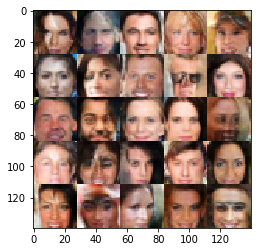

Epoch 9/10... Discriminator Loss: 2.585890... Generator Loss: 12.254414
Epoch 9/10... Discriminator Loss: 0.447153... Generator Loss: 2.552519
Epoch 9/10... Discriminator Loss: 0.253370... Generator Loss: 6.231674
Epoch 9/10... Discriminator Loss: 0.089854... Generator Loss: 4.278317
Epoch 9/10... Discriminator Loss: 0.618315... Generator Loss: 1.740310
Epoch 9/10... Discriminator Loss: 0.787198... Generator Loss: 1.518852
Epoch 9/10... Discriminator Loss: 0.030528... Generator Loss: 5.697300
Epoch 9/10... Discriminator Loss: 0.069351... Generator Loss: 4.386849
Epoch 9/10... Discriminator Loss: 0.365600... Generator Loss: 2.155221
Epoch 9/10... Discriminator Loss: 0.045900... Generator Loss: 4.202427


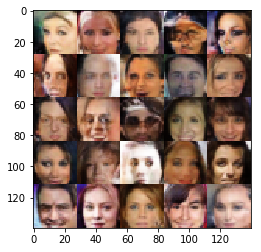

Epoch 9/10... Discriminator Loss: 0.059718... Generator Loss: 4.270958
Epoch 9/10... Discriminator Loss: 0.428726... Generator Loss: 2.260954
Epoch 9/10... Discriminator Loss: 0.814638... Generator Loss: 1.470525
Epoch 9/10... Discriminator Loss: 0.675838... Generator Loss: 1.428243
Epoch 9/10... Discriminator Loss: 0.013298... Generator Loss: 6.468242
Epoch 9/10... Discriminator Loss: 0.278423... Generator Loss: 2.229969
Epoch 9/10... Discriminator Loss: 0.110929... Generator Loss: 4.363101
Epoch 9/10... Discriminator Loss: 0.466603... Generator Loss: 1.906768
Epoch 9/10... Discriminator Loss: 0.377850... Generator Loss: 2.054023
Epoch 9/10... Discriminator Loss: 0.182826... Generator Loss: 2.901866


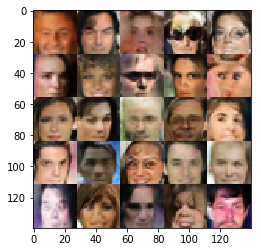

Epoch 9/10... Discriminator Loss: 0.381864... Generator Loss: 1.682447
Epoch 9/10... Discriminator Loss: 0.142324... Generator Loss: 3.468881
Epoch 9/10... Discriminator Loss: 0.368260... Generator Loss: 7.250714
Epoch 9/10... Discriminator Loss: 0.292162... Generator Loss: 2.956062
Epoch 9/10... Discriminator Loss: 0.141162... Generator Loss: 7.716864
Epoch 9/10... Discriminator Loss: 0.086231... Generator Loss: 3.405617
Epoch 9/10... Discriminator Loss: 0.170113... Generator Loss: 3.722216
Epoch 9/10... Discriminator Loss: 0.576416... Generator Loss: 1.674407
Epoch 9/10... Discriminator Loss: 0.125050... Generator Loss: 2.918094
Epoch 9/10... Discriminator Loss: 0.260240... Generator Loss: 5.705077


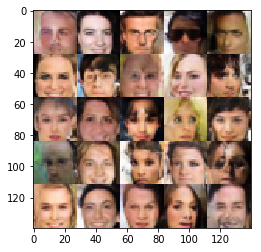

Epoch 9/10... Discriminator Loss: 0.151751... Generator Loss: 3.097915
Epoch 9/10... Discriminator Loss: 0.346559... Generator Loss: 2.314282
Epoch 9/10... Discriminator Loss: 0.914579... Generator Loss: 1.381116
Epoch 9/10... Discriminator Loss: 0.405678... Generator Loss: 2.393376
Epoch 9/10... Discriminator Loss: 0.068053... Generator Loss: 6.436943
Epoch 9/10... Discriminator Loss: 1.974921... Generator Loss: 0.453279
Epoch 9/10... Discriminator Loss: 0.076775... Generator Loss: 4.255552
Epoch 9/10... Discriminator Loss: 0.808887... Generator Loss: 1.257539
Epoch 9/10... Discriminator Loss: 0.072519... Generator Loss: 6.524987
Epoch 9/10... Discriminator Loss: 0.068797... Generator Loss: 3.854657


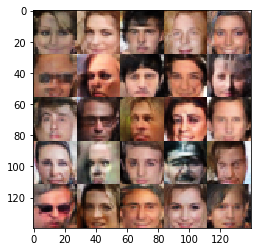

Epoch 9/10... Discriminator Loss: 0.233331... Generator Loss: 6.760715
Epoch 9/10... Discriminator Loss: 0.313253... Generator Loss: 8.165436
Epoch 9/10... Discriminator Loss: 0.415043... Generator Loss: 2.255365
Epoch 9/10... Discriminator Loss: 1.050510... Generator Loss: 0.979088
Epoch 9/10... Discriminator Loss: 0.525751... Generator Loss: 1.833455
Epoch 9/10... Discriminator Loss: 0.021181... Generator Loss: 5.908210
Epoch 9/10... Discriminator Loss: 0.195298... Generator Loss: 3.205679
Epoch 9/10... Discriminator Loss: 0.041535... Generator Loss: 4.666927
Epoch 9/10... Discriminator Loss: 0.144269... Generator Loss: 3.318259
Epoch 9/10... Discriminator Loss: 0.066470... Generator Loss: 4.219018


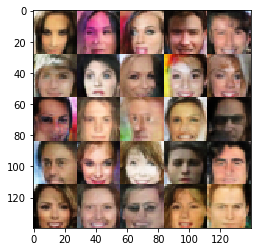

Epoch 9/10... Discriminator Loss: 0.423199... Generator Loss: 1.865849
Epoch 9/10... Discriminator Loss: 0.047447... Generator Loss: 4.936015
Epoch 9/10... Discriminator Loss: 0.289210... Generator Loss: 2.535384
Epoch 9/10... Discriminator Loss: 0.081747... Generator Loss: 3.843713
Epoch 9/10... Discriminator Loss: 0.108182... Generator Loss: 4.542851
Epoch 9/10... Discriminator Loss: 0.234384... Generator Loss: 2.908444
Epoch 9/10... Discriminator Loss: 1.356038... Generator Loss: 0.846461
Epoch 9/10... Discriminator Loss: 0.478808... Generator Loss: 1.683848
Epoch 9/10... Discriminator Loss: 0.251634... Generator Loss: 2.838500
Epoch 9/10... Discriminator Loss: 0.038427... Generator Loss: 4.591553


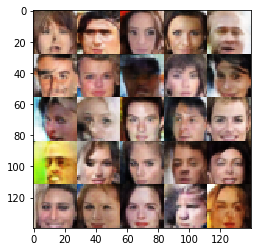

Epoch 9/10... Discriminator Loss: 0.560225... Generator Loss: 1.696134
Epoch 9/10... Discriminator Loss: 0.185388... Generator Loss: 2.687938
Epoch 9/10... Discriminator Loss: 0.293689... Generator Loss: 2.178742
Epoch 9/10... Discriminator Loss: 0.126020... Generator Loss: 3.393330
Epoch 9/10... Discriminator Loss: 0.097947... Generator Loss: 3.425188
Epoch 9/10... Discriminator Loss: 0.090293... Generator Loss: 3.796273
Epoch 9/10... Discriminator Loss: 0.038639... Generator Loss: 8.053036
Epoch 9/10... Discriminator Loss: 0.087687... Generator Loss: 3.857916
Epoch 9/10... Discriminator Loss: 0.068008... Generator Loss: 4.822116
Epoch 9/10... Discriminator Loss: 0.094221... Generator Loss: 3.596220


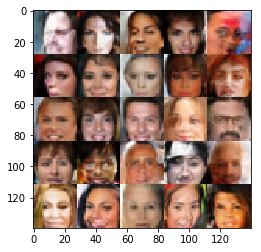

Epoch 9/10... Discriminator Loss: 0.185556... Generator Loss: 2.644051
Epoch 9/10... Discriminator Loss: 0.309604... Generator Loss: 2.148101
Epoch 9/10... Discriminator Loss: 0.132208... Generator Loss: 3.611217
Epoch 9/10... Discriminator Loss: 0.049556... Generator Loss: 5.152513
Epoch 9/10... Discriminator Loss: 0.094117... Generator Loss: 4.043939
Epoch 9/10... Discriminator Loss: 0.196957... Generator Loss: 3.130786
Epoch 9/10... Discriminator Loss: 1.882632... Generator Loss: 14.980856
Epoch 9/10... Discriminator Loss: 0.328017... Generator Loss: 2.170555
Epoch 9/10... Discriminator Loss: 0.114976... Generator Loss: 3.711654
Epoch 9/10... Discriminator Loss: 0.096210... Generator Loss: 3.515895


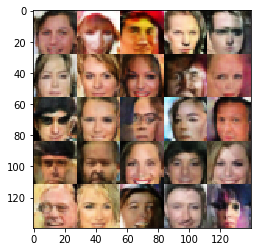

Epoch 9/10... Discriminator Loss: 0.023720... Generator Loss: 7.128397
Epoch 9/10... Discriminator Loss: 0.083710... Generator Loss: 5.075720
Epoch 9/10... Discriminator Loss: 2.464632... Generator Loss: 0.216253
Epoch 9/10... Discriminator Loss: 0.148452... Generator Loss: 3.359420
Epoch 9/10... Discriminator Loss: 2.252782... Generator Loss: 0.312805
Epoch 9/10... Discriminator Loss: 2.060797... Generator Loss: 9.466688
Epoch 9/10... Discriminator Loss: 0.573876... Generator Loss: 1.961510
Epoch 9/10... Discriminator Loss: 0.584563... Generator Loss: 1.639334
Epoch 9/10... Discriminator Loss: 1.782050... Generator Loss: 0.727313
Epoch 9/10... Discriminator Loss: 1.331473... Generator Loss: 1.046726


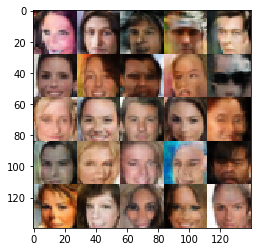

Epoch 9/10... Discriminator Loss: 0.277647... Generator Loss: 2.693523
Epoch 9/10... Discriminator Loss: 0.401997... Generator Loss: 2.127429
Epoch 9/10... Discriminator Loss: 0.150164... Generator Loss: 2.782472
Epoch 9/10... Discriminator Loss: 0.050381... Generator Loss: 4.433912
Epoch 9/10... Discriminator Loss: 0.042928... Generator Loss: 4.435678
Epoch 9/10... Discriminator Loss: 0.505939... Generator Loss: 1.747489
Epoch 9/10... Discriminator Loss: 0.076901... Generator Loss: 4.253528
Epoch 9/10... Discriminator Loss: 0.176106... Generator Loss: 2.830141
Epoch 9/10... Discriminator Loss: 0.036768... Generator Loss: 4.915567
Epoch 9/10... Discriminator Loss: 0.197029... Generator Loss: 4.725075


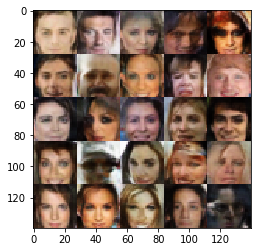

Epoch 9/10... Discriminator Loss: 0.185784... Generator Loss: 3.640525
Epoch 9/10... Discriminator Loss: 0.016720... Generator Loss: 7.007655
Epoch 9/10... Discriminator Loss: 0.605317... Generator Loss: 1.915646
Epoch 9/10... Discriminator Loss: 0.832908... Generator Loss: 1.398597
Epoch 9/10... Discriminator Loss: 0.711445... Generator Loss: 1.658643
Epoch 9/10... Discriminator Loss: 0.399136... Generator Loss: 2.163502
Epoch 9/10... Discriminator Loss: 0.746884... Generator Loss: 1.254411
Epoch 9/10... Discriminator Loss: 0.273037... Generator Loss: 2.726597
Epoch 9/10... Discriminator Loss: 0.314850... Generator Loss: 2.306615
Epoch 9/10... Discriminator Loss: 0.164629... Generator Loss: 3.147795


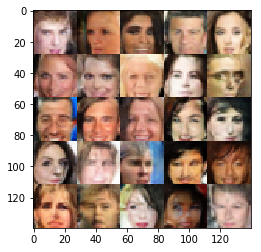

Epoch 9/10... Discriminator Loss: 0.089955... Generator Loss: 4.340027
Epoch 9/10... Discriminator Loss: 0.420145... Generator Loss: 1.949198
Epoch 9/10... Discriminator Loss: 0.610709... Generator Loss: 1.522178
Epoch 9/10... Discriminator Loss: 0.073668... Generator Loss: 4.017575
Epoch 9/10... Discriminator Loss: 0.153337... Generator Loss: 3.601366
Epoch 9/10... Discriminator Loss: 0.093326... Generator Loss: 3.903147
Epoch 9/10... Discriminator Loss: 0.072854... Generator Loss: 3.875785
Epoch 9/10... Discriminator Loss: 0.018255... Generator Loss: 5.977396
Epoch 9/10... Discriminator Loss: 0.262469... Generator Loss: 2.134113
Epoch 9/10... Discriminator Loss: 0.019703... Generator Loss: 5.992858


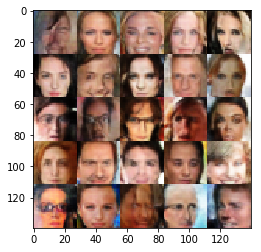

Epoch 9/10... Discriminator Loss: 0.220547... Generator Loss: 2.569836
Epoch 9/10... Discriminator Loss: 0.025487... Generator Loss: 6.427232
Epoch 9/10... Discriminator Loss: 0.164933... Generator Loss: 3.446518
Epoch 9/10... Discriminator Loss: 0.108080... Generator Loss: 3.507040
Epoch 9/10... Discriminator Loss: 0.239956... Generator Loss: 2.491366
Epoch 9/10... Discriminator Loss: 0.192919... Generator Loss: 2.830908
Epoch 9/10... Discriminator Loss: 0.251339... Generator Loss: 2.319936
Epoch 9/10... Discriminator Loss: 0.067085... Generator Loss: 4.018411
Epoch 9/10... Discriminator Loss: 0.288622... Generator Loss: 2.482764
Epoch 9/10... Discriminator Loss: 0.312389... Generator Loss: 2.571665


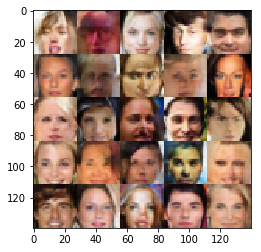

Epoch 9/10... Discriminator Loss: 0.036841... Generator Loss: 5.046439
Epoch 9/10... Discriminator Loss: 0.138938... Generator Loss: 3.143447
Epoch 9/10... Discriminator Loss: 0.135840... Generator Loss: 2.689514
Epoch 9/10... Discriminator Loss: 0.643699... Generator Loss: 1.738815
Epoch 9/10... Discriminator Loss: 0.340807... Generator Loss: 2.203587
Epoch 9/10... Discriminator Loss: 0.309135... Generator Loss: 2.274911
Epoch 9/10... Discriminator Loss: 0.527977... Generator Loss: 1.727207
Epoch 9/10... Discriminator Loss: 0.311689... Generator Loss: 2.636612
Epoch 9/10... Discriminator Loss: 0.023816... Generator Loss: 7.353071
Epoch 9/10... Discriminator Loss: 0.312538... Generator Loss: 2.327294


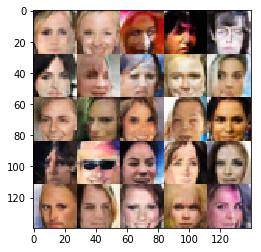

Epoch 9/10... Discriminator Loss: 0.077158... Generator Loss: 4.719535
Epoch 9/10... Discriminator Loss: 0.063028... Generator Loss: 4.612963
Epoch 9/10... Discriminator Loss: 0.030388... Generator Loss: 4.816870
Epoch 9/10... Discriminator Loss: 1.392385... Generator Loss: 12.214262
Epoch 9/10... Discriminator Loss: 0.133639... Generator Loss: 3.767389
Epoch 9/10... Discriminator Loss: 1.007590... Generator Loss: 1.509744
Epoch 9/10... Discriminator Loss: 1.472447... Generator Loss: 0.784419
Epoch 9/10... Discriminator Loss: 2.296795... Generator Loss: 0.588222
Epoch 9/10... Discriminator Loss: 2.084591... Generator Loss: 0.905807
Epoch 9/10... Discriminator Loss: 0.214717... Generator Loss: 3.603303


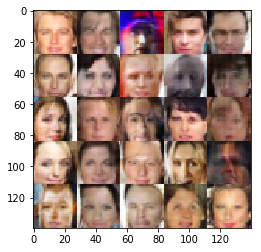

Epoch 9/10... Discriminator Loss: 0.185505... Generator Loss: 3.308345
Epoch 9/10... Discriminator Loss: 0.055227... Generator Loss: 4.578990
Epoch 9/10... Discriminator Loss: 1.650158... Generator Loss: 0.952120
Epoch 9/10... Discriminator Loss: 0.265172... Generator Loss: 2.563966
Epoch 9/10... Discriminator Loss: 0.609919... Generator Loss: 2.255994
Epoch 9/10... Discriminator Loss: 0.043910... Generator Loss: 7.943482
Epoch 9/10... Discriminator Loss: 0.418670... Generator Loss: 2.209252
Epoch 9/10... Discriminator Loss: 0.273639... Generator Loss: 2.821218
Epoch 9/10... Discriminator Loss: 0.151536... Generator Loss: 3.360257
Epoch 9/10... Discriminator Loss: 0.115148... Generator Loss: 4.028928


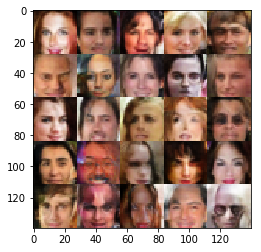

Epoch 9/10... Discriminator Loss: 0.031586... Generator Loss: 8.386765
Epoch 9/10... Discriminator Loss: 1.134807... Generator Loss: 0.962333
Epoch 9/10... Discriminator Loss: 0.398914... Generator Loss: 2.203843
Epoch 9/10... Discriminator Loss: 0.358309... Generator Loss: 2.171218
Epoch 9/10... Discriminator Loss: 0.227635... Generator Loss: 2.676799
Epoch 9/10... Discriminator Loss: 0.179875... Generator Loss: 3.232049
Epoch 9/10... Discriminator Loss: 0.119068... Generator Loss: 3.553499
Epoch 9/10... Discriminator Loss: 0.234406... Generator Loss: 2.846756
Epoch 9/10... Discriminator Loss: 0.520838... Generator Loss: 1.583632
Epoch 9/10... Discriminator Loss: 0.026862... Generator Loss: 5.512865


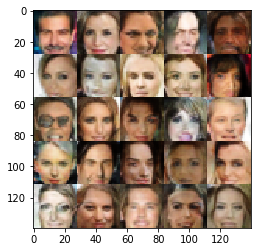

Epoch 9/10... Discriminator Loss: 0.486734... Generator Loss: 1.719870
Epoch 9/10... Discriminator Loss: 0.012332... Generator Loss: 6.658387
Epoch 9/10... Discriminator Loss: 0.024622... Generator Loss: 6.253875
Epoch 9/10... Discriminator Loss: 0.168123... Generator Loss: 3.325718
Epoch 9/10... Discriminator Loss: 0.124558... Generator Loss: 3.387721
Epoch 9/10... Discriminator Loss: 0.545025... Generator Loss: 1.806268
Epoch 9/10... Discriminator Loss: 0.307660... Generator Loss: 2.580918
Epoch 9/10... Discriminator Loss: 0.365412... Generator Loss: 1.787221
Epoch 9/10... Discriminator Loss: 0.171137... Generator Loss: 3.271645
Epoch 9/10... Discriminator Loss: 1.368229... Generator Loss: 0.778967


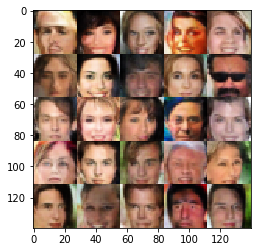

Epoch 9/10... Discriminator Loss: 0.068755... Generator Loss: 4.705060
Epoch 9/10... Discriminator Loss: 0.040838... Generator Loss: 5.736136
Epoch 9/10... Discriminator Loss: 0.014293... Generator Loss: 5.626840
Epoch 9/10... Discriminator Loss: 0.027866... Generator Loss: 5.311991
Epoch 9/10... Discriminator Loss: 0.210448... Generator Loss: 2.581327
Epoch 9/10... Discriminator Loss: 0.102045... Generator Loss: 3.885133
Epoch 9/10... Discriminator Loss: 0.368892... Generator Loss: 2.098727
Epoch 9/10... Discriminator Loss: 0.072673... Generator Loss: 3.781064
Epoch 9/10... Discriminator Loss: 0.036508... Generator Loss: 7.111972
Epoch 9/10... Discriminator Loss: 0.735466... Generator Loss: 1.572009


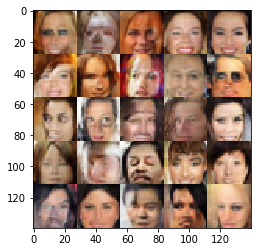

Epoch 9/10... Discriminator Loss: 0.120800... Generator Loss: 3.528508
Epoch 9/10... Discriminator Loss: 0.043500... Generator Loss: 5.097340
Epoch 9/10... Discriminator Loss: 0.067552... Generator Loss: 4.302719
Epoch 9/10... Discriminator Loss: 0.056780... Generator Loss: 4.129095
Epoch 9/10... Discriminator Loss: 0.048207... Generator Loss: 4.659907
Epoch 9/10... Discriminator Loss: 0.029263... Generator Loss: 6.081624
Epoch 9/10... Discriminator Loss: 0.459091... Generator Loss: 1.420014
Epoch 9/10... Discriminator Loss: 0.042468... Generator Loss: 6.175052
Epoch 9/10... Discriminator Loss: 0.061287... Generator Loss: 4.324031
Epoch 9/10... Discriminator Loss: 0.792672... Generator Loss: 1.418042


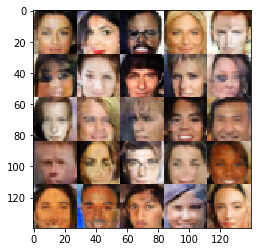

Epoch 9/10... Discriminator Loss: 0.878817... Generator Loss: 1.343553
Epoch 9/10... Discriminator Loss: 0.259894... Generator Loss: 2.514652
Epoch 9/10... Discriminator Loss: 0.111170... Generator Loss: 3.231351
Epoch 9/10... Discriminator Loss: 0.093452... Generator Loss: 3.378255
Epoch 9/10... Discriminator Loss: 0.383209... Generator Loss: 2.020614
Epoch 9/10... Discriminator Loss: 0.032095... Generator Loss: 5.313317
Epoch 9/10... Discriminator Loss: 0.121898... Generator Loss: 4.431573
Epoch 9/10... Discriminator Loss: 0.027509... Generator Loss: 6.813319
Epoch 9/10... Discriminator Loss: 0.676769... Generator Loss: 1.850208
Epoch 9/10... Discriminator Loss: 0.483995... Generator Loss: 2.408315


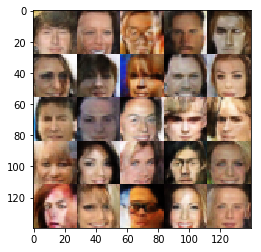

Epoch 9/10... Discriminator Loss: 0.203742... Generator Loss: 2.838419
Epoch 9/10... Discriminator Loss: 0.015988... Generator Loss: 8.283060
Epoch 9/10... Discriminator Loss: 0.256933... Generator Loss: 2.925570
Epoch 9/10... Discriminator Loss: 2.310712... Generator Loss: 17.356773
Epoch 9/10... Discriminator Loss: 1.531601... Generator Loss: 5.264427
Epoch 9/10... Discriminator Loss: 1.253791... Generator Loss: 2.034346
Epoch 9/10... Discriminator Loss: 1.740720... Generator Loss: 8.839542
Epoch 9/10... Discriminator Loss: 2.410222... Generator Loss: 0.807907
Epoch 9/10... Discriminator Loss: 1.149090... Generator Loss: 3.853060
Epoch 9/10... Discriminator Loss: 0.482239... Generator Loss: 4.224434


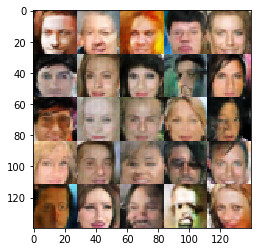

Epoch 9/10... Discriminator Loss: 0.743689... Generator Loss: 1.623173
Epoch 9/10... Discriminator Loss: 0.357663... Generator Loss: 2.933951
Epoch 9/10... Discriminator Loss: 0.687858... Generator Loss: 1.657008
Epoch 9/10... Discriminator Loss: 0.375905... Generator Loss: 1.842234
Epoch 9/10... Discriminator Loss: 0.469083... Generator Loss: 1.860367
Epoch 9/10... Discriminator Loss: 0.104597... Generator Loss: 3.881844
Epoch 9/10... Discriminator Loss: 0.257303... Generator Loss: 5.138484
Epoch 9/10... Discriminator Loss: 0.941471... Generator Loss: 1.247054
Epoch 9/10... Discriminator Loss: 0.214288... Generator Loss: 2.753365
Epoch 9/10... Discriminator Loss: 0.077070... Generator Loss: 4.150281


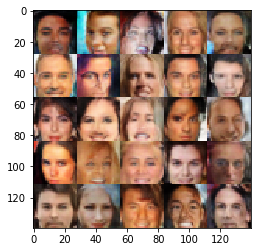

Epoch 9/10... Discriminator Loss: 0.312278... Generator Loss: 9.923392
Epoch 9/10... Discriminator Loss: 0.266637... Generator Loss: 2.361953
Epoch 9/10... Discriminator Loss: 0.020592... Generator Loss: 10.819759
Epoch 9/10... Discriminator Loss: 0.648822... Generator Loss: 1.497064
Epoch 9/10... Discriminator Loss: 0.177229... Generator Loss: 3.149722
Epoch 9/10... Discriminator Loss: 2.000591... Generator Loss: 0.559758
Epoch 9/10... Discriminator Loss: 0.191081... Generator Loss: 3.111102
Epoch 9/10... Discriminator Loss: 0.074585... Generator Loss: 3.689086
Epoch 9/10... Discriminator Loss: 0.146900... Generator Loss: 7.487856
Epoch 9/10... Discriminator Loss: 0.057954... Generator Loss: 3.972894


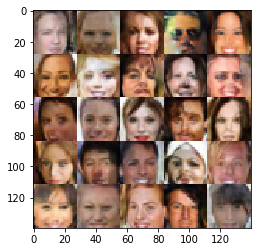

Epoch 9/10... Discriminator Loss: 0.138157... Generator Loss: 3.277342
Epoch 9/10... Discriminator Loss: 0.047494... Generator Loss: 4.835453
Epoch 9/10... Discriminator Loss: 0.061320... Generator Loss: 4.199597
Epoch 9/10... Discriminator Loss: 0.162324... Generator Loss: 2.981669
Epoch 9/10... Discriminator Loss: 0.215932... Generator Loss: 3.285668
Epoch 9/10... Discriminator Loss: 0.385982... Generator Loss: 3.309721
Epoch 9/10... Discriminator Loss: 1.565840... Generator Loss: 0.741666
Epoch 9/10... Discriminator Loss: 0.037692... Generator Loss: 4.951262
Epoch 9/10... Discriminator Loss: 0.248646... Generator Loss: 2.875432
Epoch 9/10... Discriminator Loss: 0.015276... Generator Loss: 5.893529


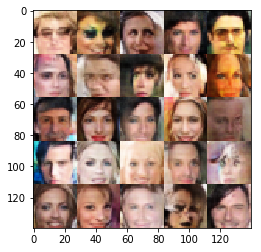

Epoch 9/10... Discriminator Loss: 0.142226... Generator Loss: 3.190746
Epoch 9/10... Discriminator Loss: 0.485942... Generator Loss: 2.248634
Epoch 9/10... Discriminator Loss: 1.300621... Generator Loss: 0.763861
Epoch 9/10... Discriminator Loss: 0.275118... Generator Loss: 2.583338
Epoch 9/10... Discriminator Loss: 0.539793... Generator Loss: 1.420002
Epoch 9/10... Discriminator Loss: 0.684368... Generator Loss: 1.338879
Epoch 9/10... Discriminator Loss: 0.104241... Generator Loss: 4.206693
Epoch 9/10... Discriminator Loss: 0.012964... Generator Loss: 6.610301
Epoch 9/10... Discriminator Loss: 0.076622... Generator Loss: 3.897194
Epoch 9/10... Discriminator Loss: 0.357504... Generator Loss: 2.478992


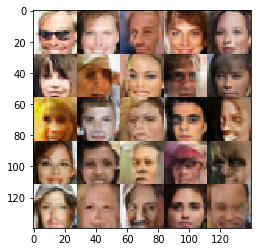

Epoch 9/10... Discriminator Loss: 0.080078... Generator Loss: 3.604585
Epoch 9/10... Discriminator Loss: 0.030008... Generator Loss: 5.559872
Epoch 9/10... Discriminator Loss: 0.092803... Generator Loss: 3.731834
Epoch 9/10... Discriminator Loss: 0.244160... Generator Loss: 2.430350
Epoch 9/10... Discriminator Loss: 0.089590... Generator Loss: 4.597236
Epoch 10/10... Discriminator Loss: 0.471927... Generator Loss: 1.736906
Epoch 10/10... Discriminator Loss: 0.043214... Generator Loss: 4.431658
Epoch 10/10... Discriminator Loss: 0.113380... Generator Loss: 3.664232
Epoch 10/10... Discriminator Loss: 0.011990... Generator Loss: 6.305660
Epoch 10/10... Discriminator Loss: 0.005526... Generator Loss: 6.547952


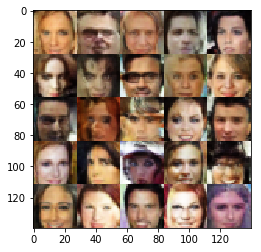

Epoch 10/10... Discriminator Loss: 0.043414... Generator Loss: 4.167680
Epoch 10/10... Discriminator Loss: 0.191959... Generator Loss: 2.562005
Epoch 10/10... Discriminator Loss: 0.096410... Generator Loss: 4.700313
Epoch 10/10... Discriminator Loss: 0.135747... Generator Loss: 3.192148
Epoch 10/10... Discriminator Loss: 0.587676... Generator Loss: 1.540461
Epoch 10/10... Discriminator Loss: 0.272281... Generator Loss: 2.624772
Epoch 10/10... Discriminator Loss: 0.433667... Generator Loss: 2.173603
Epoch 10/10... Discriminator Loss: 0.114994... Generator Loss: 3.715000
Epoch 10/10... Discriminator Loss: 0.074455... Generator Loss: 4.040205
Epoch 10/10... Discriminator Loss: 0.030864... Generator Loss: 5.733614


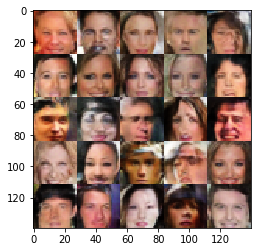

Epoch 10/10... Discriminator Loss: 0.029466... Generator Loss: 5.293503
Epoch 10/10... Discriminator Loss: 0.044308... Generator Loss: 5.115806
Epoch 10/10... Discriminator Loss: 0.099149... Generator Loss: 3.981329
Epoch 10/10... Discriminator Loss: 0.029260... Generator Loss: 5.675150
Epoch 10/10... Discriminator Loss: 0.012386... Generator Loss: 5.490044
Epoch 10/10... Discriminator Loss: 0.018307... Generator Loss: 5.975738
Epoch 10/10... Discriminator Loss: 0.217640... Generator Loss: 2.555489
Epoch 10/10... Discriminator Loss: 0.101273... Generator Loss: 3.062569
Epoch 10/10... Discriminator Loss: 0.031502... Generator Loss: 4.885110
Epoch 10/10... Discriminator Loss: 0.038411... Generator Loss: 5.402678


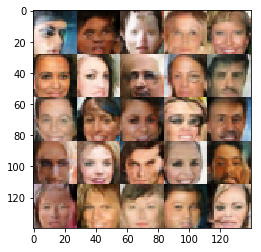

Epoch 10/10... Discriminator Loss: 0.008212... Generator Loss: 6.539857
Epoch 10/10... Discriminator Loss: 0.076794... Generator Loss: 3.863423
Epoch 10/10... Discriminator Loss: 0.021336... Generator Loss: 5.576449
Epoch 10/10... Discriminator Loss: 0.062431... Generator Loss: 4.179465
Epoch 10/10... Discriminator Loss: 0.073547... Generator Loss: 3.903357
Epoch 10/10... Discriminator Loss: 2.682449... Generator Loss: 0.376517
Epoch 10/10... Discriminator Loss: 1.165699... Generator Loss: 1.790838
Epoch 10/10... Discriminator Loss: 1.202355... Generator Loss: 0.965683
Epoch 10/10... Discriminator Loss: 0.356636... Generator Loss: 2.082379
Epoch 10/10... Discriminator Loss: 0.053958... Generator Loss: 4.825984


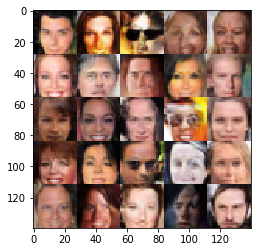

Epoch 10/10... Discriminator Loss: 0.341872... Generator Loss: 2.113363
Epoch 10/10... Discriminator Loss: 0.237383... Generator Loss: 2.637564
Epoch 10/10... Discriminator Loss: 0.002040... Generator Loss: 9.245127
Epoch 10/10... Discriminator Loss: 0.012189... Generator Loss: 6.754590
Epoch 10/10... Discriminator Loss: 0.518862... Generator Loss: 2.094561
Epoch 10/10... Discriminator Loss: 0.667175... Generator Loss: 1.507208
Epoch 10/10... Discriminator Loss: 0.360732... Generator Loss: 2.146919
Epoch 10/10... Discriminator Loss: 0.345297... Generator Loss: 1.988045
Epoch 10/10... Discriminator Loss: 0.049564... Generator Loss: 4.500322
Epoch 10/10... Discriminator Loss: 0.396172... Generator Loss: 2.276971


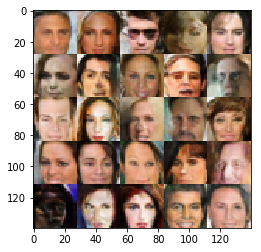

Epoch 10/10... Discriminator Loss: 0.033462... Generator Loss: 4.965166
Epoch 10/10... Discriminator Loss: 8.500305... Generator Loss: 0.014389
Epoch 10/10... Discriminator Loss: 1.362899... Generator Loss: 8.289417
Epoch 10/10... Discriminator Loss: 0.466206... Generator Loss: 2.154691
Epoch 10/10... Discriminator Loss: 2.623567... Generator Loss: 0.300368
Epoch 10/10... Discriminator Loss: 0.464246... Generator Loss: 2.865458
Epoch 10/10... Discriminator Loss: 0.049389... Generator Loss: 5.493504
Epoch 10/10... Discriminator Loss: 1.010840... Generator Loss: 1.308937
Epoch 10/10... Discriminator Loss: 0.114580... Generator Loss: 3.726925
Epoch 10/10... Discriminator Loss: 0.184462... Generator Loss: 3.371790


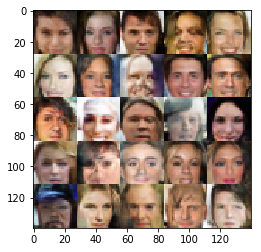

Epoch 10/10... Discriminator Loss: 0.313225... Generator Loss: 2.711310
Epoch 10/10... Discriminator Loss: 0.071417... Generator Loss: 4.344086
Epoch 10/10... Discriminator Loss: 0.903175... Generator Loss: 1.096058
Epoch 10/10... Discriminator Loss: 0.404001... Generator Loss: 2.436638
Epoch 10/10... Discriminator Loss: 0.026649... Generator Loss: 6.669799
Epoch 10/10... Discriminator Loss: 0.062654... Generator Loss: 5.735441
Epoch 10/10... Discriminator Loss: 0.501667... Generator Loss: 2.112572
Epoch 10/10... Discriminator Loss: 0.052106... Generator Loss: 4.960847
Epoch 10/10... Discriminator Loss: 0.191876... Generator Loss: 2.821585
Epoch 10/10... Discriminator Loss: 1.306360... Generator Loss: 1.224144


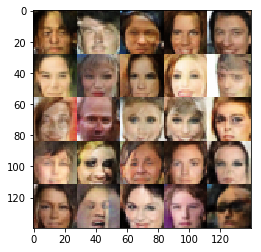

Epoch 10/10... Discriminator Loss: 1.141909... Generator Loss: 1.017686
Epoch 10/10... Discriminator Loss: 0.522507... Generator Loss: 2.078391
Epoch 10/10... Discriminator Loss: 0.167366... Generator Loss: 2.781123
Epoch 10/10... Discriminator Loss: 0.141880... Generator Loss: 2.916313
Epoch 10/10... Discriminator Loss: 1.399255... Generator Loss: 0.971754
Epoch 10/10... Discriminator Loss: 0.036954... Generator Loss: 5.018646
Epoch 10/10... Discriminator Loss: 0.059602... Generator Loss: 4.445110
Epoch 10/10... Discriminator Loss: 0.015958... Generator Loss: 6.300949
Epoch 10/10... Discriminator Loss: 0.141376... Generator Loss: 3.597068
Epoch 10/10... Discriminator Loss: 0.221062... Generator Loss: 2.728446


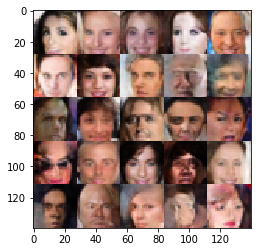

Epoch 10/10... Discriminator Loss: 0.443852... Generator Loss: 1.777568
Epoch 10/10... Discriminator Loss: 0.380935... Generator Loss: 2.015034
Epoch 10/10... Discriminator Loss: 0.178455... Generator Loss: 2.731637
Epoch 10/10... Discriminator Loss: 0.040678... Generator Loss: 4.832997
Epoch 10/10... Discriminator Loss: 0.448101... Generator Loss: 1.836524
Epoch 10/10... Discriminator Loss: 0.079610... Generator Loss: 3.961124
Epoch 10/10... Discriminator Loss: 0.072782... Generator Loss: 5.270203
Epoch 10/10... Discriminator Loss: 0.197669... Generator Loss: 2.506801
Epoch 10/10... Discriminator Loss: 0.061329... Generator Loss: 4.282428
Epoch 10/10... Discriminator Loss: 0.053423... Generator Loss: 4.673811


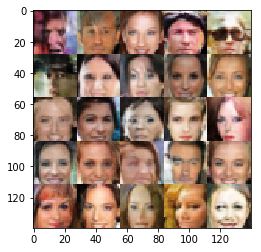

Epoch 10/10... Discriminator Loss: 1.865218... Generator Loss: 9.084192
Epoch 10/10... Discriminator Loss: 0.159433... Generator Loss: 4.316769
Epoch 10/10... Discriminator Loss: 0.178064... Generator Loss: 3.584185
Epoch 10/10... Discriminator Loss: 0.777969... Generator Loss: 1.489509
Epoch 10/10... Discriminator Loss: 0.060190... Generator Loss: 4.615228
Epoch 10/10... Discriminator Loss: 0.151858... Generator Loss: 3.191919
Epoch 10/10... Discriminator Loss: 0.340142... Generator Loss: 2.389998
Epoch 10/10... Discriminator Loss: 2.583021... Generator Loss: 0.410786
Epoch 10/10... Discriminator Loss: 0.761713... Generator Loss: 3.874572
Epoch 10/10... Discriminator Loss: 0.278819... Generator Loss: 4.637844


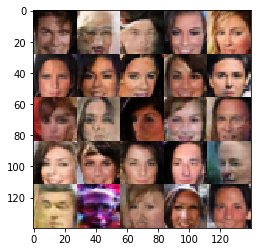

Epoch 10/10... Discriminator Loss: 0.259009... Generator Loss: 2.898548
Epoch 10/10... Discriminator Loss: 0.090021... Generator Loss: 3.797940
Epoch 10/10... Discriminator Loss: 0.619433... Generator Loss: 11.932076
Epoch 10/10... Discriminator Loss: 0.626559... Generator Loss: 1.513115
Epoch 10/10... Discriminator Loss: 0.761172... Generator Loss: 1.583159
Epoch 10/10... Discriminator Loss: 0.071554... Generator Loss: 4.520733
Epoch 10/10... Discriminator Loss: 0.150226... Generator Loss: 2.712239
Epoch 10/10... Discriminator Loss: 0.111875... Generator Loss: 4.826061
Epoch 10/10... Discriminator Loss: 0.056776... Generator Loss: 4.226173
Epoch 10/10... Discriminator Loss: 0.193985... Generator Loss: 2.987745


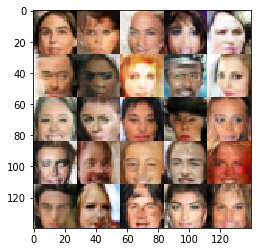

Epoch 10/10... Discriminator Loss: 0.113779... Generator Loss: 3.710128
Epoch 10/10... Discriminator Loss: 0.105278... Generator Loss: 3.481091
Epoch 10/10... Discriminator Loss: 1.825719... Generator Loss: 0.545167
Epoch 10/10... Discriminator Loss: 1.263279... Generator Loss: 0.811691
Epoch 10/10... Discriminator Loss: 0.209992... Generator Loss: 2.904807
Epoch 10/10... Discriminator Loss: 0.283031... Generator Loss: 2.506630
Epoch 10/10... Discriminator Loss: 0.207734... Generator Loss: 2.837675
Epoch 10/10... Discriminator Loss: 0.176849... Generator Loss: 2.897802
Epoch 10/10... Discriminator Loss: 0.018119... Generator Loss: 4.978946
Epoch 10/10... Discriminator Loss: 0.215912... Generator Loss: 2.767680


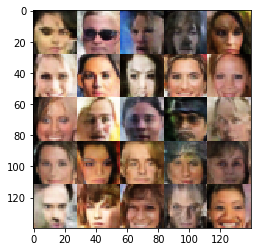

Epoch 10/10... Discriminator Loss: 0.116893... Generator Loss: 3.393279
Epoch 10/10... Discriminator Loss: 0.037358... Generator Loss: 5.152281
Epoch 10/10... Discriminator Loss: 0.082191... Generator Loss: 3.949809
Epoch 10/10... Discriminator Loss: 0.083910... Generator Loss: 3.691903
Epoch 10/10... Discriminator Loss: 0.033704... Generator Loss: 4.917227
Epoch 10/10... Discriminator Loss: 0.072519... Generator Loss: 4.916680
Epoch 10/10... Discriminator Loss: 0.052697... Generator Loss: 4.527376
Epoch 10/10... Discriminator Loss: 0.156963... Generator Loss: 2.946595
Epoch 10/10... Discriminator Loss: 0.200446... Generator Loss: 3.807710
Epoch 10/10... Discriminator Loss: 0.142152... Generator Loss: 2.820210


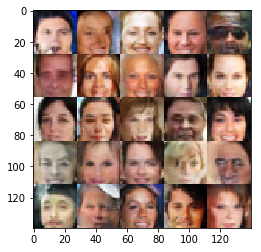

Epoch 10/10... Discriminator Loss: 1.035517... Generator Loss: 1.192407
Epoch 10/10... Discriminator Loss: 0.930288... Generator Loss: 1.354268
Epoch 10/10... Discriminator Loss: 0.424506... Generator Loss: 1.929074
Epoch 10/10... Discriminator Loss: 0.028995... Generator Loss: 6.248918
Epoch 10/10... Discriminator Loss: 0.069088... Generator Loss: 4.917963
Epoch 10/10... Discriminator Loss: 0.059628... Generator Loss: 5.628047
Epoch 10/10... Discriminator Loss: 0.177306... Generator Loss: 2.658999
Epoch 10/10... Discriminator Loss: 0.043473... Generator Loss: 5.976717
Epoch 10/10... Discriminator Loss: 0.028187... Generator Loss: 5.434991
Epoch 10/10... Discriminator Loss: 0.672504... Generator Loss: 1.279643


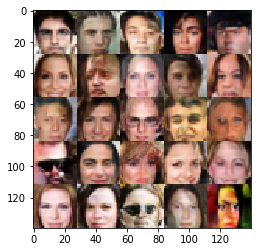

Epoch 10/10... Discriminator Loss: 0.013791... Generator Loss: 6.017838
Epoch 10/10... Discriminator Loss: 0.189107... Generator Loss: 2.731682
Epoch 10/10... Discriminator Loss: 0.724448... Generator Loss: 1.488125
Epoch 10/10... Discriminator Loss: 0.034107... Generator Loss: 5.817959
Epoch 10/10... Discriminator Loss: 0.020616... Generator Loss: 6.188059
Epoch 10/10... Discriminator Loss: 2.011197... Generator Loss: 1.381876
Epoch 10/10... Discriminator Loss: 0.369388... Generator Loss: 4.267647
Epoch 10/10... Discriminator Loss: 1.503302... Generator Loss: 0.907902
Epoch 10/10... Discriminator Loss: 0.908555... Generator Loss: 1.435752
Epoch 10/10... Discriminator Loss: 0.108311... Generator Loss: 4.555924


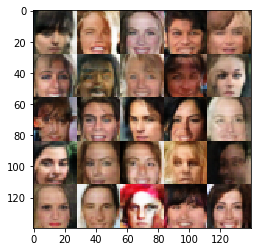

Epoch 10/10... Discriminator Loss: 2.597891... Generator Loss: 0.302584
Epoch 10/10... Discriminator Loss: 0.345937... Generator Loss: 6.031417
Epoch 10/10... Discriminator Loss: 0.122606... Generator Loss: 3.481307
Epoch 10/10... Discriminator Loss: 0.111766... Generator Loss: 3.372041
Epoch 10/10... Discriminator Loss: 1.459942... Generator Loss: 0.859299
Epoch 10/10... Discriminator Loss: 0.168056... Generator Loss: 3.352697
Epoch 10/10... Discriminator Loss: 0.115073... Generator Loss: 3.345338
Epoch 10/10... Discriminator Loss: 0.091088... Generator Loss: 3.679752
Epoch 10/10... Discriminator Loss: 0.195796... Generator Loss: 2.872655
Epoch 10/10... Discriminator Loss: 0.093288... Generator Loss: 3.545965


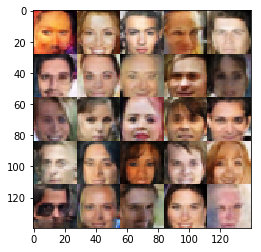

Epoch 10/10... Discriminator Loss: 0.057886... Generator Loss: 4.255013
Epoch 10/10... Discriminator Loss: 2.809361... Generator Loss: 0.387660
Epoch 10/10... Discriminator Loss: 0.141539... Generator Loss: 3.910659
Epoch 10/10... Discriminator Loss: 0.066155... Generator Loss: 4.532002
Epoch 10/10... Discriminator Loss: 0.147480... Generator Loss: 3.317931
Epoch 10/10... Discriminator Loss: 0.889556... Generator Loss: 1.603699
Epoch 10/10... Discriminator Loss: 0.081428... Generator Loss: 4.427874
Epoch 10/10... Discriminator Loss: 0.575272... Generator Loss: 2.014485
Epoch 10/10... Discriminator Loss: 0.088447... Generator Loss: 4.706077
Epoch 10/10... Discriminator Loss: 0.935674... Generator Loss: 1.330215


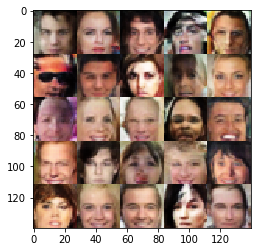

Epoch 10/10... Discriminator Loss: 0.898817... Generator Loss: 1.296688
Epoch 10/10... Discriminator Loss: 0.011771... Generator Loss: 10.111158
Epoch 10/10... Discriminator Loss: 0.056743... Generator Loss: 5.834023
Epoch 10/10... Discriminator Loss: 0.571906... Generator Loss: 1.919258
Epoch 10/10... Discriminator Loss: 0.112508... Generator Loss: 4.195966
Epoch 10/10... Discriminator Loss: 0.393789... Generator Loss: 2.155209
Epoch 10/10... Discriminator Loss: 0.144116... Generator Loss: 3.185910
Epoch 10/10... Discriminator Loss: 0.353673... Generator Loss: 2.267885
Epoch 10/10... Discriminator Loss: 0.299383... Generator Loss: 2.793186
Epoch 10/10... Discriminator Loss: 0.078003... Generator Loss: 3.938962


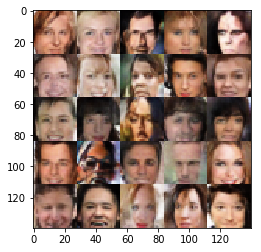

Epoch 10/10... Discriminator Loss: 0.012993... Generator Loss: 6.238898
Epoch 10/10... Discriminator Loss: 0.013876... Generator Loss: 6.772090
Epoch 10/10... Discriminator Loss: 0.021319... Generator Loss: 11.626958
Epoch 10/10... Discriminator Loss: 0.015581... Generator Loss: 11.423264
Epoch 10/10... Discriminator Loss: 0.119481... Generator Loss: 2.979045
Epoch 10/10... Discriminator Loss: 0.374735... Generator Loss: 1.953527
Epoch 10/10... Discriminator Loss: 0.067168... Generator Loss: 9.327508
Epoch 10/10... Discriminator Loss: 0.149212... Generator Loss: 7.686237
Epoch 10/10... Discriminator Loss: 0.010178... Generator Loss: 6.148983
Epoch 10/10... Discriminator Loss: 0.035935... Generator Loss: 5.297892


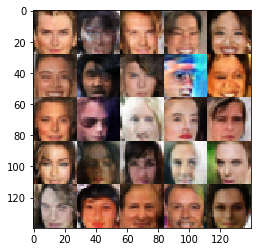

Epoch 10/10... Discriminator Loss: 0.092054... Generator Loss: 3.600227
Epoch 10/10... Discriminator Loss: 0.101122... Generator Loss: 3.319938
Epoch 10/10... Discriminator Loss: 0.069841... Generator Loss: 4.110768
Epoch 10/10... Discriminator Loss: 0.123838... Generator Loss: 3.599188
Epoch 10/10... Discriminator Loss: 0.160584... Generator Loss: 3.488825
Epoch 10/10... Discriminator Loss: 0.066724... Generator Loss: 4.146803
Epoch 10/10... Discriminator Loss: 0.024996... Generator Loss: 5.987944
Epoch 10/10... Discriminator Loss: 0.016854... Generator Loss: 6.991723
Epoch 10/10... Discriminator Loss: 0.241144... Generator Loss: 2.738094
Epoch 10/10... Discriminator Loss: 0.680043... Generator Loss: 1.561855


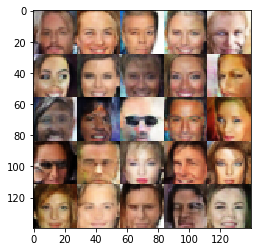

Epoch 10/10... Discriminator Loss: 0.260902... Generator Loss: 2.769657
Epoch 10/10... Discriminator Loss: 2.884609... Generator Loss: 0.255998
Epoch 10/10... Discriminator Loss: 0.245061... Generator Loss: 2.869005
Epoch 10/10... Discriminator Loss: 0.894920... Generator Loss: 1.385147
Epoch 10/10... Discriminator Loss: 0.429451... Generator Loss: 4.796423
Epoch 10/10... Discriminator Loss: 2.028900... Generator Loss: 0.678749
Epoch 10/10... Discriminator Loss: 0.299666... Generator Loss: 2.703712
Epoch 10/10... Discriminator Loss: 0.096025... Generator Loss: 4.214689
Epoch 10/10... Discriminator Loss: 0.296006... Generator Loss: 2.625950
Epoch 10/10... Discriminator Loss: 0.075455... Generator Loss: 5.308806


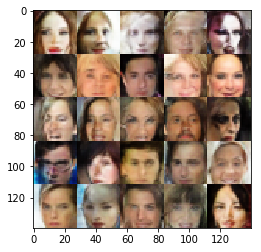

Epoch 10/10... Discriminator Loss: 0.004222... Generator Loss: 7.377048
Epoch 10/10... Discriminator Loss: 0.127166... Generator Loss: 4.395750
Epoch 10/10... Discriminator Loss: 0.116116... Generator Loss: 3.191344
Epoch 10/10... Discriminator Loss: 0.009677... Generator Loss: 6.267917
Epoch 10/10... Discriminator Loss: 0.241096... Generator Loss: 2.307018
Epoch 10/10... Discriminator Loss: 0.099341... Generator Loss: 3.601463
Epoch 10/10... Discriminator Loss: 0.088657... Generator Loss: 4.113849
Epoch 10/10... Discriminator Loss: 0.190330... Generator Loss: 5.191072
Epoch 10/10... Discriminator Loss: 0.459434... Generator Loss: 2.002058
Epoch 10/10... Discriminator Loss: 0.028175... Generator Loss: 6.204754


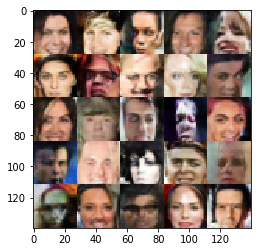

Epoch 10/10... Discriminator Loss: 0.323991... Generator Loss: 2.362456
Epoch 10/10... Discriminator Loss: 0.371767... Generator Loss: 2.037071
Epoch 10/10... Discriminator Loss: 0.026126... Generator Loss: 5.243740
Epoch 10/10... Discriminator Loss: 0.481022... Generator Loss: 2.101000
Epoch 10/10... Discriminator Loss: 3.743352... Generator Loss: 0.069325
Epoch 10/10... Discriminator Loss: 0.128800... Generator Loss: 4.519363
Epoch 10/10... Discriminator Loss: 0.068824... Generator Loss: 5.268349
Epoch 10/10... Discriminator Loss: 0.577401... Generator Loss: 1.873960
Epoch 10/10... Discriminator Loss: 0.056667... Generator Loss: 4.552294
Epoch 10/10... Discriminator Loss: 0.102537... Generator Loss: 4.099886


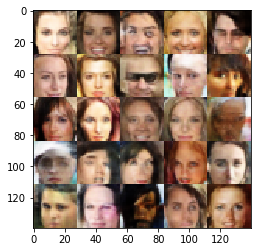

Epoch 10/10... Discriminator Loss: 2.473957... Generator Loss: 0.348894
Epoch 10/10... Discriminator Loss: 0.271960... Generator Loss: 2.612299
Epoch 10/10... Discriminator Loss: 0.541741... Generator Loss: 5.314418
Epoch 10/10... Discriminator Loss: 0.048560... Generator Loss: 4.616762
Epoch 10/10... Discriminator Loss: 0.211556... Generator Loss: 3.625419
Epoch 10/10... Discriminator Loss: 0.160951... Generator Loss: 7.023273
Epoch 10/10... Discriminator Loss: 0.259696... Generator Loss: 2.710124
Epoch 10/10... Discriminator Loss: 0.885981... Generator Loss: 1.500413
Epoch 10/10... Discriminator Loss: 0.318029... Generator Loss: 2.331708
Epoch 10/10... Discriminator Loss: 0.208461... Generator Loss: 3.065645


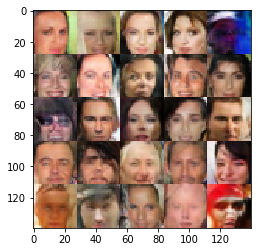

Epoch 10/10... Discriminator Loss: 0.030136... Generator Loss: 6.697736
Epoch 10/10... Discriminator Loss: 0.430050... Generator Loss: 1.736941
Epoch 10/10... Discriminator Loss: 0.117517... Generator Loss: 3.317753
Epoch 10/10... Discriminator Loss: 0.131788... Generator Loss: 3.415484
Epoch 10/10... Discriminator Loss: 1.199269... Generator Loss: 0.877144
Epoch 10/10... Discriminator Loss: 0.017277... Generator Loss: 7.154175
Epoch 10/10... Discriminator Loss: 0.052003... Generator Loss: 3.938768
Epoch 10/10... Discriminator Loss: 0.132933... Generator Loss: 3.132143
Epoch 10/10... Discriminator Loss: 0.097668... Generator Loss: 3.795689
Epoch 10/10... Discriminator Loss: 0.257443... Generator Loss: 2.337716


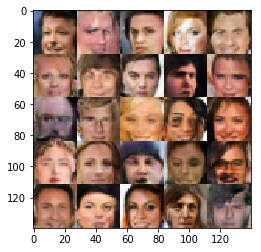

Epoch 10/10... Discriminator Loss: 0.408881... Generator Loss: 1.901893
Epoch 10/10... Discriminator Loss: 0.214319... Generator Loss: 2.451684
Epoch 10/10... Discriminator Loss: 0.756750... Generator Loss: 1.568266
Epoch 10/10... Discriminator Loss: 0.434160... Generator Loss: 2.074951
Epoch 10/10... Discriminator Loss: 0.236871... Generator Loss: 2.579397
Epoch 10/10... Discriminator Loss: 1.117665... Generator Loss: 0.854049
Epoch 10/10... Discriminator Loss: 0.077188... Generator Loss: 4.635704
Epoch 10/10... Discriminator Loss: 0.068191... Generator Loss: 4.330809
Epoch 10/10... Discriminator Loss: 0.837711... Generator Loss: 1.528326
Epoch 10/10... Discriminator Loss: 0.085875... Generator Loss: 4.362367


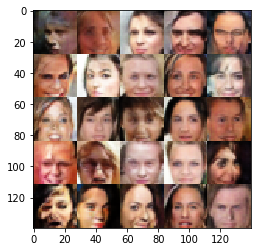

Epoch 10/10... Discriminator Loss: 0.160876... Generator Loss: 8.322797
Epoch 10/10... Discriminator Loss: 0.029906... Generator Loss: 6.218789
Epoch 10/10... Discriminator Loss: 0.273787... Generator Loss: 2.321375
Epoch 10/10... Discriminator Loss: 0.214939... Generator Loss: 2.770659
Epoch 10/10... Discriminator Loss: 0.034805... Generator Loss: 8.510109
Epoch 10/10... Discriminator Loss: 1.637428... Generator Loss: 0.692232
Epoch 10/10... Discriminator Loss: 0.956246... Generator Loss: 1.132531
Epoch 10/10... Discriminator Loss: 0.343896... Generator Loss: 2.414828
Epoch 10/10... Discriminator Loss: 0.057210... Generator Loss: 4.527616
Epoch 10/10... Discriminator Loss: 0.063697... Generator Loss: 5.597062


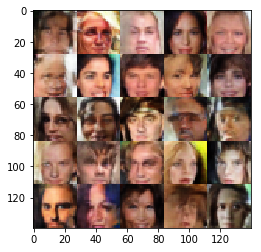

Epoch 10/10... Discriminator Loss: 0.369461... Generator Loss: 2.185984
Epoch 10/10... Discriminator Loss: 0.487433... Generator Loss: 1.693940
Epoch 10/10... Discriminator Loss: 0.033610... Generator Loss: 6.352492
Epoch 10/10... Discriminator Loss: 0.244942... Generator Loss: 2.474261
Epoch 10/10... Discriminator Loss: 0.344099... Generator Loss: 2.238411
Epoch 10/10... Discriminator Loss: 0.248367... Generator Loss: 2.289275
Epoch 10/10... Discriminator Loss: 0.225812... Generator Loss: 2.925098
Epoch 10/10... Discriminator Loss: 0.144670... Generator Loss: 3.675694
Epoch 10/10... Discriminator Loss: 0.059300... Generator Loss: 6.849000
Epoch 10/10... Discriminator Loss: 0.039080... Generator Loss: 4.749987


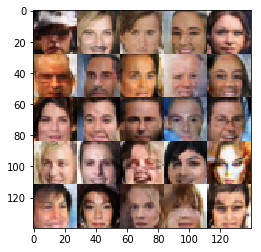

Epoch 10/10... Discriminator Loss: 0.076474... Generator Loss: 3.701175
Epoch 10/10... Discriminator Loss: 0.292469... Generator Loss: 2.363986
Epoch 10/10... Discriminator Loss: 0.003149... Generator Loss: 7.336374
Epoch 10/10... Discriminator Loss: 0.118901... Generator Loss: 4.050119
Epoch 10/10... Discriminator Loss: 0.021477... Generator Loss: 5.212472
Epoch 10/10... Discriminator Loss: 0.040195... Generator Loss: 4.697043
Epoch 10/10... Discriminator Loss: 0.563097... Generator Loss: 1.699809
Epoch 10/10... Discriminator Loss: 0.066166... Generator Loss: 3.503117
Epoch 10/10... Discriminator Loss: 0.335107... Generator Loss: 2.048083
Epoch 10/10... Discriminator Loss: 0.214598... Generator Loss: 2.797527


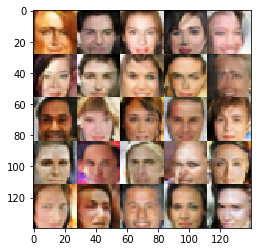

Epoch 10/10... Discriminator Loss: 0.034083... Generator Loss: 4.933640
Epoch 10/10... Discriminator Loss: 0.052151... Generator Loss: 3.922211
Epoch 10/10... Discriminator Loss: 0.545542... Generator Loss: 2.161398
Epoch 10/10... Discriminator Loss: 0.018442... Generator Loss: 6.062940
Epoch 10/10... Discriminator Loss: 0.019394... Generator Loss: 5.387897
Epoch 10/10... Discriminator Loss: 0.043488... Generator Loss: 5.153890
Epoch 10/10... Discriminator Loss: 0.274692... Generator Loss: 2.486392
Epoch 10/10... Discriminator Loss: 0.008827... Generator Loss: 7.066672
Epoch 10/10... Discriminator Loss: 0.489206... Generator Loss: 1.645315
Epoch 10/10... Discriminator Loss: 0.416414... Generator Loss: 1.891006


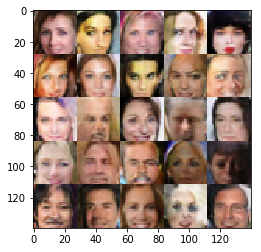

Epoch 10/10... Discriminator Loss: 0.111829... Generator Loss: 3.008778
Epoch 10/10... Discriminator Loss: 0.006450... Generator Loss: 9.815604
Epoch 10/10... Discriminator Loss: 0.037640... Generator Loss: 5.267212
Epoch 10/10... Discriminator Loss: 0.708676... Generator Loss: 1.925152
Epoch 10/10... Discriminator Loss: 0.030661... Generator Loss: 5.884039
Epoch 10/10... Discriminator Loss: 0.708514... Generator Loss: 1.574021
Epoch 10/10... Discriminator Loss: 0.465804... Generator Loss: 1.856508
Epoch 10/10... Discriminator Loss: 0.021211... Generator Loss: 8.627612
Epoch 10/10... Discriminator Loss: 0.017573... Generator Loss: 6.379981
Epoch 10/10... Discriminator Loss: 0.006285... Generator Loss: 10.103327


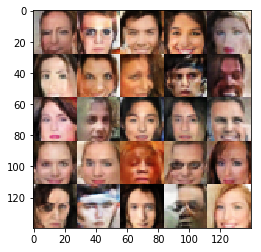

Epoch 10/10... Discriminator Loss: 0.058862... Generator Loss: 3.689624
Epoch 10/10... Discriminator Loss: 0.030994... Generator Loss: 5.056148
Epoch 10/10... Discriminator Loss: 0.368166... Generator Loss: 2.567106
Epoch 10/10... Discriminator Loss: 0.066359... Generator Loss: 4.137651
Epoch 10/10... Discriminator Loss: 0.039926... Generator Loss: 4.245518
Epoch 10/10... Discriminator Loss: 0.323813... Generator Loss: 1.925047
Epoch 10/10... Discriminator Loss: 0.508309... Generator Loss: 1.667593
Epoch 10/10... Discriminator Loss: 0.101573... Generator Loss: 3.455652
Epoch 10/10... Discriminator Loss: 0.035484... Generator Loss: 5.731103
Epoch 10/10... Discriminator Loss: 0.013905... Generator Loss: 5.616914


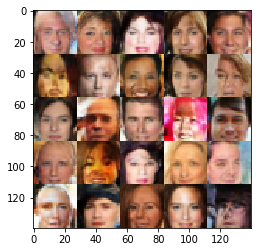

Epoch 10/10... Discriminator Loss: 0.016532... Generator Loss: 7.203770
Epoch 10/10... Discriminator Loss: 0.555535... Generator Loss: 1.582674
Epoch 10/10... Discriminator Loss: 0.122306... Generator Loss: 3.254179
Epoch 10/10... Discriminator Loss: 4.759569... Generator Loss: 0.179835
Epoch 10/10... Discriminator Loss: 2.456679... Generator Loss: 3.740554
Epoch 10/10... Discriminator Loss: 1.549555... Generator Loss: 0.749990
Epoch 10/10... Discriminator Loss: 1.715874... Generator Loss: 3.607350
Epoch 10/10... Discriminator Loss: 1.532623... Generator Loss: 3.392729
Epoch 10/10... Discriminator Loss: 1.480295... Generator Loss: 0.800670
Epoch 10/10... Discriminator Loss: 1.164401... Generator Loss: 4.107972


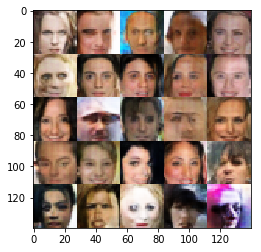

Epoch 10/10... Discriminator Loss: 0.784427... Generator Loss: 3.024507
Epoch 10/10... Discriminator Loss: 1.307002... Generator Loss: 1.065319
Epoch 10/10... Discriminator Loss: 1.651374... Generator Loss: 6.532051
Epoch 10/10... Discriminator Loss: 0.484311... Generator Loss: 2.305547
Epoch 10/10... Discriminator Loss: 1.046356... Generator Loss: 2.505282
Epoch 10/10... Discriminator Loss: 1.015509... Generator Loss: 1.230614
Epoch 10/10... Discriminator Loss: 1.025030... Generator Loss: 5.066769
Epoch 10/10... Discriminator Loss: 0.373448... Generator Loss: 3.688029
Epoch 10/10... Discriminator Loss: 0.254229... Generator Loss: 5.513524
Epoch 10/10... Discriminator Loss: 0.542288... Generator Loss: 4.904505


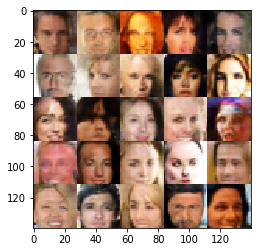

Epoch 10/10... Discriminator Loss: 1.156499... Generator Loss: 1.091120
Epoch 10/10... Discriminator Loss: 0.515796... Generator Loss: 2.476306
Epoch 10/10... Discriminator Loss: 0.595615... Generator Loss: 2.182948
Epoch 10/10... Discriminator Loss: 0.254564... Generator Loss: 3.792052
Epoch 10/10... Discriminator Loss: 0.401147... Generator Loss: 2.024339
Epoch 10/10... Discriminator Loss: 0.128624... Generator Loss: 3.028369
Epoch 10/10... Discriminator Loss: 0.208440... Generator Loss: 3.065938
Epoch 10/10... Discriminator Loss: 0.141195... Generator Loss: 3.454919
Epoch 10/10... Discriminator Loss: 0.207289... Generator Loss: 2.988233
Epoch 10/10... Discriminator Loss: 0.031863... Generator Loss: 5.540804


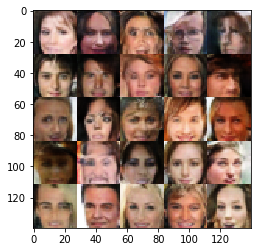

Epoch 10/10... Discriminator Loss: 2.594201... Generator Loss: 0.342461
Epoch 10/10... Discriminator Loss: 0.078490... Generator Loss: 4.129394
Epoch 10/10... Discriminator Loss: 0.218786... Generator Loss: 2.910724
Epoch 10/10... Discriminator Loss: 0.022833... Generator Loss: 7.739661
Epoch 10/10... Discriminator Loss: 0.069590... Generator Loss: 4.358279
Epoch 10/10... Discriminator Loss: 1.104234... Generator Loss: 0.860229
Epoch 10/10... Discriminator Loss: 0.269393... Generator Loss: 2.668441
Epoch 10/10... Discriminator Loss: 0.155554... Generator Loss: 3.888901
Epoch 10/10... Discriminator Loss: 0.631283... Generator Loss: 1.655916
Epoch 10/10... Discriminator Loss: 0.173150... Generator Loss: 9.641300


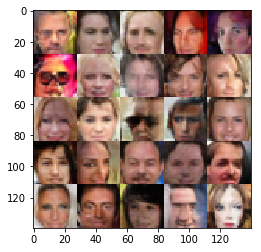

Epoch 10/10... Discriminator Loss: 2.641919... Generator Loss: 0.234421
Epoch 10/10... Discriminator Loss: 0.330011... Generator Loss: 2.124383
Epoch 10/10... Discriminator Loss: 0.122672... Generator Loss: 3.223434
Epoch 10/10... Discriminator Loss: 0.148270... Generator Loss: 5.498076
Epoch 10/10... Discriminator Loss: 0.008900... Generator Loss: 9.514286
Epoch 10/10... Discriminator Loss: 0.068858... Generator Loss: 3.849413
Epoch 10/10... Discriminator Loss: 0.209440... Generator Loss: 3.001800
Epoch 10/10... Discriminator Loss: 0.080505... Generator Loss: 3.738754
Epoch 10/10... Discriminator Loss: 0.050648... Generator Loss: 4.226254
Epoch 10/10... Discriminator Loss: 0.509812... Generator Loss: 2.054206


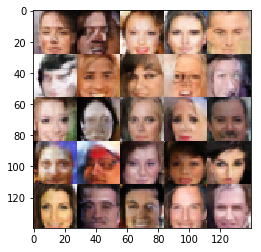

Epoch 10/10... Discriminator Loss: 0.183989... Generator Loss: 3.051848
Epoch 10/10... Discriminator Loss: 0.196090... Generator Loss: 3.142254
Epoch 10/10... Discriminator Loss: 0.146893... Generator Loss: 4.739780
Epoch 10/10... Discriminator Loss: 0.321725... Generator Loss: 2.373146
Epoch 10/10... Discriminator Loss: 0.198739... Generator Loss: 2.849967
Epoch 10/10... Discriminator Loss: 0.262801... Generator Loss: 2.518182
Epoch 10/10... Discriminator Loss: 0.131460... Generator Loss: 3.433702
Epoch 10/10... Discriminator Loss: 0.014696... Generator Loss: 6.348500
Epoch 10/10... Discriminator Loss: 0.390227... Generator Loss: 1.763565
Epoch 10/10... Discriminator Loss: 0.030622... Generator Loss: 4.759737


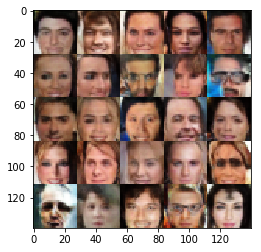

Epoch 10/10... Discriminator Loss: 0.263893... Generator Loss: 2.693066
Epoch 10/10... Discriminator Loss: 0.129674... Generator Loss: 3.873812
Epoch 10/10... Discriminator Loss: 0.126656... Generator Loss: 3.587637
Epoch 10/10... Discriminator Loss: 2.974591... Generator Loss: 0.114642
Epoch 10/10... Discriminator Loss: 0.070866... Generator Loss: 3.527085
Epoch 10/10... Discriminator Loss: 0.183884... Generator Loss: 2.707083
Epoch 10/10... Discriminator Loss: 0.080840... Generator Loss: 3.906120
Epoch 10/10... Discriminator Loss: 0.358585... Generator Loss: 1.861527
Epoch 10/10... Discriminator Loss: 0.390095... Generator Loss: 2.270704
Epoch 10/10... Discriminator Loss: 0.026845... Generator Loss: 4.775847


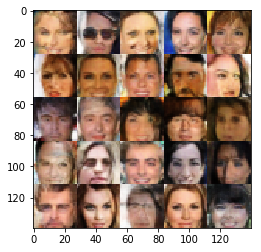

Epoch 10/10... Discriminator Loss: 0.028690... Generator Loss: 4.948239
Epoch 10/10... Discriminator Loss: 0.053868... Generator Loss: 5.998557
Epoch 10/10... Discriminator Loss: 0.116327... Generator Loss: 3.681589
Epoch 10/10... Discriminator Loss: 0.185219... Generator Loss: 3.088341
Epoch 10/10... Discriminator Loss: 0.030785... Generator Loss: 8.006687
Epoch 10/10... Discriminator Loss: 0.853961... Generator Loss: 1.108388
Epoch 10/10... Discriminator Loss: 0.276397... Generator Loss: 2.372177
Epoch 10/10... Discriminator Loss: 0.049387... Generator Loss: 4.286304
Epoch 10/10... Discriminator Loss: 0.080956... Generator Loss: 8.011070
Epoch 10/10... Discriminator Loss: 0.011757... Generator Loss: 7.898694


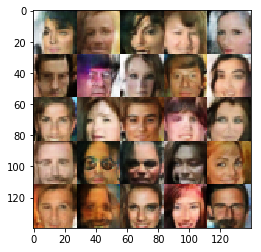

Epoch 10/10... Discriminator Loss: 0.208284... Generator Loss: 3.101974
Epoch 10/10... Discriminator Loss: 0.121351... Generator Loss: 3.431676
Epoch 10/10... Discriminator Loss: 0.262578... Generator Loss: 2.483370
Epoch 10/10... Discriminator Loss: 0.329919... Generator Loss: 2.268216
Epoch 10/10... Discriminator Loss: 0.100927... Generator Loss: 4.354542
Epoch 10/10... Discriminator Loss: 0.074841... Generator Loss: 4.575142
Epoch 10/10... Discriminator Loss: 0.122363... Generator Loss: 3.280879
Epoch 10/10... Discriminator Loss: 0.140361... Generator Loss: 3.221593
Epoch 10/10... Discriminator Loss: 0.193221... Generator Loss: 2.813003
Epoch 10/10... Discriminator Loss: 0.013812... Generator Loss: 8.225217


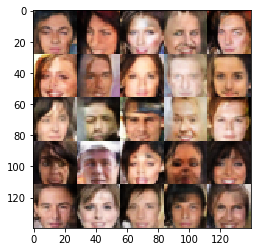

Epoch 10/10... Discriminator Loss: 0.056284... Generator Loss: 4.356791


In [129]:
batch_size = 50
z_dim = 100
learning_rate = 0.0005
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 10

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.